# Exploring data from Bas - Promoter characterization
## First experiment without lactate, in Succinate and aerobic conditions.

### Concentrations need to be corrected due to experimental mistakes:
### Old -> 0,0.1,0.5,1,10,5,50 mM
### New -> 0,0.05,0.2,0.5,5,2,20 mM
### Already corrected in plot but not their labels
### Done for 50mM

In [1]:
#Import/Initialization
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt #plotting

import re 

def sorted_nicely( l ): 
    """ Sort the given iterable in the way that humans expect.
    
    Function that sorts string numbers correctly.
    """ 
    convert = lambda text: int(text) if text.isdigit() else text 
    alphanum_key = lambda key: [ convert(c) for c in re.split('([0-9]+)', key) ] 
    return sorted(l, key = alphanum_key)

In [2]:
#Load the data
OD_data = pd.read_excel("Data/09-08-2022_EcN Succ15mM_GFP_OD600.xlsx", engine='openpyxl', header=0)
FLU_data = pd.read_excel("Data/09-08-2022_EcN Succ15mM_GFP_EX479EM510.xlsx", engine='openpyxl', header=0)

#Remove temperature column
OD_data.pop('T° OD600:600')
OD_data['Time'] = OD_data['Time']/3600
FLU_data.pop('T° GFP:479,510')
FLU_data['Time'] = FLU_data['Time']/3600

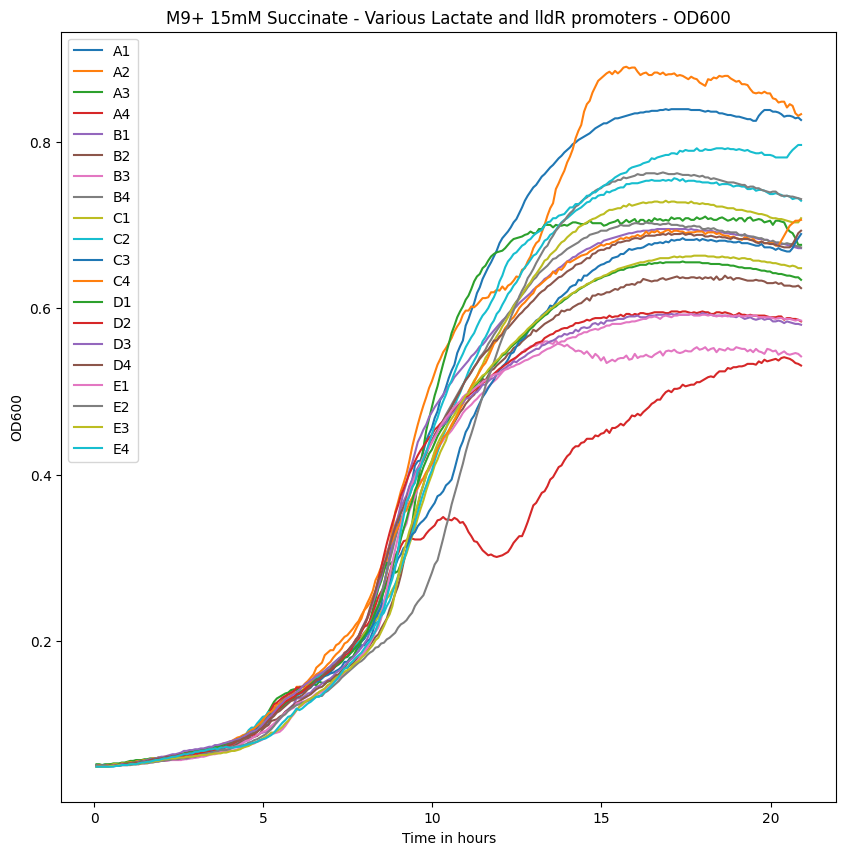

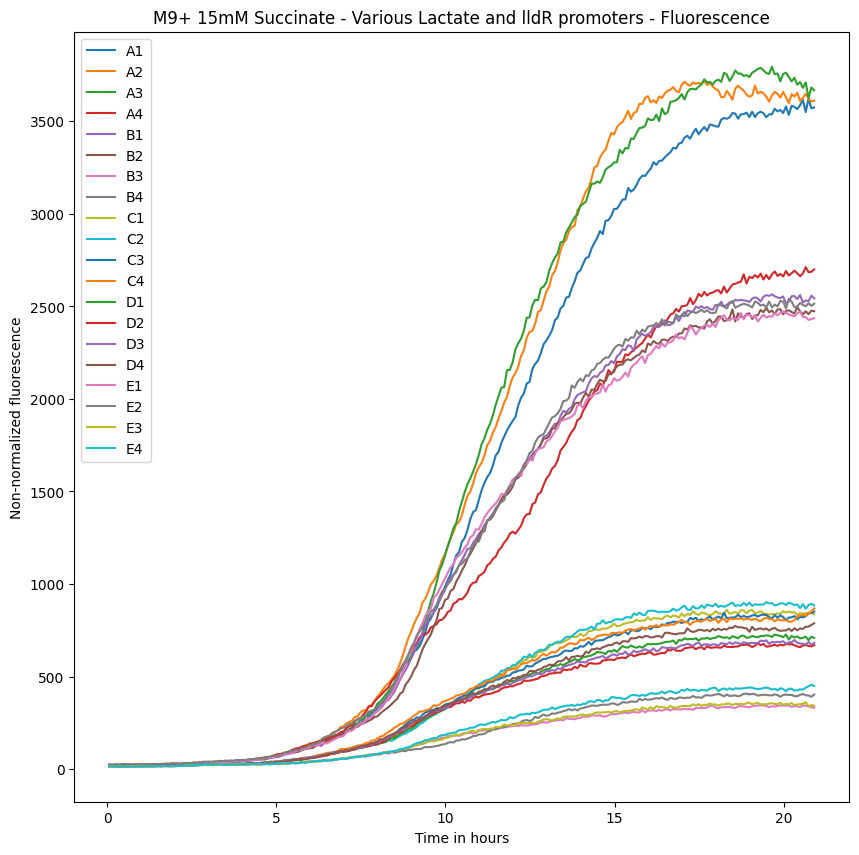

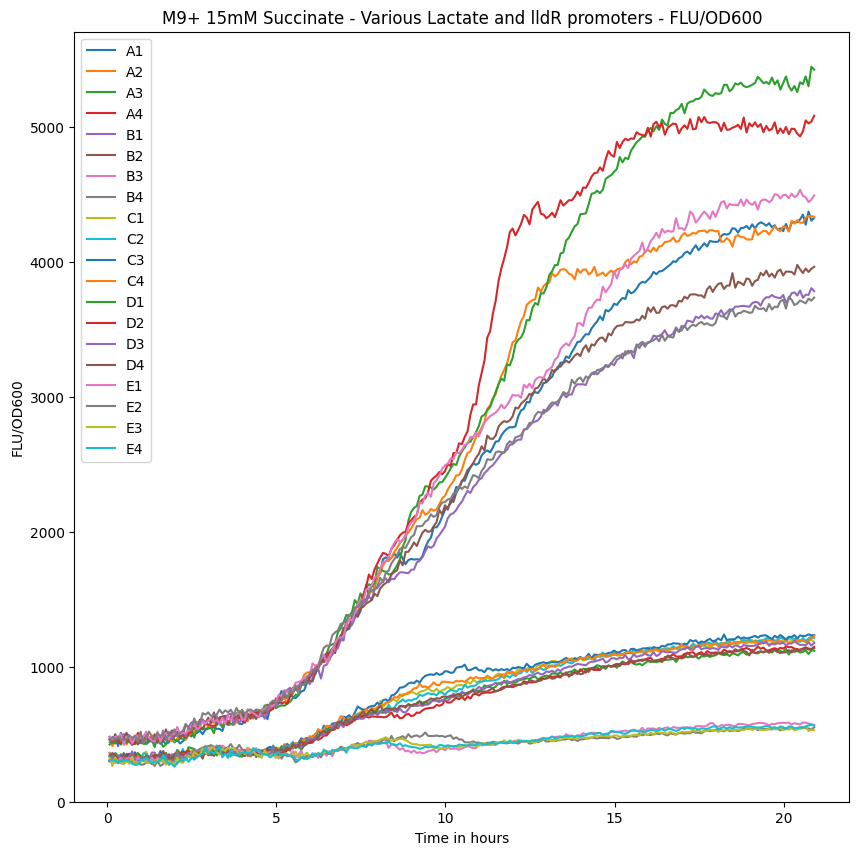

In [3]:
data_OD = OD_data.iloc[:,1:].to_numpy()
data_FLU = FLU_data.iloc[:,1:].to_numpy()

#Correction Vittorio uses
#data_OD = data_OD-np.min(data_OD)
#data_OD = data_OD/0.23+0.02

data_FLUOD = data_FLU/data_OD

time = OD_data.iloc[:,0]

plt.figure(figsize=(10,10))
plt.plot(time, data_OD, label=OD_data.columns[1:])
plt.ylabel('OD600')
plt.xlabel('Time in hours')
plt.title('M9+ 15mM Succinate - Various Lactate and lldR promoters - OD600')
plt.legend()
plt.show()

plt.figure(figsize=(10,10))
plt.plot(time, data_FLU, label=OD_data.columns[1:])
plt.ylabel('Non-normalized fluorescence')
plt.xlabel('Time in hours')
plt.title('M9+ 15mM Succinate - Various Lactate and lldR promoters - Fluorescence')
plt.legend()
plt.show()

plt.figure(figsize=(10,10))
plt.plot(time, data_FLUOD, label=OD_data.columns[1:])
plt.ylabel('FLU/OD600')
plt.xlabel('Time in hours')
plt.title('M9+ 15mM Succinate - Various Lactate and lldR promoters - FLU/OD600')
plt.legend()
plt.show()

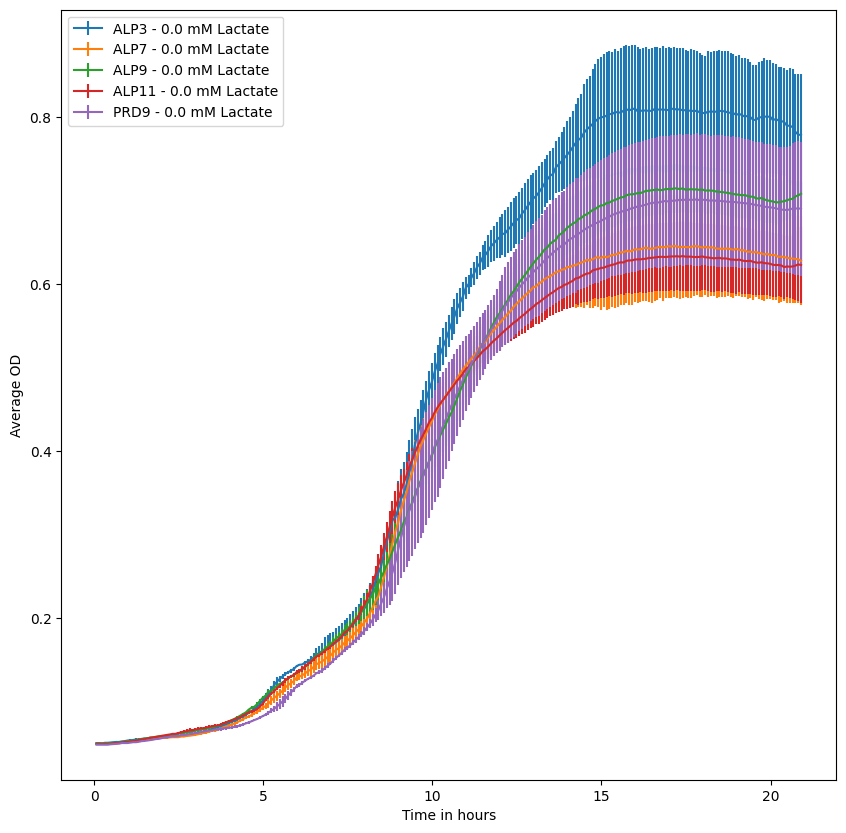

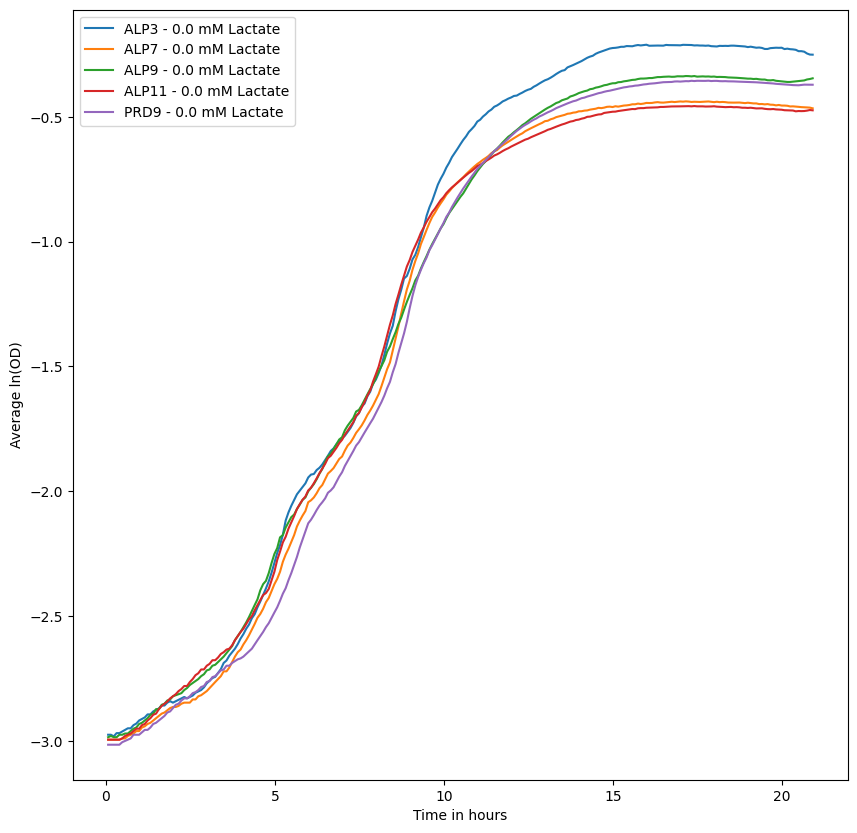

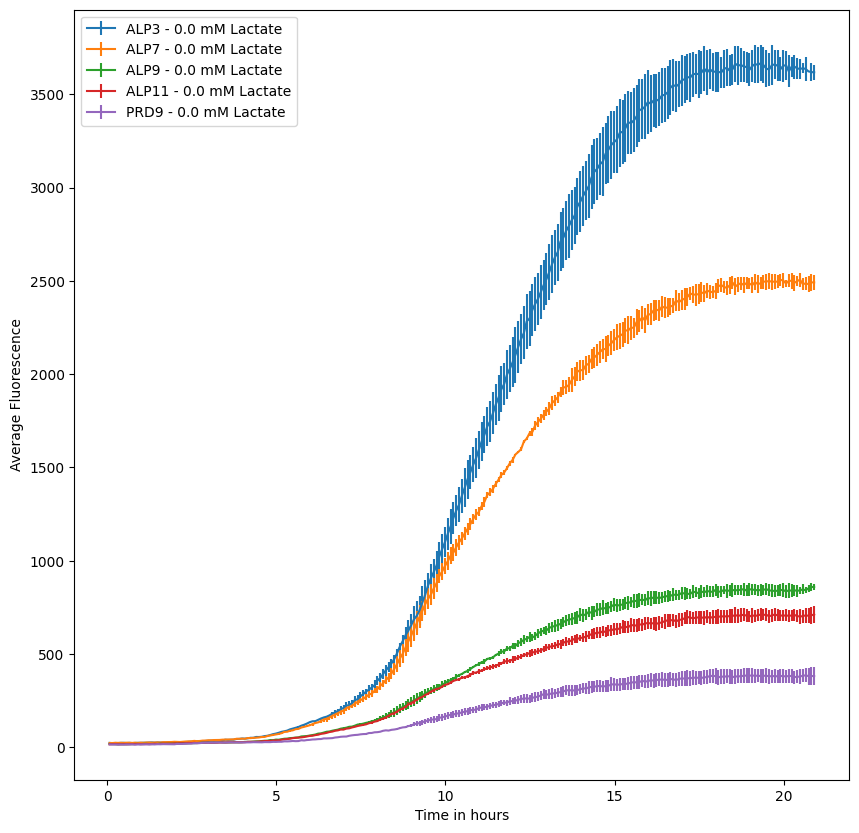

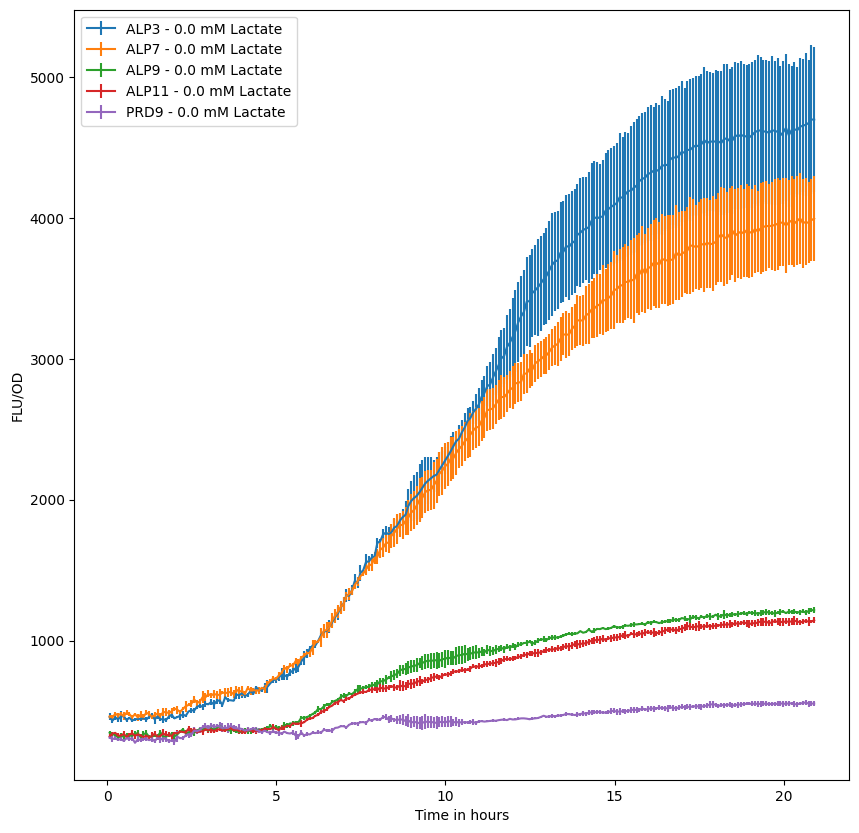

In [4]:
#Specify number of replicates
replicates = 4

OD_avg1 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
OD_std1 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLU_avg1 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLU_std1 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLUOD_avg1 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLUOD_std1 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))

for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        #Calculate average and stdev
        #Some standard deviations are zero
        OD_avg1[:,index] = np.average(data_OD[:,i:i+replicates], axis=1)
        OD_std1[:,index] = np.std(data_OD[:,i:i+replicates], axis=1)
        
        FLU_avg1[:,index] = np.average(data_FLU[:,i:i+replicates], axis=1)
        FLU_std1[:,index] = np.std(data_FLU[:,i:i+replicates], axis=1)
        
        FLUOD_avg1[:,index] = np.average(data_FLUOD[:,i:i+replicates], axis=1)
        FLUOD_std1[:,index] = np.std(data_FLUOD[:,i:i+replicates], axis=1)
        #Exclude the funky A4 curve
        if index ==0:
            OD_avg1[:,index] = np.average(data_OD[:,i:i+replicates-1], axis=1)
            OD_std1[:,index] = np.std(data_OD[:,i:i+replicates-1], axis=1)

            FLU_avg1[:,index] = np.average(data_FLU[:,i:i+replicates-1], axis=1)
            FLU_std1[:,index] = np.std(data_FLU[:,i:i+replicates-1], axis=1)
            
            FLUOD_avg1[:,index] = np.average(data_FLUOD[:,i:i+replicates-1], axis=1)
            FLUOD_std1[:,index] = np.std(data_FLUOD[:,i:i+replicates-1], axis=1)
#Plot average OD levels
labels1 = ['ALP3 - 0.0 mM Lactate', 'ALP7 - 0.0 mM Lactate', 'ALP9 - 0.0 mM Lactate', 'ALP11 - 0.0 mM Lactate', 'PRD9 - 0.0 mM Lactate']
plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        plt.errorbar(time, OD_avg1[:,index], yerr=OD_std1[:,index], label=labels1[index])
plt.legend(loc="upper left")
plt.ylabel('Average OD')
plt.xlabel('Time in hours')
plt.show()

plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        log = np.log(OD_avg1[:,index])
        plt.plot(time, log, label=labels1[index])
plt.legend(loc="upper left")
plt.ylabel('Average ln(OD)')
plt.xlabel('Time in hours')
plt.show()


plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        plt.errorbar(time, FLU_avg1[:,index], yerr=FLU_std1[:,index], label=labels1[index])
plt.legend(loc="upper left")
plt.ylabel('Average Fluorescence')
plt.xlabel('Time in hours')
plt.show()

plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        plt.errorbar(time, FLUOD_avg1[:,index], yerr=FLUOD_std1[:,index], label=labels1[index])
plt.legend(loc="upper left")
plt.ylabel('FLU/OD')
plt.xlabel('Time in hours')
plt.show()

## Experiment with various lactate concentrations, in 15mM Succinate and aerobic conditions
* Data doesnt look very good, high error bars
* May be repeated in the future

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


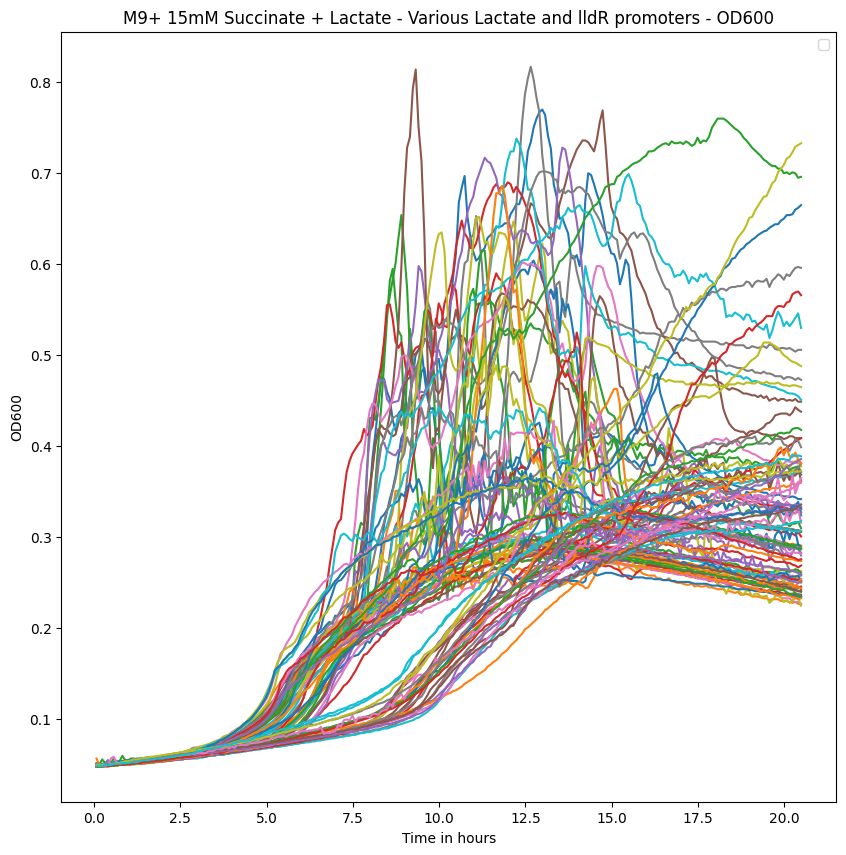

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


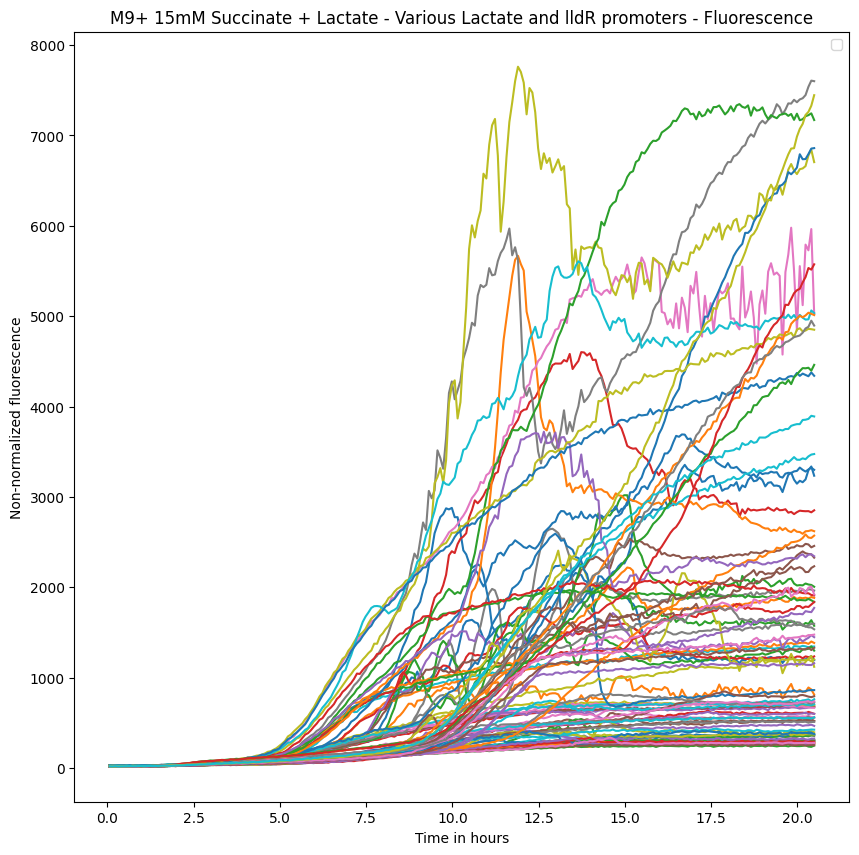

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


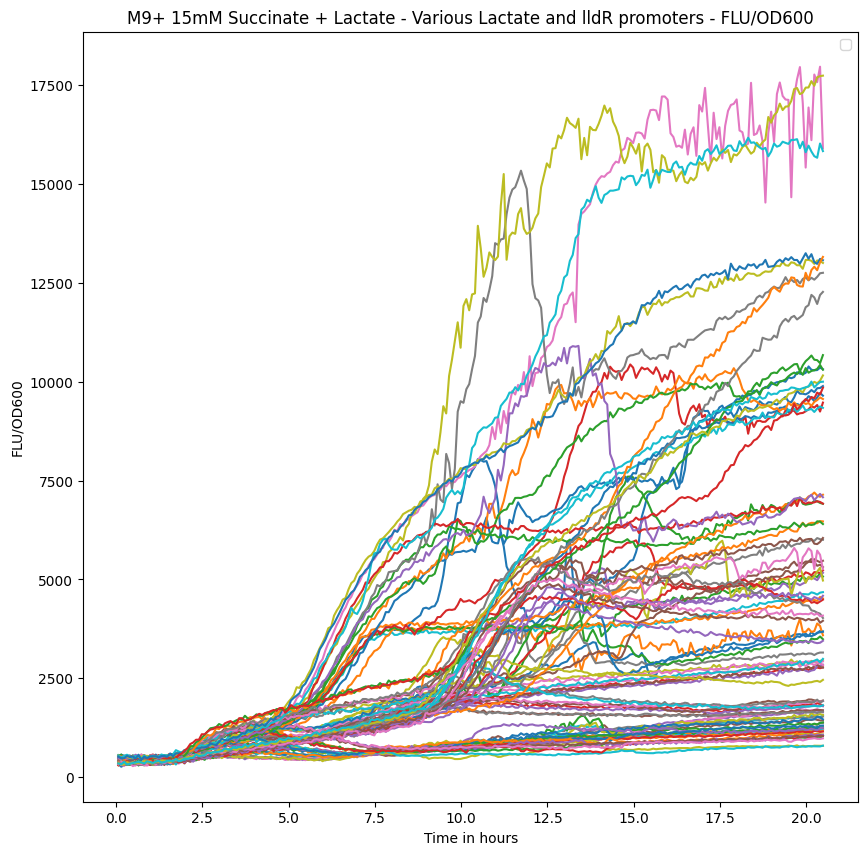

In [5]:
#Load the data
OD_data = pd.read_excel("Data/09-08-2022_EcN_Succ15mM_Lactate_GFP_OD600.xlsx", engine='openpyxl', header=0)
FLU_data = pd.read_excel("Data/09-08-2022_EcN_Succ15mM_Lactate_GFP_EX479EM510.xlsx", engine='openpyxl', header=0)

#Remove temperature column
OD_data.pop('T° OD600:600')
OD_data['Time'] = OD_data['Time']/3600
FLU_data.pop('T° GFP:479,510')
FLU_data['Time'] = FLU_data['Time']/3600


data_OD = OD_data.iloc[:,1:].to_numpy()
data_FLU = FLU_data.iloc[:,1:].to_numpy()
data_FLUOD = data_FLU/data_OD
time = OD_data.iloc[:,0]

plt.figure(figsize=(10,10))
plt.plot(time, data_OD)#, label=OD_data.columns[1:])
plt.ylabel('OD600')
plt.xlabel('Time in hours')
plt.title('M9+ 15mM Succinate + Lactate - Various Lactate and lldR promoters - OD600')
plt.legend()
plt.show()

plt.figure(figsize=(10,10))
plt.plot(time, data_FLU)#, label=OD_data.columns[1:])
plt.ylabel('Non-normalized fluorescence')
plt.xlabel('Time in hours')
plt.title('M9+ 15mM Succinate + Lactate - Various Lactate and lldR promoters - Fluorescence')
plt.legend()
plt.show()

plt.figure(figsize=(10,10))
plt.plot(time, data_FLUOD)#, label=OD_data.columns[1:])
plt.ylabel('FLU/OD600')
plt.xlabel('Time in hours')
plt.title('M9+ 15mM Succinate + Lactate - Various Lactate and lldR promoters - FLU/OD600')
plt.legend()
plt.show()

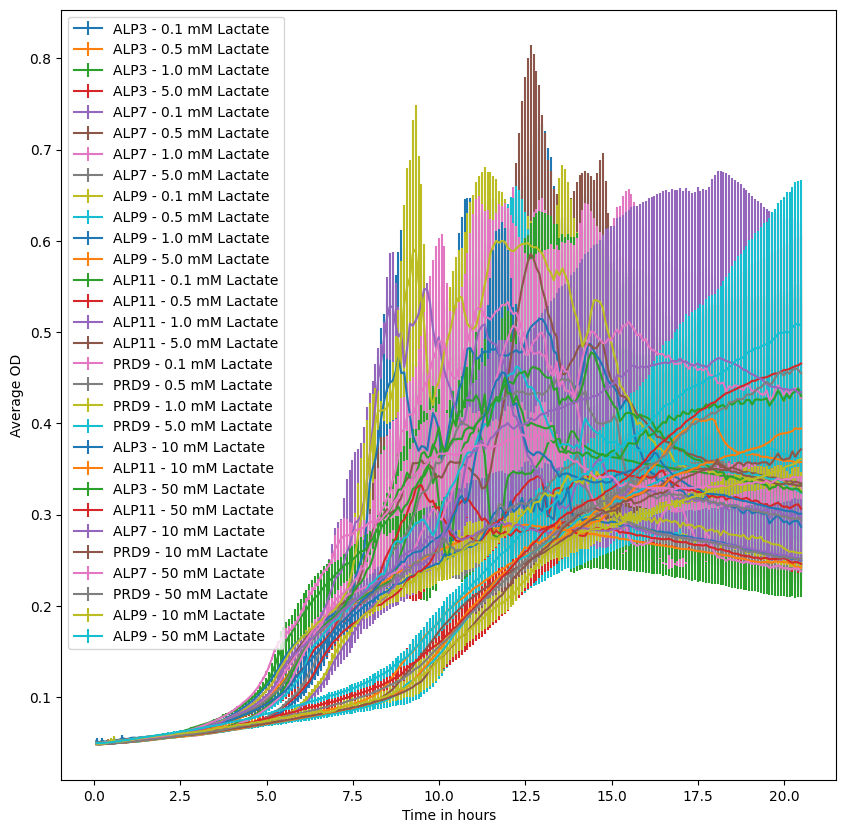

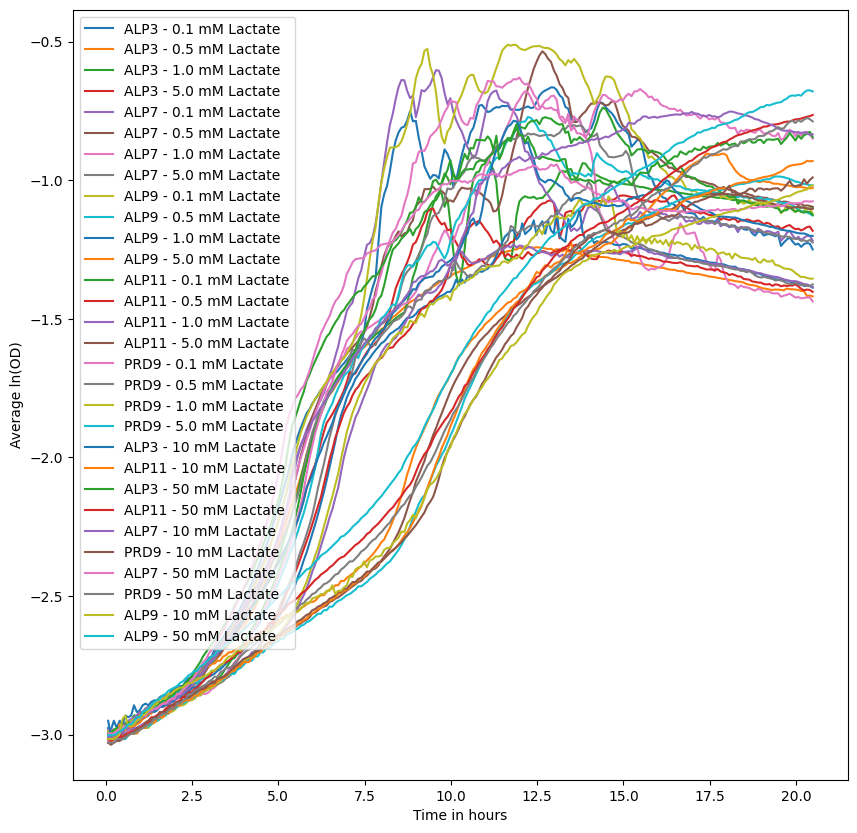

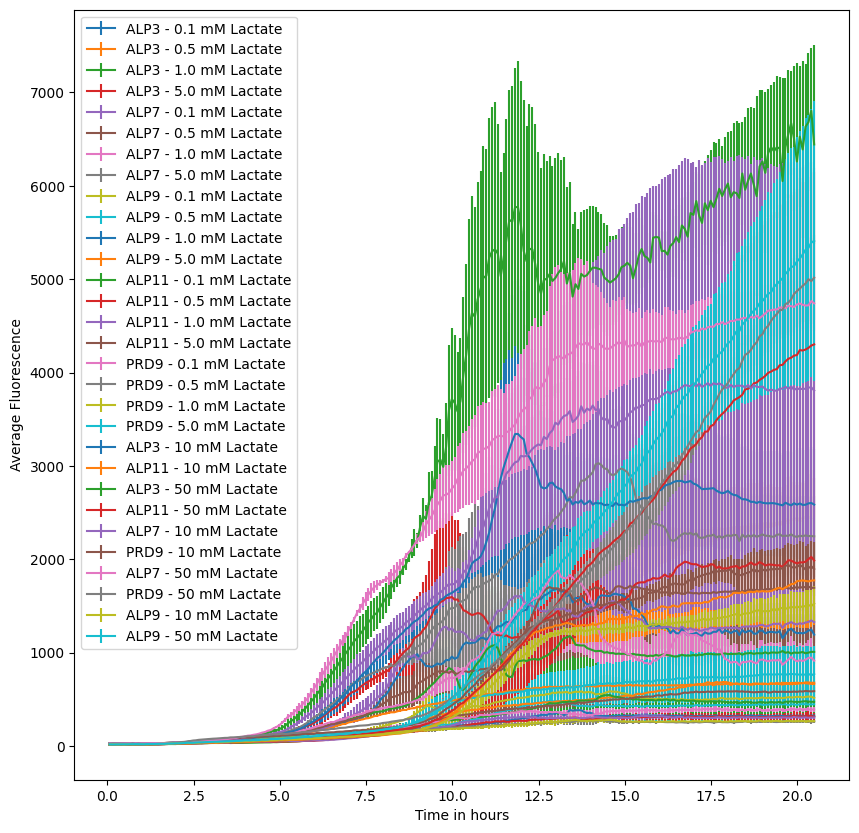

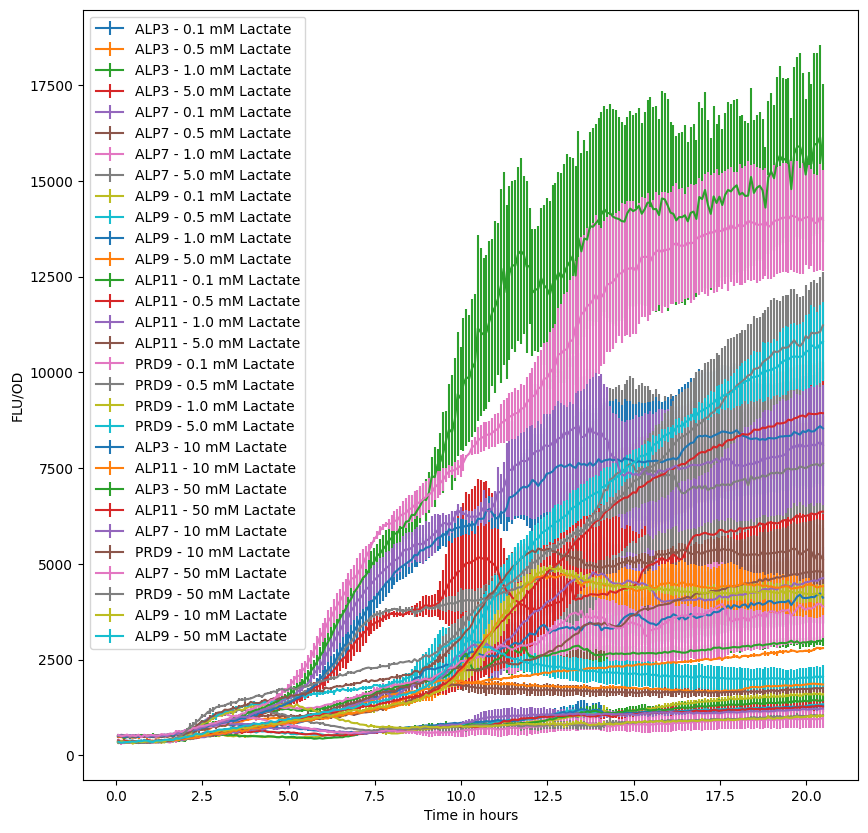

In [6]:
#Specify number of replicates
replicates = 3

OD_avg2 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
OD_std2 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLU_avg2 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLU_std2 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLUOD_avg2 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLUOD_std2 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))

for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        #Calculate average and stdev
        #Some standard deviations are zero
        OD_avg2[:,index] = np.average(data_OD[:,i:i+replicates], axis=1)
        OD_std2[:,index] = np.std(data_OD[:,i:i+replicates], axis=1)
        
        FLU_avg2[:,index] = np.average(data_FLU[:,i:i+replicates], axis=1)
        FLU_std2[:,index] = np.std(data_FLU[:,i:i+replicates], axis=1)
        
        FLUOD_avg2[:,index] = np.average(data_FLUOD[:,i:i+replicates], axis=1)
        FLUOD_std2[:,index] = np.std(data_FLUOD[:,i:i+replicates], axis=1)
#Plot average OD levels
labels2 = ['ALP3 - 0.1 mM Lactate',
          'ALP3 - 0.5 mM Lactate',
          'ALP3 - 1.0 mM Lactate',
          'ALP3 - 5.0 mM Lactate',
          'ALP7 - 0.1 mM Lactate',
          'ALP7 - 0.5 mM Lactate',
          'ALP7 - 1.0 mM Lactate',
          'ALP7 - 5.0 mM Lactate',
          'ALP9 - 0.1 mM Lactate',
          'ALP9 - 0.5 mM Lactate',
          'ALP9 - 1.0 mM Lactate',
          'ALP9 - 5.0 mM Lactate',
          'ALP11 - 0.1 mM Lactate',
          'ALP11 - 0.5 mM Lactate',
          'ALP11 - 1.0 mM Lactate',
          'ALP11 - 5.0 mM Lactate',
          'PRD9 - 0.1 mM Lactate',
          'PRD9 - 0.5 mM Lactate',
          'PRD9 - 1.0 mM Lactate',
          'PRD9 - 5.0 mM Lactate',
          'ALP3 - 10 mM Lactate',
          'ALP11 - 10 mM Lactate',
          'ALP3 - 20 mM Lactate',
          'ALP11 - 20 mM Lactate',
          'ALP7 - 10 mM Lactate',
          'PRD9 - 10 mM Lactate',
          'ALP7 - 20 mM Lactate',
          'PRD9 - 20 mM Lactate',
          'ALP9 - 10 mM Lactate',
          'ALP9 - 20 mM Lactate']

plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        plt.errorbar(time, OD_avg2[:,index], yerr=OD_std2[:,index], label=labels2[index])
plt.legend(loc="upper left")
plt.ylabel('Average OD')
plt.xlabel('Time in hours')
plt.show()

plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        log = np.log(OD_avg2[:,index])
        plt.plot(time, log, label=labels2[index])
plt.legend(loc="upper left")
plt.ylabel('Average ln(OD)')
plt.xlabel('Time in hours')
plt.show()

plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        plt.errorbar(time, FLU_avg2[:,index], yerr=FLU_std2[:,index], label=labels2[index])
plt.legend(loc="upper left")
plt.ylabel('Average Fluorescence')
plt.xlabel('Time in hours')
plt.show()

plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        plt.errorbar(time, FLUOD_avg2[:,index], yerr=FLUOD_std2[:,index], label=labels2[index])
plt.legend(loc="upper left")
plt.ylabel('FLU/OD')
plt.xlabel('Time in hours')
plt.show()

In [7]:
#Add data from both experiments together
labels = np.array(labels1+labels2)

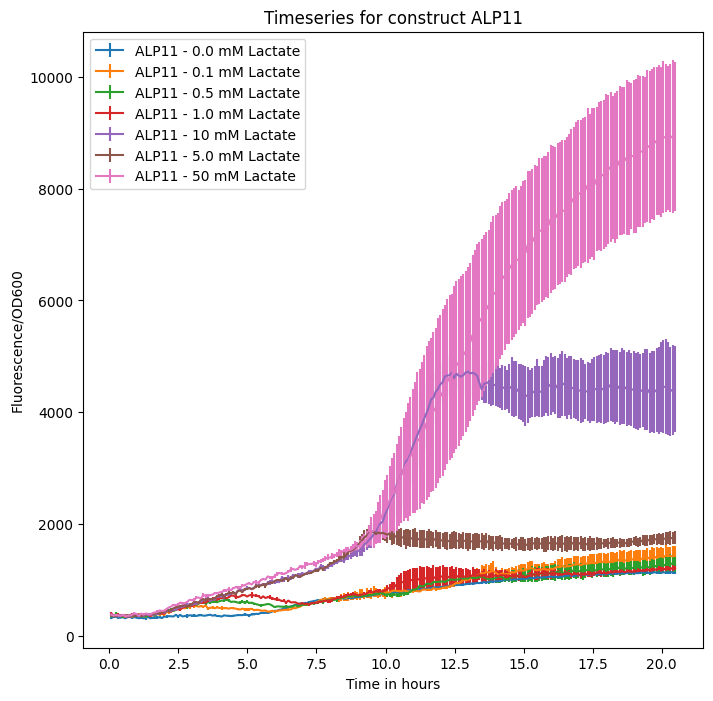

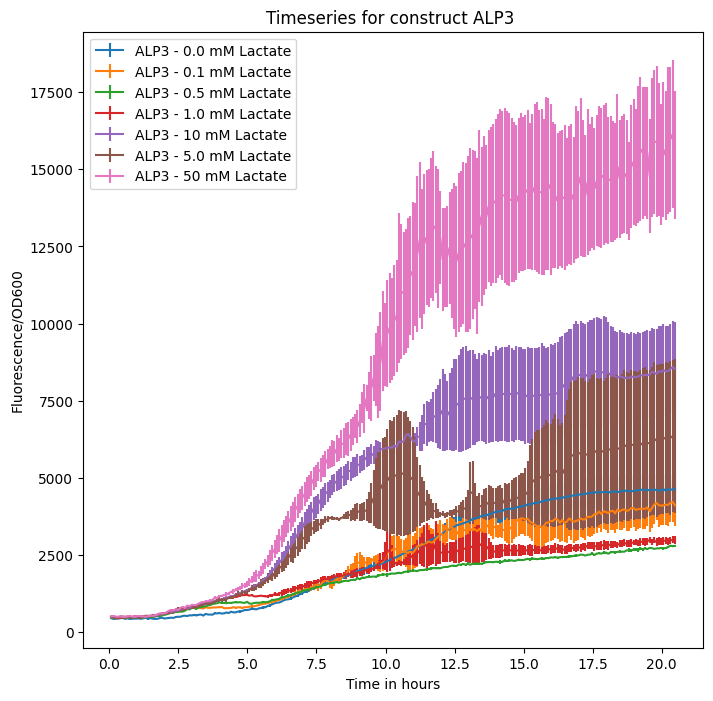

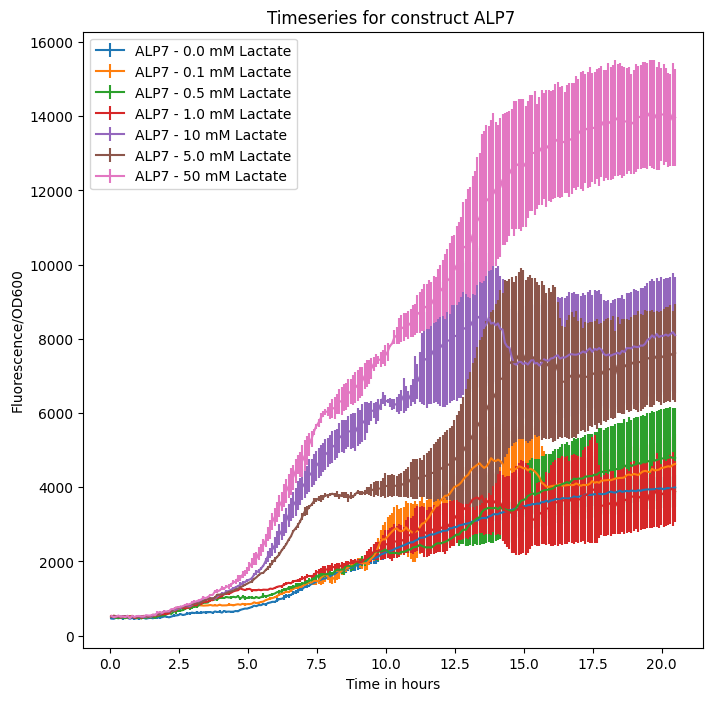

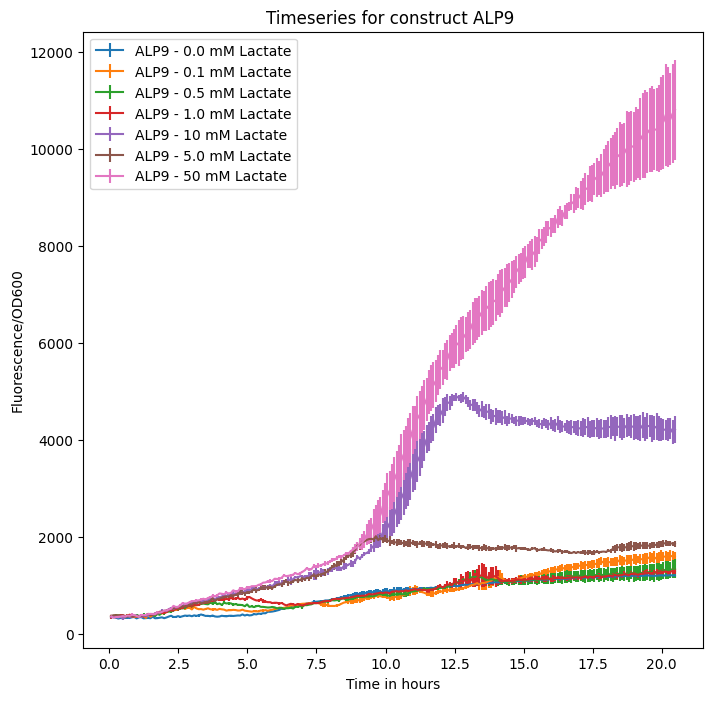

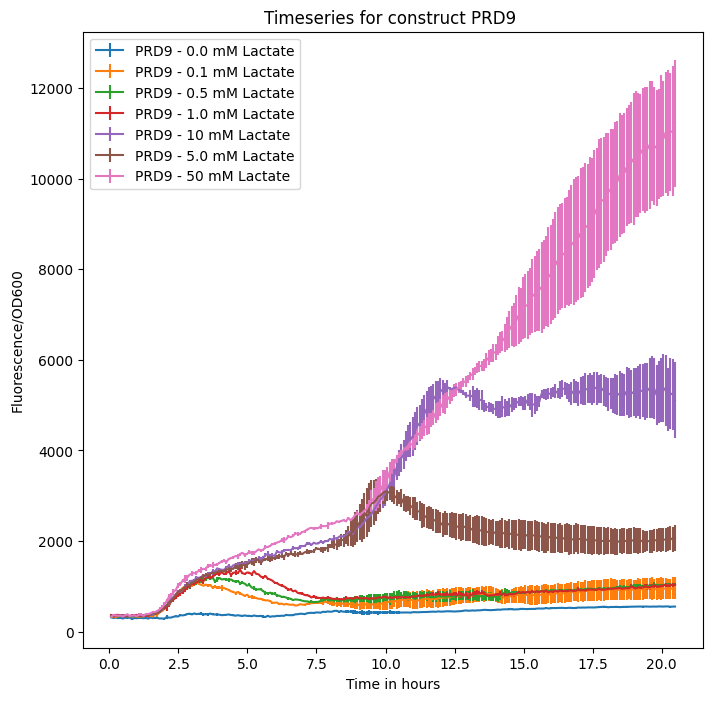

In [8]:
sort_index = labels.argsort()
#Sort everything on label
labels = labels[sort_index]
#Concentrations are not in order because argsort doesnt sort the numbers in a string correctly
#concentrations = np.array([0,0.1,0.5,1,10,5,20])
concentrations = np.array([0,0.05,0.2,0.5,5,2,20])
FLUOD_avg = np.column_stack((FLUOD_avg1[:-5],FLUOD_avg2))
FLUOD_std = np.column_stack((FLUOD_std1[:-5],FLUOD_std2))

FLU_avg = np.column_stack((FLU_avg1[:-5],FLU_avg2))
FLU_std = np.column_stack((FLU_std1[:-5],FLU_std2))

OD_avg = np.column_stack((OD_avg1[:-5],OD_avg2))
OD_std = np.column_stack((OD_std1[:-5],OD_std2))

FLUOD_avg = FLUOD_avg[:,sort_index]
FLUOD_std = FLUOD_std[:,sort_index]
FLU_avg = FLU_avg[:,sort_index]
FLU_std = FLU_std[:,sort_index]
OD_avg = OD_avg[:,sort_index]
OD_std = OD_std[:,sort_index]

for i in range(int(len(FLUOD_avg[0])/7)):
    plt.figure(figsize=(8,8))
    for j in range(7):
        plt.errorbar(time, FLUOD_avg[:,i*7+j], yerr=FLUOD_std[:,i*7+j], label=labels[i*7+j])
    plt.title(f"Timeseries for construct {labels[i*7][:5]}")
    plt.legend(loc="upper left")
    plt.xlabel('Time in hours')
    plt.ylabel('Fluorescence/OD600')
    plt.show()

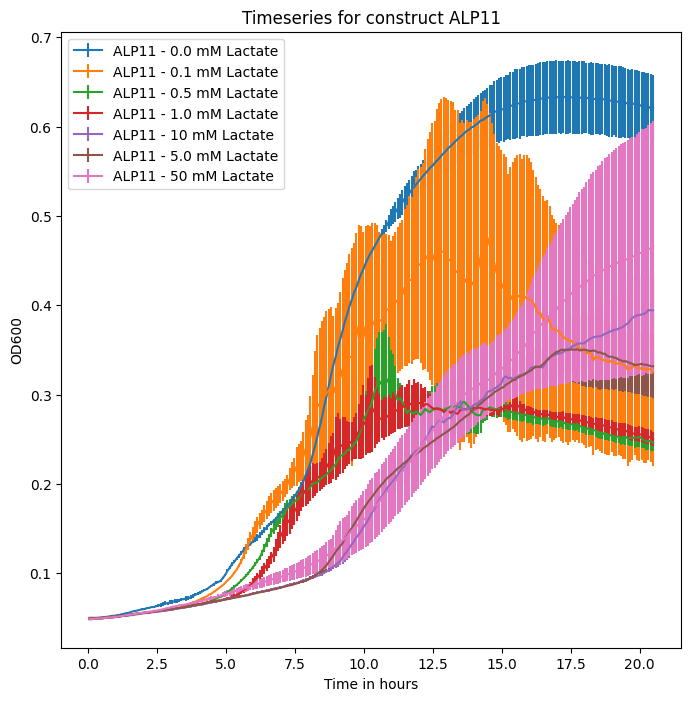

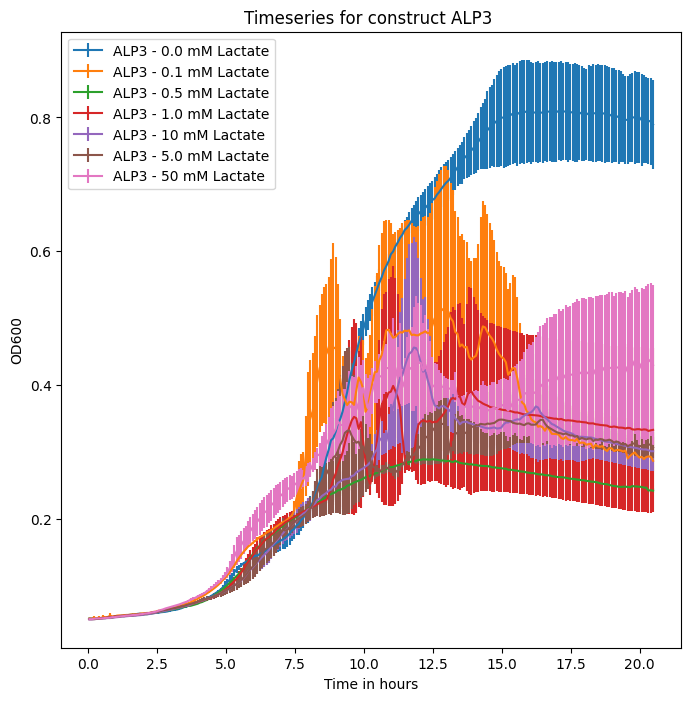

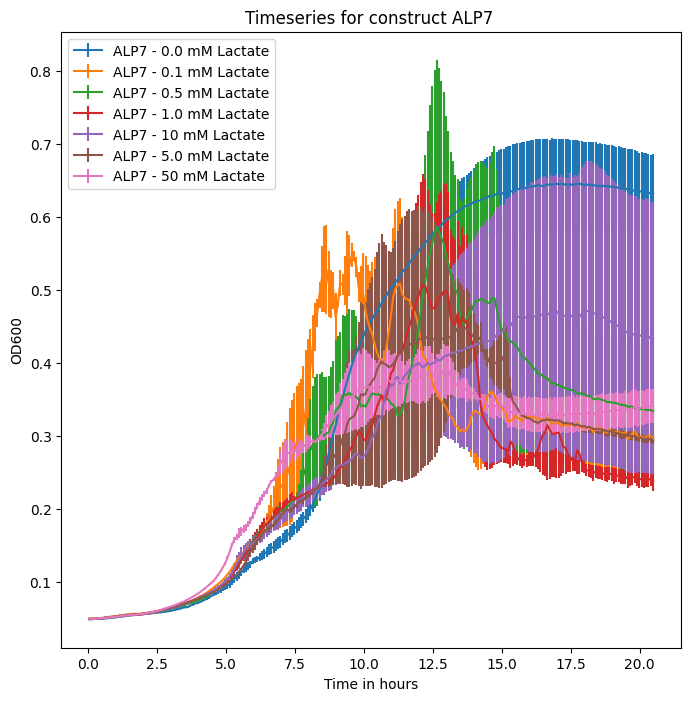

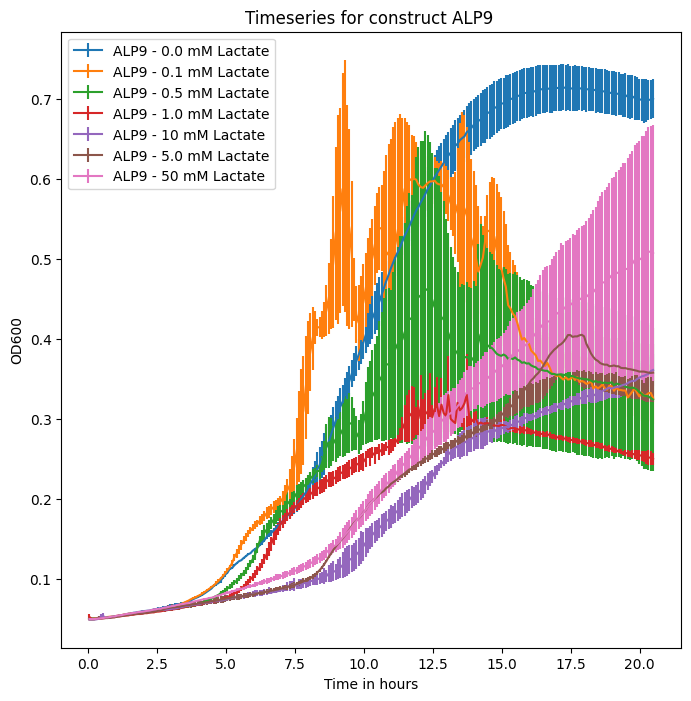

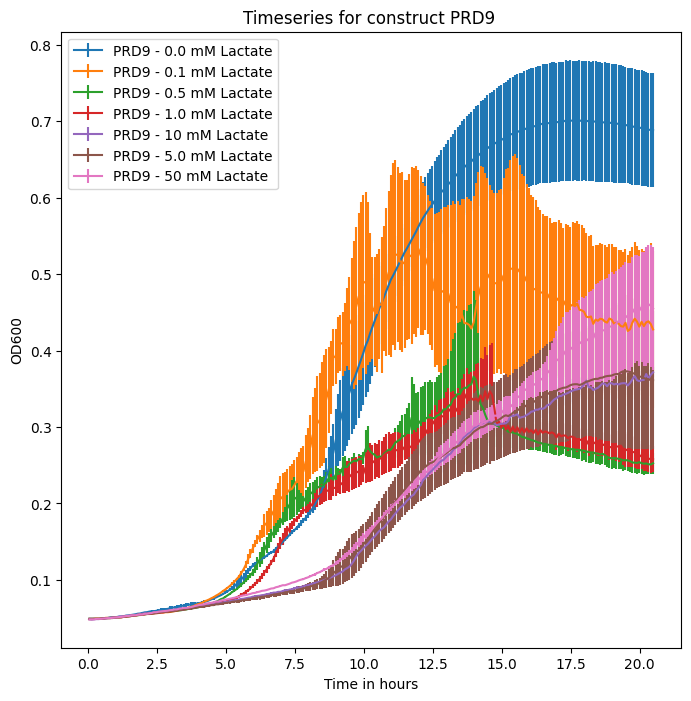

In [9]:
#Plot OD600 for each construct.
for i in range(int(len(FLUOD_avg[0])/7)):
    plt.figure(figsize=(8,8))
    for j in range(7):
        plt.errorbar(time, OD_avg[:,i*7+j], yerr=OD_std[:,i*7+j], label=labels[i*7+j])
    plt.title(f"Timeseries for construct {labels[i*7][:5]}")
    plt.legend(loc="upper left")
    plt.xlabel('Time in hours')
    plt.ylabel('OD600')
    plt.show()

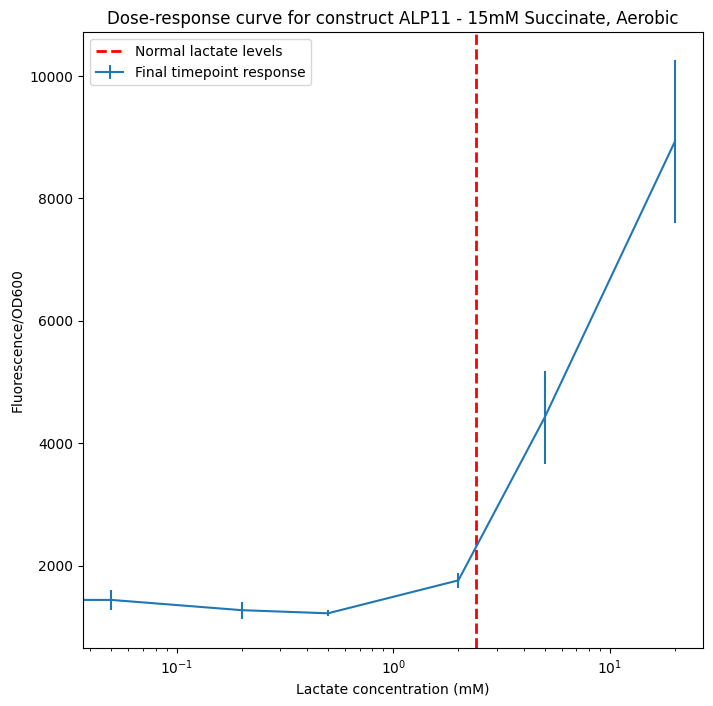

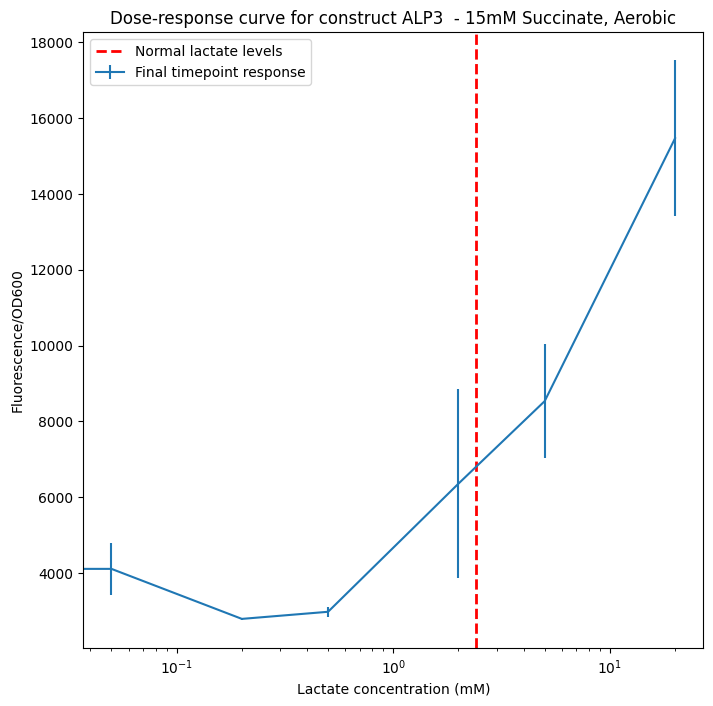

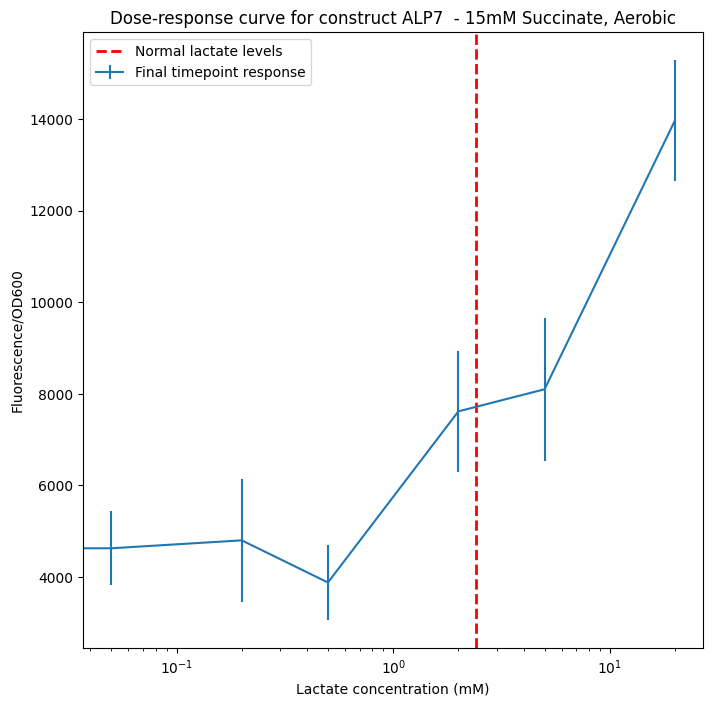

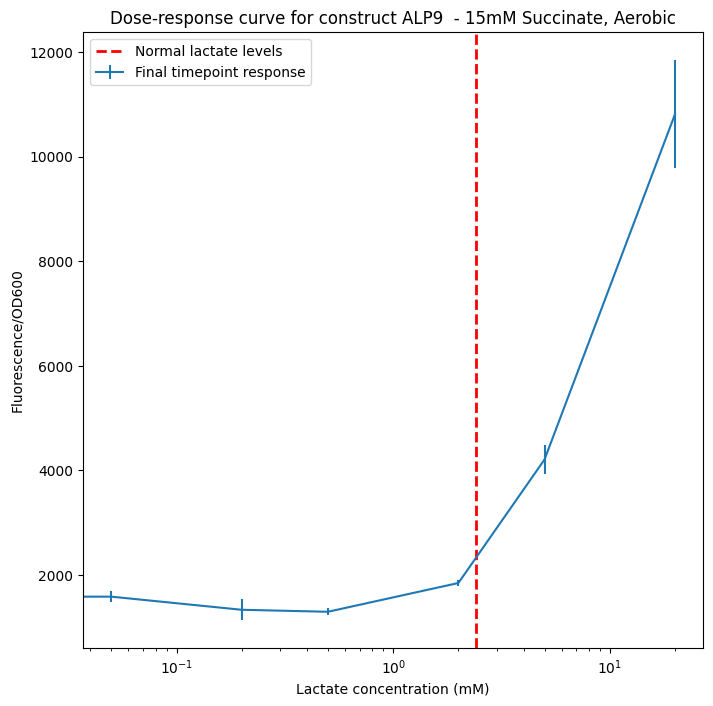

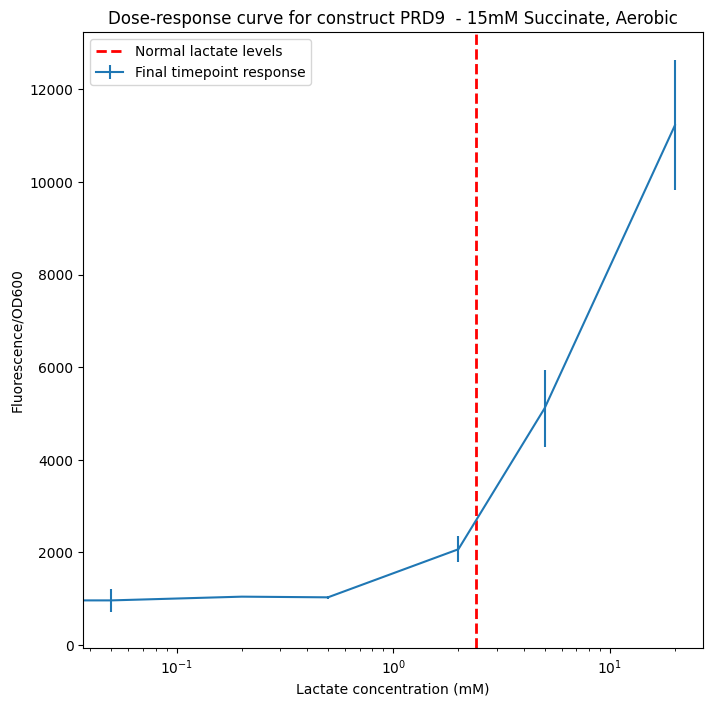

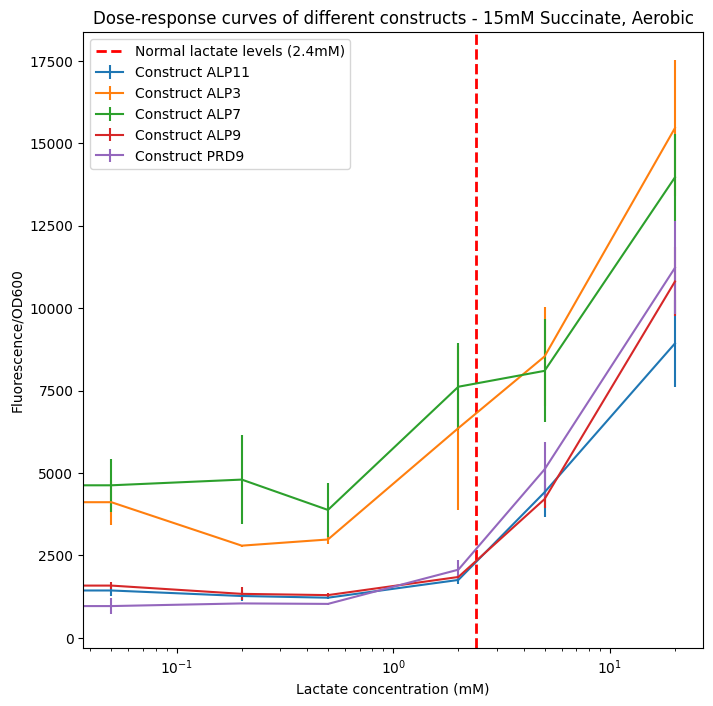

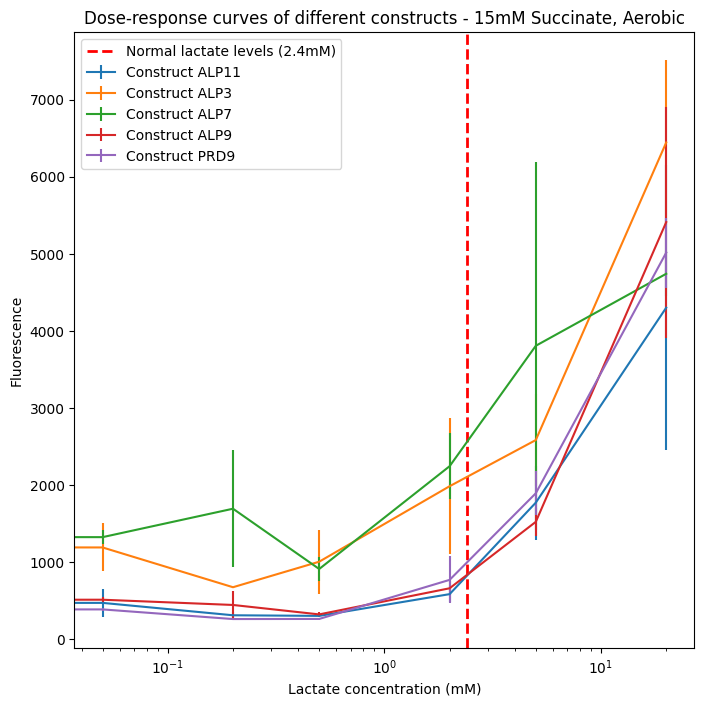

In [10]:
#Plot dose_response curves
for i in range(int(len(FLUOD_avg[0])/7)):
    plt.figure(figsize=(8,8))
    response = FLUOD_avg[-1,i*7:i*7+7]
    response_error = FLUOD_std[-1,i*7:i*7+7]

    #Sort response again since labels are weirdly sorted
    response = response[concentrations.argsort()]
    response_error = response_error[concentrations.argsort()]
    
    plt.errorbar(concentrations[concentrations.argsort()], response, yerr=response_error, label="Final timepoint response")
    plt.title(f"Dose-response curve for construct {labels[i*7][:5]} - 15mM Succinate, Aerobic")
    plt.axvline(2.4,ymin =0, ymax=1, label=f"Normal lactate levels", color="red", linestyle="--", linewidth=2)
    plt.xlabel('Lactate concentration (mM)')
    plt.ylabel('Fluorescence/OD600')
    plt.legend(loc="upper left")
    plt.xscale('log')
    plt.show()
    
#Plot all dose_response curves in one figure
plt.figure(figsize=(8,8))
for i in range(int(len(FLUOD_avg[0])/7)):
    response = FLUOD_avg[-1,i*7:i*7+7]
    response_error = FLUOD_std[-1,i*7:i*7+7]

    #Sort response again since labels are weirdly sorted
    response = response[concentrations.argsort()]
    response_error = response_error[concentrations.argsort()]
    
    plt.errorbar(concentrations[concentrations.argsort()], response, yerr=response_error, label=f"Construct {labels[i*7][:5]}")
plt.title(f"Dose-response curves of different constructs - 15mM Succinate, Aerobic")
plt.axvline(2.4,ymin =0, ymax=1, label=f"Normal lactate levels (2.4mM)", color="red", linestyle="--", linewidth=2)
plt.legend(loc="upper left")
plt.xlabel('Lactate concentration (mM)')
plt.ylabel('Fluorescence/OD600')
plt.xscale('log')
plt.show()

#Plot all dose_response curves in one figure
plt.figure(figsize=(8,8))
for i in range(int(len(FLUOD_avg[0])/7)):
    response = FLU_avg[-1,i*7:i*7+7]
    response_error = FLU_std[-1,i*7:i*7+7]

    #Sort response again since labels are weirdly sorted
    response = response[concentrations.argsort()]
    response_error = response_error[concentrations.argsort()]
    
    plt.errorbar(concentrations[concentrations.argsort()], response, yerr=response_error, label=f"Construct {labels[i*7][:5]}")
plt.title(f"Dose-response curves of different constructs - 15mM Succinate, Aerobic")
plt.axvline(2.4,ymin =0, ymax=1, label=f"Normal lactate levels (2.4mM)", color="red", linestyle="--", linewidth=2)
plt.legend(loc="upper left")
plt.xlabel('Lactate concentration (mM)')
plt.ylabel('Fluorescence')
plt.xscale('log')
plt.show()

## Experiment 3: 22mM Glucose with aerobic conditions

In [11]:
#Load the data
OD_data = pd.read_excel("Data/11-08-2022_EcN_Gluc22mM_GFP_OD600.xlsx", engine='openpyxl', header=0)
FLU_data = pd.read_excel("Data/11-08-2022_EcN_Gluc22mM_GFP_EX479EM510.xlsx", engine='openpyxl', header=0)

#Remove temperature column
OD_data.pop('T° OD600:600')
OD_data['Time'] = OD_data['Time']/3600
FLU_data.pop('T° GFP:479,510')
FLU_data['Time'] = FLU_data['Time']/3600

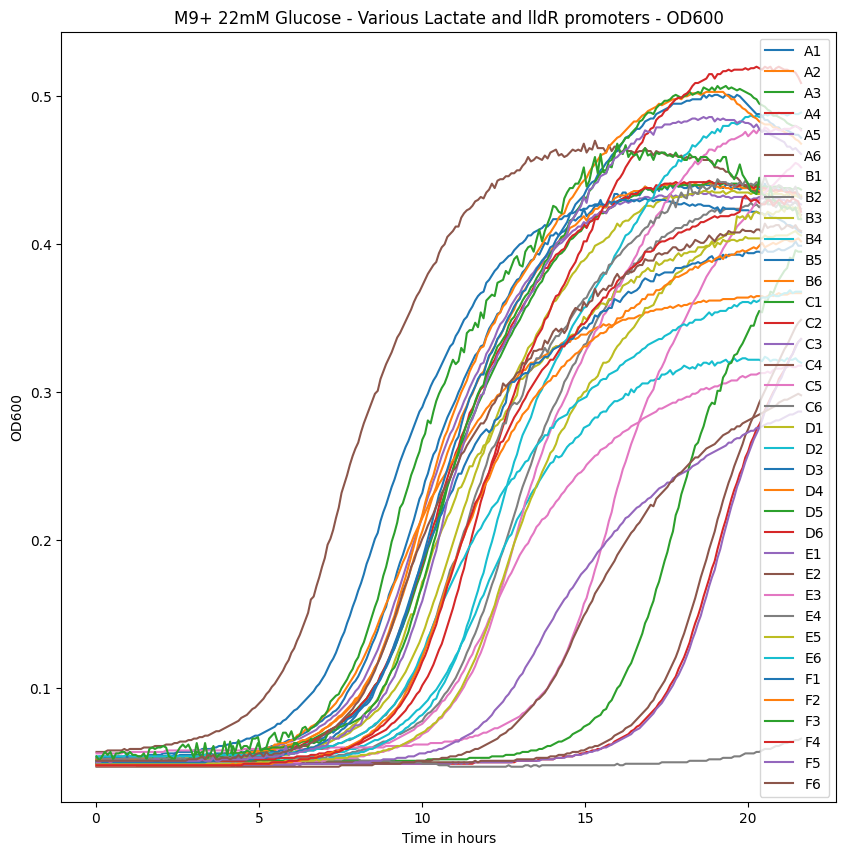

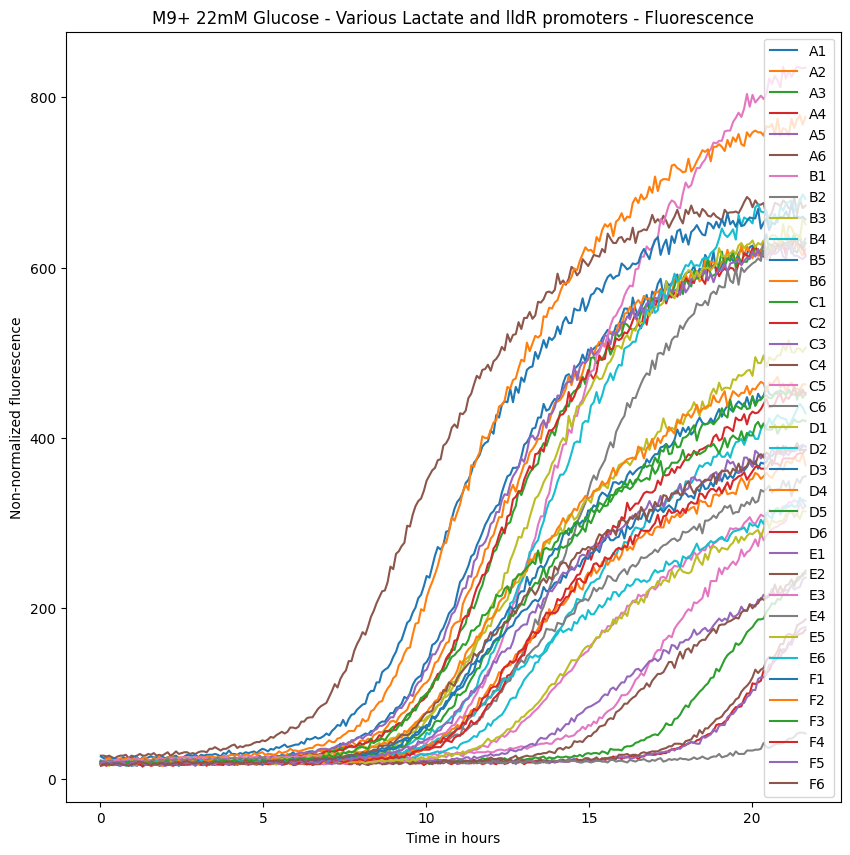

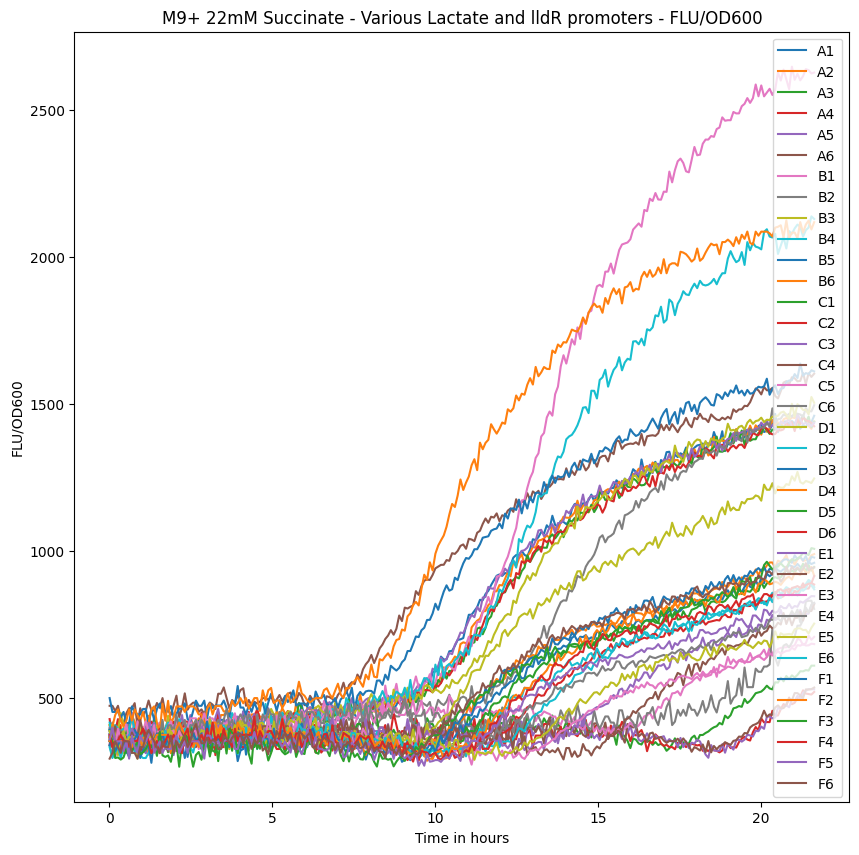

In [12]:
data_OD = OD_data.iloc[:,1:].to_numpy()
data_FLU = FLU_data.iloc[:,1:].to_numpy()

#Correction Vittorio uses
#data_OD = data_OD-np.min(data_OD)
#data_OD = data_OD/0.23+0.02

data_FLUOD = data_FLU/data_OD

time = OD_data.iloc[:,0]

plt.figure(figsize=(10,10))
plt.plot(time, data_OD, label=OD_data.columns[1:])
plt.ylabel('OD600')
plt.xlabel('Time in hours')
plt.title('M9+ 22mM Glucose - Various Lactate and lldR promoters - OD600')
plt.legend()
plt.show()

plt.figure(figsize=(10,10))
plt.plot(time, data_FLU, label=OD_data.columns[1:])
plt.ylabel('Non-normalized fluorescence')
plt.xlabel('Time in hours')
plt.title('M9+ 22mM Glucose - Various Lactate and lldR promoters - Fluorescence')
plt.legend()
plt.show()

plt.figure(figsize=(10,10))
plt.plot(time, data_FLUOD, label=OD_data.columns[1:])
plt.ylabel('FLU/OD600')
plt.xlabel('Time in hours')
plt.title('M9+ 22mM Succinate - Various Lactate and lldR promoters - FLU/OD600')
plt.legend()
plt.show()

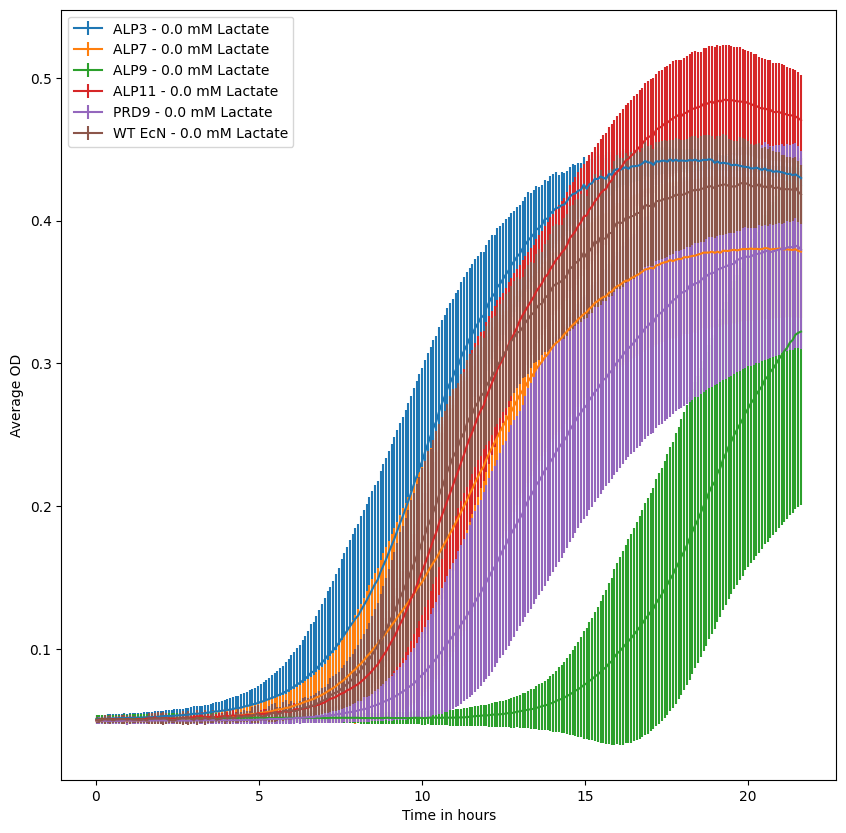

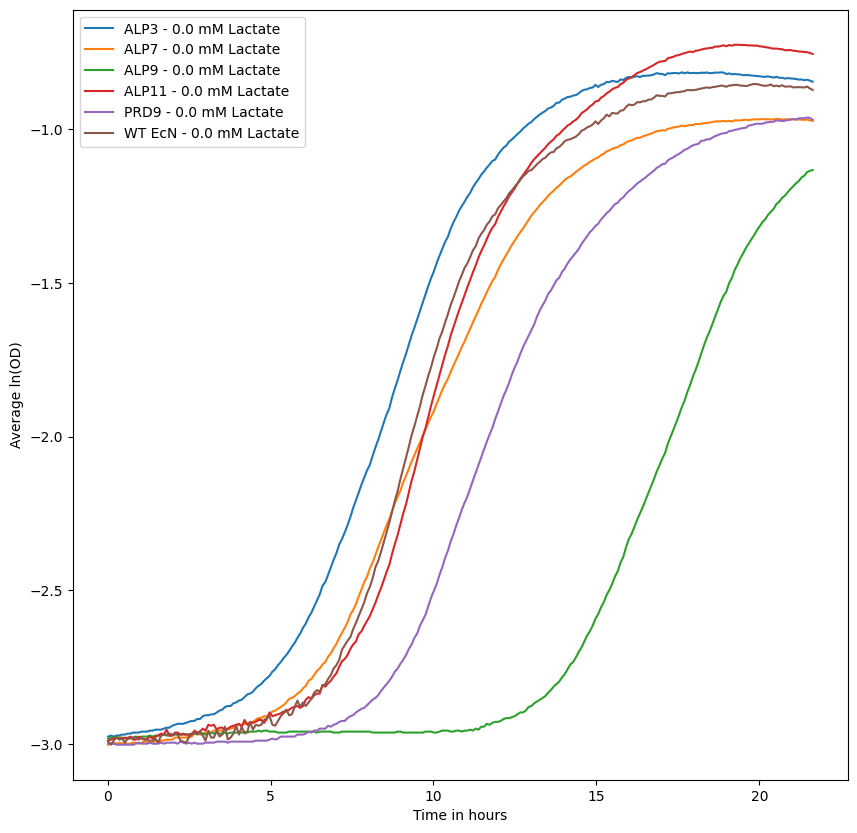

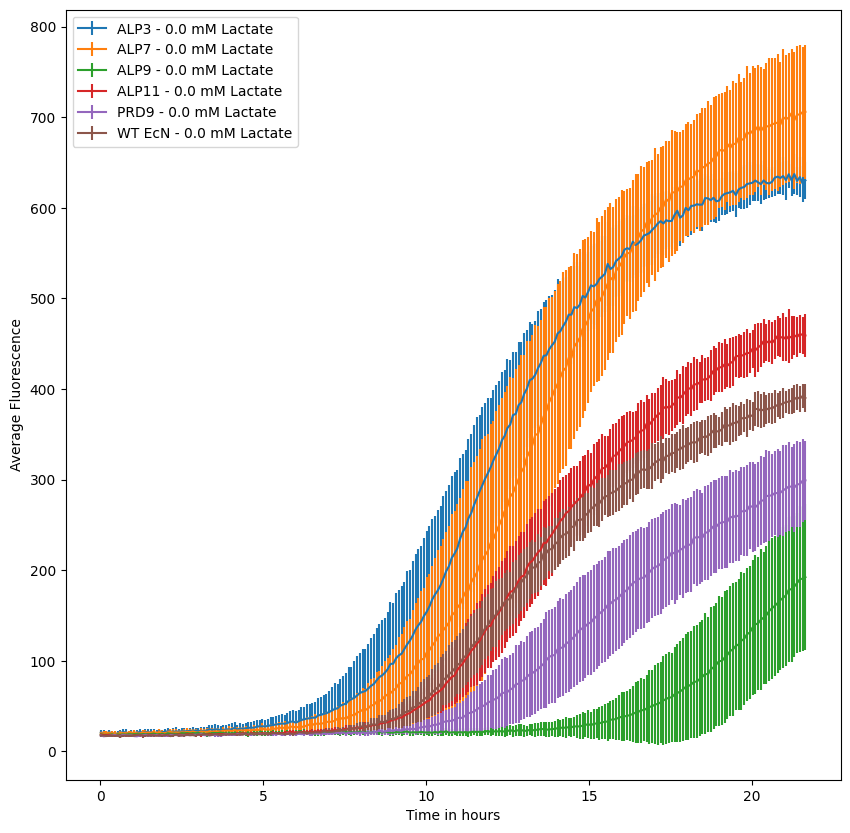

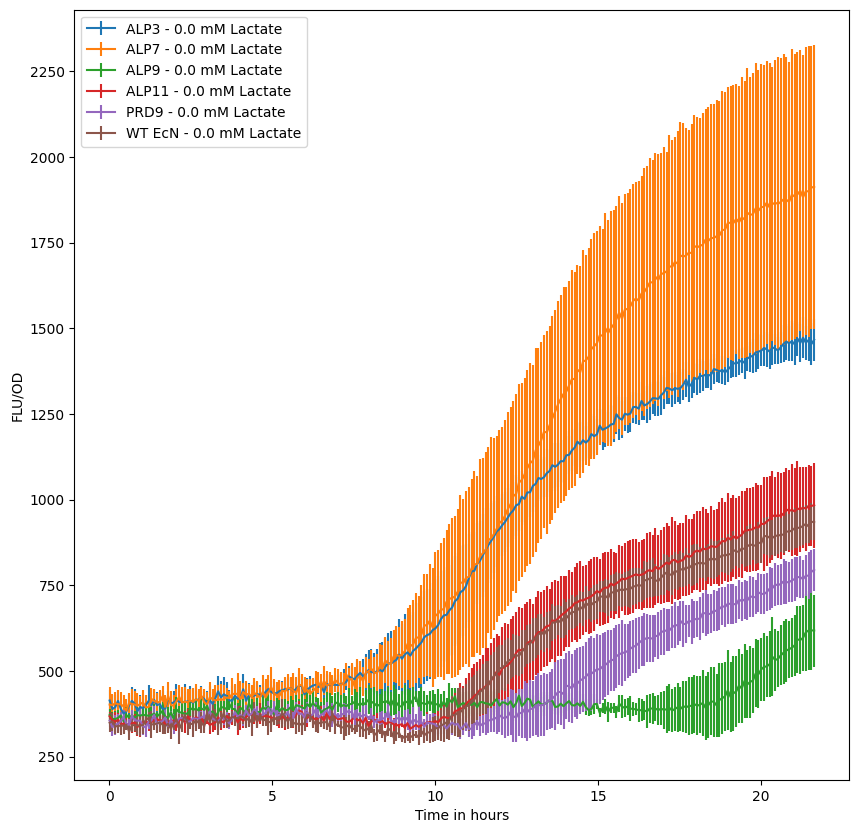

In [13]:
#Specify number of replicates
replicates = 6

OD_avg3= np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
OD_std3 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLU_avg3 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLU_std3 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLUOD_avg3 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLUOD_std3 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))

for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        #Calculate average and stdev
        #Some standard deviations are zero
        OD_avg3[:,index] = np.average(data_OD[:,i:i+replicates], axis=1)
        OD_std3[:,index] = np.std(data_OD[:,i:i+replicates], axis=1)
        
        FLU_avg3[:,index] = np.average(data_FLU[:,i:i+replicates], axis=1)
        FLU_std3[:,index] = np.std(data_FLU[:,i:i+replicates], axis=1)
        
        FLUOD_avg3[:,index] = np.average(data_FLUOD[:,i:i+replicates], axis=1)
        FLUOD_std3[:,index] = np.std(data_FLUOD[:,i:i+replicates], axis=1)

#Plot average OD levels
labels3 = ['ALP3 - 0.0 mM Lactate', 'ALP7 - 0.0 mM Lactate', 'ALP9 - 0.0 mM Lactate', 'ALP11 - 0.0 mM Lactate', 'PRD9 - 0.0 mM Lactate', 'WT EcN - 0.0 mM Lactate']
plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        plt.errorbar(time, OD_avg3[:,index], yerr=OD_std3[:,index], label=labels3[index])
plt.legend(loc="upper left")
plt.ylabel('Average OD')
plt.xlabel('Time in hours')
plt.show()

plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        log = np.log(OD_avg3[:,index])
        plt.plot(time, log, label=labels3[index])
plt.legend(loc="upper left")
plt.ylabel('Average ln(OD)')
plt.xlabel('Time in hours')
plt.show()


plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        plt.errorbar(time, FLU_avg3[:,index], yerr=FLU_std3[:,index], label=labels3[index])
plt.legend(loc="upper left")
plt.ylabel('Average Fluorescence')
plt.xlabel('Time in hours')
plt.show()

plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        plt.errorbar(time, FLUOD_avg3[:,index], yerr=FLUOD_std3[:,index], label=labels3[index])
plt.legend(loc="upper left")
plt.ylabel('FLU/OD')
plt.xlabel('Time in hours')
plt.show()

## Experiment 4 - 22mM Glucose + Various lactate concentrations

In [14]:
#Load the data
OD_data = pd.read_excel("Data/12-08-2022_EcN_Gluc22mM_Lactate_GFP_OD600.xlsx", engine='openpyxl', header=0)
FLU_data = pd.read_excel("Data/12-08-2022_EcN_Gluc22mM_Lactate_GFP_EX479EM510.xlsx", engine='openpyxl', header=0)

#Remove temperature column
OD_data.pop('T° OD600:600')
OD_data['Time'] = OD_data['Time']/3600
FLU_data.pop('T° GFP:479,510')
FLU_data['Time'] = FLU_data['Time']/3600

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


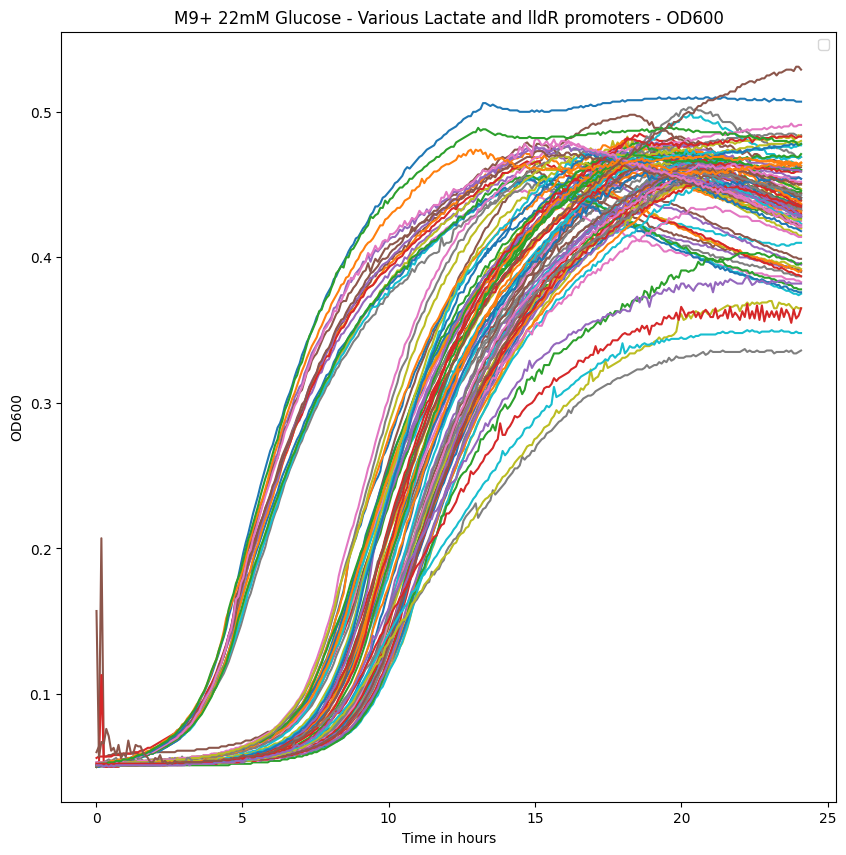

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


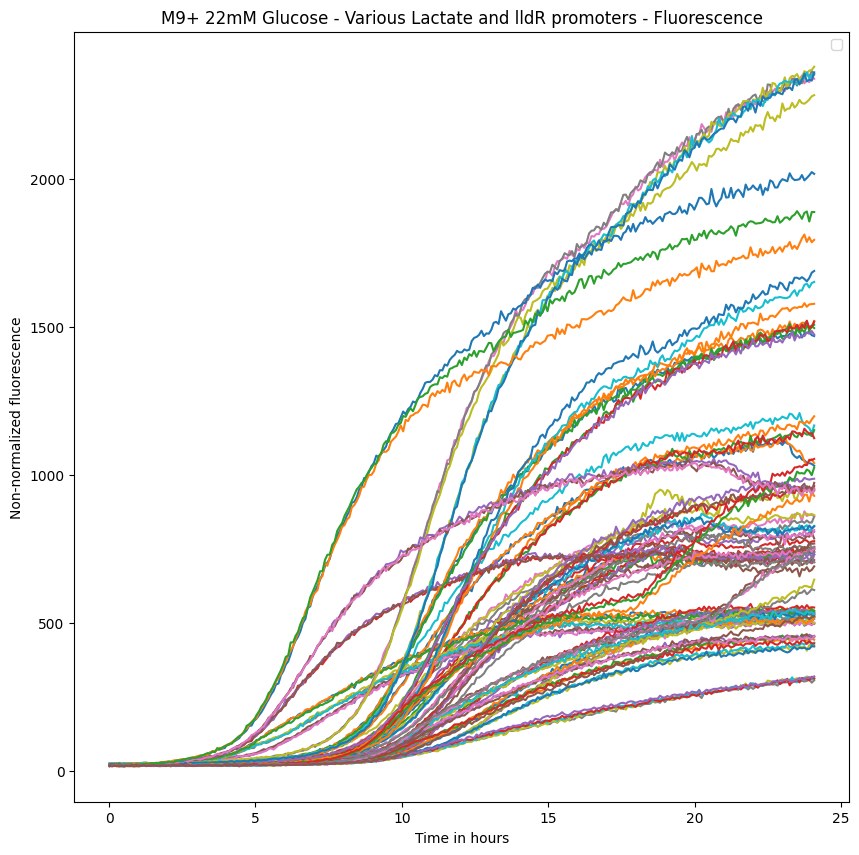

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


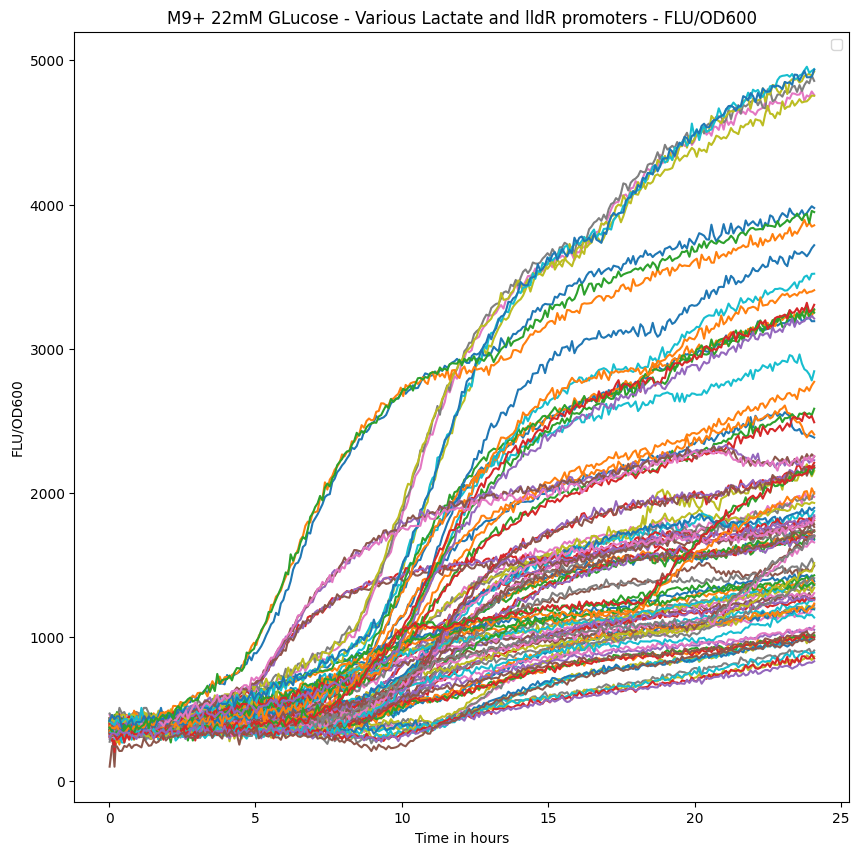

In [15]:
data_OD = OD_data.iloc[:,1:].to_numpy()
data_FLU = FLU_data.iloc[:,1:].to_numpy()

#Correction Vittorio uses
#data_OD = data_OD-np.min(data_OD)
#data_OD = data_OD/0.23+0.02

data_FLUOD = data_FLU/data_OD

time = OD_data.iloc[:,0]

plt.figure(figsize=(10,10))
plt.plot(time, data_OD)#, label=OD_data.columns[1:])
plt.ylabel('OD600')
plt.xlabel('Time in hours')
plt.title('M9+ 22mM Glucose - Various Lactate and lldR promoters - OD600')
plt.legend()
plt.show()

plt.figure(figsize=(10,10))
plt.plot(time, data_FLU)#, label=OD_data.columns[1:])
plt.ylabel('Non-normalized fluorescence')
plt.xlabel('Time in hours')
plt.title('M9+ 22mM Glucose - Various Lactate and lldR promoters - Fluorescence')
plt.legend()
plt.show()

plt.figure(figsize=(10,10))
plt.plot(time, data_FLUOD)#, label=OD_data.columns[1:])
plt.ylabel('FLU/OD600')
plt.xlabel('Time in hours')
plt.title('M9+ 22mM GLucose - Various Lactate and lldR promoters - FLU/OD600')
plt.legend()
plt.show()

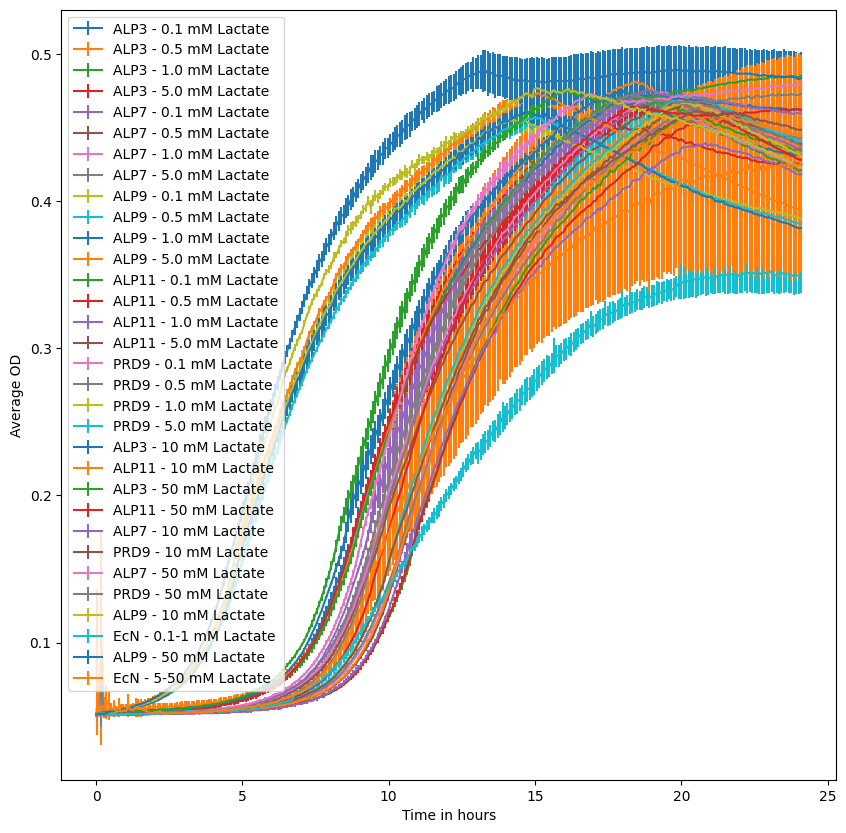

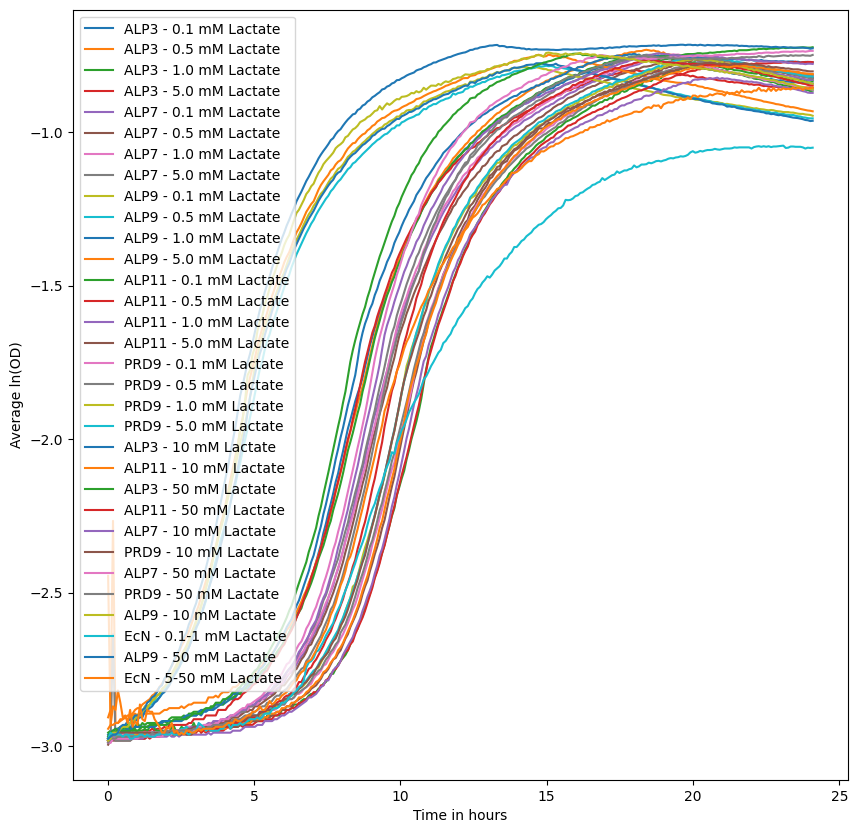

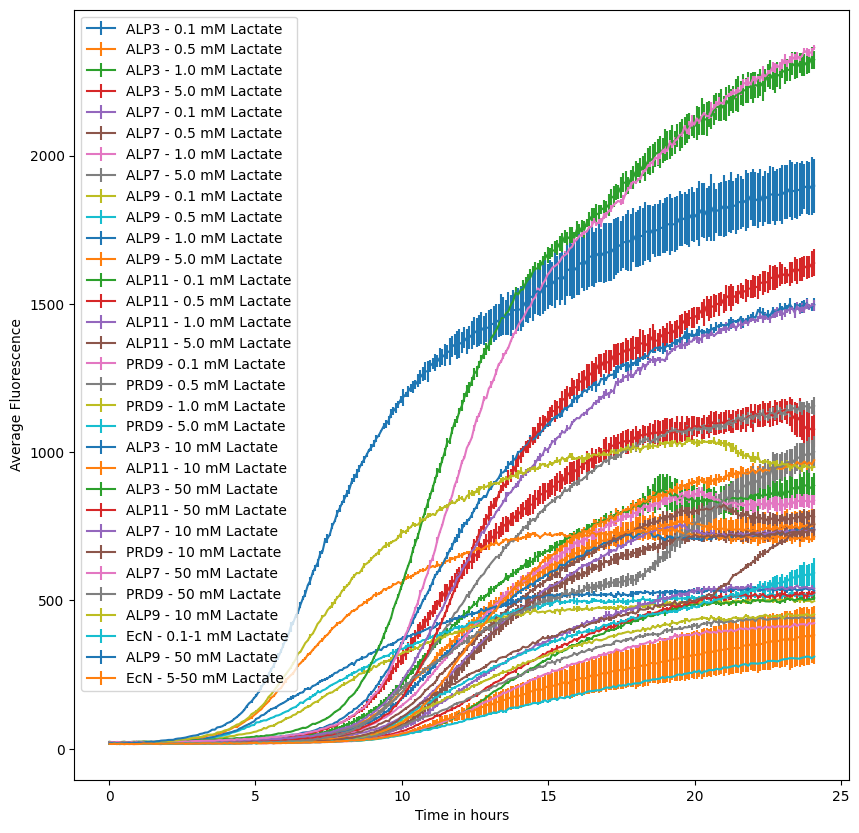

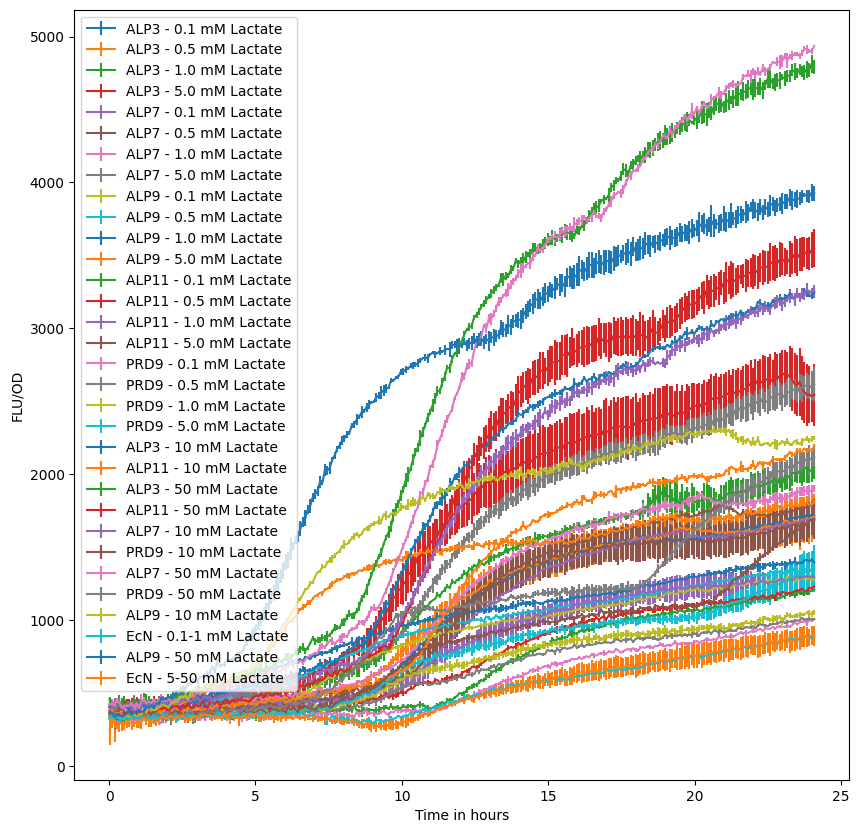

In [16]:
#Specify number of replicates
replicates = 3

OD_avg4 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
OD_std4 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLU_avg4 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLU_std4 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLUOD_avg4 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLUOD_std4 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))

for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        #Calculate average and stdev
        #Some standard deviations are zero
        OD_avg4[:,index] = np.average(data_OD[:,i:i+replicates], axis=1)
        OD_std4[:,index] = np.std(data_OD[:,i:i+replicates], axis=1)
        
        FLU_avg4[:,index] = np.average(data_FLU[:,i:i+replicates], axis=1)
        FLU_std4[:,index] = np.std(data_FLU[:,i:i+replicates], axis=1)
        
        FLUOD_avg4[:,index] = np.average(data_FLUOD[:,i:i+replicates], axis=1)
        FLUOD_std4[:,index] = np.std(data_FLUOD[:,i:i+replicates], axis=1)
#Plot average OD levels
labels4 = ['ALP3 - 0.1 mM Lactate',
          'ALP3 - 0.5 mM Lactate',
          'ALP3 - 1.0 mM Lactate',
          'ALP3 - 5.0 mM Lactate',
          'ALP7 - 0.1 mM Lactate',
          'ALP7 - 0.5 mM Lactate',
          'ALP7 - 1.0 mM Lactate',
          'ALP7 - 5.0 mM Lactate',
          'ALP9 - 0.1 mM Lactate',
          'ALP9 - 0.5 mM Lactate',
          'ALP9 - 1.0 mM Lactate',
          'ALP9 - 5.0 mM Lactate',
          'ALP11 - 0.1 mM Lactate',
          'ALP11 - 0.5 mM Lactate',
          'ALP11 - 1.0 mM Lactate',
          'ALP11 - 5.0 mM Lactate',
          'PRD9 - 0.1 mM Lactate',
          'PRD9 - 0.5 mM Lactate',
          'PRD9 - 1.0 mM Lactate',
          'PRD9 - 5.0 mM Lactate',
          'ALP3 - 10 mM Lactate',
          'ALP11 - 10 mM Lactate',
          'ALP3 - 20 mM Lactate',
          'ALP11 - 20 mM Lactate',
          'ALP7 - 10 mM Lactate',
          'PRD9 - 10 mM Lactate',
          'ALP7 - 20 mM Lactate',
          'PRD9 - 20 mM Lactate',
          'ALP9 - 10 mM Lactate',
          'EcN - 0.1-1 mM Lactate',
          'ALP9 - 20 mM Lactate',
          'EcN - 5-20 mM Lactate']


plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        plt.errorbar(time, OD_avg4[:,index], yerr=OD_std4[:,index], label=labels4[index])
plt.legend(loc="upper left")
plt.ylabel('Average OD')
plt.xlabel('Time in hours')
plt.show()

plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        log = np.log(OD_avg4[:,index])
        plt.plot(time, log, label=labels4[index])
plt.legend(loc="upper left")
plt.ylabel('Average ln(OD)')
plt.xlabel('Time in hours')
plt.show()

plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        plt.errorbar(time, FLU_avg4[:,index], yerr=FLU_std4[:,index], label=labels4[index])
plt.legend(loc="upper left")
plt.ylabel('Average Fluorescence')
plt.xlabel('Time in hours')
plt.show()

plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        plt.errorbar(time, FLUOD_avg4[:,index], yerr=FLUOD_std4[:,index], label=labels4[index])
plt.legend(loc="upper left")
plt.ylabel('FLU/OD')
plt.xlabel('Time in hours')
plt.show()

In [17]:
#Add data from both experiments together
labels = np.array(labels3+labels4)
time = time[:-35]

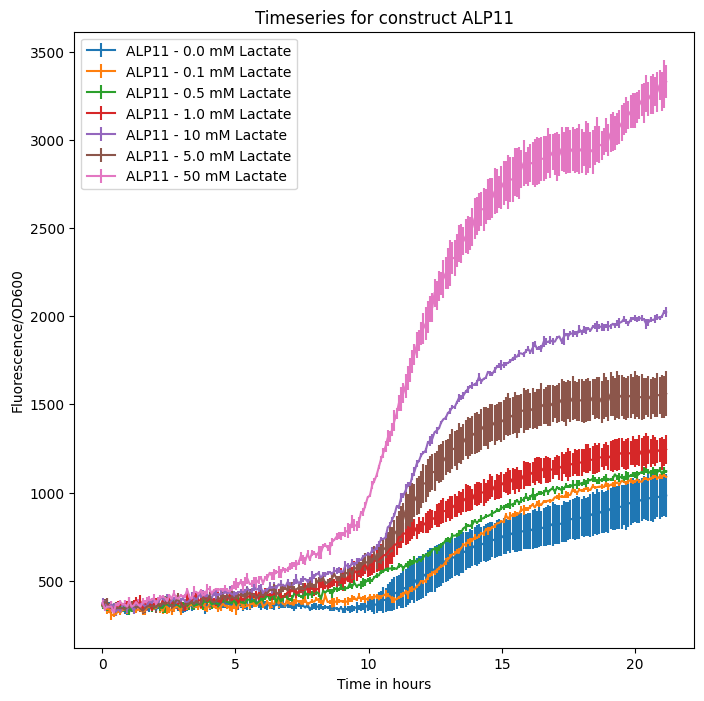

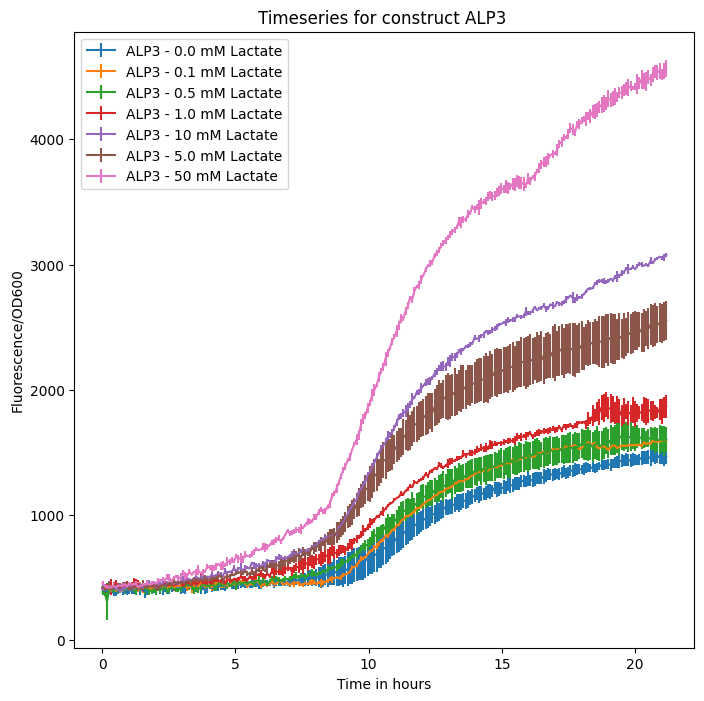

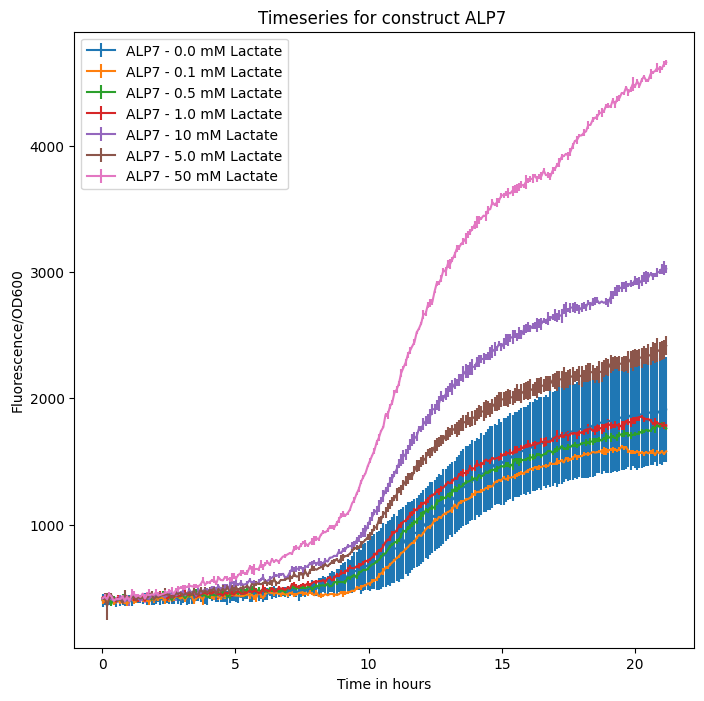

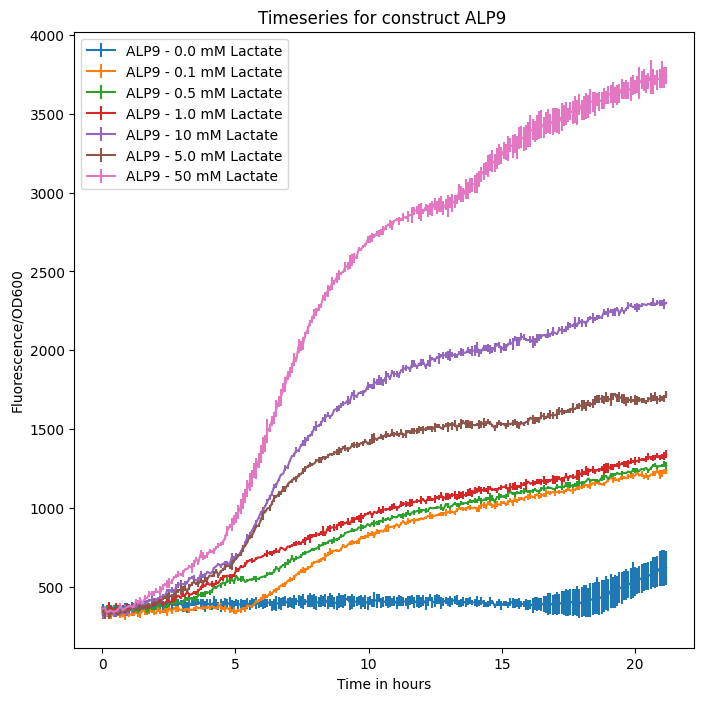

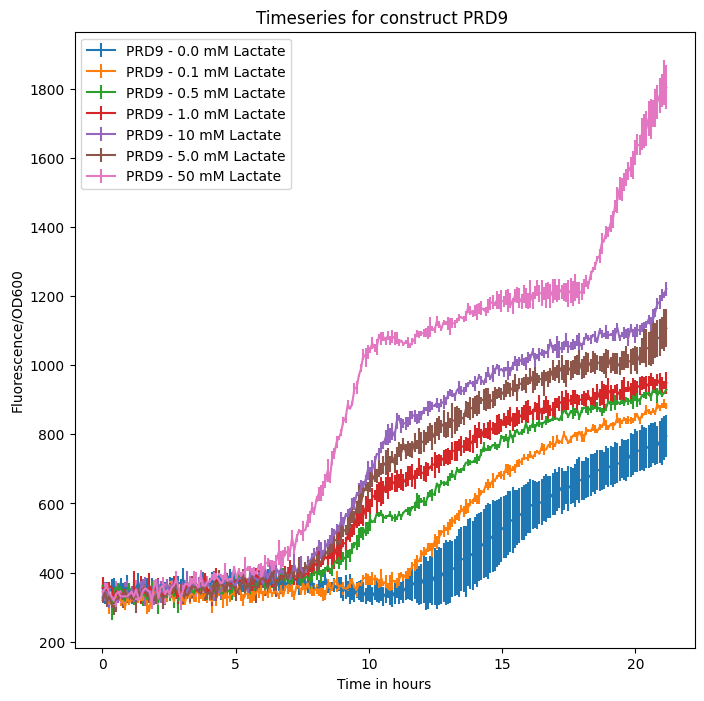

...

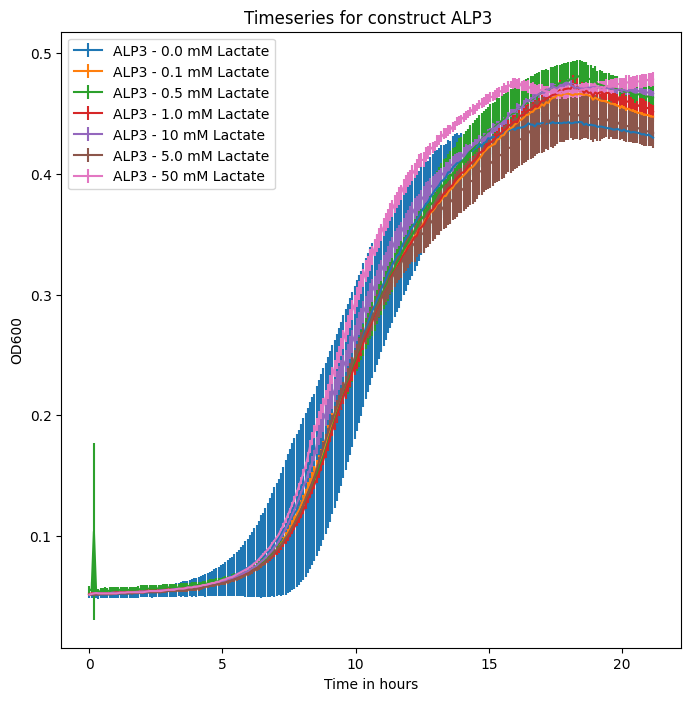

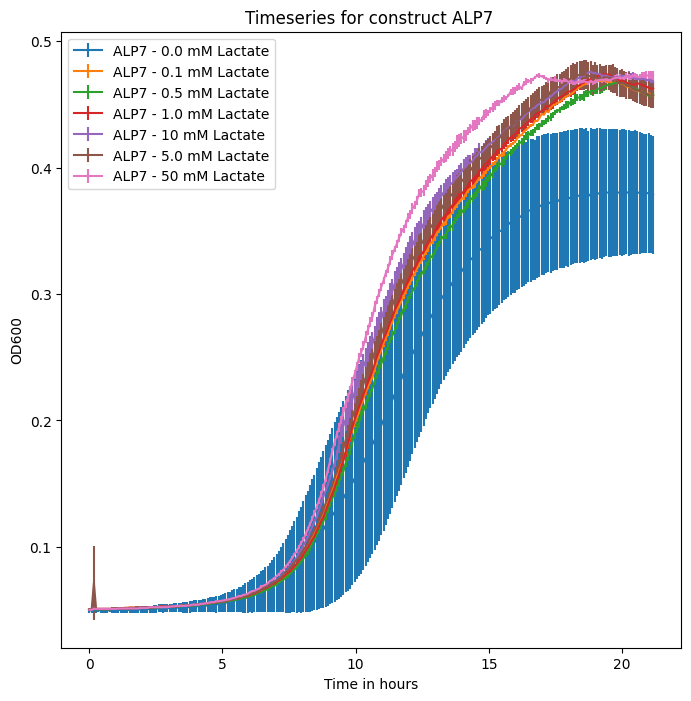

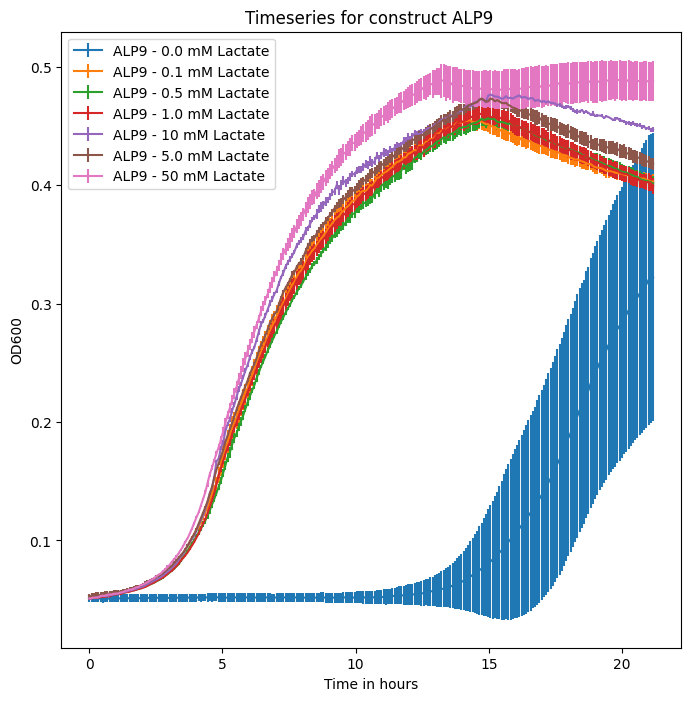

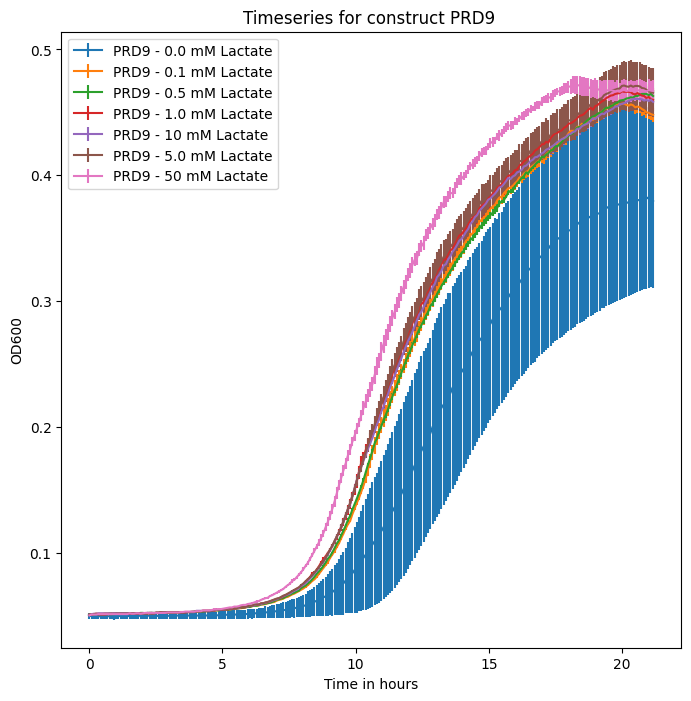

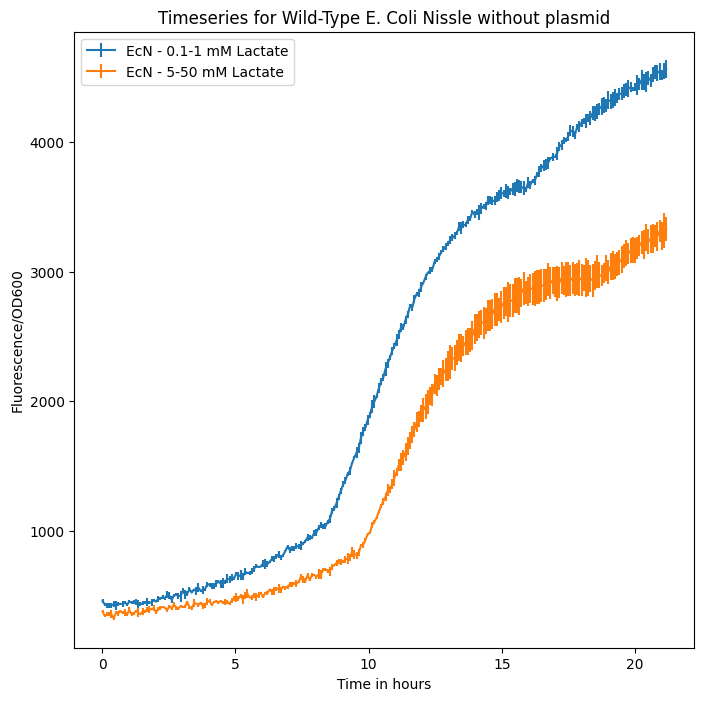

In [18]:
sort_index = labels.argsort()
#Sort everything on label
labels = labels[sort_index]
wt_index = np.flatnonzero(np.core.defchararray.find(labels,"EcN")!=-1)
wt_labels = labels[wt_index]

#Remove WT from labels, data to not interfere with dose-response curves
labels = np.delete(labels, wt_index)
sort_index = np.delete(sort_index, wt_index)
#Concentrations are not in order because argsort doesnt sort the numbers in a string correctly
#concentrations = np.array([0,0.1,0.5,1,10,5,20])
concentrations = np.array([0,0.05,0.2,0.5,5,2,20])

FLUOD_avg_glc_aer = np.column_stack((FLUOD_avg3,FLUOD_avg4[:-35]))
FLUOD_std_glc_aer = np.column_stack((FLUOD_std3,FLUOD_std4[:-35]))

FLU_avg_glc_aer = np.column_stack((FLU_avg3,FLU_avg4[:-35]))
FLU_std_glc_aer = np.column_stack((FLU_std3,FLU_std4[:-35]))

OD_avg_glc_aer = np.column_stack((OD_avg3,OD_avg4[:-35]))
OD_std_glc_aer = np.column_stack((OD_std3,OD_std4[:-35]))

WT_avg_glc_aer = FLUOD_avg_glc_aer[:,wt_index]
WT_std_glc_aer = FLUOD_std_glc_aer[:,wt_index]

FLUOD_avg_glc_aer = FLUOD_avg_glc_aer[:,sort_index]
FLUOD_std_glc_aer = FLUOD_std_glc_aer[:,sort_index]
FLU_avg_glc_aer = FLU_avg_glc_aer[:,sort_index]
FLU_std_glc_aer = FLU_std_glc_aer[:,sort_index]
OD_avg_glc_aer = OD_avg_glc_aer[:,sort_index]
OD_std_glc_aer = OD_std_glc_aer[:,sort_index]

for i in range(int(len(FLUOD_avg_glc_aer[0])/7)):
    plt.figure(figsize=(8,8))
    for j in range(7):
        plt.errorbar(time, FLUOD_avg_glc_aer[:,i*7+j], yerr=FLUOD_std_glc_aer[:,i*7+j], label=labels[i*7+j])
    plt.title(f"Timeseries for construct {labels[i*7][:5]}")
    plt.legend(loc="upper left")
    plt.xlabel('Time in hours')
    plt.ylabel('Fluorescence/OD600')
    plt.show()

for i in range(int(len(FLUOD_avg_glc_aer[0])/7)):
    plt.figure(figsize=(8,8))
    for j in range(7):
        plt.errorbar(time, OD_avg_glc_aer[:,i*7+j], yerr=OD_std_glc_aer[:,i*7+j], label=labels[i*7+j])
    plt.title(f"Timeseries for construct {labels[i*7][:5]}")
    plt.legend(loc="upper left")
    plt.xlabel('Time in hours')
    plt.ylabel('OD600')
    plt.show()
    
#Plot the wild-type time-series
plt.figure(figsize=(8,8))
for j in range(len(wt_labels)-1):
    plt.errorbar(time, WT_avg_glc_aer[:,j], yerr=WT_std_glc_aer[:,j], label=wt_labels[j])
plt.title(f"Timeseries for Wild-Type E. Coli Nissle without plasmid")
plt.legend(loc="upper left")
plt.xlabel('Time in hours')
plt.ylabel('Fluorescence/OD600')
plt.show()

#Save data
header_list = [x for x in labels]
header_list.insert(0,'Time(h)')

#Create dataframes.
Glucose_aerobic_OD_processed = pd.DataFrame(np.column_stack((time,OD_avg_glc_aer)), columns=header_list)
Glucose_aerobic_FLU_processed = pd.DataFrame(np.column_stack((time,FLU_avg_glc_aer)), columns=header_list)
Glucose_aerobic_FLUOD_processed = pd.DataFrame(np.column_stack((time,FLUOD_avg_glc_aer)), columns=header_list)
Glucose_aerobic_OD_std_processed = pd.DataFrame(np.column_stack((time,OD_std_glc_aer)), columns=header_list)
Glucose_aerobic_FLU_std_processed = pd.DataFrame(np.column_stack((time,FLU_std_glc_aer)), columns=header_list)
Glucose_aerobic_FLUOD_std_processed = pd.DataFrame(np.column_stack((time,FLUOD_std_glc_aer)), columns=header_list)

#Sort labels and restructure data accordingly.
header = sorted_nicely(labels)
header.insert(0,'Time(h)')
# print(f"Sorted header list:{header}\n\n")
# print(Glucose_aerobic_OD_processed.head())
Glucose_aerobic_OD_processed = Glucose_aerobic_OD_processed[header]
# print(Glucose_aerobic_OD_processed.head())
Glucose_aerobic_FLU_processed = Glucose_aerobic_FLU_processed[header]
Glucose_aerobic_FLUOD_processed = Glucose_aerobic_FLUOD_processed[header]
Glucose_aerobic_OD_std_processed = Glucose_aerobic_OD_std_processed[header]
Glucose_aerobic_FLU_std_processed = Glucose_aerobic_FLU_std_processed[header]
Glucose_aerobic_FLUOD_std_processed = Glucose_aerobic_FLUOD_std_processed[header]

Glucose_aerobic_OD_processed.to_csv('Data/22mMGlucose_aerobic_OD_processed.csv',index=False)
Glucose_aerobic_FLU_processed.to_csv('Data/22mMGlucose_aerobic_FLU_processed.csv', index=False)
Glucose_aerobic_FLUOD_processed.to_csv('Data/22mMGlucose_aerobic_FLUOD_processed.csv', index=False)
Glucose_aerobic_OD_std_processed.to_csv('Data/22mMGlucose_aerobic_OD_std_processed.csv', index=False)
Glucose_aerobic_FLU_std_processed.to_csv('Data/22mMGlucose_aerobic_FLU_std_processed.csv', index=False)
Glucose_aerobic_FLUOD_std_processed.to_csv('Data/22mMGlucose_aerobic_FLUOD_std_processed.csv', index=False)

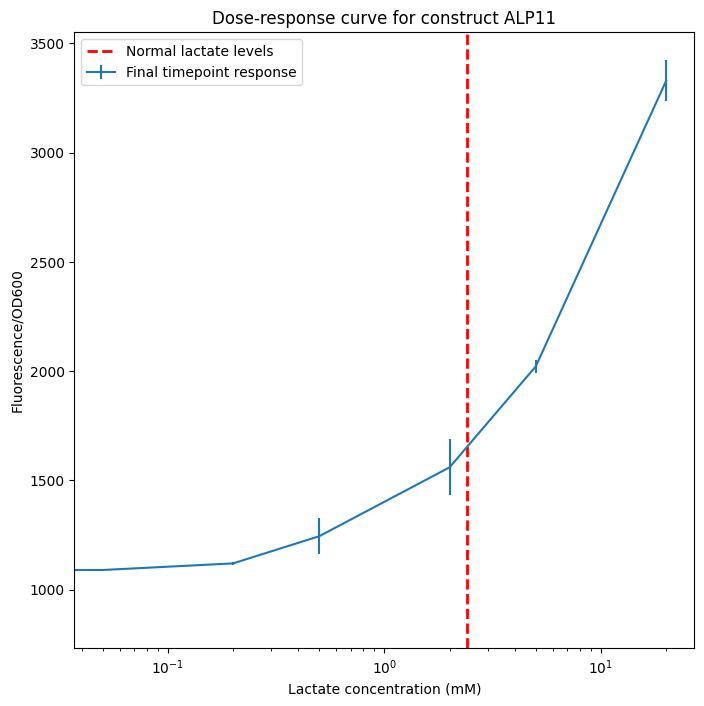

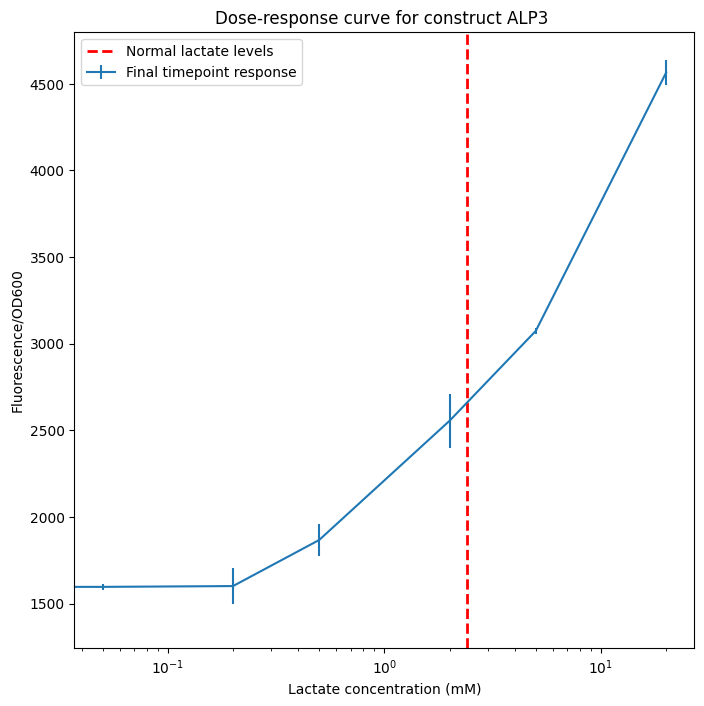

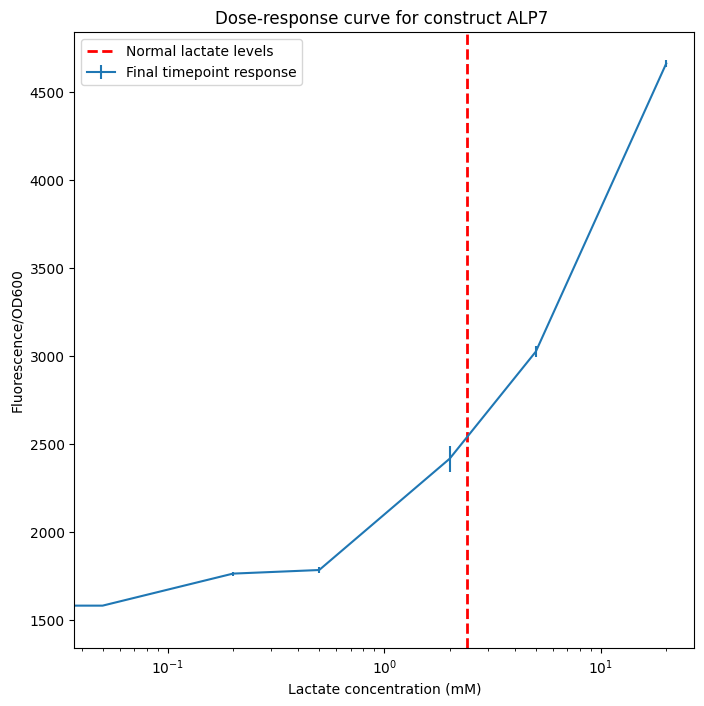

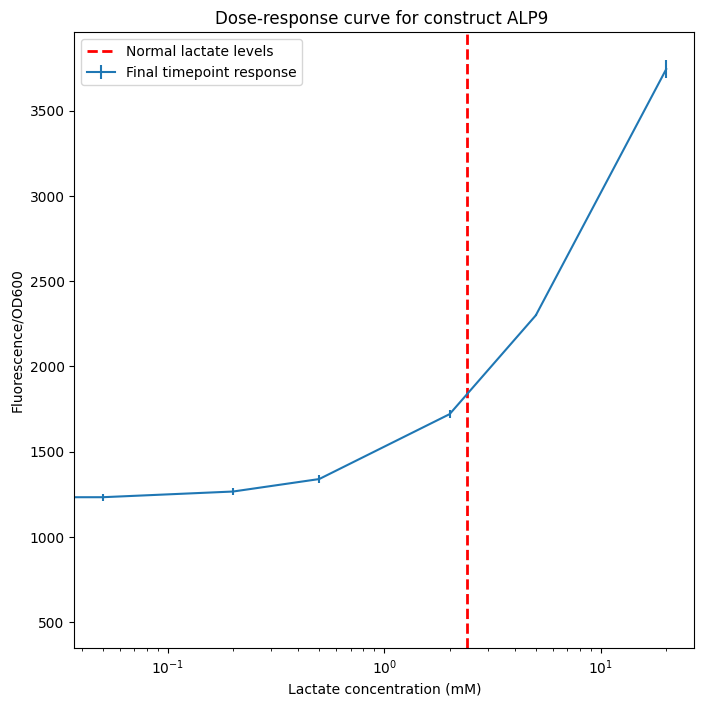

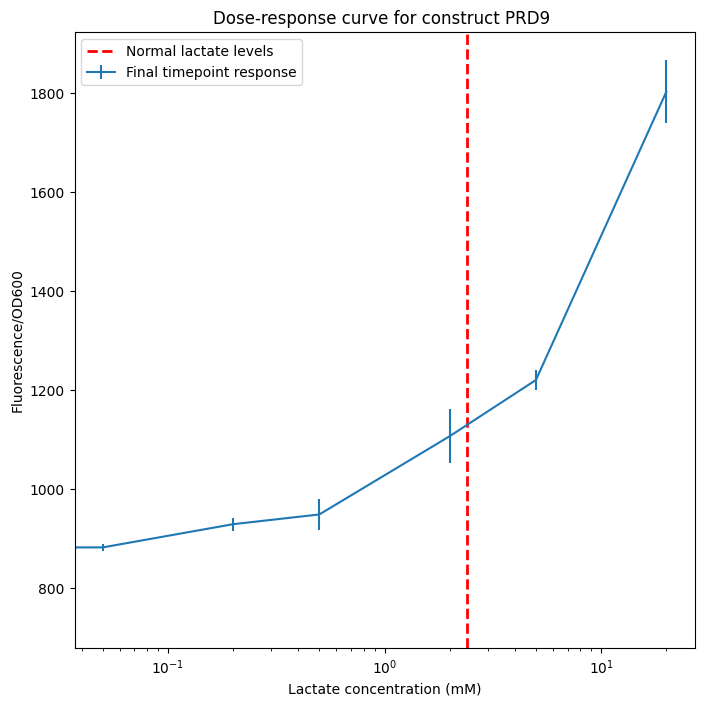

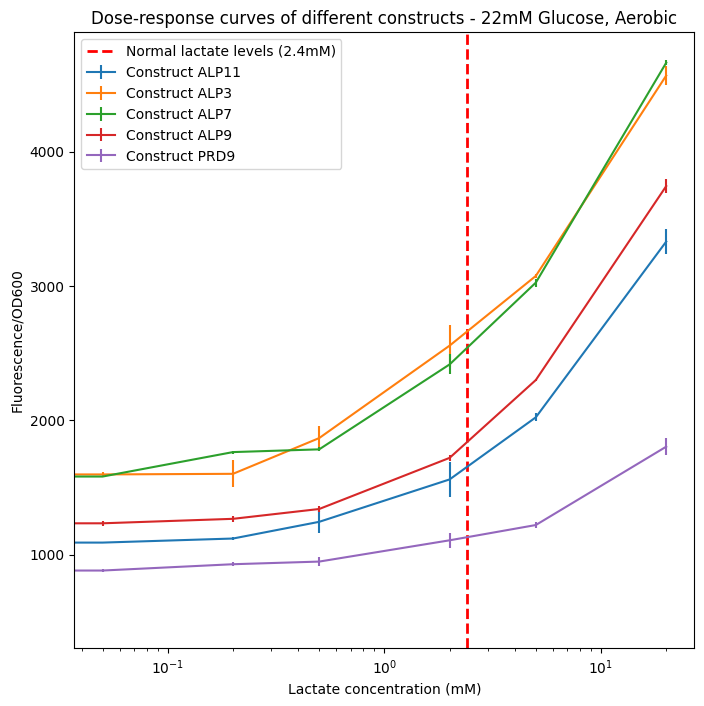

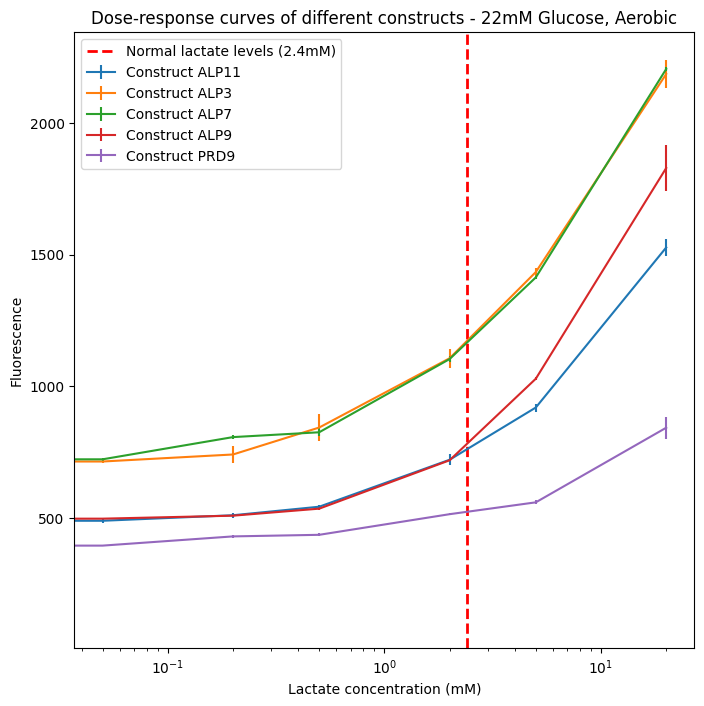

In [19]:
#Plot dose_response curves
for i in range(int(len(FLUOD_avg_glc_aer[0])/7)):
    plt.figure(figsize=(8,8))
    response = FLUOD_avg_glc_aer[-1,i*7:i*7+7]
    response_error = FLUOD_std_glc_aer[-1,i*7:i*7+7]

    #Sort response again since labels are weirdly sorted
    response = response[concentrations.argsort()]
    response_error = response_error[concentrations.argsort()]
    
    plt.errorbar(concentrations[concentrations.argsort()], response, yerr=response_error, label="Final timepoint response")
    plt.title(f"Dose-response curve for construct {labels[i*7][:5]}")
    plt.axvline(2.4,ymin =0, ymax=1, label=f"Normal lactate levels", color="red", linestyle="--", linewidth=2)
    plt.xlabel('Lactate concentration (mM)')
    plt.ylabel('Fluorescence/OD600')
    plt.legend(loc="upper left")
    plt.xscale('log')
    plt.show()
    
#Plot all dose_response curves in one figure
plt.figure(figsize=(8,8))
for i in range(int(len(FLUOD_avg_glc_aer[0])/7)):
    response = FLUOD_avg_glc_aer[-1,i*7:i*7+7]
    response_error = FLUOD_std_glc_aer[-1,i*7:i*7+7]

    #Sort response again since labels are weirdly sorted
    response = response[concentrations.argsort()]
    response_error = response_error[concentrations.argsort()]
    
    plt.errorbar(concentrations[concentrations.argsort()], response, yerr=response_error, label=f"Construct {labels[i*7][:5]}")
plt.title(f"Dose-response curves of different constructs - 22mM Glucose, Aerobic")
plt.axvline(2.4,ymin =0, ymax=1, label=f"Normal lactate levels (2.4mM)", color="red", linestyle="--", linewidth=2)
plt.legend(loc="upper left")
plt.xlabel('Lactate concentration (mM)')
plt.ylabel('Fluorescence/OD600')
plt.xscale('log')
plt.show()

#Plot all dose_response curves in one figure
plt.figure(figsize=(8,8))
for i in range(int(len(FLUOD_avg_glc_aer[0])/7)):
    response = FLU_avg_glc_aer[-1,i*7:i*7+7]
    response_error = FLU_std_glc_aer[-1,i*7:i*7+7]

    #Sort response again since labels are weirdly sorted
    response = response[concentrations.argsort()]
    response_error = response_error[concentrations.argsort()]
    
    plt.errorbar(concentrations[concentrations.argsort()], response, yerr=response_error, label=f"Construct {labels[i*7][:5]}")
plt.title(f"Dose-response curves of different constructs - 22mM Glucose, Aerobic")
plt.axvline(2.4,ymin =0, ymax=1, label=f"Normal lactate levels (2.4mM)", color="red", linestyle="--", linewidth=2)
plt.legend(loc="upper left")
plt.xlabel('Lactate concentration (mM)')
plt.ylabel('Fluorescence')
plt.xscale('log')
plt.show()

# Experiment 5: Redo of 15mM Succinate + Lactate, Aerobic

In [20]:
#Load the data
OD_data = pd.read_excel("Data/16-08-2022_EcN_Succ15mM_Lactate_GFP_OD600.xlsx", engine='openpyxl', header=0)
FLU_data = pd.read_excel("Data/16-08-2022_EcN_Succ15mM_Lactate_GFP_EX479EM510.xlsx", engine='openpyxl', header=0)

#Remove temperature column
OD_data.pop('T° OD600:600')
OD_data['Time'] = OD_data['Time']/3600
FLU_data.pop('T° GFP:479,510')
FLU_data['Time'] = FLU_data['Time']/3600

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


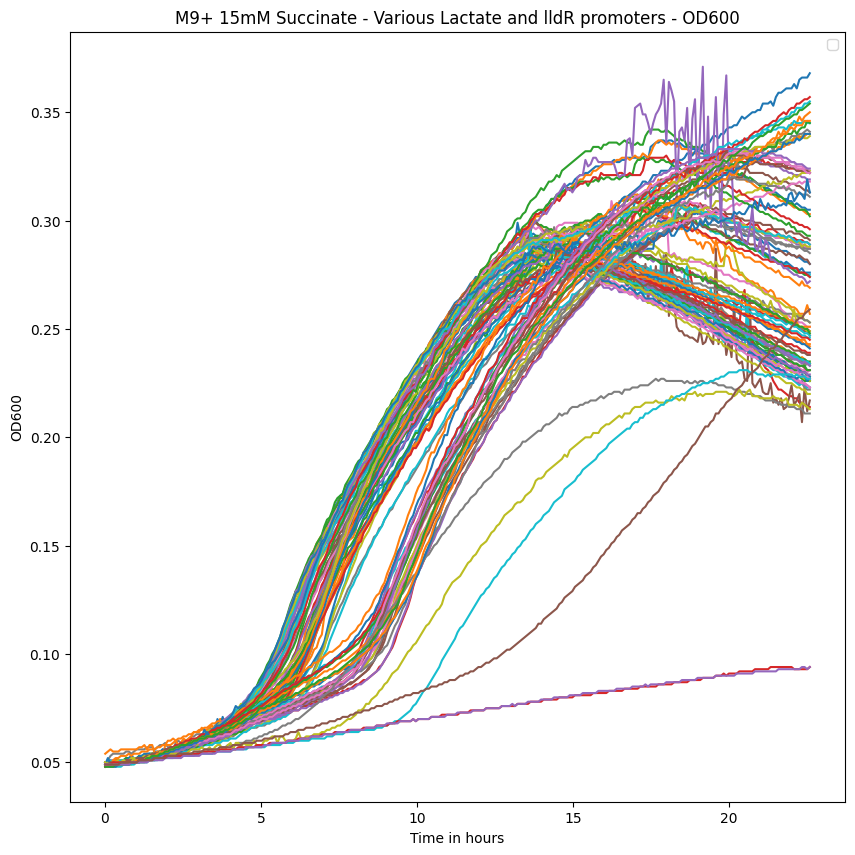

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


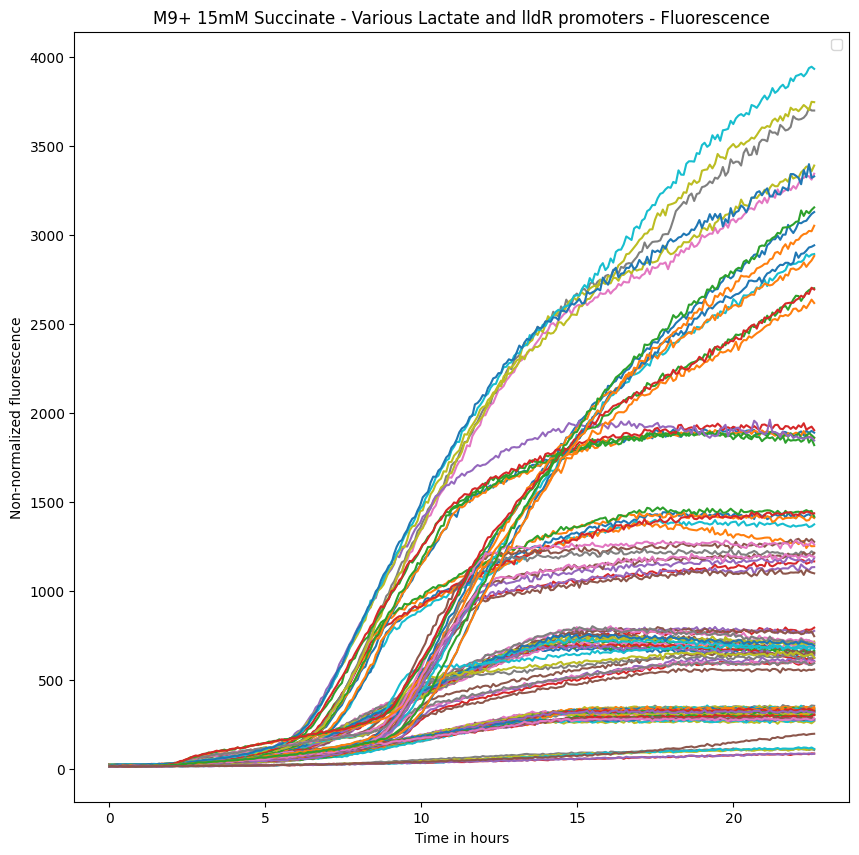

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


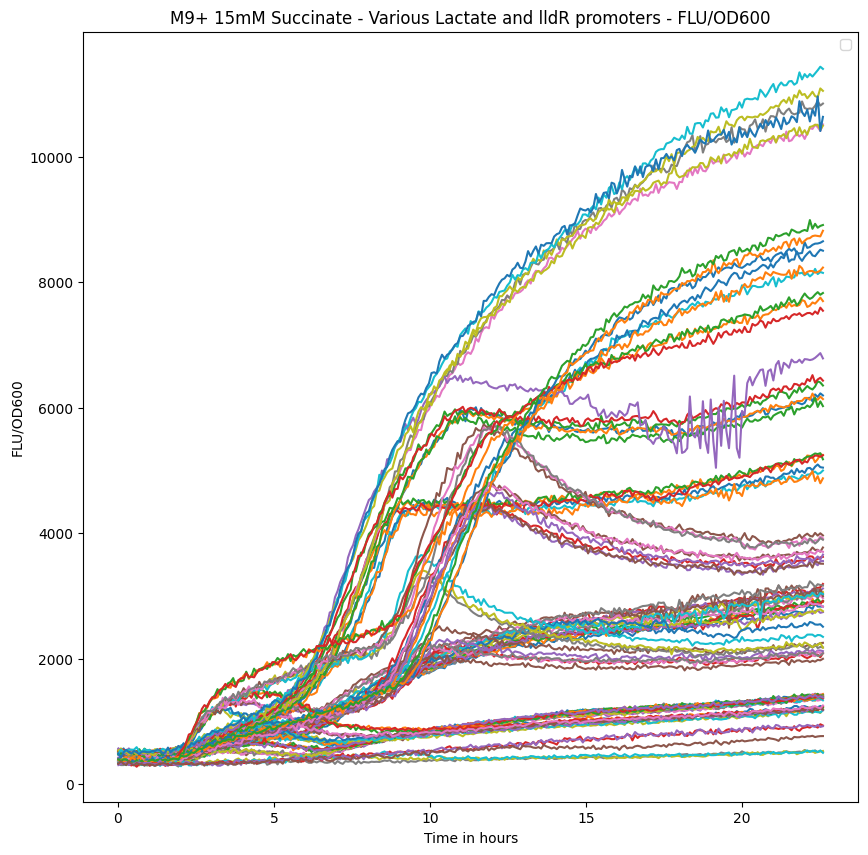

In [21]:
data_OD = OD_data.iloc[:,1:].to_numpy()
data_FLU = FLU_data.iloc[:,1:].to_numpy()

#Correction Vittorio uses
#data_OD = data_OD-np.min(data_OD)
#data_OD = data_OD/0.23+0.02

data_FLUOD = data_FLU/data_OD

time = OD_data.iloc[:,0]

plt.figure(figsize=(10,10))
plt.plot(time, data_OD)#, label=OD_data.columns[1:])
plt.ylabel('OD600')
plt.xlabel('Time in hours')
plt.title('M9+ 15mM Succinate - Various Lactate and lldR promoters - OD600')
plt.legend()
plt.show()

plt.figure(figsize=(10,10))
plt.plot(time, data_FLU)#, label=OD_data.columns[1:])
plt.ylabel('Non-normalized fluorescence')
plt.xlabel('Time in hours')
plt.title('M9+ 15mM Succinate - Various Lactate and lldR promoters - Fluorescence')
plt.legend()
plt.show()

plt.figure(figsize=(10,10))
plt.plot(time, data_FLUOD)#, label=OD_data.columns[1:])
plt.ylabel('FLU/OD600')
plt.xlabel('Time in hours')
plt.title('M9+ 15mM Succinate - Various Lactate and lldR promoters - FLU/OD600')
plt.legend()
plt.show()

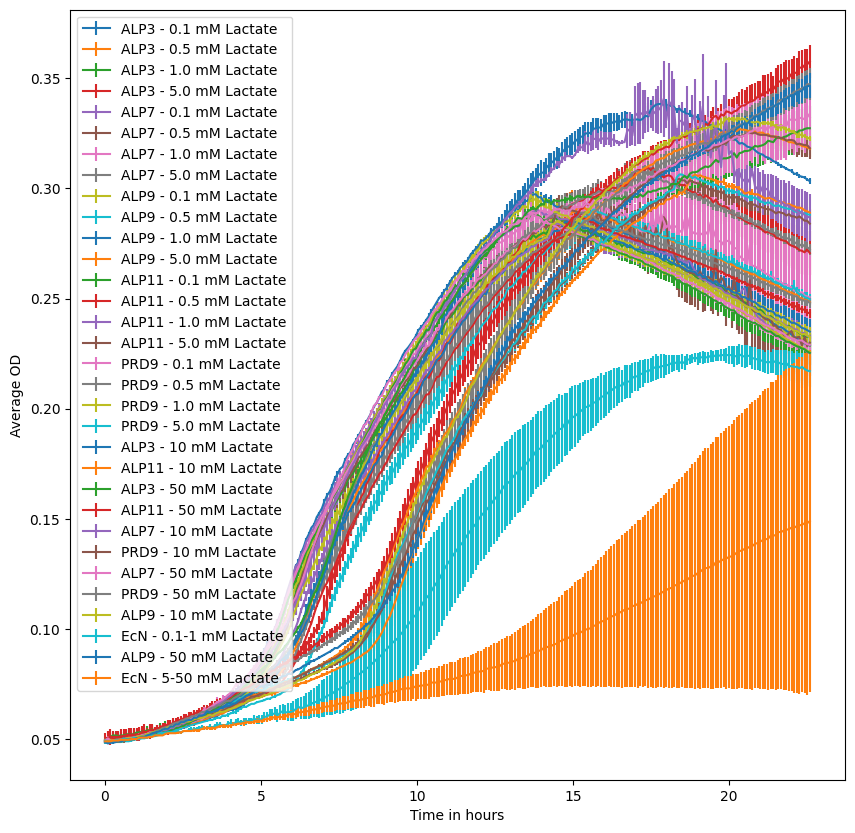

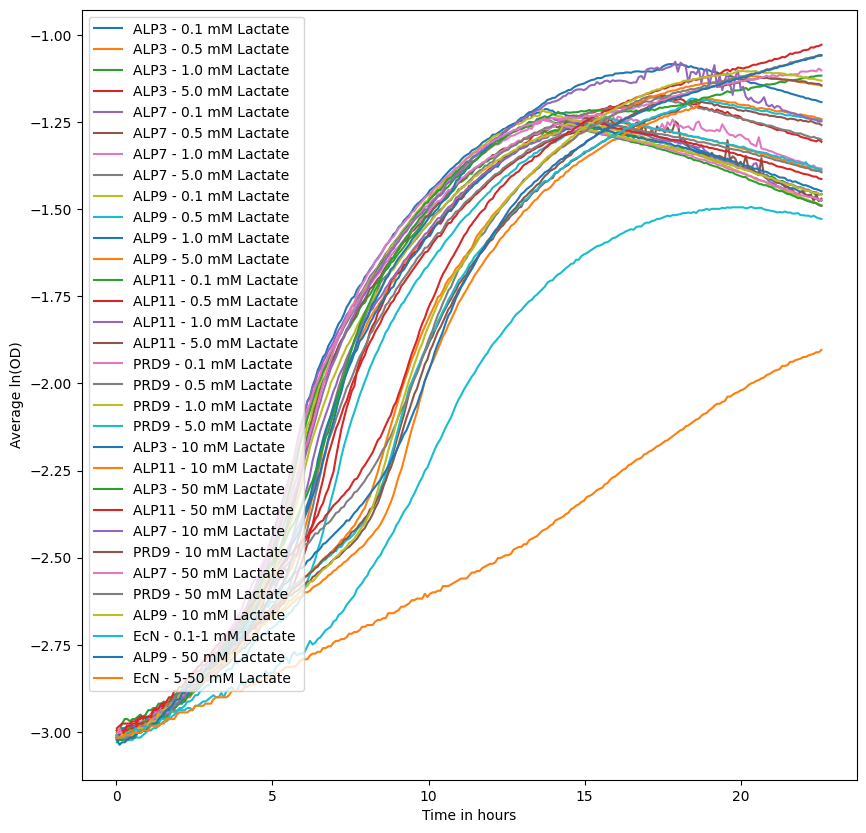

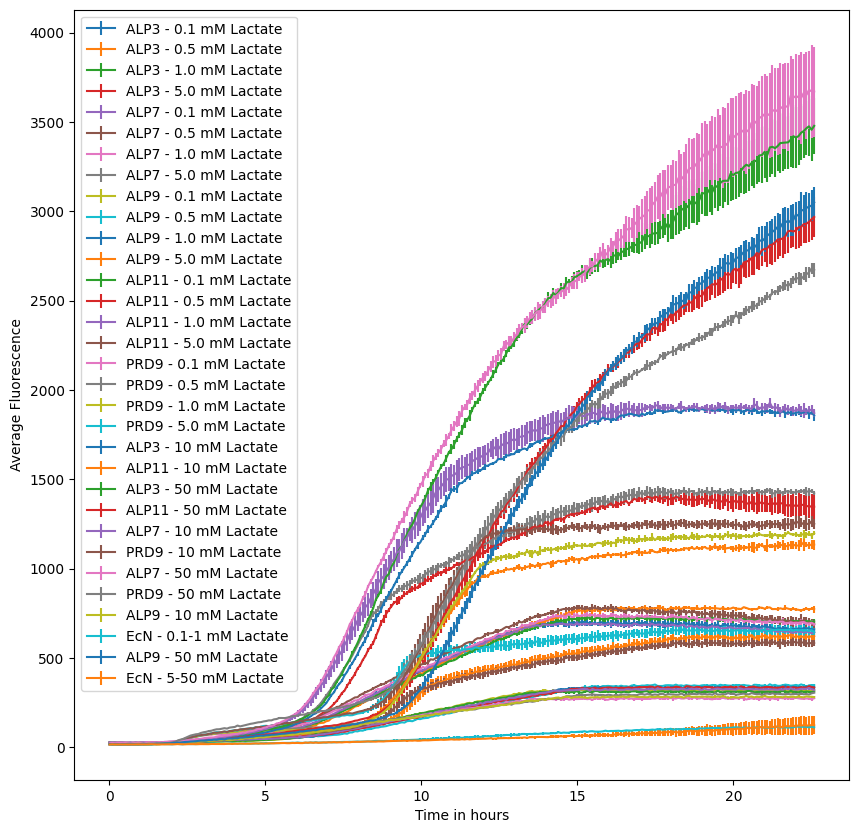

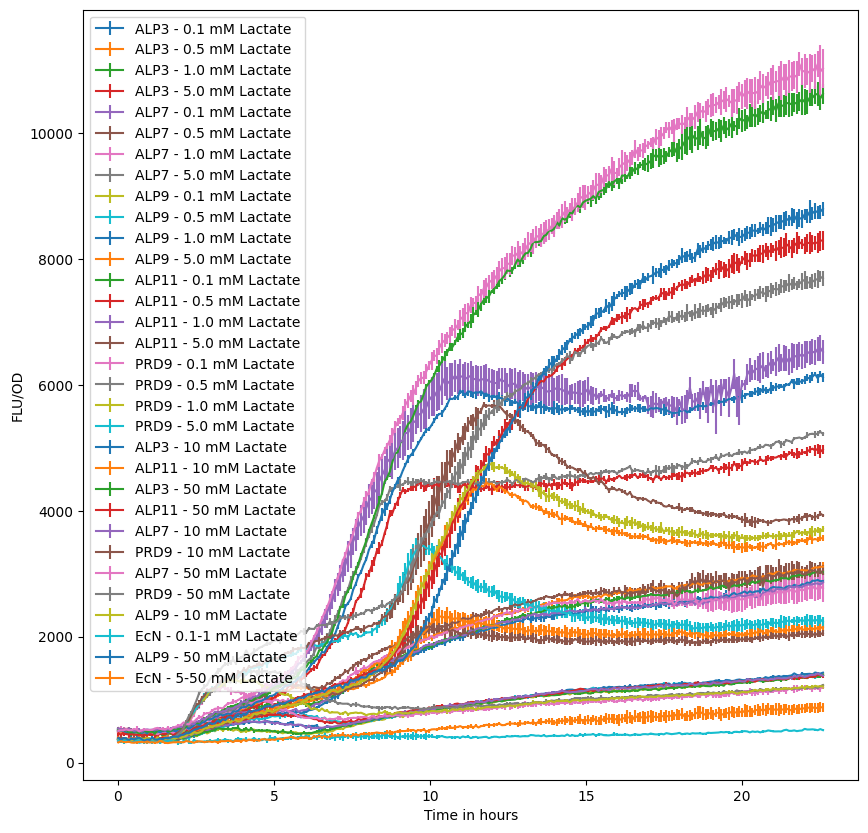

In [22]:
#Specify number of replicates
replicates = 3

OD_avg5 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
OD_std5 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLU_avg5 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLU_std5 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLUOD_avg5 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLUOD_std5 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))

for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        #Calculate average and stdev
        #Some standard deviations are zero
        OD_avg5[:,index] = np.average(data_OD[:,i:i+replicates], axis=1)
        OD_std5[:,index] = np.std(data_OD[:,i:i+replicates], axis=1)
        
        FLU_avg5[:,index] = np.average(data_FLU[:,i:i+replicates], axis=1)
        FLU_std5[:,index] = np.std(data_FLU[:,i:i+replicates], axis=1)
        
        FLUOD_avg5[:,index] = np.average(data_FLUOD[:,i:i+replicates], axis=1)
        FLUOD_std5[:,index] = np.std(data_FLUOD[:,i:i+replicates], axis=1)
#Plot average OD levels
labels5 = ['ALP3 - 0.1 mM Lactate',
          'ALP3 - 0.5 mM Lactate',
          'ALP3 - 1.0 mM Lactate',
          'ALP3 - 5.0 mM Lactate',
          'ALP7 - 0.1 mM Lactate',
          'ALP7 - 0.5 mM Lactate',
          'ALP7 - 1.0 mM Lactate',
          'ALP7 - 5.0 mM Lactate',
          'ALP9 - 0.1 mM Lactate',
          'ALP9 - 0.5 mM Lactate',
          'ALP9 - 1.0 mM Lactate',
          'ALP9 - 5.0 mM Lactate',
          'ALP11 - 0.1 mM Lactate',
          'ALP11 - 0.5 mM Lactate',
          'ALP11 - 1.0 mM Lactate',
          'ALP11 - 5.0 mM Lactate',
          'PRD9 - 0.1 mM Lactate',
          'PRD9 - 0.5 mM Lactate',
          'PRD9 - 1.0 mM Lactate',
          'PRD9 - 5.0 mM Lactate',
          'ALP3 - 10 mM Lactate',
          'ALP11 - 10 mM Lactate',
          'ALP3 - 20 mM Lactate',
          'ALP11 - 20 mM Lactate',
          'ALP7 - 10 mM Lactate',
          'PRD9 - 10 mM Lactate',
          'ALP7 - 20 mM Lactate',
          'PRD9 - 20 mM Lactate',
          'ALP9 - 10 mM Lactate',
          'EcN - 0.1-1 mM Lactate',
          'ALP9 - 20 mM Lactate',
          'EcN - 5-20 mM Lactate']


plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        plt.errorbar(time, OD_avg5[:,index], yerr=OD_std5[:,index], label=labels4[index])
plt.legend(loc="upper left")
plt.ylabel('Average OD')
plt.xlabel('Time in hours')
plt.show()

plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        log = np.log(OD_avg5[:,index])
        plt.plot(time, log, label=labels4[index])
plt.legend(loc="upper left")
plt.ylabel('Average ln(OD)')
plt.xlabel('Time in hours')
plt.show()

plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        plt.errorbar(time, FLU_avg5[:,index], yerr=FLU_std5[:,index], label=labels5[index])
plt.legend(loc="upper left")
plt.ylabel('Average Fluorescence')
plt.xlabel('Time in hours')
plt.show()

plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        plt.errorbar(time, FLUOD_avg5[:,index], yerr=FLUOD_std5[:,index], label=labels5[index])
plt.legend(loc="upper left")
plt.ylabel('FLU/OD')
plt.xlabel('Time in hours')
plt.show()

In [23]:
#Add labels together
labels = np.array(labels1 + labels5)

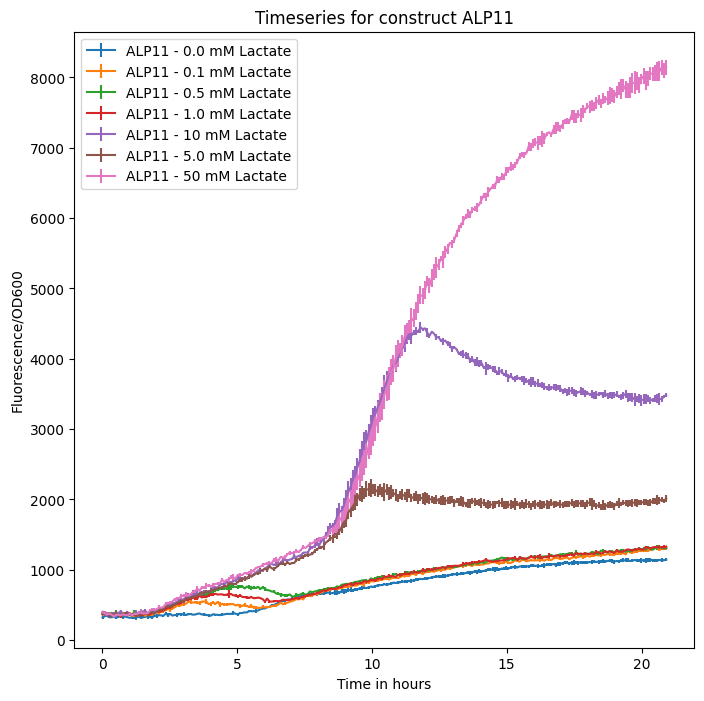

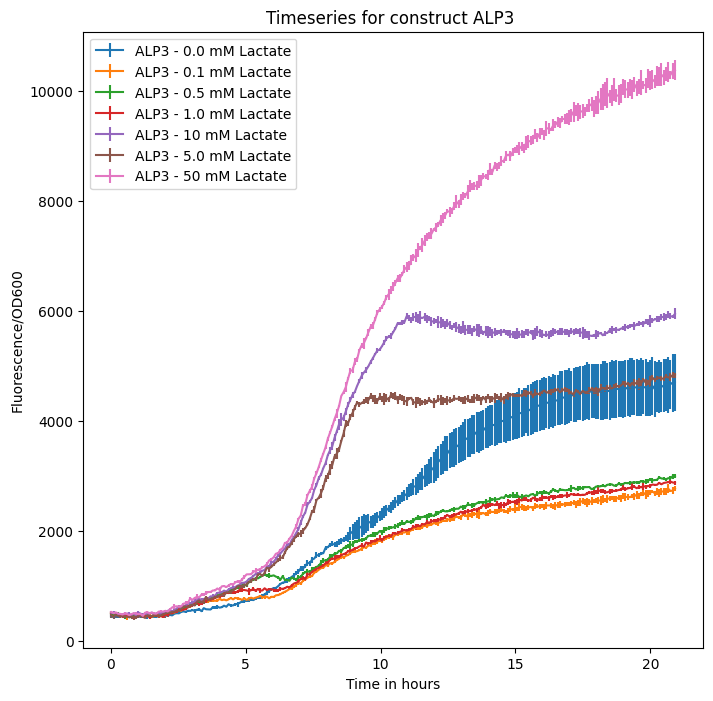

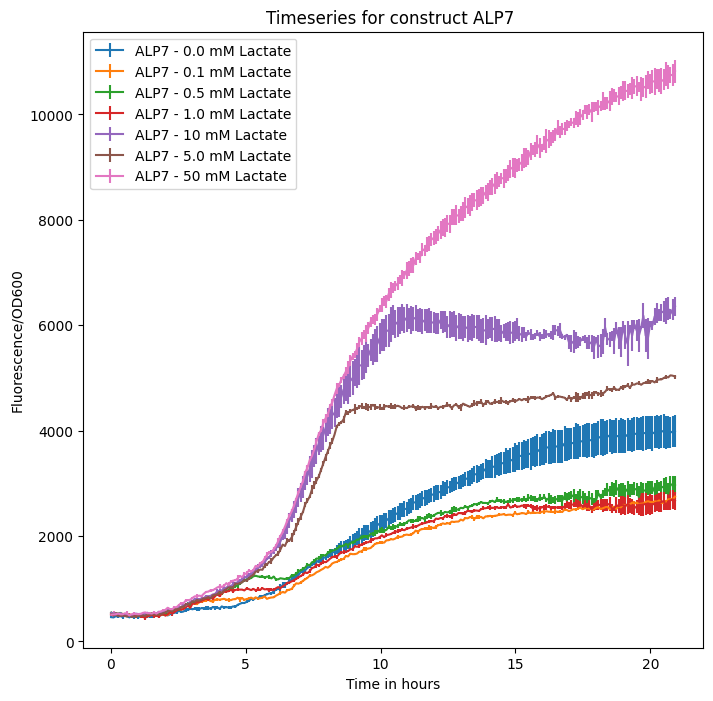

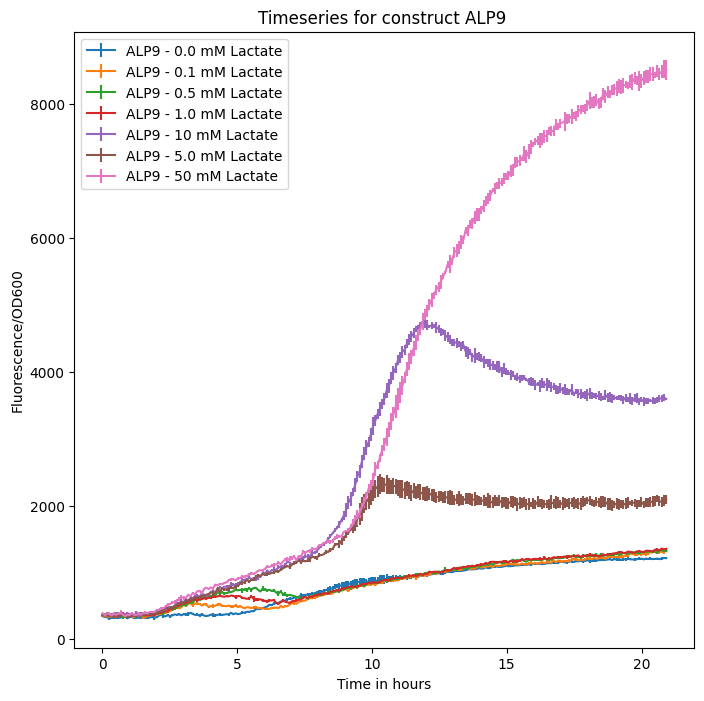

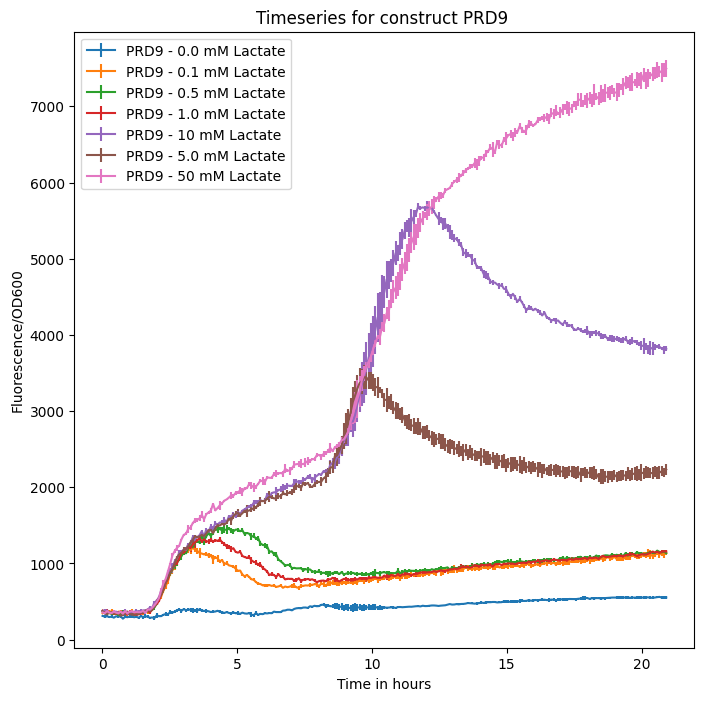

...

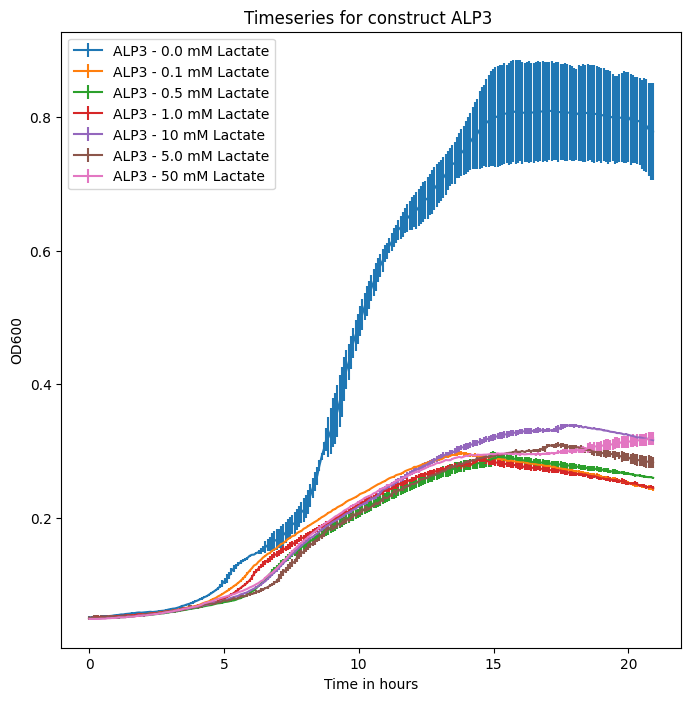

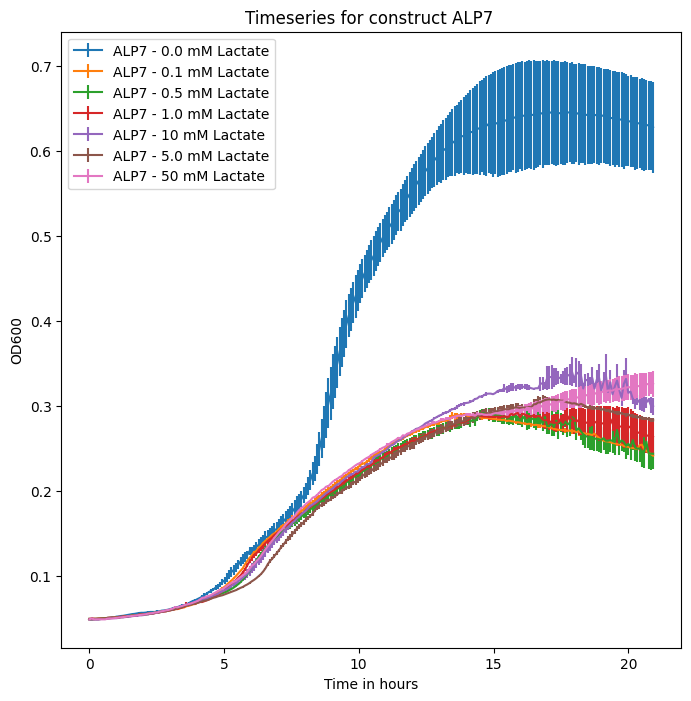

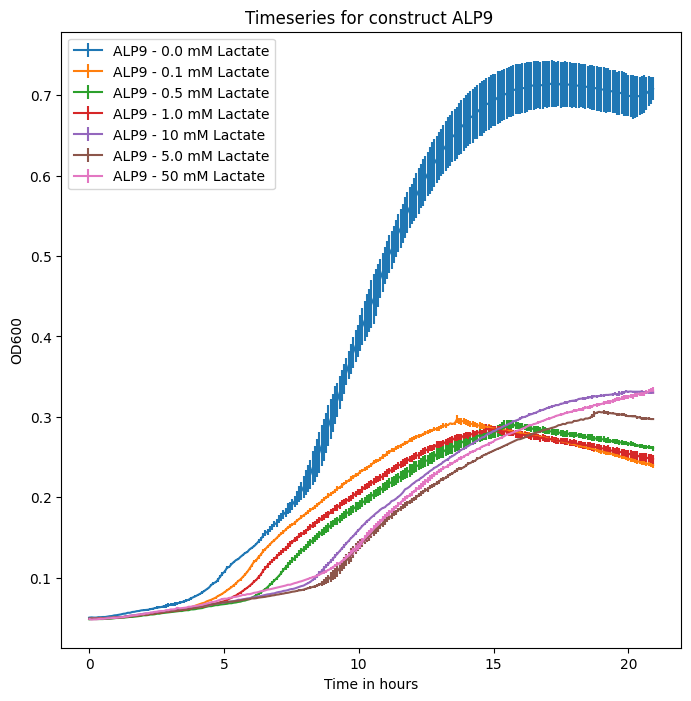

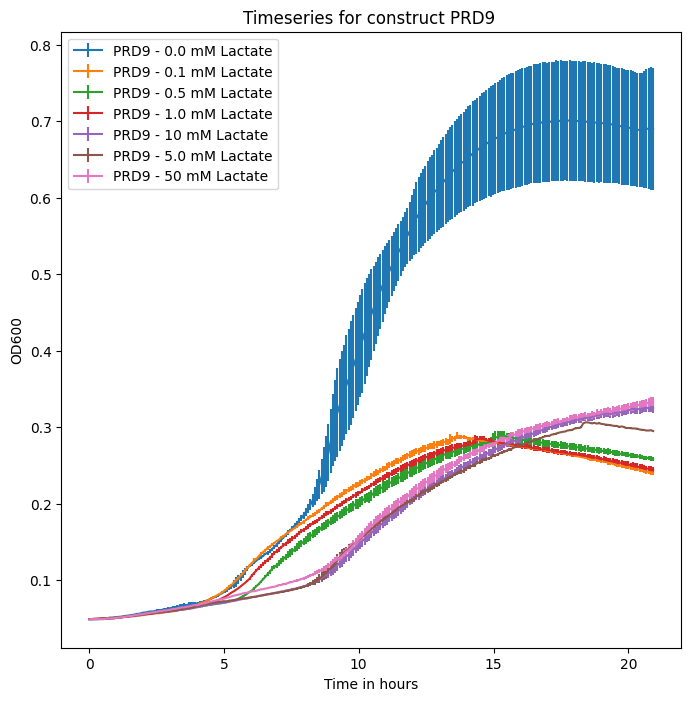

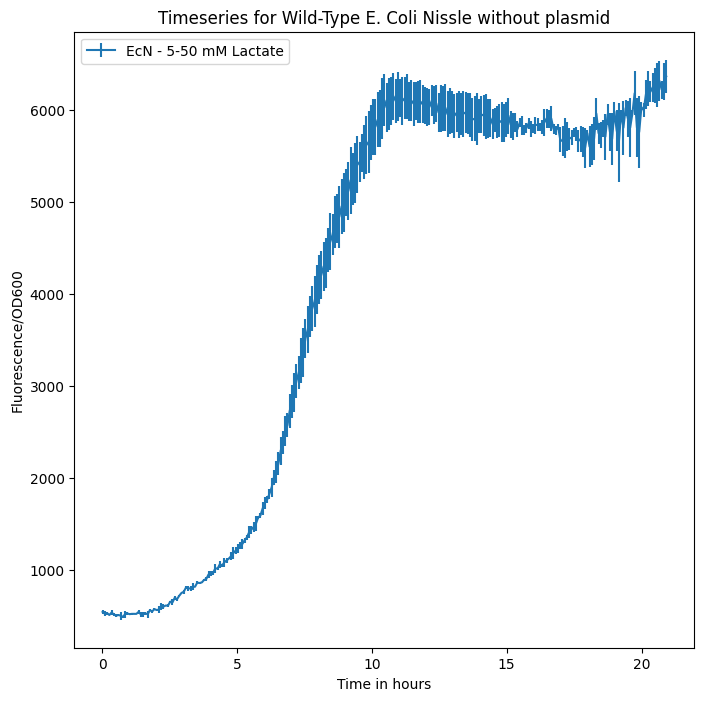

In [24]:
sort_index = labels.argsort()
#Sort everything on label
labels = labels[sort_index]
wt_index = np.flatnonzero(np.core.defchararray.find(labels,"EcN")!=-1)
wt_labels = labels[wt_index]

#Remove WT from labels, data to not interfere with dose-response curves
labels = np.delete(labels, wt_index)
sort_index = np.delete(sort_index, wt_index)
#Concentrations are not in order because argsort doesnt sort the numbers in a string correctly
#concentrations = np.array([0,0.1,0.5,1,10,5,20])
concentrations = np.array([0,0.05,0.2,0.5,5,2,20])
time = time[:-20]
FLUOD_avg_suc = np.column_stack((FLUOD_avg1,FLUOD_avg5[:-20]))
FLUOD_std_suc = np.column_stack((FLUOD_std1,FLUOD_std5[:-20]))

FLU_avg_suc = np.column_stack((FLU_avg1,FLU_avg5[:-20]))
FLU_std_suc = np.column_stack((FLU_std1,FLU_std5[:-20]))

OD_avg_suc = np.column_stack((OD_avg1,OD_avg5[:-20]))
OD_std_suc = np.column_stack((OD_std1,OD_std5[:-20]))

WT_avg_suc = FLUOD_avg_suc[:,wt_index]
WT_std_suc = FLUOD_std_suc[:,wt_index]

FLUOD_avg_suc = FLUOD_avg_suc[:,sort_index]
FLUOD_std_suc = FLUOD_std_suc[:,sort_index]
FLU_avg_suc = FLU_avg_suc[:,sort_index]
FLU_std_suc = FLU_std_suc[:,sort_index]
OD_avg_suc = OD_avg_suc[:,sort_index]
OD_std_suc = OD_std_suc[:,sort_index]

for i in range(int(len(FLUOD_avg_suc[0])/7)):
    plt.figure(figsize=(8,8))
    for j in range(7):
        plt.errorbar(time, FLUOD_avg_suc[:,i*7+j], yerr=FLUOD_std_suc[:,i*7+j], label=labels[i*7+j])
    plt.title(f"Timeseries for construct {labels[i*7][:5]}")
    plt.legend(loc="upper left")
    plt.xlabel('Time in hours')
    plt.ylabel('Fluorescence/OD600')
    plt.show()

for i in range(int(len(FLUOD_avg[0])/7)):
    plt.figure(figsize=(8,8))
    for j in range(7):
        plt.errorbar(time, OD_avg_suc[:,i*7+j], yerr=OD_std_suc[:,i*7+j], label=labels[i*7+j])
    plt.title(f"Timeseries for construct {labels[i*7][:5]}")
    plt.legend(loc="upper left")
    plt.xlabel('Time in hours')
    plt.ylabel('OD600')
    plt.show()
    
#Plot the wild-type time-series
plt.figure(figsize=(8,8))
for j in range(1,len(wt_labels)):
    plt.errorbar(time, WT_avg_suc[:,j], yerr=WT_std_suc[:,j], label=wt_labels[j])
plt.title(f"Timeseries for Wild-Type E. Coli Nissle without plasmid")
plt.legend(loc="upper left")
plt.xlabel('Time in hours')
plt.ylabel('Fluorescence/OD600')
plt.show()

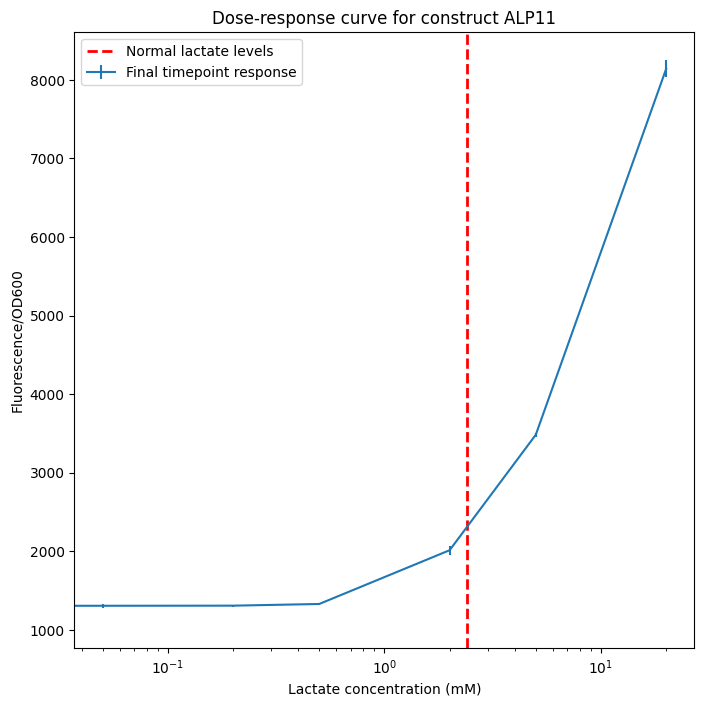

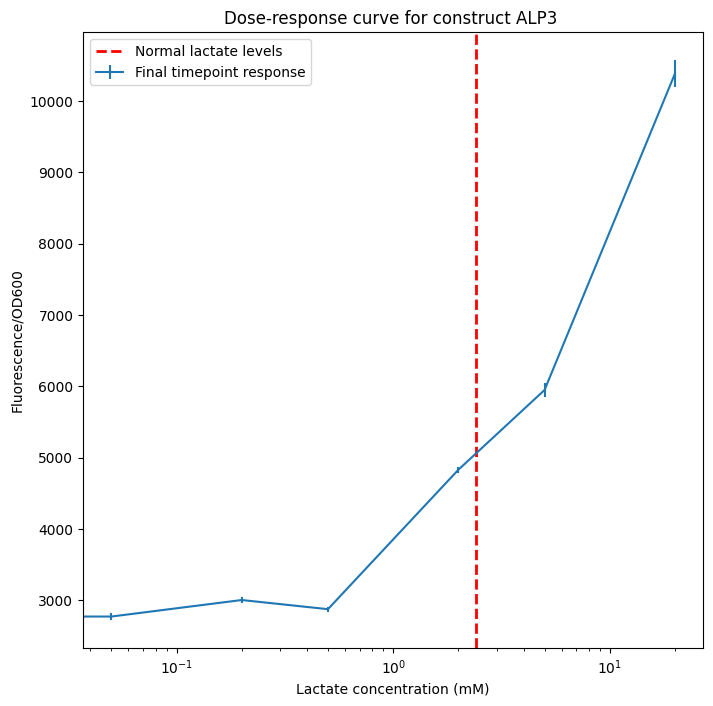

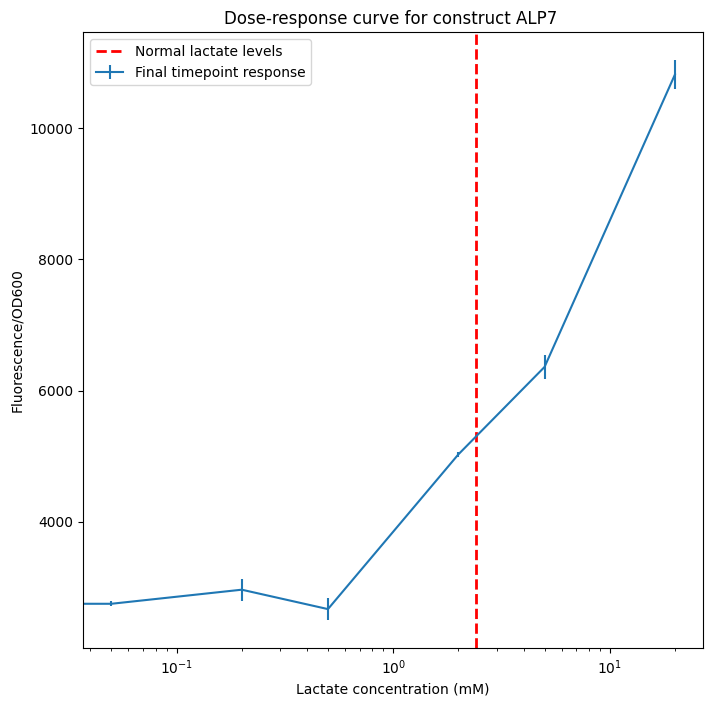

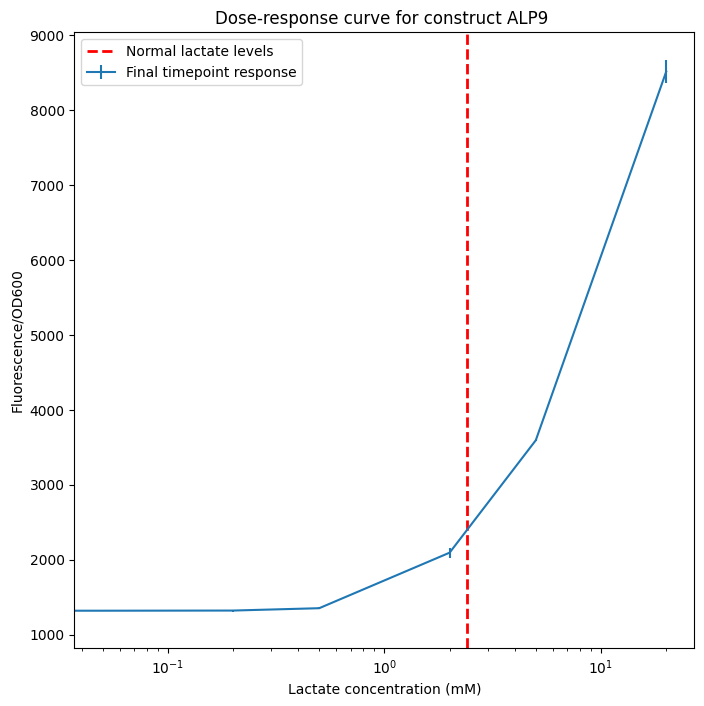

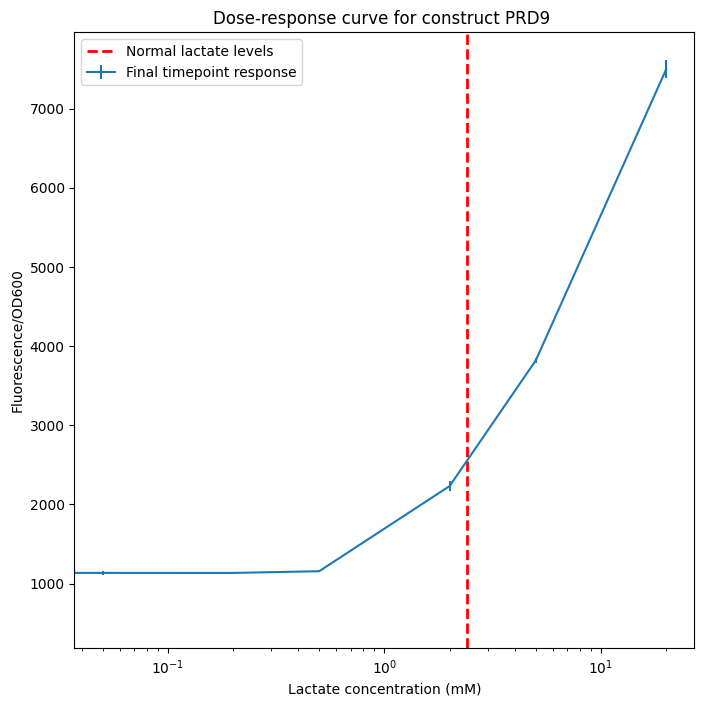

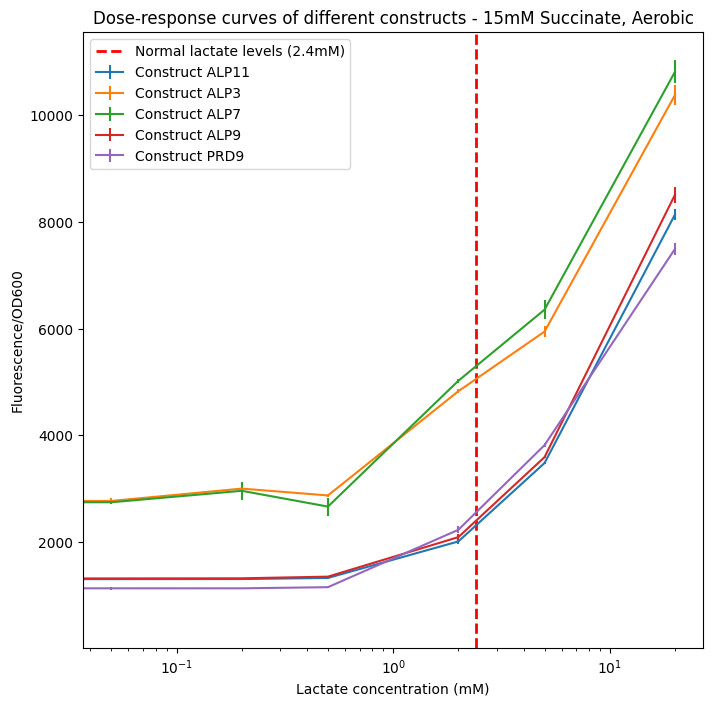

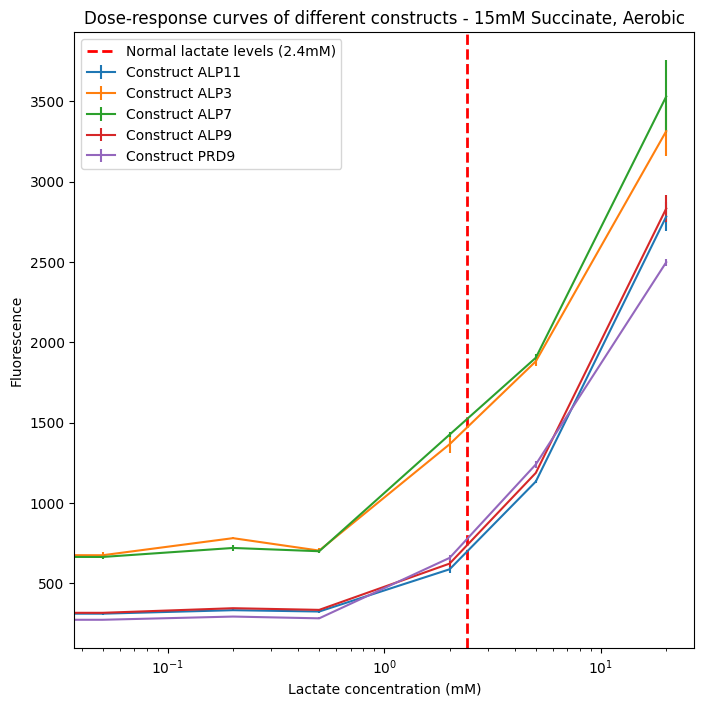

In [25]:
#Plot dose_response curves
for i in range(int(len(FLUOD_avg_suc[0])/7)):
    plt.figure(figsize=(8,8))
    response = FLUOD_avg_suc[-1,i*7:i*7+7]
    response_error = FLUOD_std_suc[-1,i*7:i*7+7]

    #Sort response again since labels are weirdly sorted
    response = response[concentrations.argsort()]
    response_error = response_error[concentrations.argsort()]
    
    plt.errorbar(concentrations[concentrations.argsort()], response, yerr=response_error, label="Final timepoint response")
    plt.title(f"Dose-response curve for construct {labels[i*7][:5]}")
    plt.axvline(2.4,ymin =0, ymax=1, label=f"Normal lactate levels", color="red", linestyle="--", linewidth=2)
    plt.xlabel('Lactate concentration (mM)')
    plt.ylabel('Fluorescence/OD600')
    plt.legend(loc="upper left")
    plt.xscale('log')
    plt.show()
    
#Plot all dose_response curves in one figure
plt.figure(figsize=(8,8))
for i in range(int(len(FLUOD_avg_suc[0])/7)):
    response = FLUOD_avg_suc[-1,i*7:i*7+7]
    response_error = FLUOD_std_suc[-1,i*7:i*7+7]

    #Sort response again since labels are weirdly sorted
    response = response[concentrations.argsort()]
    response_error = response_error[concentrations.argsort()]
    
    plt.errorbar(concentrations[concentrations.argsort()], response, yerr=response_error, label=f"Construct {labels[i*7][:5]}")
plt.title(f"Dose-response curves of different constructs - 15mM Succinate, Aerobic")
plt.axvline(2.4,ymin =0, ymax=1, label=f"Normal lactate levels (2.4mM)", color="red", linestyle="--", linewidth=2)
plt.legend(loc="upper left")
plt.xlabel('Lactate concentration (mM)')
plt.ylabel('Fluorescence/OD600')
plt.xscale('log')
plt.show()

#Plot all dose_response curves in one figure
plt.figure(figsize=(8,8))
for i in range(int(len(FLUOD_avg_suc[0])/7)):
    response = FLU_avg_suc[-1,i*7:i*7+7]
    response_error = FLU_std_suc[-1,i*7:i*7+7]

    #Sort response again since labels are weirdly sorted
    response = response[concentrations.argsort()]
    response_error = response_error[concentrations.argsort()]
    
    plt.errorbar(concentrations[concentrations.argsort()], response, yerr=response_error, label=f"Construct {labels[i*7][:5]}")
plt.title(f"Dose-response curves of different constructs - 15mM Succinate, Aerobic")
plt.axvline(2.4,ymin =0, ymax=1, label=f"Normal lactate levels (2.4mM)", color="red", linestyle="--", linewidth=2)
plt.legend(loc="upper left")
plt.xlabel('Lactate concentration (mM)')
plt.ylabel('Fluorescence')
plt.xscale('log')
plt.show()

#Save data
header_list = [x for x in labels]
header_list.insert(0,'Time(h)')

#Create dataframes.
Succinate_aerobic_OD_processed = pd.DataFrame(np.column_stack((time,OD_avg_suc)), columns=header_list)
Succinate_aerobic_FLU_processed = pd.DataFrame(np.column_stack((time,FLU_avg_suc)), columns=header_list)
Succinate_aerobic_FLUOD_processed = pd.DataFrame(np.column_stack((time,FLUOD_avg_suc)), columns=header_list)
Succinate_aerobic_OD_std_processed = pd.DataFrame(np.column_stack((time,OD_std_suc)), columns=header_list)
Succinate_aerobic_FLU_std_processed = pd.DataFrame(np.column_stack((time,FLU_std_suc)), columns=header_list)
Succinate_aerobic_FLUOD_std_processed = pd.DataFrame(np.column_stack((time,FLUOD_std_suc)), columns=header_list)

#Sort labels and restructure data accordingly.
header = sorted_nicely(labels)
header.insert(0,'Time(h)')
# print(f"Sorted header list:{header}\n\n")
# print(Succinate_aerobic_OD_processed.head())
Succinate_aerobic_OD_processed = Succinate_aerobic_OD_processed[header]
# print(Succinate_aerobic_OD_processed.head())
Succinate_aerobic_FLU_processed = Succinate_aerobic_FLU_processed[header]
Succinate_aerobic_FLUOD_processed = Succinate_aerobic_FLUOD_processed[header]
Succinate_aerobic_OD_std_processed = Succinate_aerobic_OD_std_processed[header]
Succinate_aerobic_FLU_std_processed = Succinate_aerobic_FLU_std_processed[header]
Succinate_aerobic_FLUOD_std_processed = Succinate_aerobic_FLUOD_std_processed[header]

Succinate_aerobic_OD_processed.to_csv('Data/15mMSuccinate_aerobic_OD_processed.csv',index=False)
Succinate_aerobic_FLU_processed.to_csv('Data/15mMSuccinate_aerobic_FLU_processed.csv', index=False)
Succinate_aerobic_FLUOD_processed.to_csv('Data/15mMSuccinate_aerobic_FLUOD_processed.csv', index=False)
Succinate_aerobic_OD_std_processed.to_csv('Data/15mMSuccinate_aerobic_OD_std_processed.csv', index=False)
Succinate_aerobic_FLU_std_processed.to_csv('Data/15mMSuccinate_aerobic_FLU_std_processed.csv', index=False)
Succinate_aerobic_FLUOD_std_processed.to_csv('Data/15mMSuccinate_aerobic_FLUOD_std_processed.csv', index=False)

# Experiment 6: 22mM Glucose, anaerobic conditions

In [26]:
#Load the data
OD_data = pd.read_excel("Data/17-08-2022_EcN_Gluc22mM_Anaerobic_GFP_OD600.xlsx", engine='openpyxl', header=0)
FLU_data = pd.read_excel("Data/17-08-2022_EcN_Gluc22mM_Anaerobic_GFP_EX479EM510.xlsx", engine='openpyxl', header=0)

#Remove temperature column
OD_data.pop('T° OD600:600')
OD_data['Time'] = OD_data['Time']/3600
FLU_data.pop('T° GFP:479,510')
FLU_data['Time'] = FLU_data['Time']/3600

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


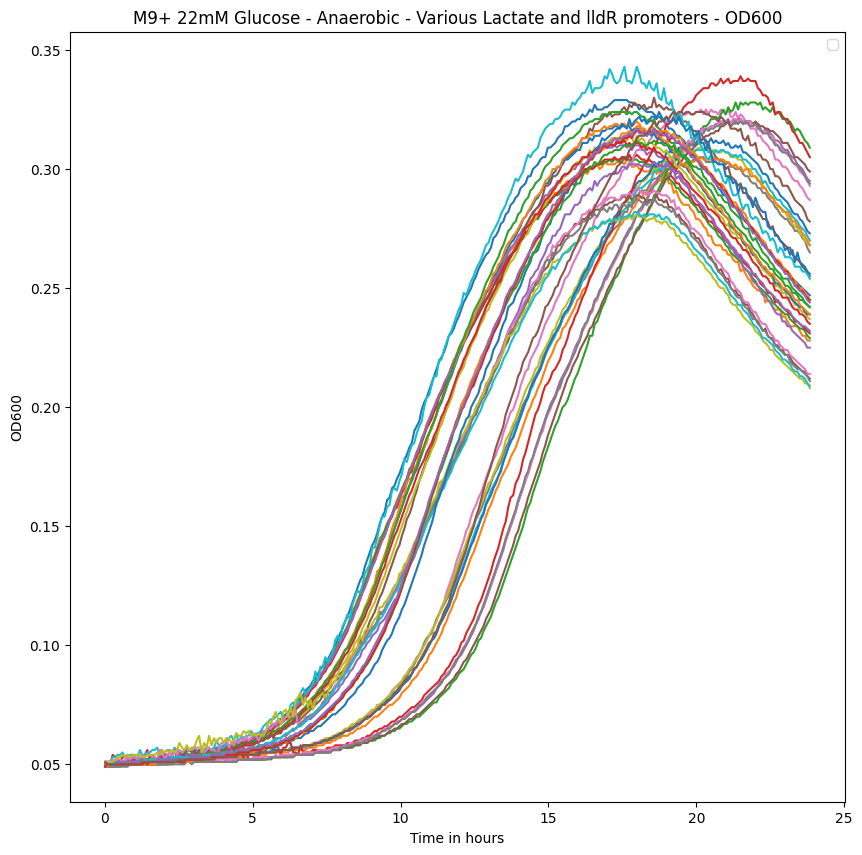

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


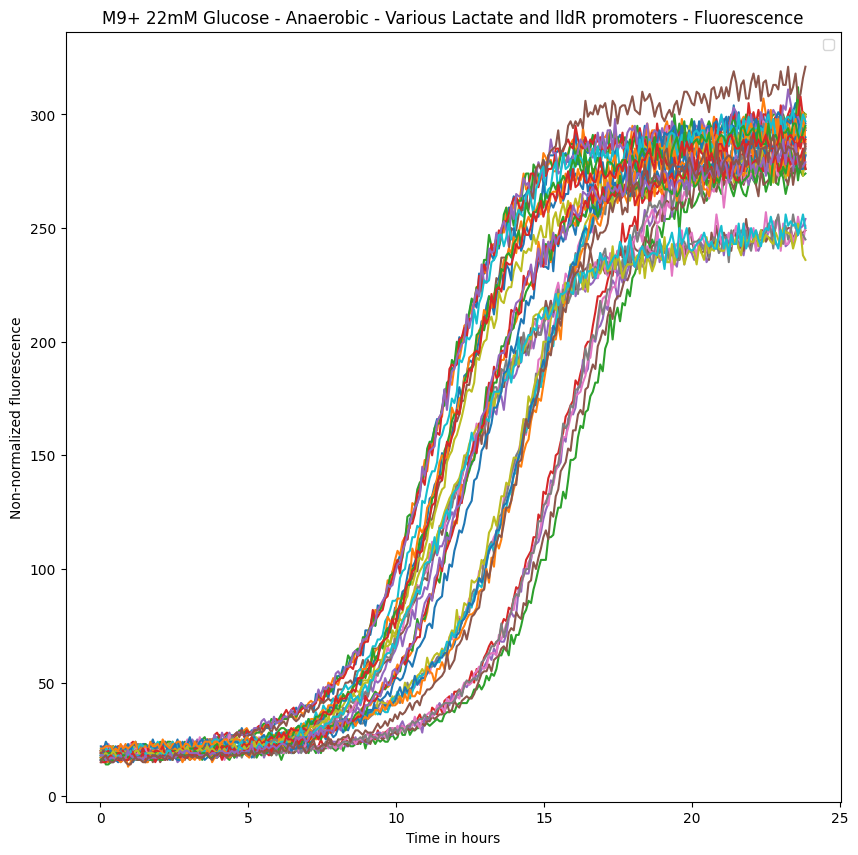

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


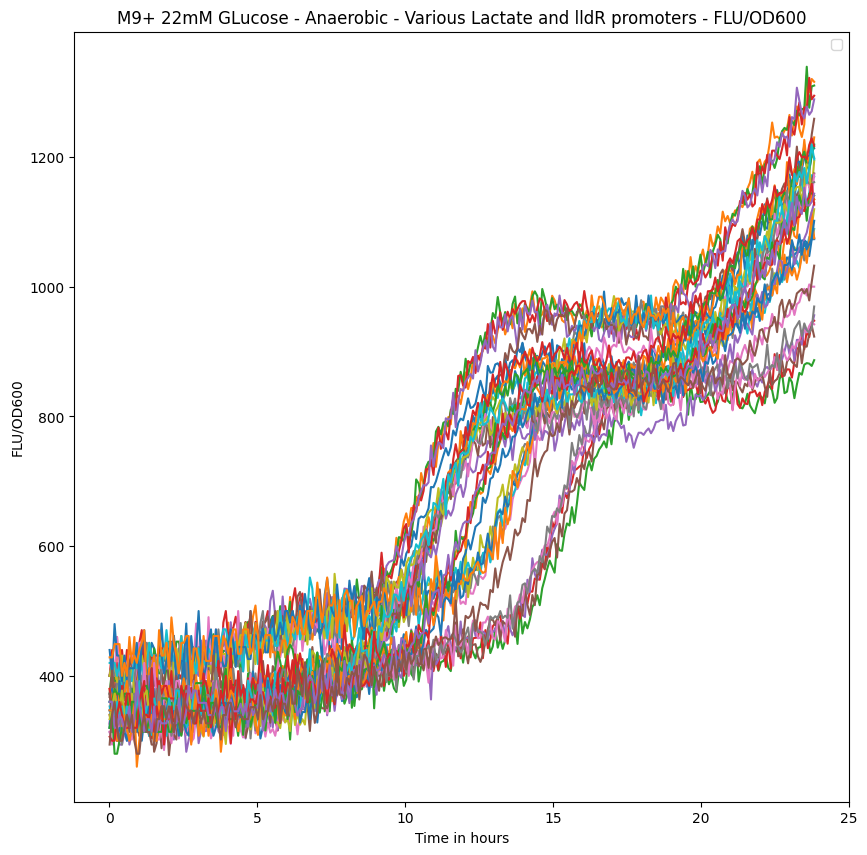

In [27]:
data_OD = OD_data.iloc[:,1:].to_numpy()
data_FLU = FLU_data.iloc[:,1:].to_numpy()

#Correction Vittorio uses
#data_OD = data_OD-np.min(data_OD)
#data_OD = data_OD/0.23+0.02

data_FLUOD = data_FLU/data_OD

time = OD_data.iloc[:,0]

plt.figure(figsize=(10,10))
plt.plot(time, data_OD)#, label=OD_data.columns[1:])
plt.ylabel('OD600')
plt.xlabel('Time in hours')
plt.title('M9+ 22mM Glucose - Anaerobic - Various Lactate and lldR promoters - OD600')
plt.legend()
plt.show()

plt.figure(figsize=(10,10))
plt.plot(time, data_FLU)#, label=OD_data.columns[1:])
plt.ylabel('Non-normalized fluorescence')
plt.xlabel('Time in hours')
plt.title('M9+ 22mM Glucose - Anaerobic - Various Lactate and lldR promoters - Fluorescence')
plt.legend()
plt.show()

plt.figure(figsize=(10,10))
plt.plot(time, data_FLUOD)#, label=OD_data.columns[1:])
plt.ylabel('FLU/OD600')
plt.xlabel('Time in hours')
plt.title('M9+ 22mM GLucose - Anaerobic - Various Lactate and lldR promoters - FLU/OD600')
plt.legend()
plt.show()

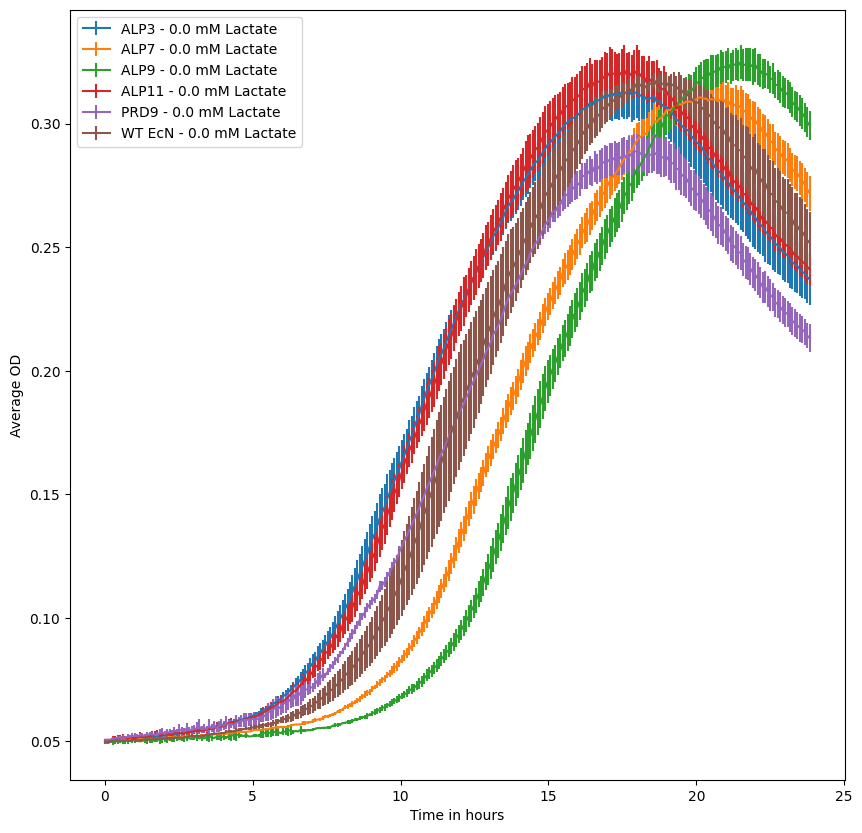

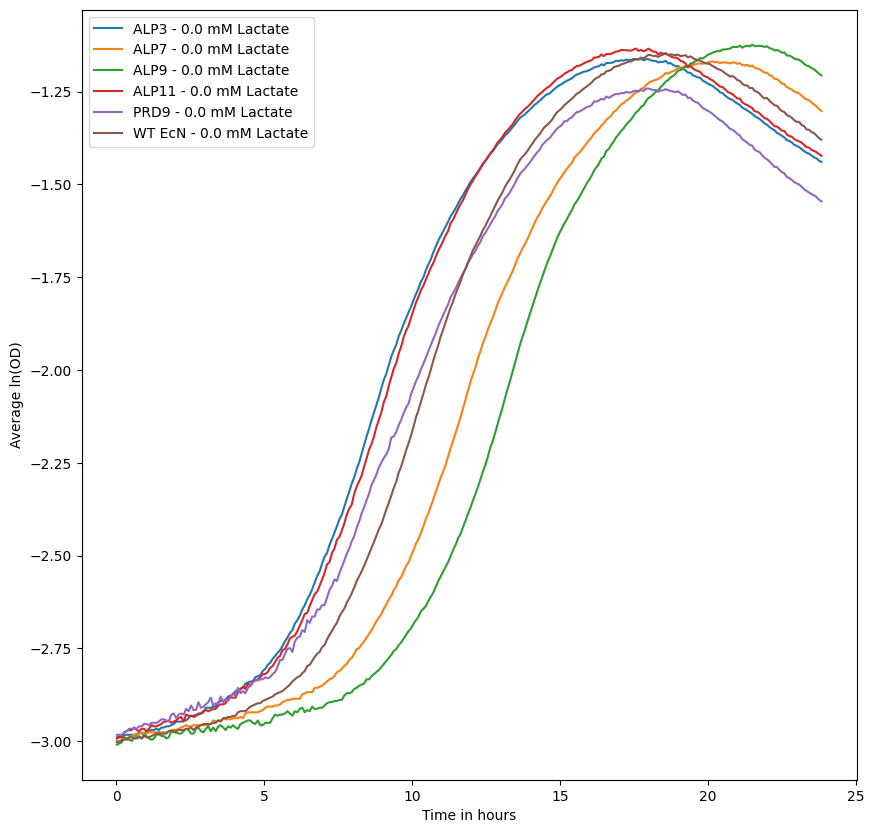

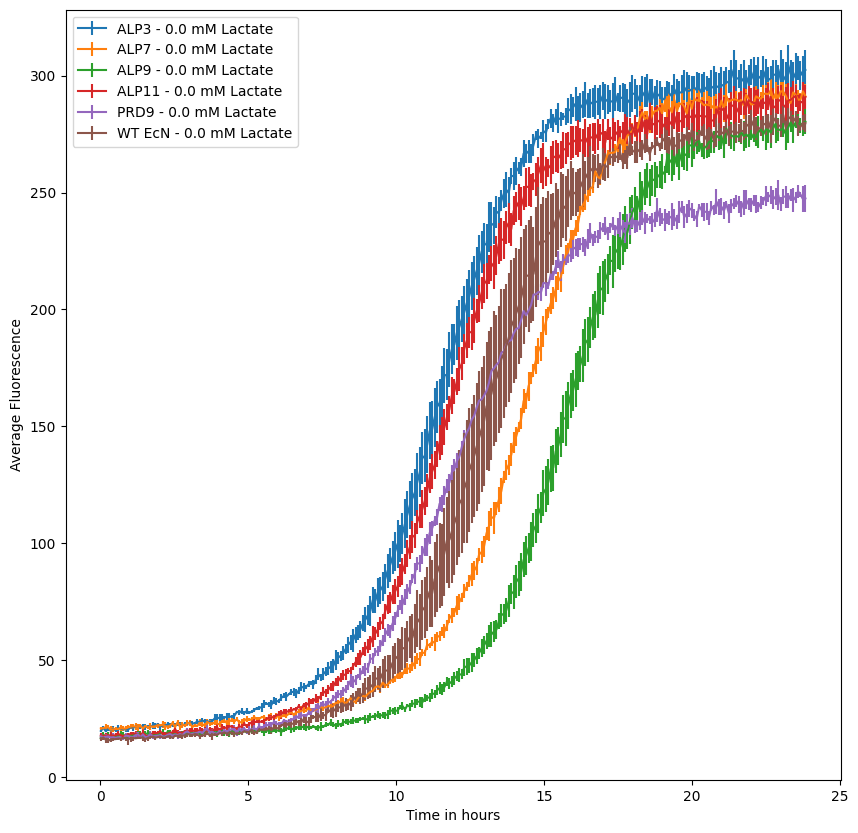

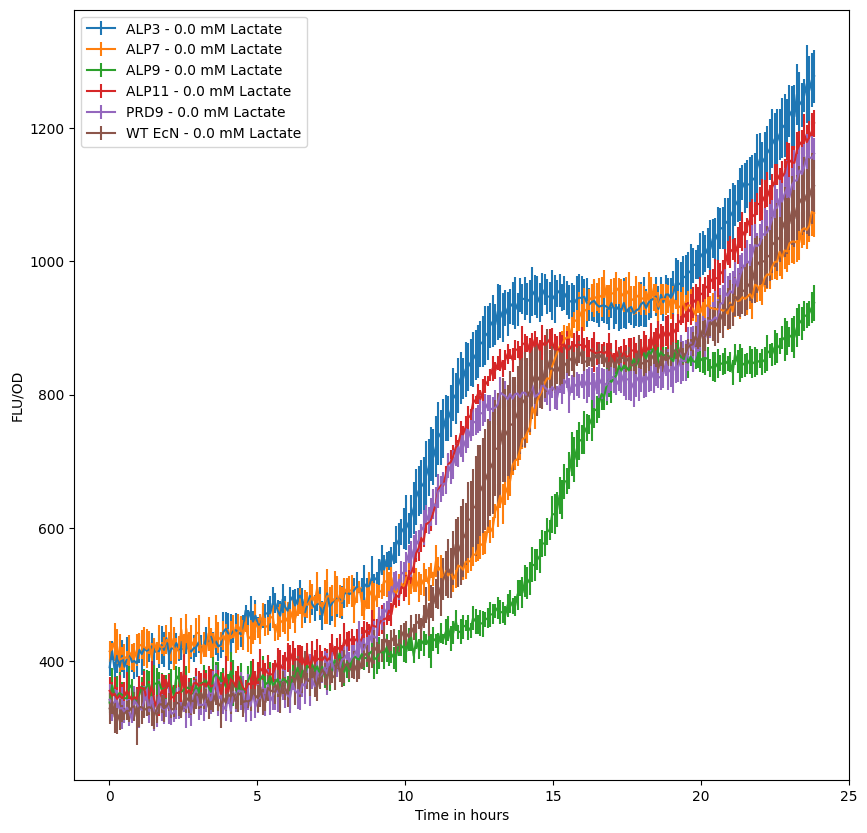

In [28]:
#Specify number of replicates
replicates = 6

OD_avg6= np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
OD_std6 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLU_avg6 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLU_std6 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLUOD_avg6 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLUOD_std6 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))

for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        #Calculate average and stdev
        #Some standard deviations are zero
        OD_avg6[:,index] = np.average(data_OD[:,i:i+replicates], axis=1)
        OD_std6[:,index] = np.std(data_OD[:,i:i+replicates], axis=1)
        
        FLU_avg6[:,index] = np.average(data_FLU[:,i:i+replicates], axis=1)
        FLU_std6[:,index] = np.std(data_FLU[:,i:i+replicates], axis=1)
        
        FLUOD_avg6[:,index] = np.average(data_FLUOD[:,i:i+replicates], axis=1)
        FLUOD_std6[:,index] = np.std(data_FLUOD[:,i:i+replicates], axis=1)

#Plot average OD levels
labels6 = ['ALP3 - 0.0 mM Lactate', 'ALP7 - 0.0 mM Lactate', 'ALP9 - 0.0 mM Lactate', 'ALP11 - 0.0 mM Lactate', 'PRD9 - 0.0 mM Lactate', 'WT EcN - 0.0 mM Lactate']
plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        plt.errorbar(time, OD_avg6[:,index], yerr=OD_std6[:,index], label=labels6[index])
plt.legend(loc="upper left")
plt.ylabel('Average OD')
plt.xlabel('Time in hours')
plt.show()

plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        log = np.log(OD_avg6[:,index])
        plt.plot(time, log, label=labels6[index])
plt.legend(loc="upper left")
plt.ylabel('Average ln(OD)')
plt.xlabel('Time in hours')
plt.show()


plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        plt.errorbar(time, FLU_avg6[:,index], yerr=FLU_std6[:,index], label=labels6[index])
plt.legend(loc="upper left")
plt.ylabel('Average Fluorescence')
plt.xlabel('Time in hours')
plt.show()

plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        plt.errorbar(time, FLUOD_avg6[:,index], yerr=FLUOD_std6[:,index], label=labels6[index])
plt.legend(loc="upper left")
plt.ylabel('FLU/OD')
plt.xlabel('Time in hours')
plt.show()

## Experiment 7 - 22mM Glucose, Anaerobic conditions

In [29]:
#Load the data
OD_data = pd.read_excel("Data/18-08-2022_EcN_Succ15mM_Anaerobic_Lactate_GFP_OD600.xlsx", engine='openpyxl', header=0)
FLU_data = pd.read_excel("Data/18-08-2022_EcN_Succ15mM_Anaerobic_Lactate_GFP_EX479EM510.xlsx", engine='openpyxl', header=0)

#Remove temperature column
OD_data.pop('T° OD600:600')
OD_data['Time'] = OD_data['Time']/3600
FLU_data.pop('T° GFP:479,510')
FLU_data['Time'] = FLU_data['Time']/3600

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


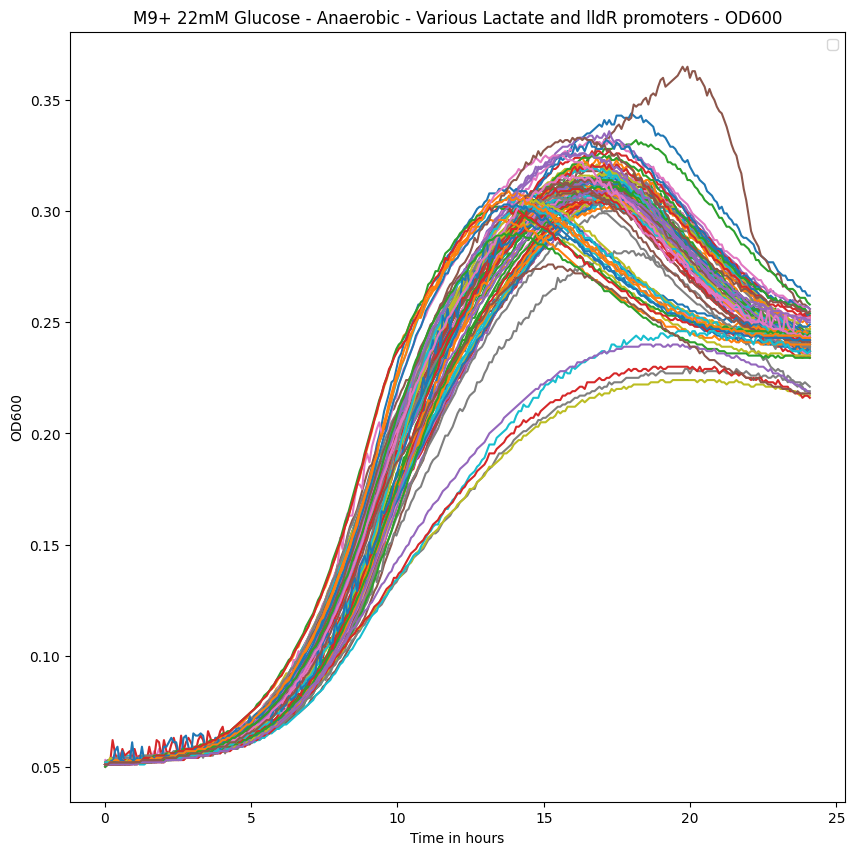

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


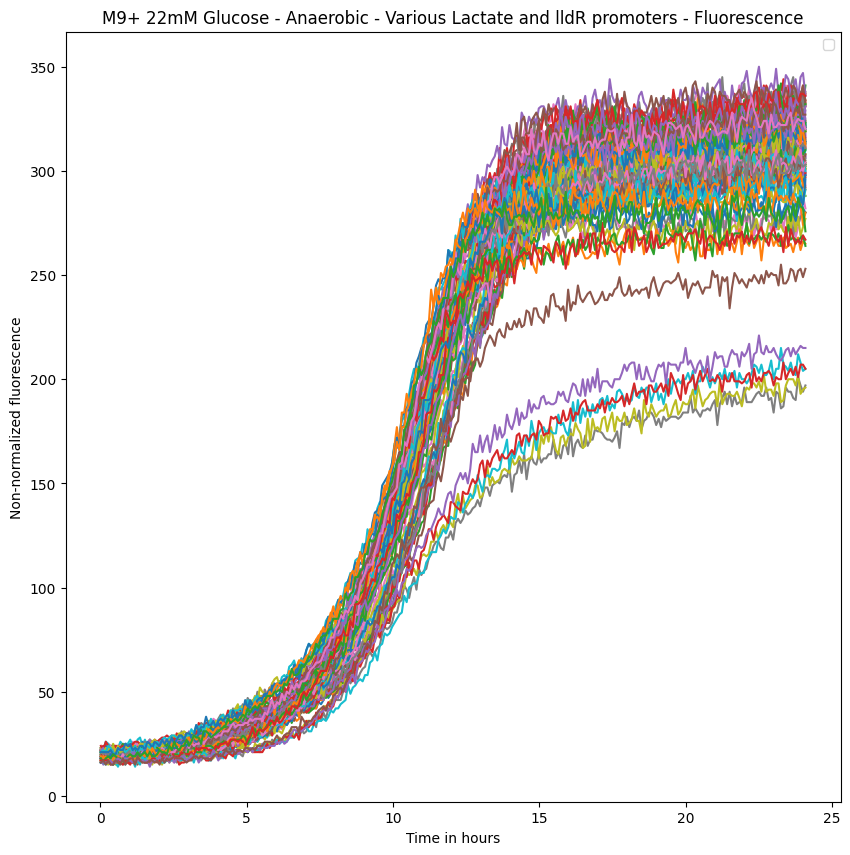

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


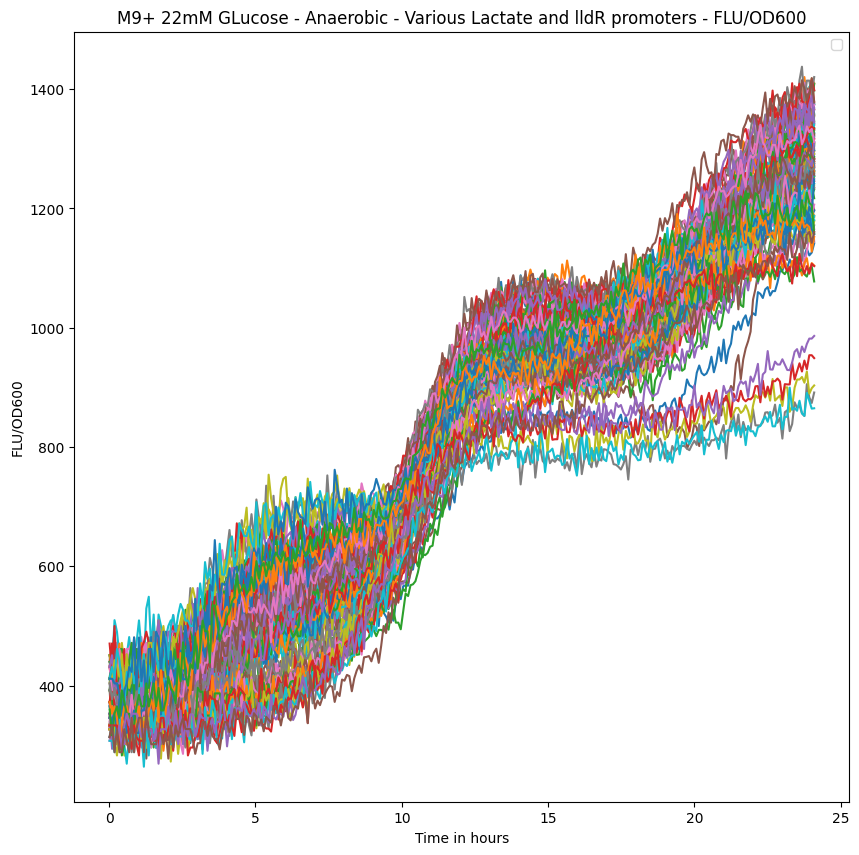

In [30]:
data_OD = OD_data.iloc[:,1:].to_numpy()
data_FLU = FLU_data.iloc[:,1:].to_numpy()

#Correction Vittorio uses
#data_OD = data_OD-np.min(data_OD)
#data_OD = data_OD/0.23+0.02

data_FLUOD = data_FLU/data_OD

time = OD_data.iloc[:,0]

plt.figure(figsize=(10,10))
plt.plot(time, data_OD)#, label=OD_data.columns[1:])
plt.ylabel('OD600')
plt.xlabel('Time in hours')
plt.title('M9+ 22mM Glucose - Anaerobic - Various Lactate and lldR promoters - OD600')
plt.legend()
plt.show()

plt.figure(figsize=(10,10))
plt.plot(time, data_FLU)#, label=OD_data.columns[1:])
plt.ylabel('Non-normalized fluorescence')
plt.xlabel('Time in hours')
plt.title('M9+ 22mM Glucose - Anaerobic - Various Lactate and lldR promoters - Fluorescence')
plt.legend()
plt.show()

plt.figure(figsize=(10,10))
plt.plot(time, data_FLUOD)#, label=OD_data.columns[1:])
plt.ylabel('FLU/OD600')
plt.xlabel('Time in hours')
plt.title('M9+ 22mM GLucose - Anaerobic - Various Lactate and lldR promoters - FLU/OD600')
plt.legend()
plt.show()

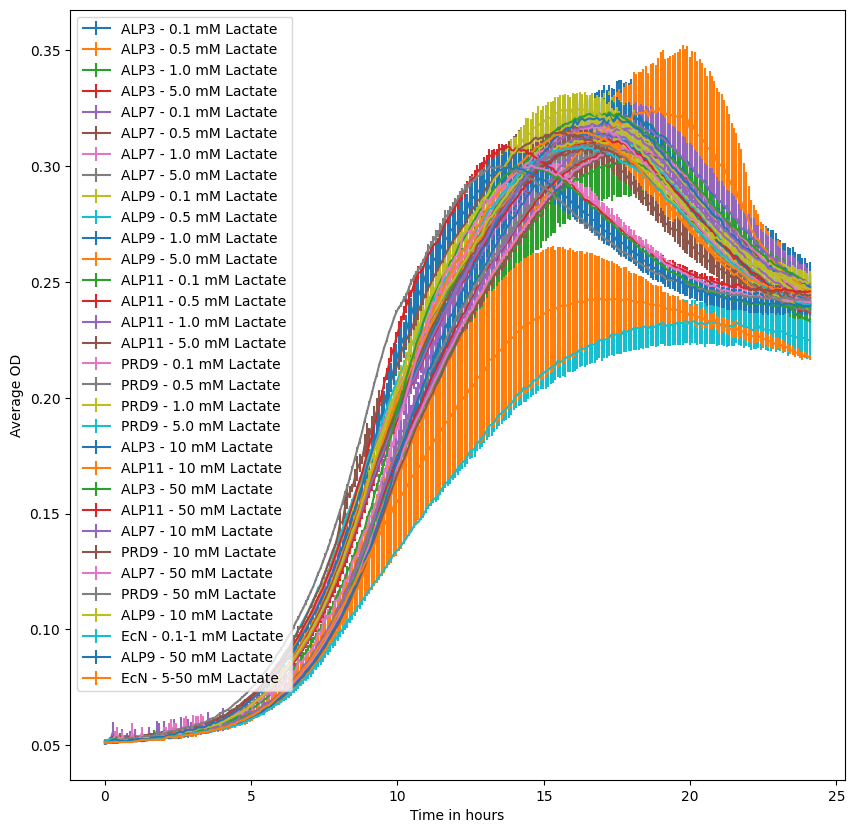

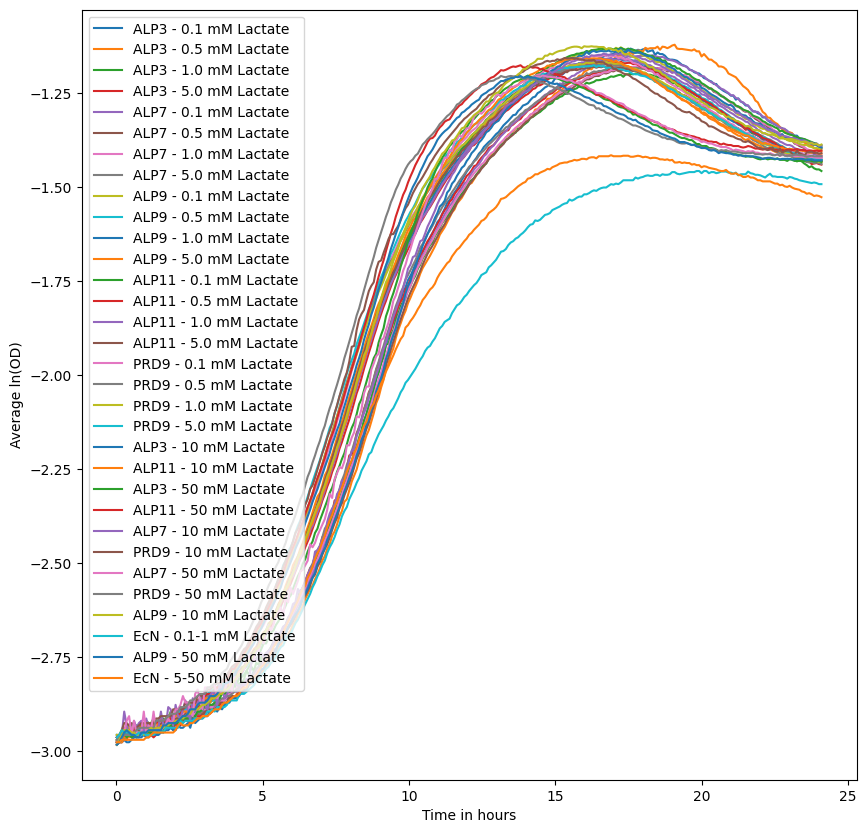

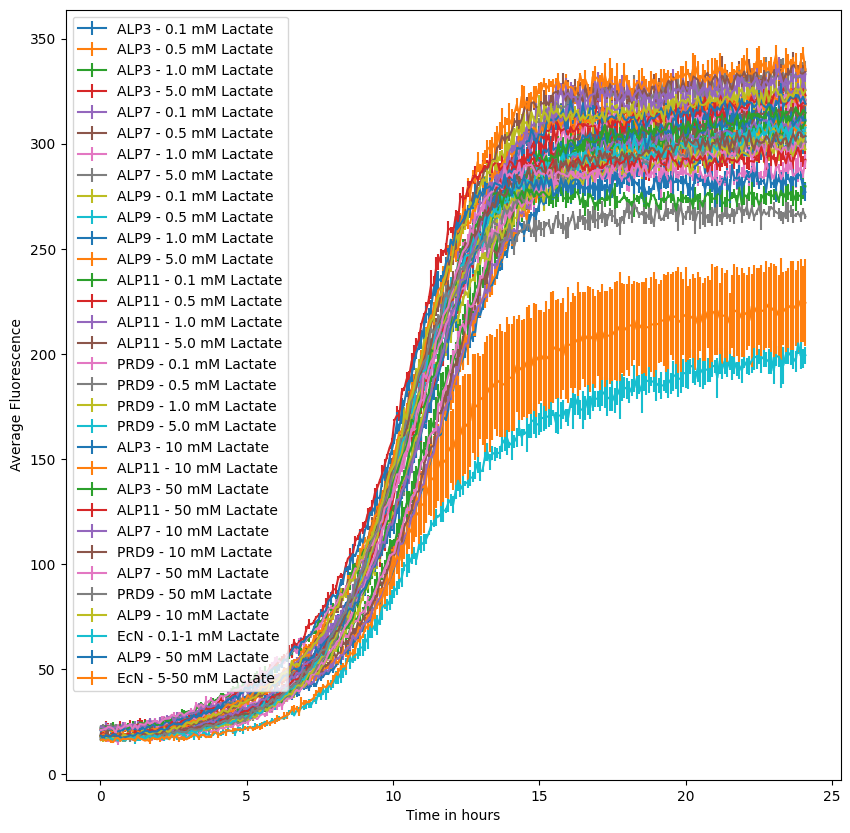

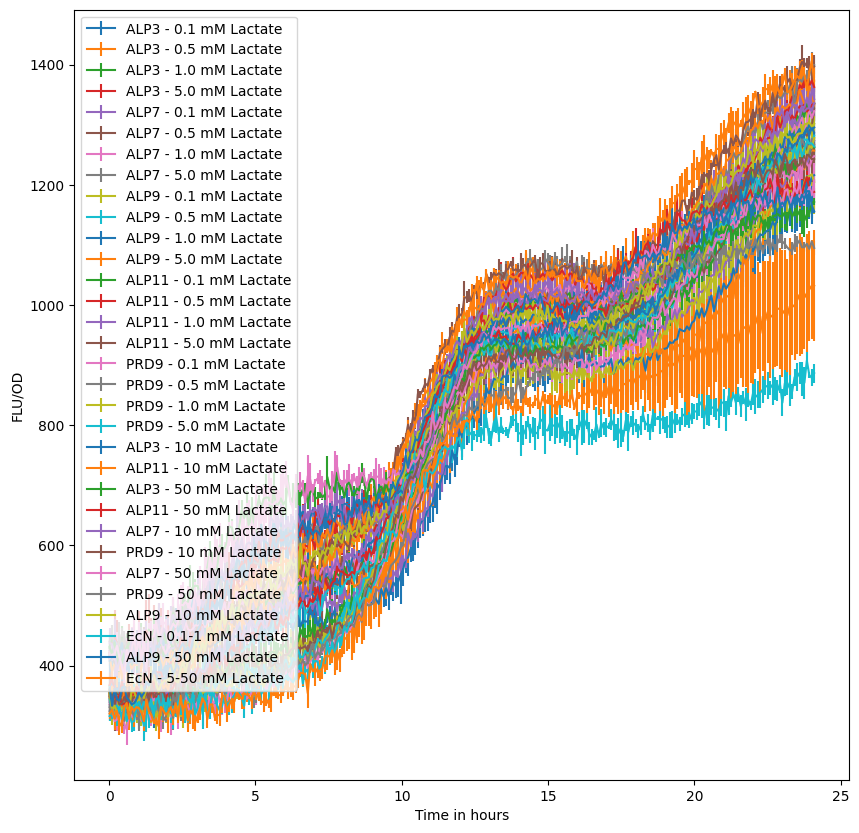

In [31]:
#Specify number of replicates
replicates = 3

OD_avg7= np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
OD_std7 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLU_avg7 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLU_std7 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLUOD_avg7 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLUOD_std7 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))

for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        #Calculate average and stdev
        #Some standard deviations are zero
        OD_avg7[:,index] = np.average(data_OD[:,i:i+replicates], axis=1)
        OD_std7[:,index] = np.std(data_OD[:,i:i+replicates], axis=1)
        
        FLU_avg7[:,index] = np.average(data_FLU[:,i:i+replicates], axis=1)
        FLU_std7[:,index] = np.std(data_FLU[:,i:i+replicates], axis=1)
        
        FLUOD_avg7[:,index] = np.average(data_FLUOD[:,i:i+replicates], axis=1)
        FLUOD_std7[:,index] = np.std(data_FLUOD[:,i:i+replicates], axis=1)

#Plot average OD levels
labels7 = ['ALP3 - 0.1 mM Lactate',
          'ALP3 - 0.5 mM Lactate',
          'ALP3 - 1.0 mM Lactate',
          'ALP3 - 5.0 mM Lactate',
          'ALP7 - 0.1 mM Lactate',
          'ALP7 - 0.5 mM Lactate',
          'ALP7 - 1.0 mM Lactate',
          'ALP7 - 5.0 mM Lactate',
          'ALP9 - 0.1 mM Lactate',
          'ALP9 - 0.5 mM Lactate',
          'ALP9 - 1.0 mM Lactate',
          'ALP9 - 5.0 mM Lactate',
          'ALP11 - 0.1 mM Lactate',
          'ALP11 - 0.5 mM Lactate',
          'ALP11 - 1.0 mM Lactate',
          'ALP11 - 5.0 mM Lactate',
          'PRD9 - 0.1 mM Lactate',
          'PRD9 - 0.5 mM Lactate',
          'PRD9 - 1.0 mM Lactate',
          'PRD9 - 5.0 mM Lactate',
          'ALP3 - 10 mM Lactate',
          'ALP11 - 10 mM Lactate',
          'ALP3 - 20 mM Lactate',
          'ALP11 - 20 mM Lactate',
          'ALP7 - 10 mM Lactate',
          'PRD9 - 10 mM Lactate',
          'ALP7 - 20 mM Lactate',
          'PRD9 - 20 mM Lactate',
          'ALP9 - 10 mM Lactate',
          'EcN - 0.1-1 mM Lactate',
          'ALP9 - 20 mM Lactate',
          'EcN - 5-20 mM Lactate']
plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        plt.errorbar(time, OD_avg7[:,index], yerr=OD_std7[:,index], label=labels7[index])
plt.legend(loc="upper left")
plt.ylabel('Average OD')
plt.xlabel('Time in hours')
plt.show()

plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        log = np.log(OD_avg7[:,index])
        plt.plot(time, log, label=labels7[index])
plt.legend(loc="upper left")
plt.ylabel('Average ln(OD)')
plt.xlabel('Time in hours')
plt.show()


plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        plt.errorbar(time, FLU_avg7[:,index], yerr=FLU_std7[:,index], label=labels7[index])
plt.legend(loc="upper left")
plt.ylabel('Average Fluorescence')
plt.xlabel('Time in hours')
plt.show()

plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        plt.errorbar(time, FLUOD_avg7[:,index], yerr=FLUOD_std7[:,index], label=labels7[index])
plt.legend(loc="upper left")
plt.ylabel('FLU/OD')
plt.xlabel('Time in hours')
plt.show()

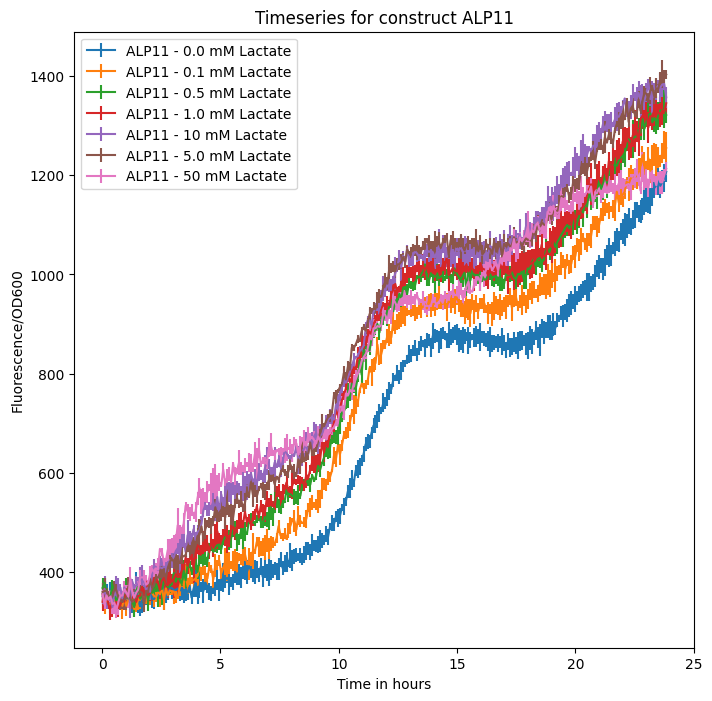

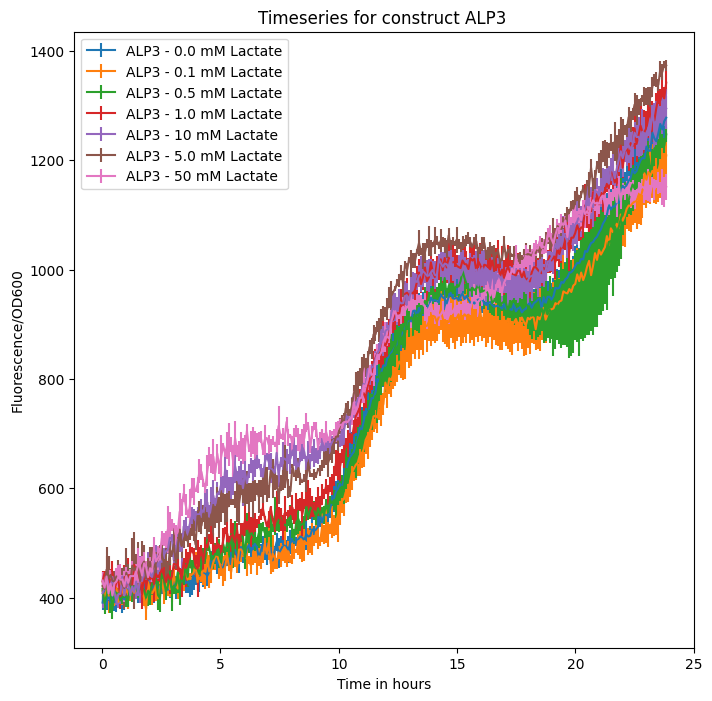

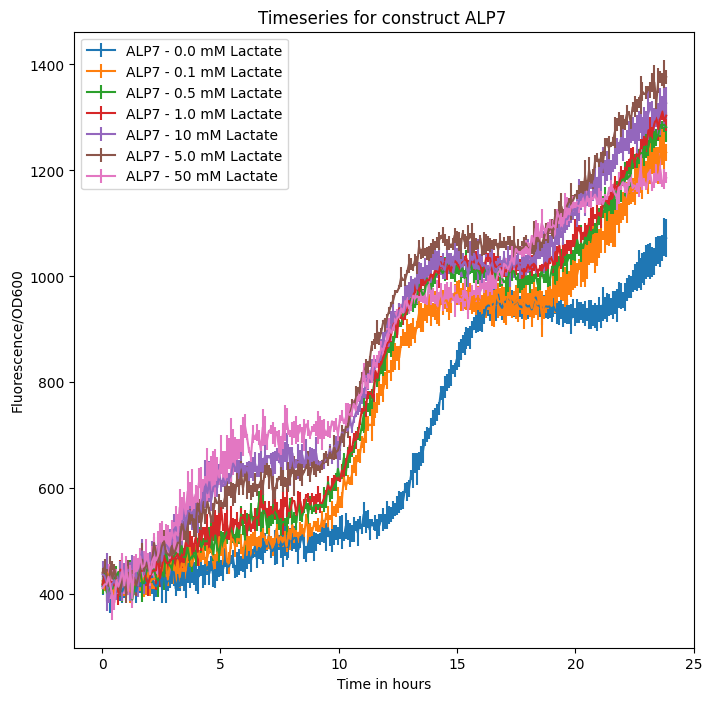

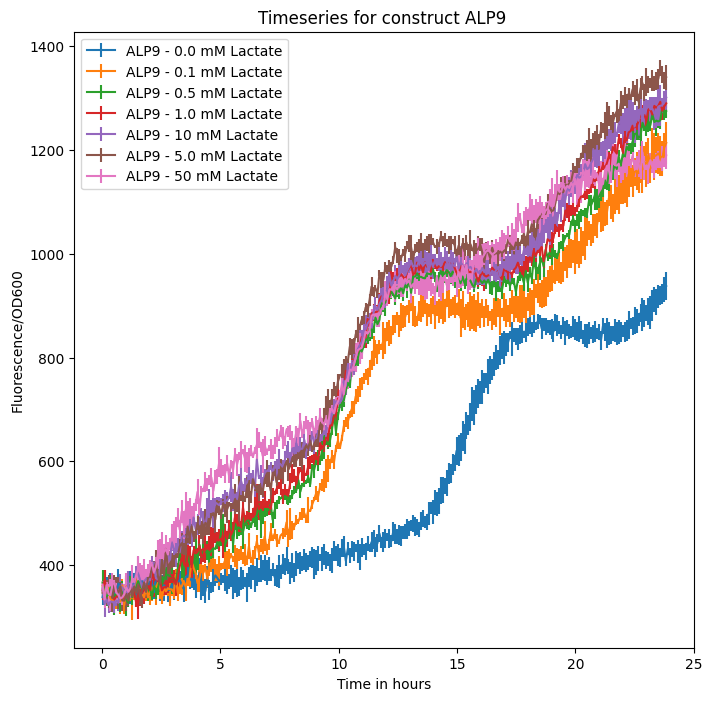

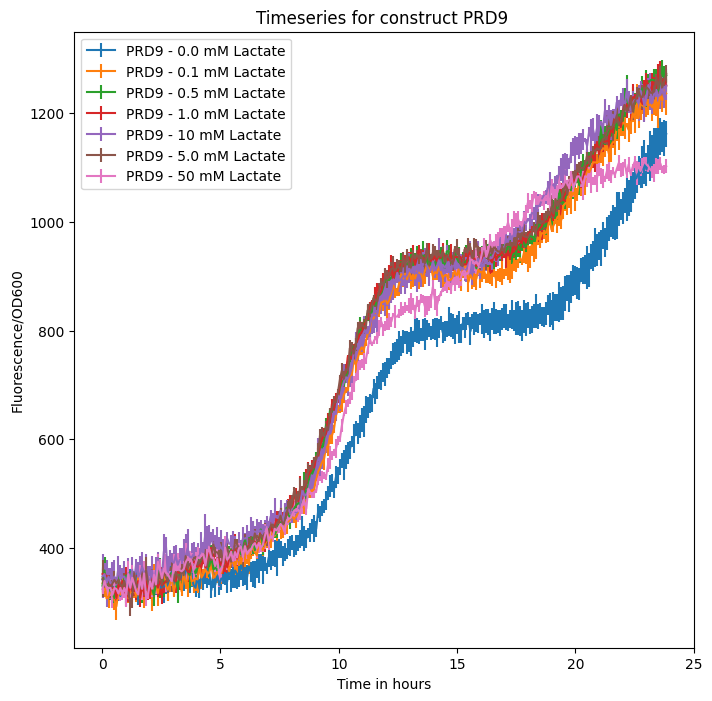

...

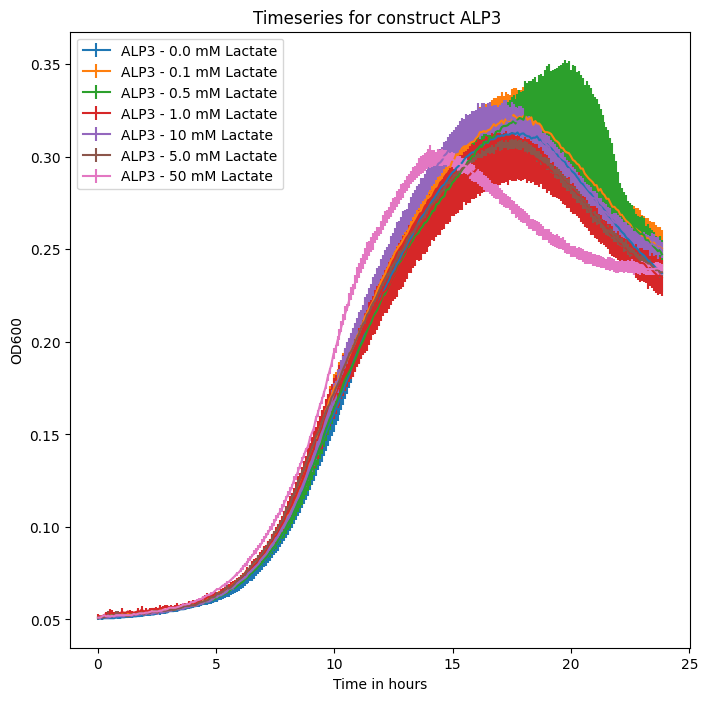

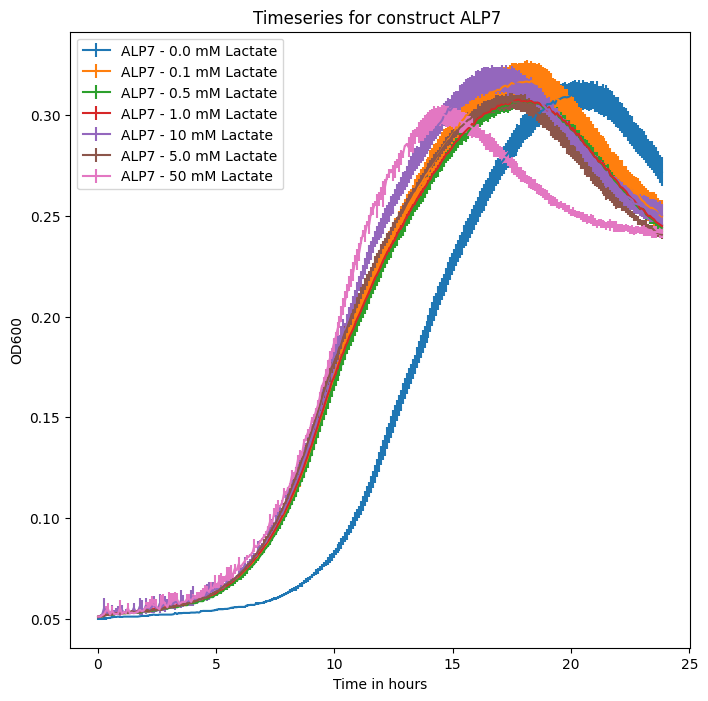

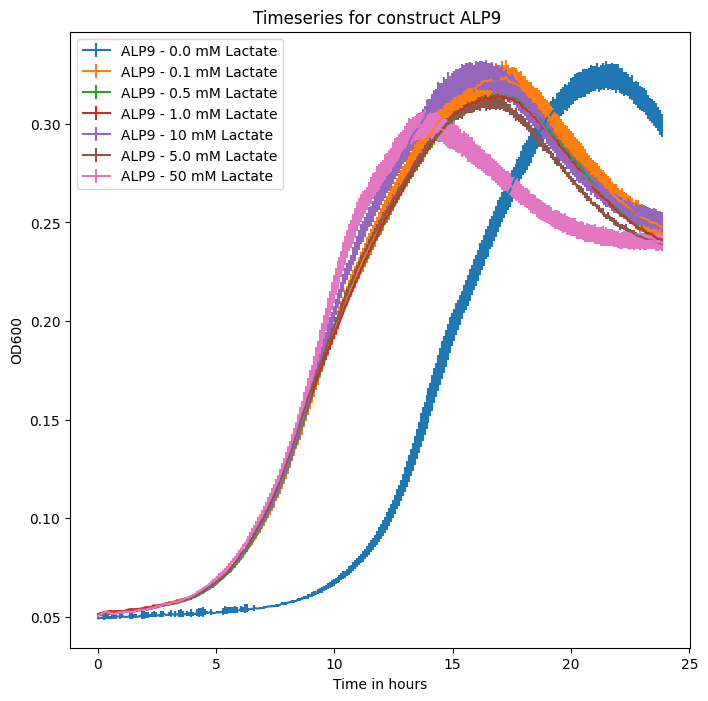

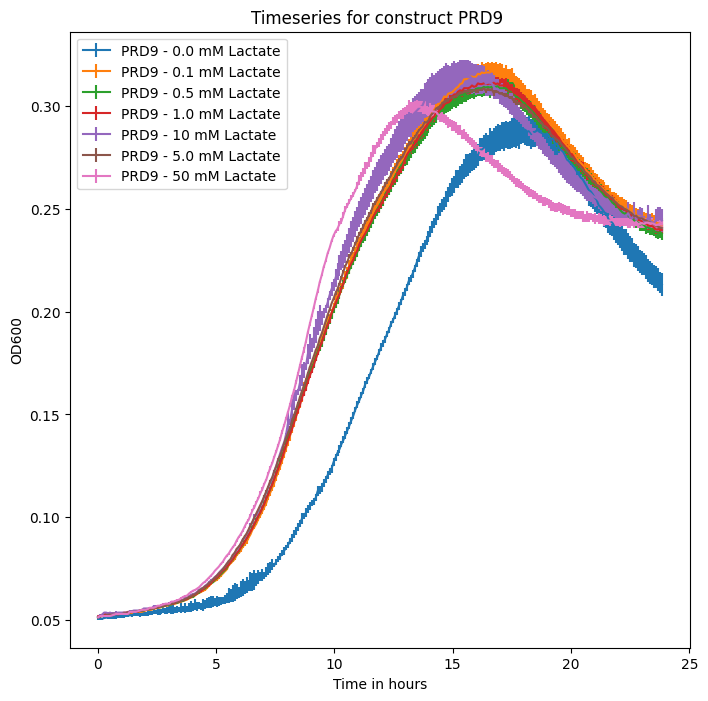

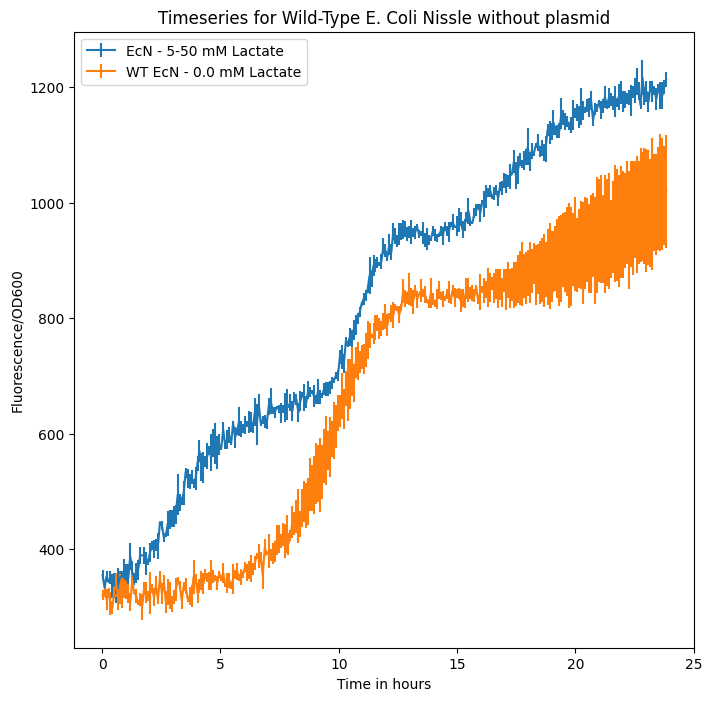

In [32]:
#Add labels together
labels = np.array(labels6 + labels7)

sort_index = labels.argsort()
#Sort everything on label
labels = labels[sort_index]
wt_index = np.flatnonzero(np.core.defchararray.find(labels,"EcN")!=-1)
wt_labels = labels[wt_index]

#Remove WT from labels, data to not interfere with dose-response curves
labels = np.delete(labels, wt_index)
sort_index = np.delete(sort_index, wt_index)
#Concentrations are not in order because argsort doesnt sort the numbers in a string correctly
# concentrations = np.array([0,0.1,0.5,1,10,5,20])
concentrations = np.array([0,0.05,0.2,0.5,5,2,20])
time = time[:-3]
FLUOD_avg = np.column_stack((FLUOD_avg6,FLUOD_avg7[:-3]))
FLUOD_std = np.column_stack((FLUOD_std6,FLUOD_std7[:-3]))

FLU_avg = np.column_stack((FLU_avg6,FLU_avg7[:-3]))
FLU_std = np.column_stack((FLU_std6,FLU_std7[:-3]))

OD_avg = np.column_stack((OD_avg6,OD_avg7[:-3]))
OD_std = np.column_stack((OD_std6,OD_std7[:-3]))

WT_avg = FLUOD_avg[:,wt_index]
WT_std = FLUOD_std[:,wt_index]

FLUOD_avg = FLUOD_avg[:,sort_index]
FLUOD_std = FLUOD_std[:,sort_index]
FLU_avg = FLU_avg[:,sort_index]
FLU_std = FLU_std[:,sort_index]
OD_avg = OD_avg[:,sort_index]
OD_std = OD_std[:,sort_index]

for i in range(int(len(FLUOD_avg[0])/7)):
    plt.figure(figsize=(8,8))
    for j in range(7):
        plt.errorbar(time, FLUOD_avg[:,i*7+j], yerr=FLUOD_std[:,i*7+j], label=labels[i*7+j])
    plt.title(f"Timeseries for construct {labels[i*7][:5]}")
    plt.legend(loc="upper left")
    plt.xlabel('Time in hours')
    plt.ylabel('Fluorescence/OD600')
    plt.show()

for i in range(int(len(FLUOD_avg[0])/7)):
    plt.figure(figsize=(8,8))
    for j in range(7):
        plt.errorbar(time, OD_avg[:,i*7+j], yerr=OD_std[:,i*7+j], label=labels[i*7+j])
    plt.title(f"Timeseries for construct {labels[i*7][:5]}")
    plt.legend(loc="upper left")
    plt.xlabel('Time in hours')
    plt.ylabel('OD600')
    plt.show()
    
#Plot the wild-type time-series
plt.figure(figsize=(8,8))
for j in range(1,len(wt_labels)):
    plt.errorbar(time, WT_avg[:,j], yerr=WT_std[:,j], label=wt_labels[j])
plt.title(f"Timeseries for Wild-Type E. Coli Nissle without plasmid")
plt.legend(loc="upper left")
plt.xlabel('Time in hours')
plt.ylabel('Fluorescence/OD600')
plt.show()

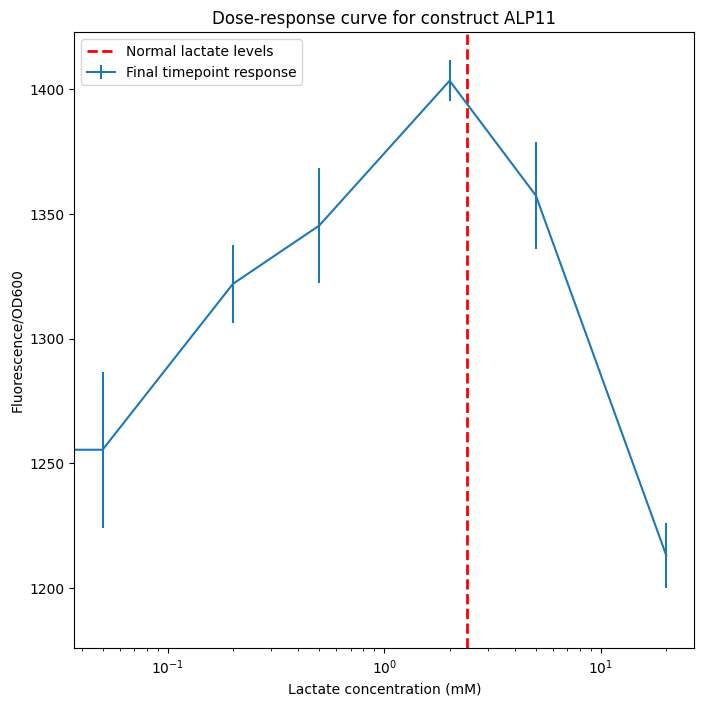

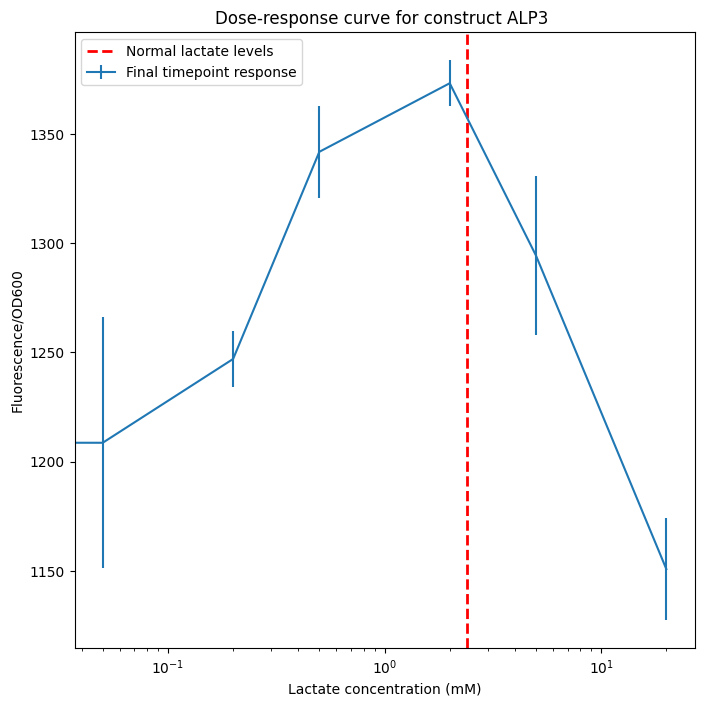

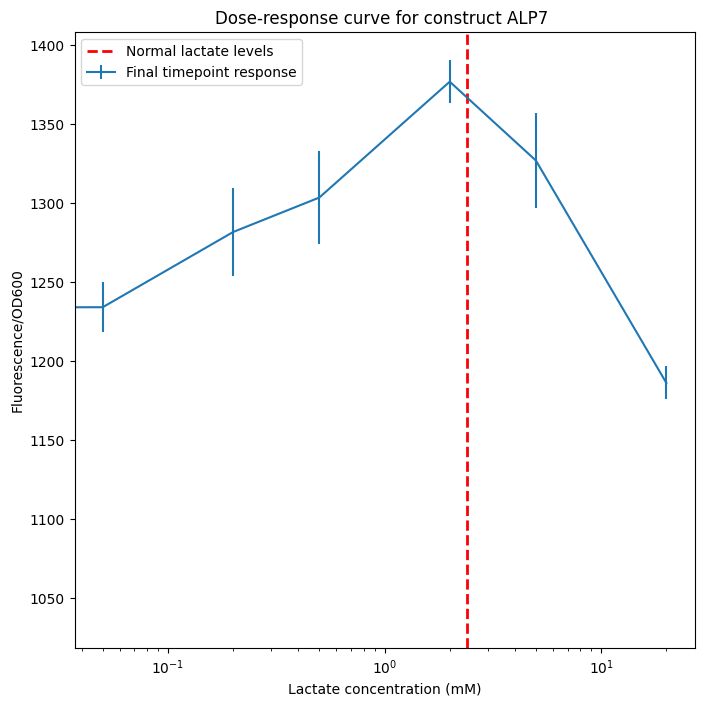

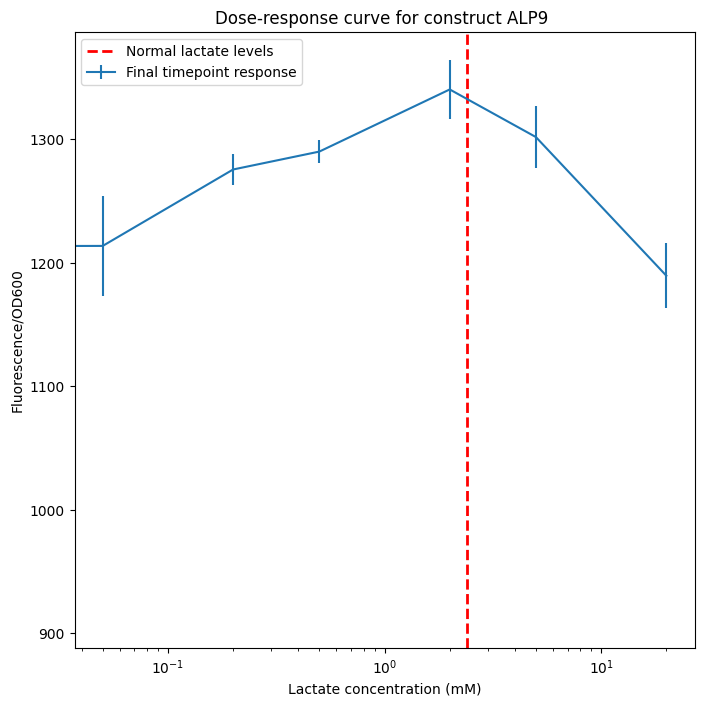

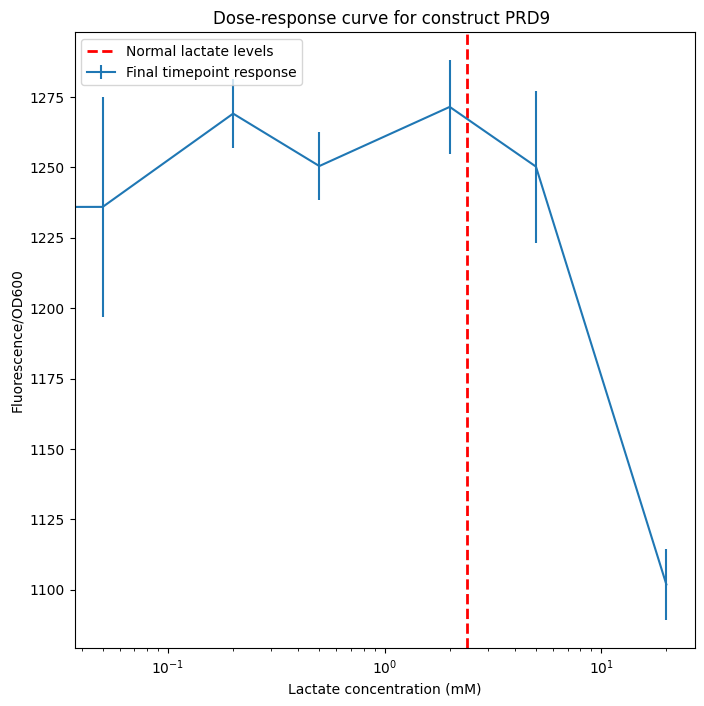

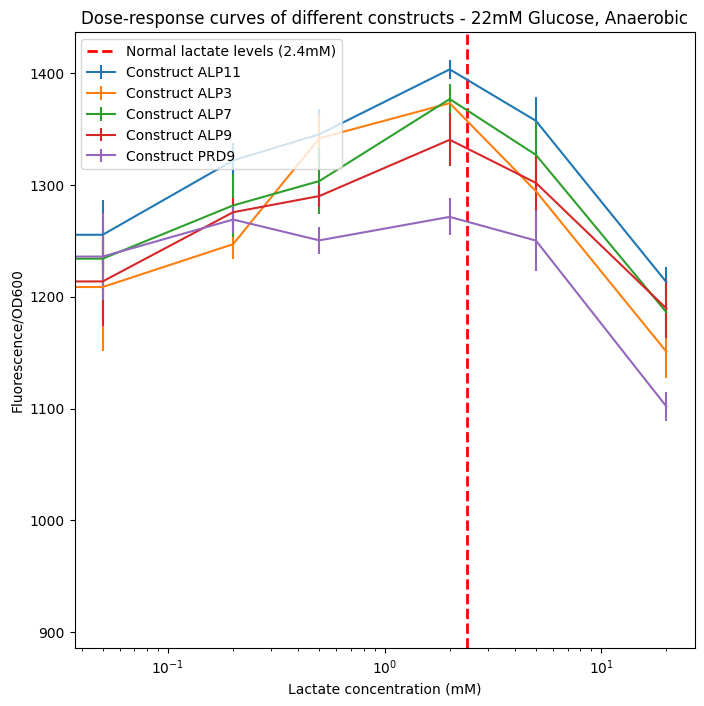

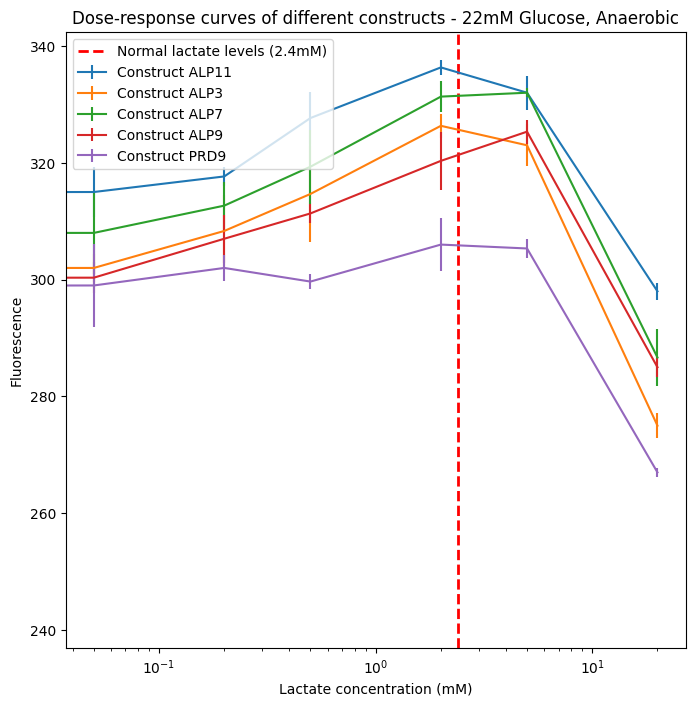

In [33]:
#Plot dose_response curves
for i in range(int(len(FLUOD_avg[0])/7)):
    plt.figure(figsize=(8,8))
    response = FLUOD_avg[-1,i*7:i*7+7]
    response_error = FLUOD_std[-1,i*7:i*7+7]

    #Sort response again since labels are weirdly sorted
    response = response[concentrations.argsort()]
    response_error = response_error[concentrations.argsort()]
    
    plt.errorbar(concentrations[concentrations.argsort()], response, yerr=response_error, label="Final timepoint response")
    plt.title(f"Dose-response curve for construct {labels[i*7][:5]}")
    plt.axvline(2.4,ymin =0, ymax=1, label=f"Normal lactate levels", color="red", linestyle="--", linewidth=2)
    plt.xlabel('Lactate concentration (mM)')
    plt.ylabel('Fluorescence/OD600')
    plt.legend(loc="upper left")
    plt.xscale('log')
    plt.show()
    
#Plot all dose_response curves in one figure
plt.figure(figsize=(8,8))
for i in range(int(len(FLUOD_avg[0])/7)):
    response = FLUOD_avg[-1,i*7:i*7+7]
    response_error = FLUOD_std[-1,i*7:i*7+7]

    #Sort response again since labels are weirdly sorted
    response = response[concentrations.argsort()]
    response_error = response_error[concentrations.argsort()]
    
    plt.errorbar(concentrations[concentrations.argsort()], response, yerr=response_error, label=f"Construct {labels[i*7][:5]}")
plt.title(f"Dose-response curves of different constructs - 22mM Glucose, Anaerobic")
plt.axvline(2.4,ymin =0, ymax=1, label=f"Normal lactate levels (2.4mM)", color="red", linestyle="--", linewidth=2)
plt.legend(loc="upper left")
plt.xlabel('Lactate concentration (mM)')
plt.ylabel('Fluorescence/OD600')
plt.xscale('log')
plt.show()

#Plot all dose_response curves in one figure
plt.figure(figsize=(8,8))
for i in range(int(len(FLUOD_avg[0])/7)):
    response = FLU_avg[-1,i*7:i*7+7]
    response_error = FLU_std[-1,i*7:i*7+7]

    #Sort response again since labels are weirdly sorted
    response = response[concentrations.argsort()]
    response_error = response_error[concentrations.argsort()]
    
    plt.errorbar(concentrations[concentrations.argsort()], response, yerr=response_error, label=f"Construct {labels[i*7][:5]}")
plt.title(f"Dose-response curves of different constructs - 22mM Glucose, Anaerobic")
plt.axvline(2.4,ymin =0, ymax=1, label=f"Normal lactate levels (2.4mM)", color="red", linestyle="--", linewidth=2)
plt.legend(loc="upper left")
plt.xlabel('Lactate concentration (mM)')
plt.ylabel('Fluorescence')
plt.xscale('log')
plt.show()

#Save data
header_list = [x for x in labels]
header_list.insert(0,'Time(h)')

#Create dataframes.
Glucose_anaerobic_OD_processed = pd.DataFrame(np.column_stack((time,OD_avg)), columns=header_list)
Glucose_anaerobic_FLU_processed = pd.DataFrame(np.column_stack((time,FLU_avg)), columns=header_list)
Glucose_anaerobic_FLUOD_processed = pd.DataFrame(np.column_stack((time,FLUOD_avg)), columns=header_list)
Glucose_anaerobic_OD_std_processed = pd.DataFrame(np.column_stack((time,OD_std)), columns=header_list)
Glucose_anaerobic_FLU_std_processed = pd.DataFrame(np.column_stack((time,FLU_std)), columns=header_list)
Glucose_anaerobic_FLUOD_std_processed = pd.DataFrame(np.column_stack((time,FLUOD_std)), columns=header_list)

#Sort labels and restructure data accordingly.
header = sorted_nicely(labels)
header.insert(0,'Time(h)')
# print(f"Sorted header list:{header}\n\n")
# print(Glucose_anaerobic_OD_processed.head())
Glucose_anaerobic_OD_processed = Glucose_anaerobic_OD_processed[header]
# print(Glucose_anaerobic_OD_processed.head())
Glucose_anaerobic_FLU_processed = Glucose_anaerobic_FLU_processed[header]
Glucose_anaerobic_FLUOD_processed = Glucose_anaerobic_FLUOD_processed[header]
Glucose_anaerobic_OD_std_processed = Glucose_anaerobic_OD_std_processed[header]
Glucose_anaerobic_FLU_std_processed = Glucose_anaerobic_FLU_std_processed[header]
Glucose_anaerobic_FLUOD_std_processed = Glucose_anaerobic_FLUOD_std_processed[header]

Glucose_anaerobic_OD_processed.to_csv('Data/22mMGlucose_anaerobic_OD_processed.csv',index=False)
Glucose_anaerobic_FLU_processed.to_csv('Data/22mMGlucose_anaerobic_FLU_processed.csv', index=False)
Glucose_anaerobic_FLUOD_processed.to_csv('Data/22mMGlucose_anaerobic_FLUOD_processed.csv', index=False)
Glucose_anaerobic_OD_std_processed.to_csv('Data/22mMGlucose_anaerobic_OD_std_processed.csv', index=False)
Glucose_anaerobic_FLU_std_processed.to_csv('Data/22mMGlucose_anaerobic_FLU_std_processed.csv', index=False)
Glucose_anaerobic_FLUOD_std_processed.to_csv('Data/22mMGlucose_anaerobic_FLUOD_std_processed.csv', index=False)

[1144.6260025  1306.53515498 1307.94738888 1329.06750459 2013.30876093
 3483.64262604 8142.58055031]
[ 4696.35221454  2772.37921739  3004.05417446  2875.6673374
  4830.27256449  5948.56208169 10384.28802765]
[ 3995.10830975  2747.91665766  2962.73746178  2666.81922975
  5025.84496352  6359.331379   10819.30908723]
[1214.85213521 1319.8739273  1321.94355711 1353.25283258 2094.23502069
 3594.40432819 8513.15037897]
[ 553.05307413 1134.64883861 1134.24899835 1155.80657966 2231.63215966
 3819.2783623  7497.5959317 ]


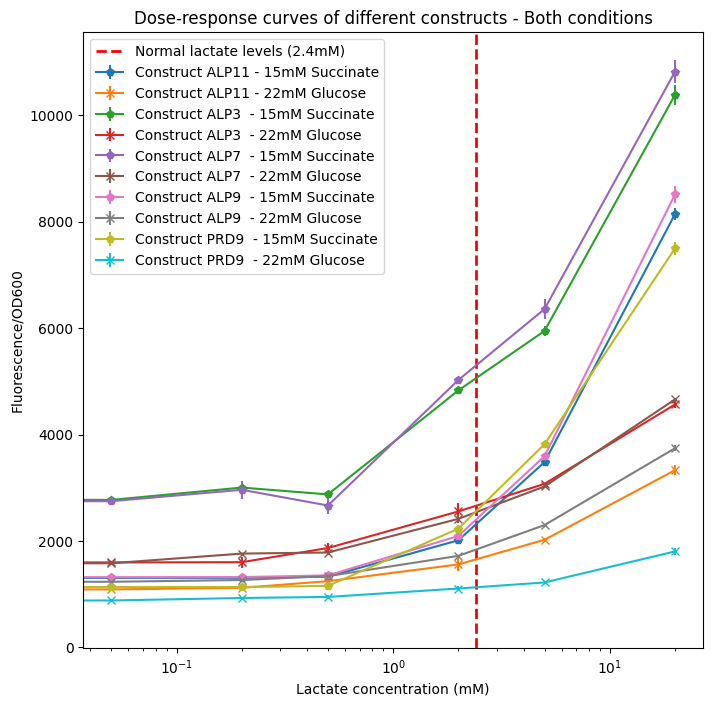

In [34]:
#Plot all dose_response curves in one figure
plt.figure(figsize=(8,8))
for i in range(int(len(FLUOD_avg_suc[0])/7)):
    response_suc = FLUOD_avg_suc[-1,i*7:i*7+7]
    response_error_suc = FLUOD_std_suc[-1,i*7:i*7+7]
    
    response_glc_aer = FLUOD_avg_glc_aer[-1,i*7:i*7+7]
    response_error_glc_aer = FLUOD_std_glc_aer[-1,i*7:i*7+7]

    #Sort response again since labels are weirdly sorted
    response_suc = response_suc[concentrations.argsort()]
    print(response_suc)
    response_error_suc = response_error_suc[concentrations.argsort()]
    
    response_glc_aer = response_glc_aer[concentrations.argsort()]
    response_error_glc_aer = response_error_glc_aer[concentrations.argsort()]
    
    plt.errorbar(concentrations[concentrations.argsort()], response_suc, yerr=response_error_suc, label=f"Construct {labels[i*7][:5]} - 15mM Succinate", marker='p')
    plt.errorbar(concentrations[concentrations.argsort()], response_glc_aer, yerr=response_error_glc_aer, label=f"Construct {labels[i*7][:5]} - 22mM Glucose", marker='x')
    
plt.title(f"Dose-response curves of different constructs - Both conditions")
plt.axvline(2.4,ymin =0, ymax=1, label=f"Normal lactate levels (2.4mM)", color="red", linestyle="--", linewidth=2)
plt.legend(loc="upper left")
plt.xlabel('Lactate concentration (mM)')
plt.ylabel('Fluorescence/OD600')
plt.xscale('log')
plt.show()

## Experiment 8 - GLucose, anaerobic \<t=16, afterward aerobic

In [35]:
#Load the data
OD_data = pd.read_excel("Data/02-09-2022_EcN_Gluc22mM_Anaerobic_Lactate_OD.xlsx", engine='openpyxl', header=0)
FLU_data = pd.read_excel("Data/02-09-2022_EcN_Gluc22mM_Anaerobic_Lactate_GFP.xlsx", engine='openpyxl', header=0)

#Remove temperature column
OD_data.pop('T° OD600:600')
OD_data['Time'] = OD_data['Time']/3600
FLU_data.pop('T° GFP:479,510')
FLU_data['Time'] = FLU_data['Time']/3600

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


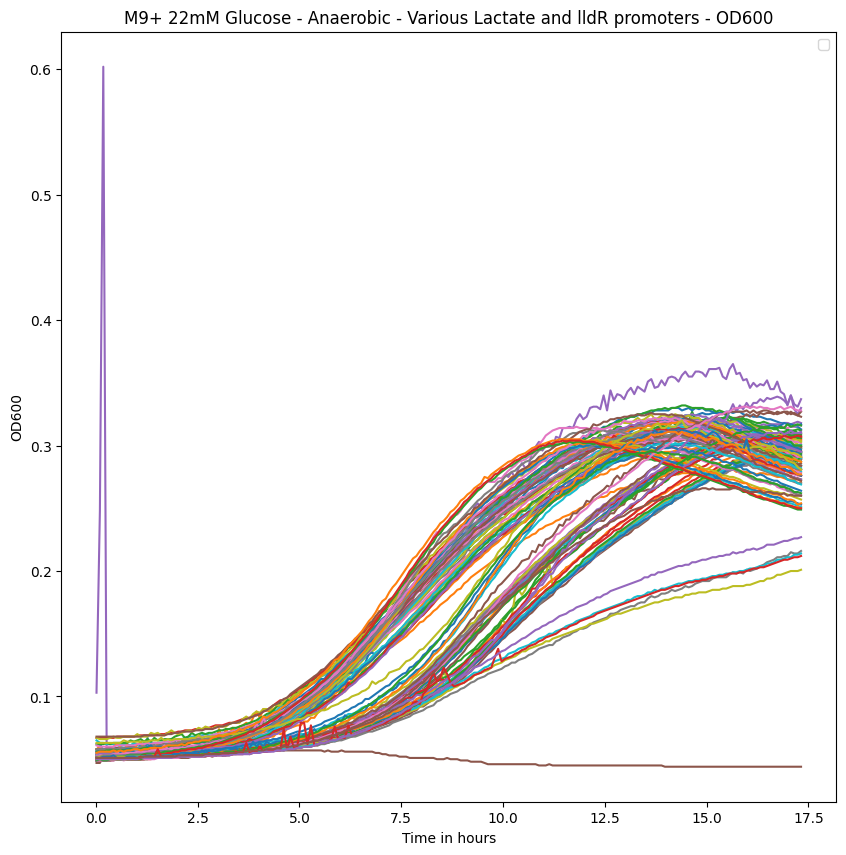

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


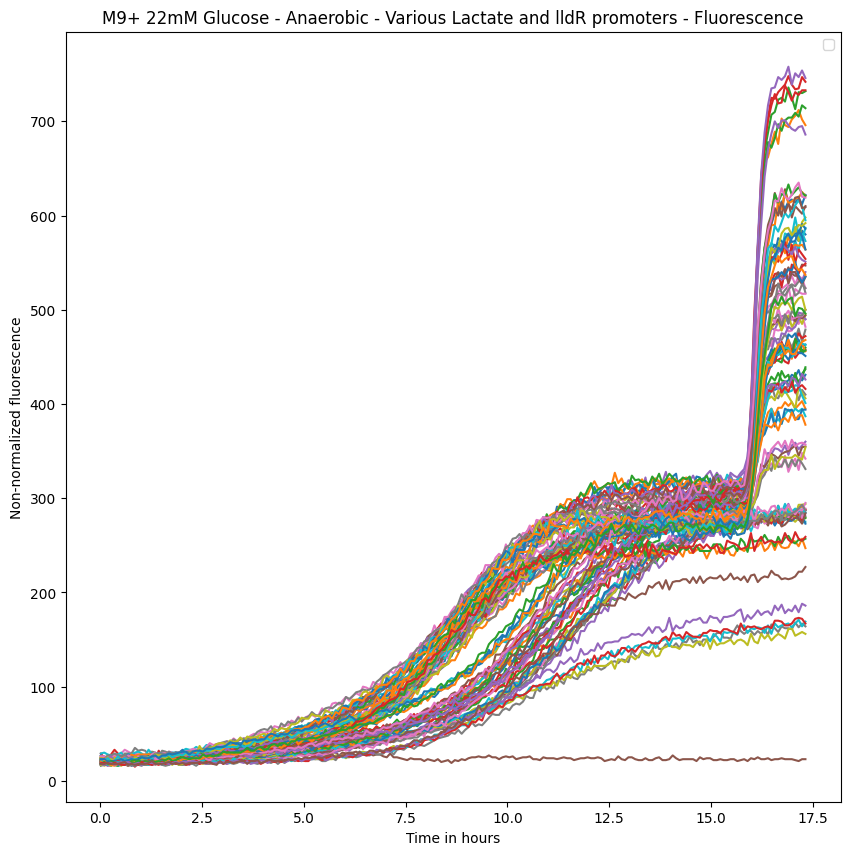

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


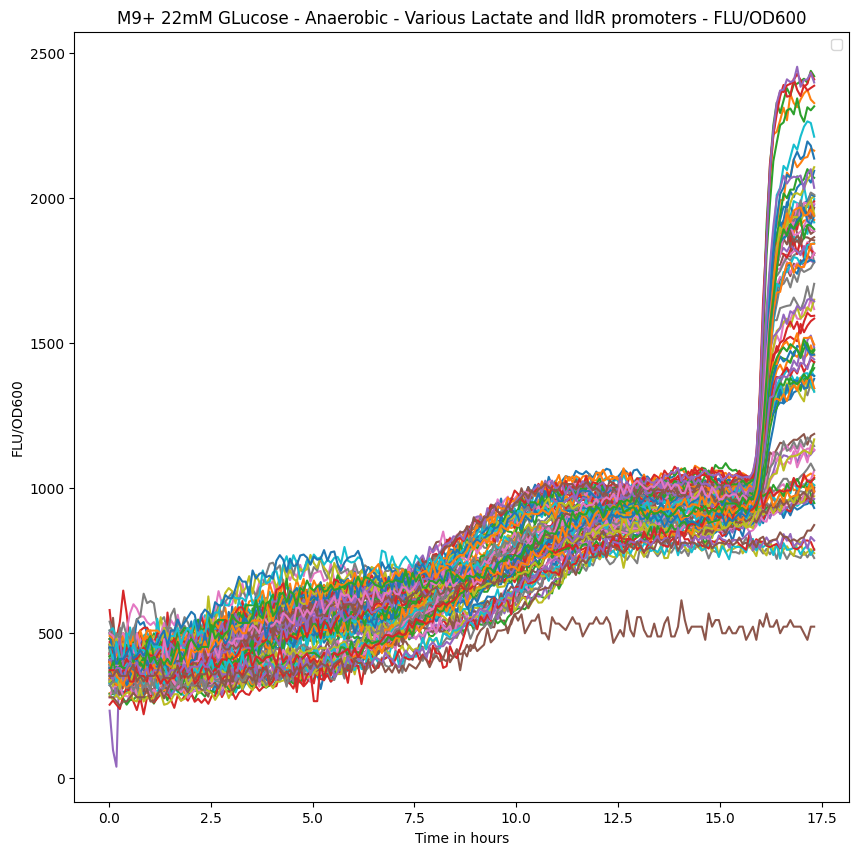

In [36]:
data_OD = OD_data.iloc[:,1:].to_numpy()
data_FLU = FLU_data.iloc[:,1:].to_numpy()

#Correction Vittorio uses
#data_OD = data_OD-np.min(data_OD)
#data_OD = data_OD/0.23+0.02

data_FLUOD = data_FLU/data_OD

time = OD_data.iloc[:,0]

plt.figure(figsize=(10,10))
plt.plot(time, data_OD)#, label=OD_data.columns[1:])
plt.ylabel('OD600')
plt.xlabel('Time in hours')
plt.title('M9+ 22mM Glucose - Anaerobic - Various Lactate and lldR promoters - OD600')
plt.legend()
plt.show()

plt.figure(figsize=(10,10))
plt.plot(time, data_FLU)#, label=OD_data.columns[1:])
plt.ylabel('Non-normalized fluorescence')
plt.xlabel('Time in hours')
plt.title('M9+ 22mM Glucose - Anaerobic - Various Lactate and lldR promoters - Fluorescence')
plt.legend()
plt.show()

plt.figure(figsize=(10,10))
plt.plot(time, data_FLUOD)#, label=OD_data.columns[1:])
plt.ylabel('FLU/OD600')
plt.xlabel('Time in hours')
plt.title('M9+ 22mM GLucose - Anaerobic - Various Lactate and lldR promoters - FLU/OD600')
plt.legend()
plt.show()

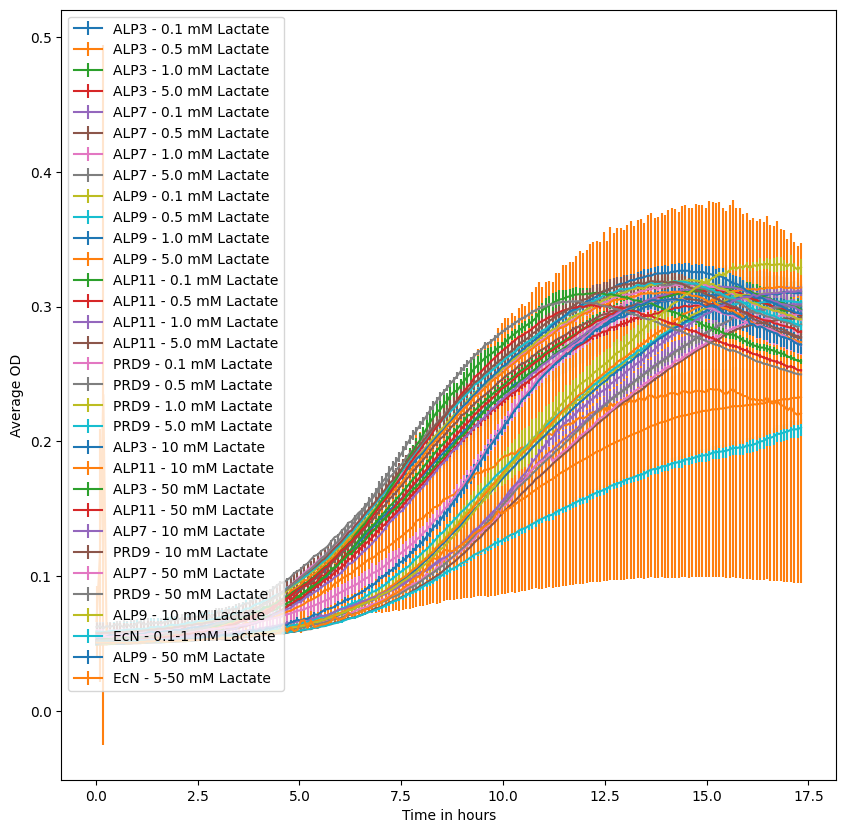

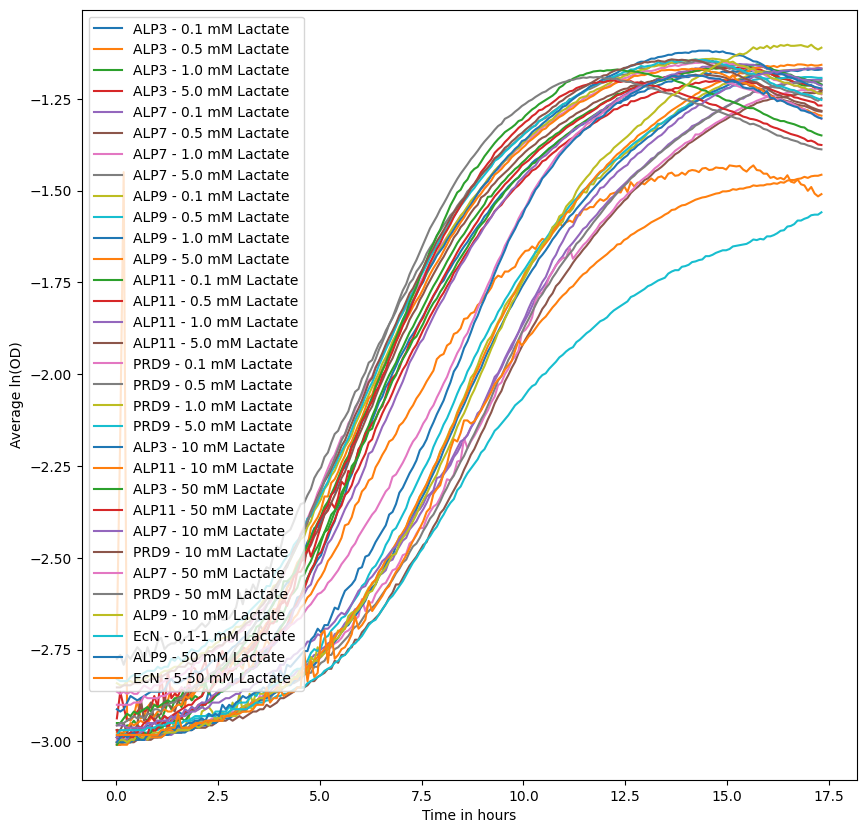

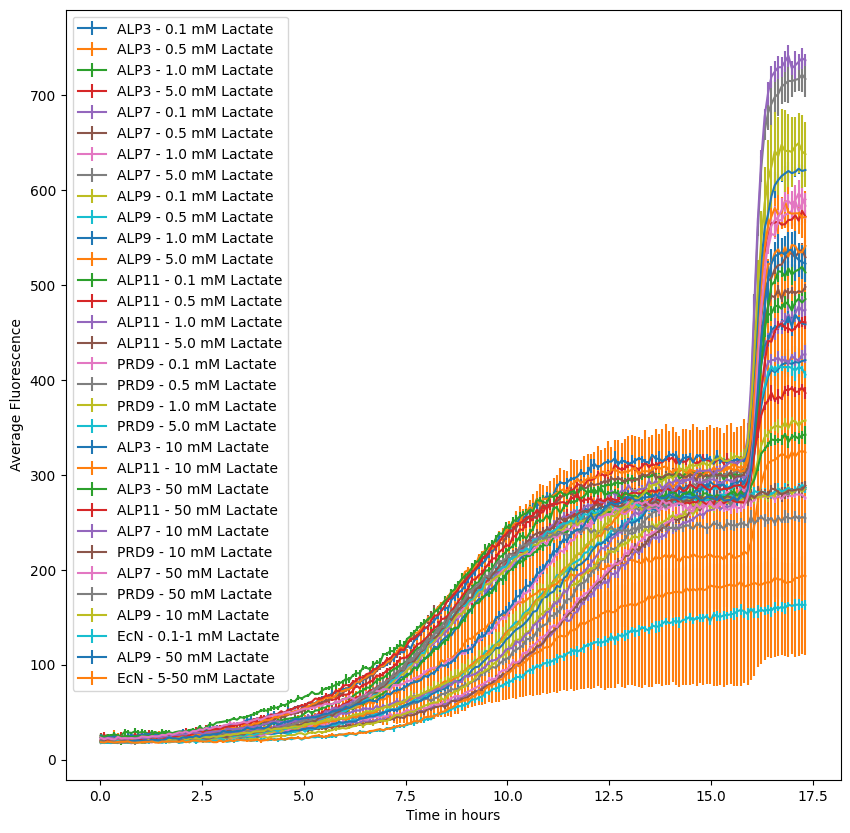

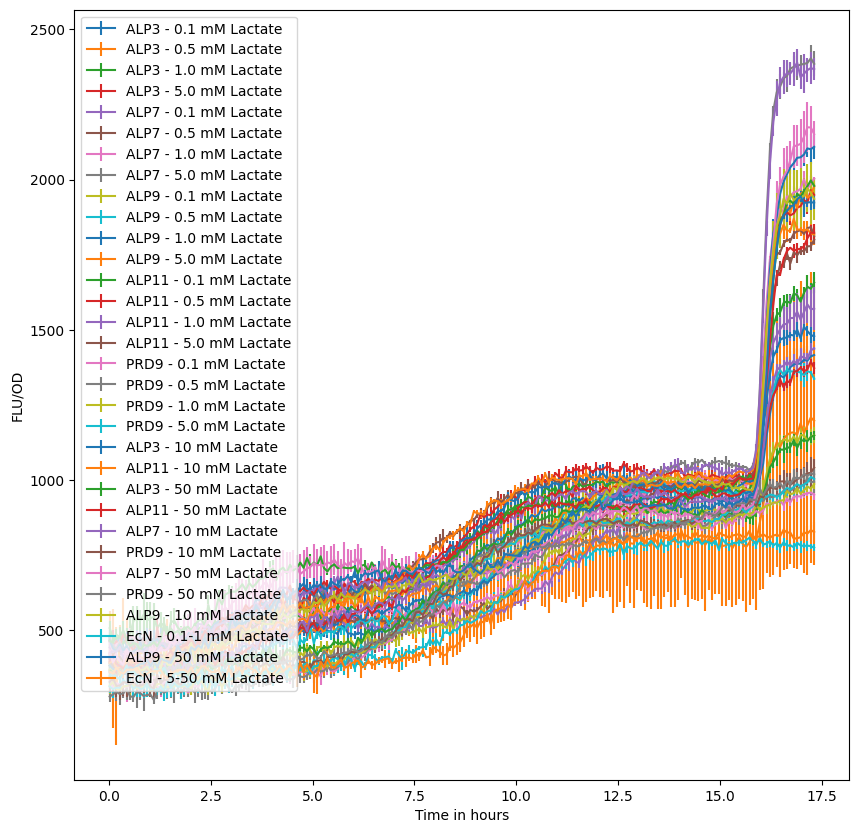

In [37]:
#Specify number of replicates
replicates = 3

OD_avg8= np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
OD_std8 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLU_avg8 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLU_std8 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLUOD_avg8 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLUOD_std8 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))

for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        #Calculate average and stdev
        #Some standard deviations are zero
        OD_avg8[:,index] = np.average(data_OD[:,i:i+replicates], axis=1)
        OD_std8[:,index] = np.std(data_OD[:,i:i+replicates], axis=1)
        
        FLU_avg8[:,index] = np.average(data_FLU[:,i:i+replicates], axis=1)
        FLU_std8[:,index] = np.std(data_FLU[:,i:i+replicates], axis=1)
        
        FLUOD_avg8[:,index] = np.average(data_FLUOD[:,i:i+replicates], axis=1)
        FLUOD_std8[:,index] = np.std(data_FLUOD[:,i:i+replicates], axis=1)

#Plot average OD levels
labels8 = ['ALP3 - 0.1 mM Lactate',
          'ALP3 - 0.5 mM Lactate',
          'ALP3 - 1.0 mM Lactate',
          'ALP3 - 5.0 mM Lactate',
          'ALP7 - 0.1 mM Lactate',
          'ALP7 - 0.5 mM Lactate',
          'ALP7 - 1.0 mM Lactate',
          'ALP7 - 5.0 mM Lactate',
          'ALP9 - 0.1 mM Lactate',
          'ALP9 - 0.5 mM Lactate',
          'ALP9 - 1.0 mM Lactate',
          'ALP9 - 5.0 mM Lactate',
          'ALP11 - 0.1 mM Lactate',
          'ALP11 - 0.5 mM Lactate',
          'ALP11 - 1.0 mM Lactate',
          'ALP11 - 5.0 mM Lactate',
          'PRD9 - 0.1 mM Lactate',
          'PRD9 - 0.5 mM Lactate',
          'PRD9 - 1.0 mM Lactate',
          'PRD9 - 5.0 mM Lactate',
          'ALP3 - 10 mM Lactate',
          'ALP11 - 10 mM Lactate',
          'ALP3 - 20 mM Lactate',
          'ALP11 - 20 mM Lactate',
          'ALP7 - 10 mM Lactate',
          'PRD9 - 10 mM Lactate',
          'ALP7 - 20 mM Lactate',
          'PRD9 - 20 mM Lactate',
          'ALP9 - 10 mM Lactate',
          'EcN - 0.1-1 mM Lactate',
          'ALP9 - 20 mM Lactate',
          'EcN - 5-20 mM Lactate']
plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        plt.errorbar(time, OD_avg8[:,index], yerr=OD_std8[:,index], label=labels8[index])
plt.legend(loc="upper left")
plt.ylabel('Average OD')
plt.xlabel('Time in hours')
plt.show()

plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        log = np.log(OD_avg8[:,index])
        plt.plot(time, log, label=labels8[index])
plt.legend(loc="upper left")
plt.ylabel('Average ln(OD)')
plt.xlabel('Time in hours')
plt.show()


plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        plt.errorbar(time, FLU_avg8[:,index], yerr=FLU_std8[:,index], label=labels8[index])
plt.legend(loc="upper left")
plt.ylabel('Average Fluorescence')
plt.xlabel('Time in hours')
plt.show()

plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        plt.errorbar(time, FLUOD_avg8[:,index], yerr=FLUOD_std8[:,index], label=labels8[index])
plt.legend(loc="upper left")
plt.ylabel('FLU/OD')
plt.xlabel('Time in hours')
plt.show()

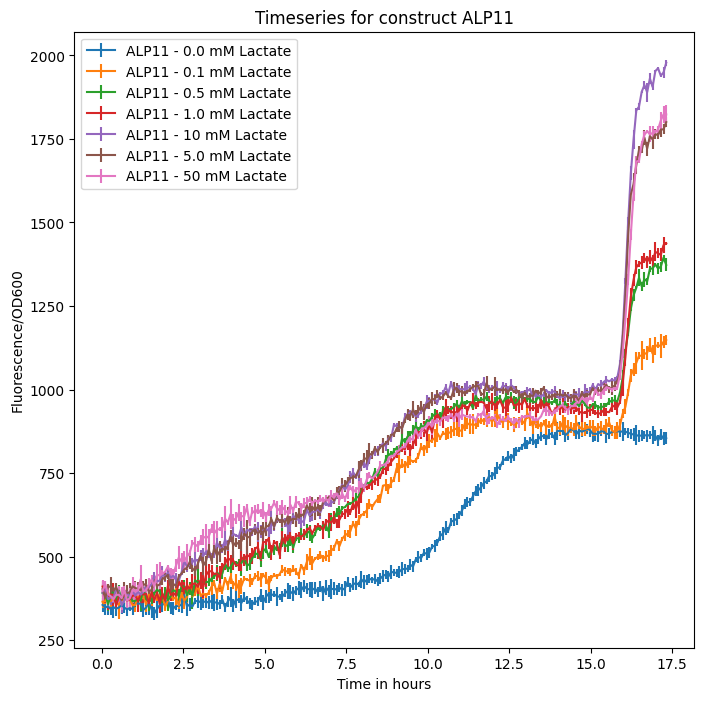

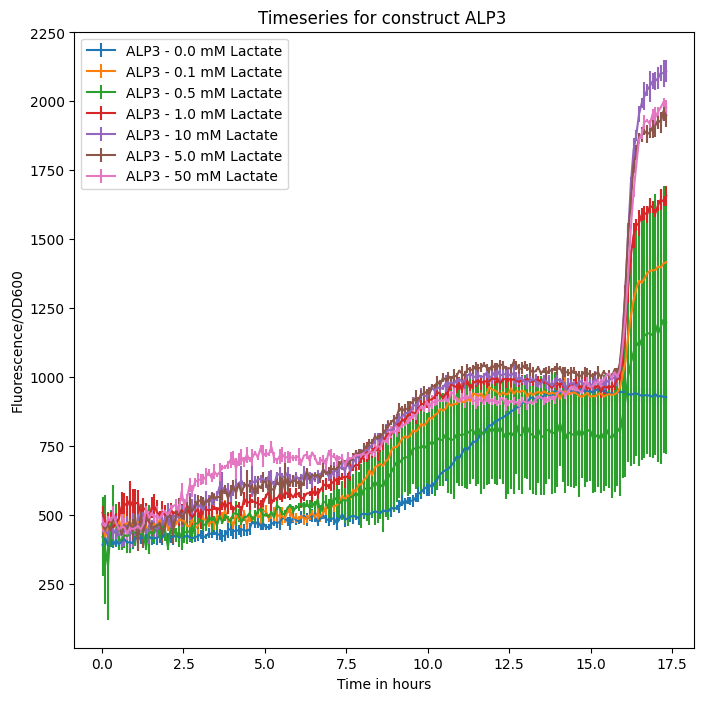

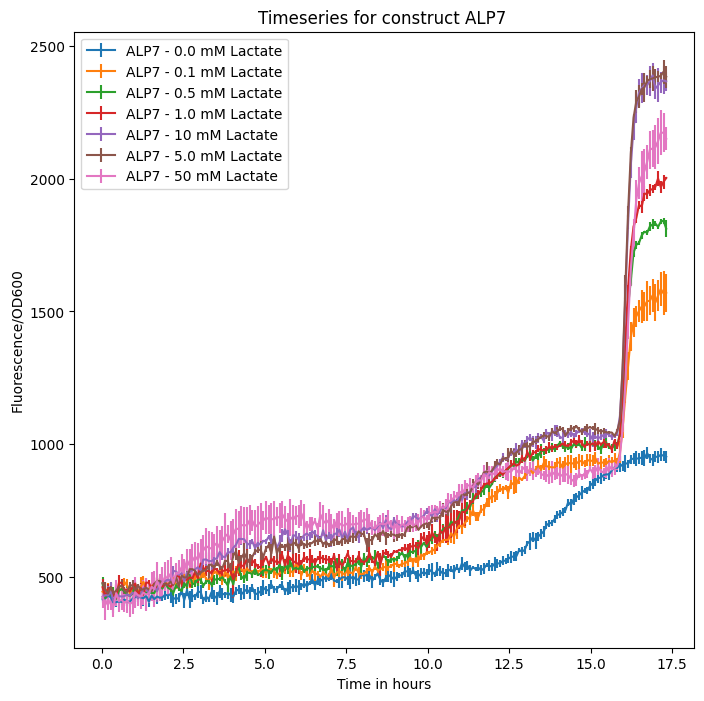

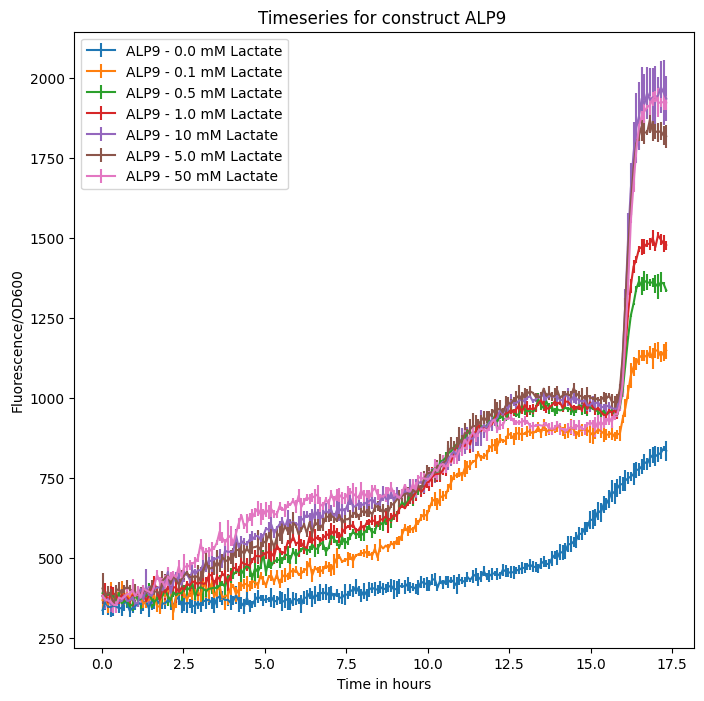

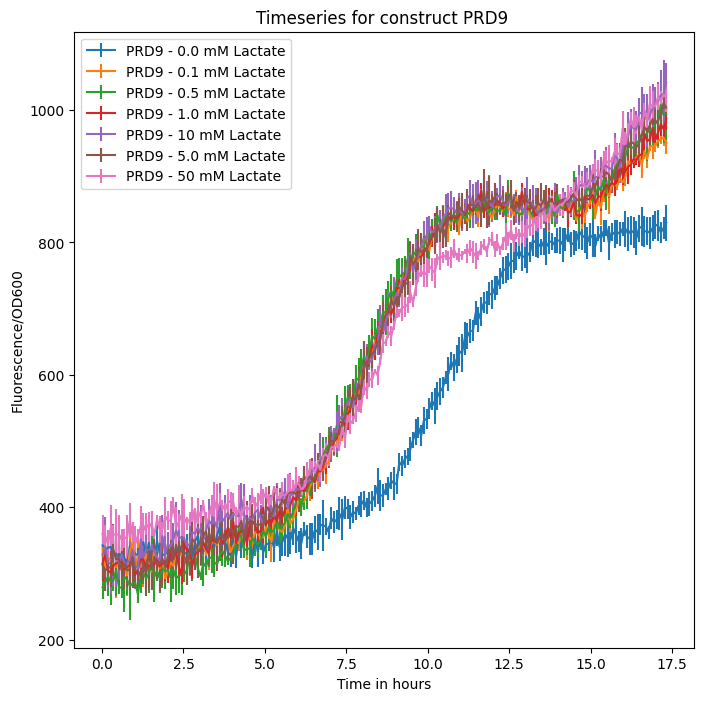

...

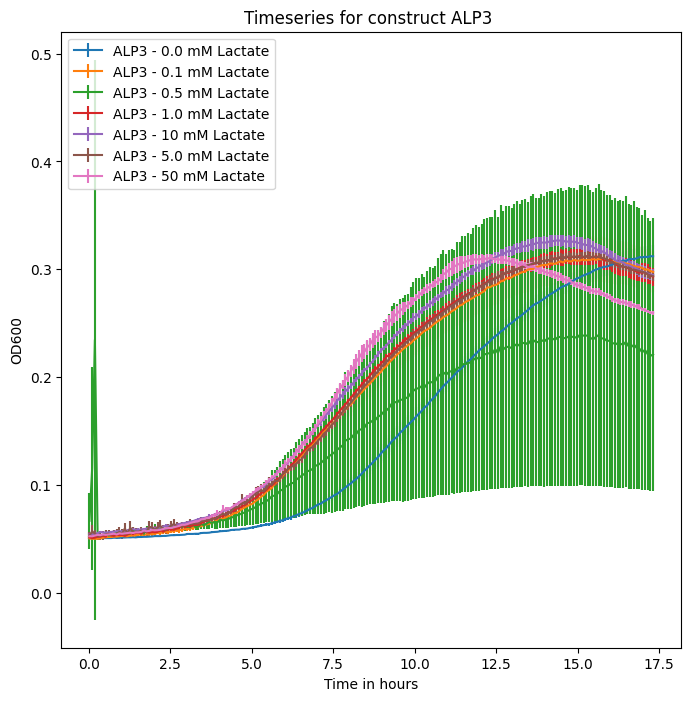

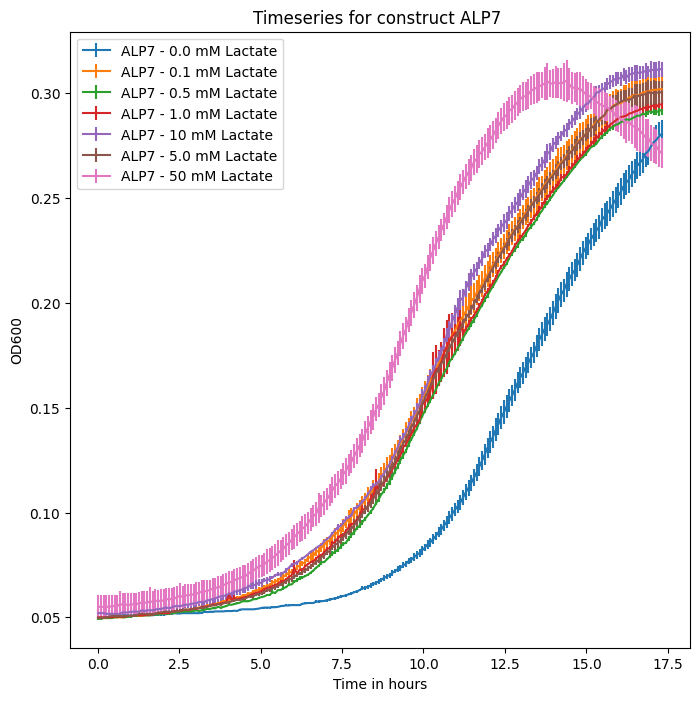

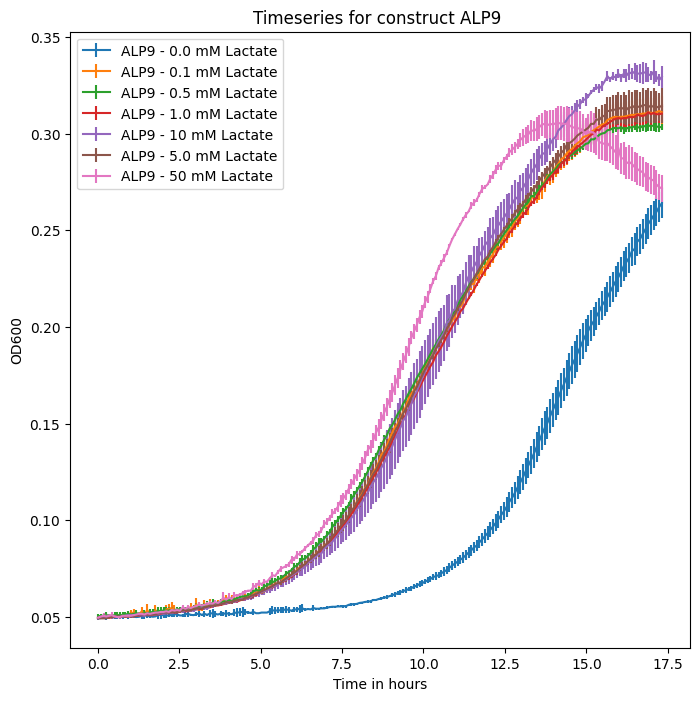

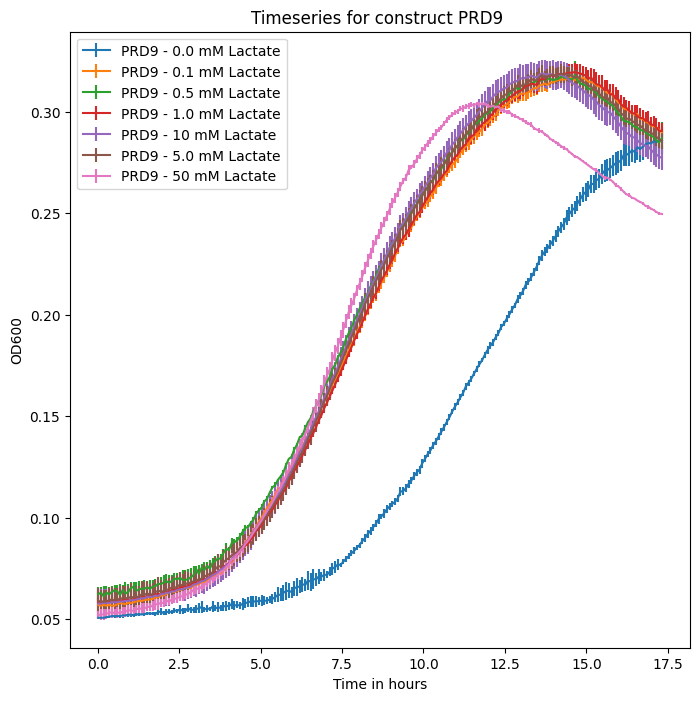

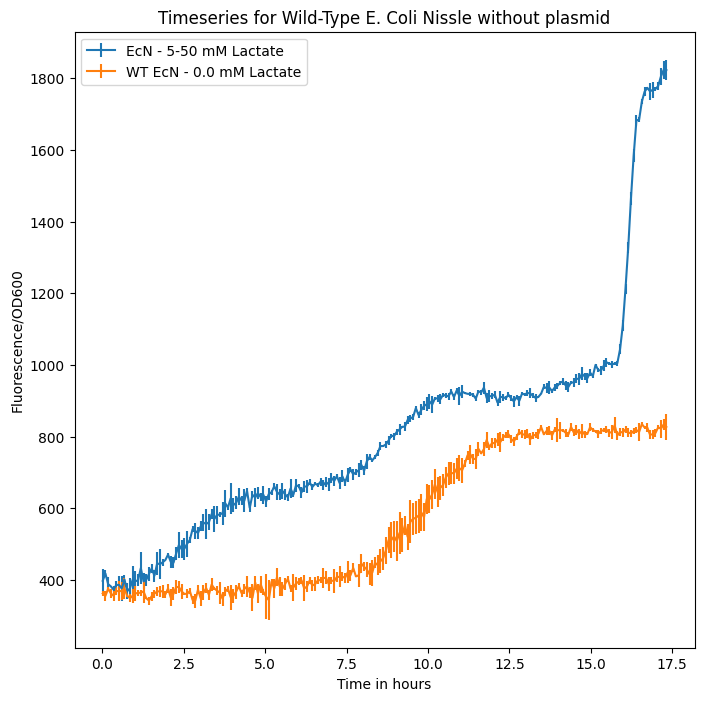

In [38]:
#Add labels together
labels = np.array(labels6 + labels8)

sort_index = labels.argsort()
#Sort everything on label
labels = labels[sort_index]
wt_index = np.flatnonzero(np.core.defchararray.find(labels,"EcN")!=-1)
wt_labels = labels[wt_index]

#Remove WT from labels, data to not interfere with dose-response curves
labels = np.delete(labels, wt_index)
sort_index = np.delete(sort_index, wt_index)
#Concentrations are not in order because argsort doesnt sort the numbers in a string correctly
#concentrations = np.array([0,0.1,0.5,1,10,5,20])
concentrations = np.array([0,0.05,0.2,0.5,5,2,20])
FLUOD_avg = np.column_stack((FLUOD_avg6[:-78],FLUOD_avg8))
FLUOD_std = np.column_stack((FLUOD_std6[:-78],FLUOD_std8))

FLU_avg = np.column_stack((FLU_avg6[:-78],FLU_avg8))
FLU_std = np.column_stack((FLU_std6[:-78],FLU_std8))

OD_avg = np.column_stack((OD_avg6[:-78],OD_avg8))
OD_std = np.column_stack((OD_std6[:-78],OD_std8))

WT_avg = FLUOD_avg[:,wt_index]
WT_std = FLUOD_std[:,wt_index]

FLUOD_avg = FLUOD_avg[:,sort_index]
FLUOD_std = FLUOD_std[:,sort_index]
FLU_avg = FLU_avg[:,sort_index]
FLU_std = FLU_std[:,sort_index]
OD_avg = OD_avg[:,sort_index]
OD_std = OD_std[:,sort_index]

for i in range(int(len(FLUOD_avg[0])/7)):
    plt.figure(figsize=(8,8))
    for j in range(7):
        plt.errorbar(time, FLUOD_avg[:,i*7+j], yerr=FLUOD_std[:,i*7+j], label=labels[i*7+j])
    plt.title(f"Timeseries for construct {labels[i*7][:5]}")
    plt.legend(loc="upper left")
    plt.xlabel('Time in hours')
    plt.ylabel('Fluorescence/OD600')
    plt.show()

for i in range(int(len(FLUOD_avg[0])/7)):
    plt.figure(figsize=(8,8))
    for j in range(7):
        plt.errorbar(time, OD_avg[:,i*7+j], yerr=OD_std[:,i*7+j], label=labels[i*7+j])
    plt.title(f"Timeseries for construct {labels[i*7][:5]}")
    plt.legend(loc="upper left")
    plt.xlabel('Time in hours')
    plt.ylabel('OD600')
    plt.show()
    
#Plot the wild-type time-series
plt.figure(figsize=(8,8))
for j in range(1,len(wt_labels)):
    plt.errorbar(time, WT_avg[:,j], yerr=WT_std[:,j], label=wt_labels[j])
plt.title(f"Timeseries for Wild-Type E. Coli Nissle without plasmid")
plt.legend(loc="upper left")
plt.xlabel('Time in hours')
plt.ylabel('Fluorescence/OD600')
plt.show()

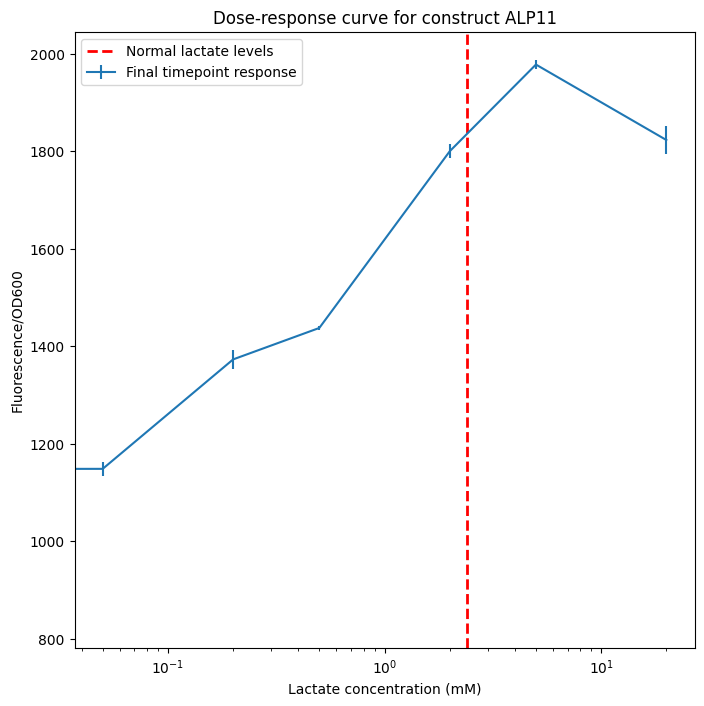

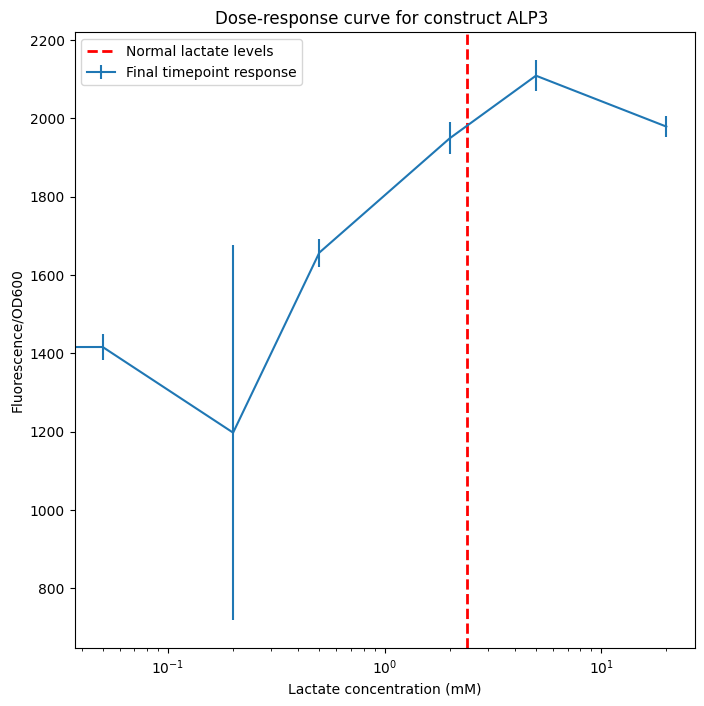

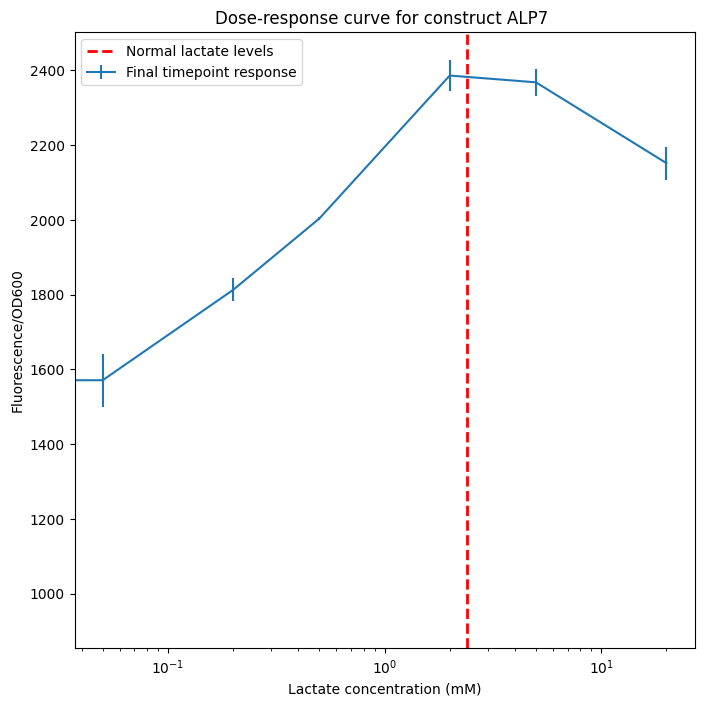

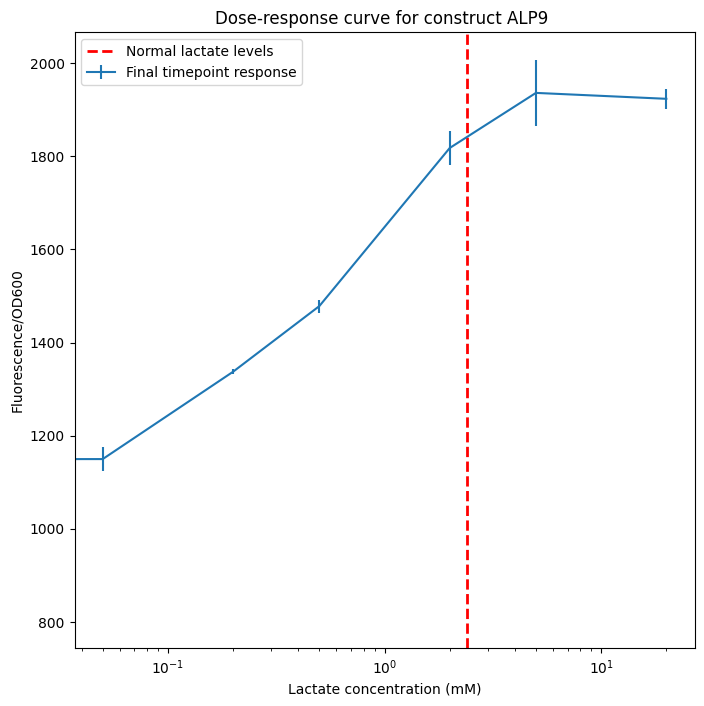

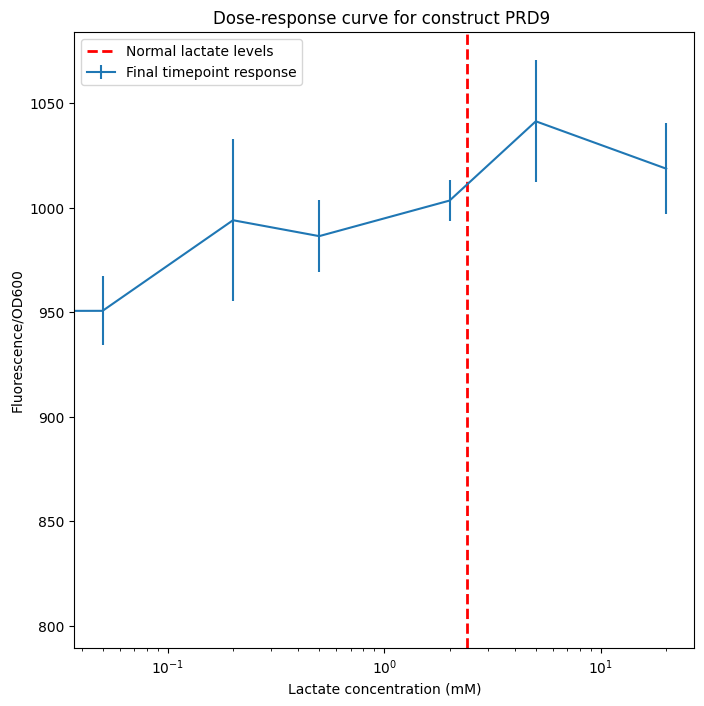

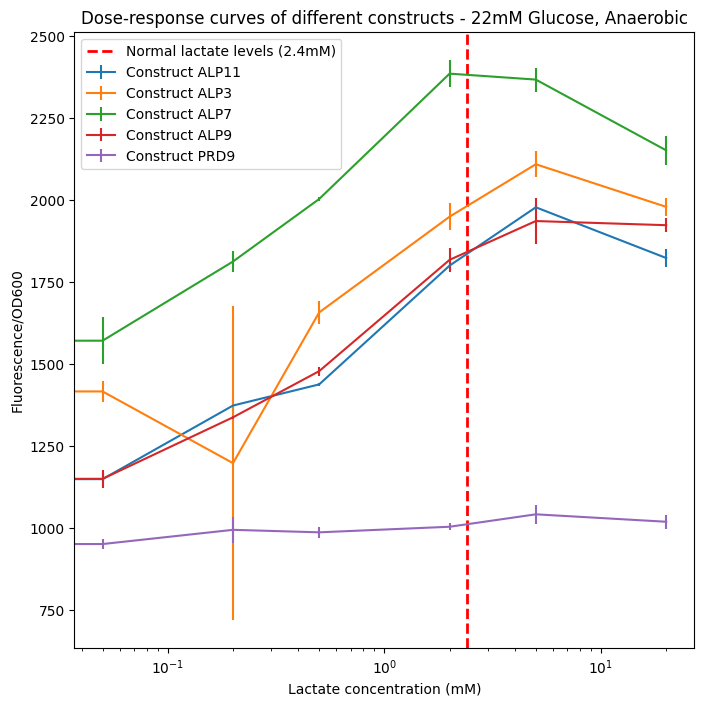

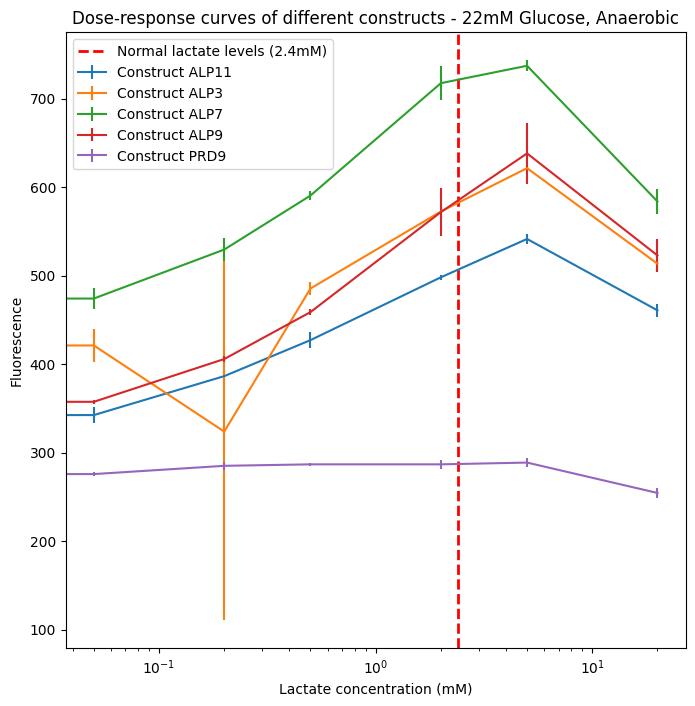

In [39]:
#Plot dose_response curves
for i in range(int(len(FLUOD_avg[0])/7)):
    plt.figure(figsize=(8,8))
    response = FLUOD_avg[-1,i*7:i*7+7]
    response_error = FLUOD_std[-1,i*7:i*7+7]

    #Sort response again since labels are weirdly sorted
    response = response[concentrations.argsort()]
    response_error = response_error[concentrations.argsort()]
    
    plt.errorbar(concentrations[concentrations.argsort()], response, yerr=response_error, label="Final timepoint response")
    plt.title(f"Dose-response curve for construct {labels[i*7][:5]}")
    plt.axvline(2.4,ymin =0, ymax=1, label=f"Normal lactate levels", color="red", linestyle="--", linewidth=2)
    plt.xlabel('Lactate concentration (mM)')
    plt.ylabel('Fluorescence/OD600')
    plt.legend(loc="upper left")
    plt.xscale('log')
    plt.show()
    
#Plot all dose_response curves in one figure
plt.figure(figsize=(8,8))
for i in range(int(len(FLUOD_avg[0])/7)):
    response = FLUOD_avg[-1,i*7:i*7+7]
    response_error = FLUOD_std[-1,i*7:i*7+7]

    #Sort response again since labels are weirdly sorted
    response = response[concentrations.argsort()]
    response_error = response_error[concentrations.argsort()]
    
    plt.errorbar(concentrations[concentrations.argsort()], response, yerr=response_error, label=f"Construct {labels[i*7][:5]}")
plt.title(f"Dose-response curves of different constructs - 22mM Glucose, Anaerobic")
plt.axvline(2.4,ymin =0, ymax=1, label=f"Normal lactate levels (2.4mM)", color="red", linestyle="--", linewidth=2)
plt.legend(loc="upper left")
plt.xlabel('Lactate concentration (mM)')
plt.ylabel('Fluorescence/OD600')
plt.xscale('log')
plt.show()

#Plot all dose_response curves in one figure
plt.figure(figsize=(8,8))
for i in range(int(len(FLUOD_avg[0])/7)):
    response = FLU_avg[-1,i*7:i*7+7]
    response_error = FLU_std[-1,i*7:i*7+7]

    #Sort response again since labels are weirdly sorted
    response = response[concentrations.argsort()]
    response_error = response_error[concentrations.argsort()]
    
    plt.errorbar(concentrations[concentrations.argsort()], response, yerr=response_error, label=f"Construct {labels[i*7][:5]}")
plt.title(f"Dose-response curves of different constructs - 22mM Glucose, Anaerobic")
plt.axvline(2.4,ymin =0, ymax=1, label=f"Normal lactate levels (2.4mM)", color="red", linestyle="--", linewidth=2)
plt.legend(loc="upper left")
plt.xlabel('Lactate concentration (mM)')
plt.ylabel('Fluorescence')
plt.xscale('log')
plt.show()

#Save data
header_list = [x for x in labels]
header_list.insert(0,'Time(h)')

#Create dataframes.
Glucose_anaerobic_OD_processed = pd.DataFrame(np.column_stack((time,OD_avg)), columns=header_list)
Glucose_anaerobic_FLU_processed = pd.DataFrame(np.column_stack((time,FLU_avg)), columns=header_list)
Glucose_anaerobic_FLUOD_processed = pd.DataFrame(np.column_stack((time,FLUOD_avg)), columns=header_list)
Glucose_anaerobic_OD_std_processed = pd.DataFrame(np.column_stack((time,OD_std)), columns=header_list)
Glucose_anaerobic_FLU_std_processed = pd.DataFrame(np.column_stack((time,FLU_std)), columns=header_list)
Glucose_anaerobic_FLUOD_std_processed = pd.DataFrame(np.column_stack((time,FLUOD_std)), columns=header_list)

#Sort labels and restructure data accordingly.
header = sorted_nicely(labels)
header.insert(0,'Time(h)')
# print(f"Sorted header list:{header}\n\n")
# print(Glucose_anaerobic_OD_processed.head())
Glucose_anaerobic_OD_processed = Glucose_anaerobic_OD_processed[header]
# print(Glucose_anaerobic_OD_processed.head())
Glucose_anaerobic_FLU_processed = Glucose_anaerobic_FLU_processed[header]
Glucose_anaerobic_FLUOD_processed = Glucose_anaerobic_FLUOD_processed[header]
Glucose_anaerobic_OD_std_processed = Glucose_anaerobic_OD_std_processed[header]
Glucose_anaerobic_FLU_std_processed = Glucose_anaerobic_FLU_std_processed[header]
Glucose_anaerobic_FLUOD_std_processed = Glucose_anaerobic_FLUOD_std_processed[header]

Glucose_anaerobic_OD_processed.to_csv('Data/22mMGlucose_anaerobic_OD_processed2.csv',index=False)
Glucose_anaerobic_FLU_processed.to_csv('Data/22mMGlucose_anaerobic_FLU_processed2.csv', index=False)
Glucose_anaerobic_FLUOD_processed.to_csv('Data/22mMGlucose_anaerobic_FLUOD_processed2.csv', index=False)
Glucose_anaerobic_OD_std_processed.to_csv('Data/22mMGlucose_anaerobic_OD_std_processed2.csv', index=False)
Glucose_anaerobic_FLU_std_processed.to_csv('Data/22mMGlucose_anaerobic_FLU_std_processed2.csv', index=False)
Glucose_anaerobic_FLUOD_std_processed.to_csv('Data/22mMGlucose_anaerobic_FLUOD_std_processed2.csv', index=False)

## Experiment 9 - 22mM Glucose, anaerobic and later aerobic. - Biological instead of technical replicates.

In [40]:
#Load the data
OD_data = pd.read_excel("Data/08-09-2022_EcN_Gluc22mM_Anaerobic_Lactate_OD.xlsx", engine='openpyxl', header=0)
FLU_data = pd.read_excel("Data/08-09-2022_EcN_Gluc22mM_Anaerobic_Lactate_GFP.xlsx", engine='openpyxl', header=0)

#Remove temperature column
OD_data.pop('T° OD600:600')
OD_data['Time'] = OD_data['Time']/3600
FLU_data.pop('T° GFP:479,510')
FLU_data['Time'] = FLU_data['Time']/3600

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


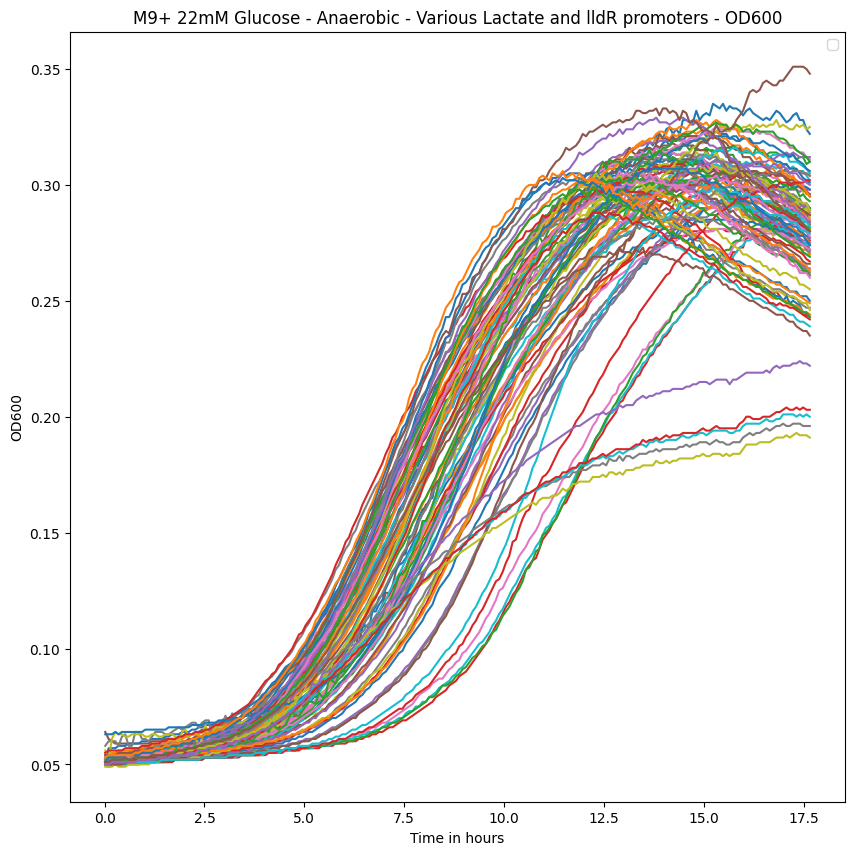

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


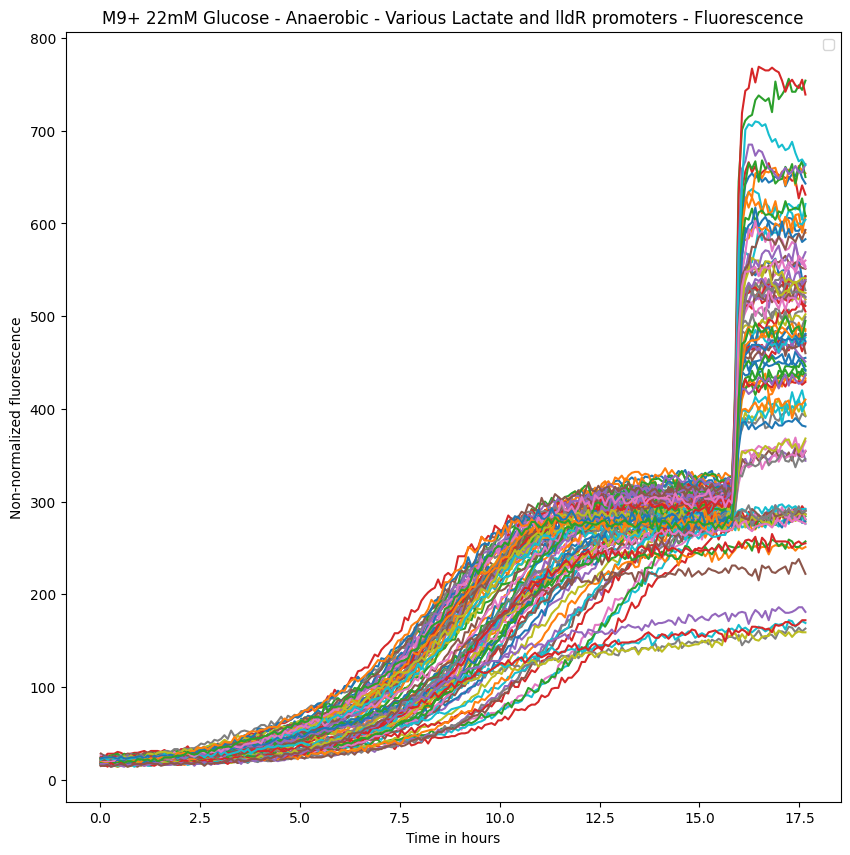

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


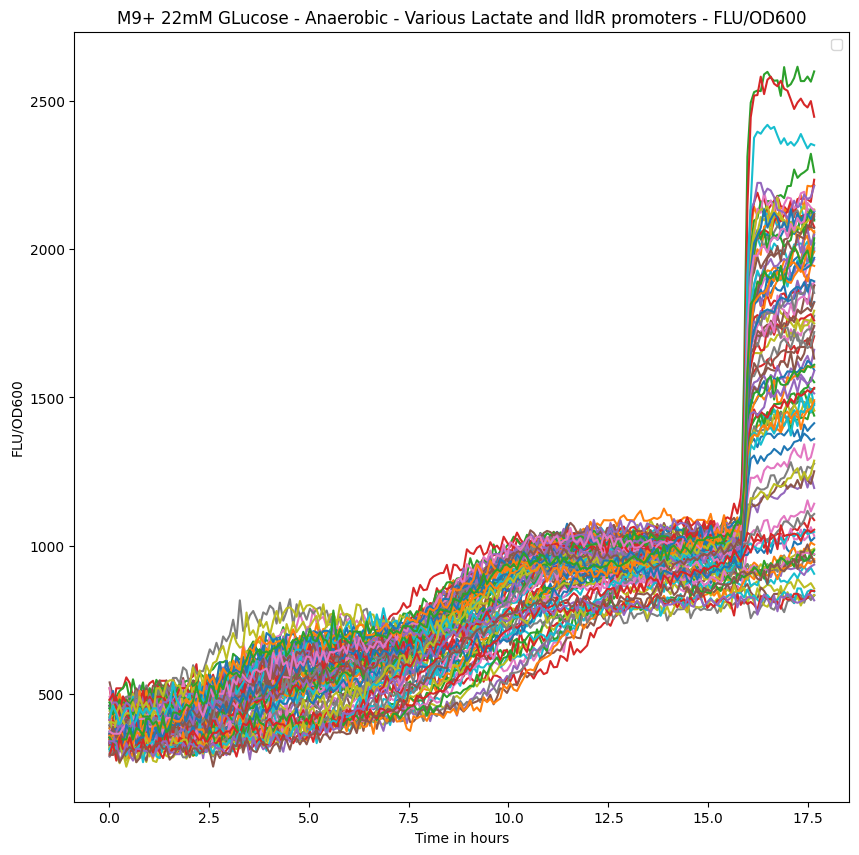

In [41]:
data_OD = OD_data.iloc[:,1:].to_numpy()
data_FLU = FLU_data.iloc[:,1:].to_numpy()

#Correction Vittorio uses
#data_OD = data_OD-np.min(data_OD)
#data_OD = data_OD/0.23+0.02

data_FLUOD = data_FLU/data_OD

time = OD_data.iloc[:,0]

plt.figure(figsize=(10,10))
plt.plot(time, data_OD)#, label=OD_data.columns[1:])
plt.ylabel('OD600')
plt.xlabel('Time in hours')
plt.title('M9+ 22mM Glucose - Anaerobic - Various Lactate and lldR promoters - OD600')
plt.legend()
plt.show()

plt.figure(figsize=(10,10))
plt.plot(time, data_FLU)#, label=OD_data.columns[1:])
plt.ylabel('Non-normalized fluorescence')
plt.xlabel('Time in hours')
plt.title('M9+ 22mM Glucose - Anaerobic - Various Lactate and lldR promoters - Fluorescence')
plt.legend()
plt.show()

plt.figure(figsize=(10,10))
plt.plot(time, data_FLUOD)#, label=OD_data.columns[1:])
plt.ylabel('FLU/OD600')
plt.xlabel('Time in hours')
plt.title('M9+ 22mM GLucose - Anaerobic - Various Lactate and lldR promoters - FLU/OD600')
plt.legend()
plt.show()

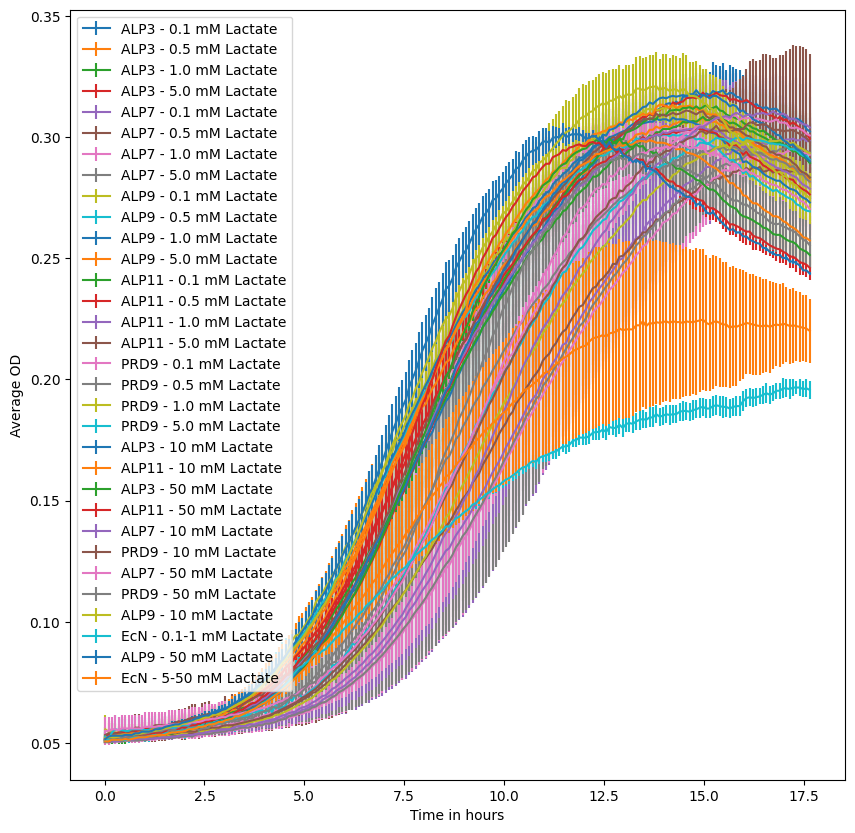

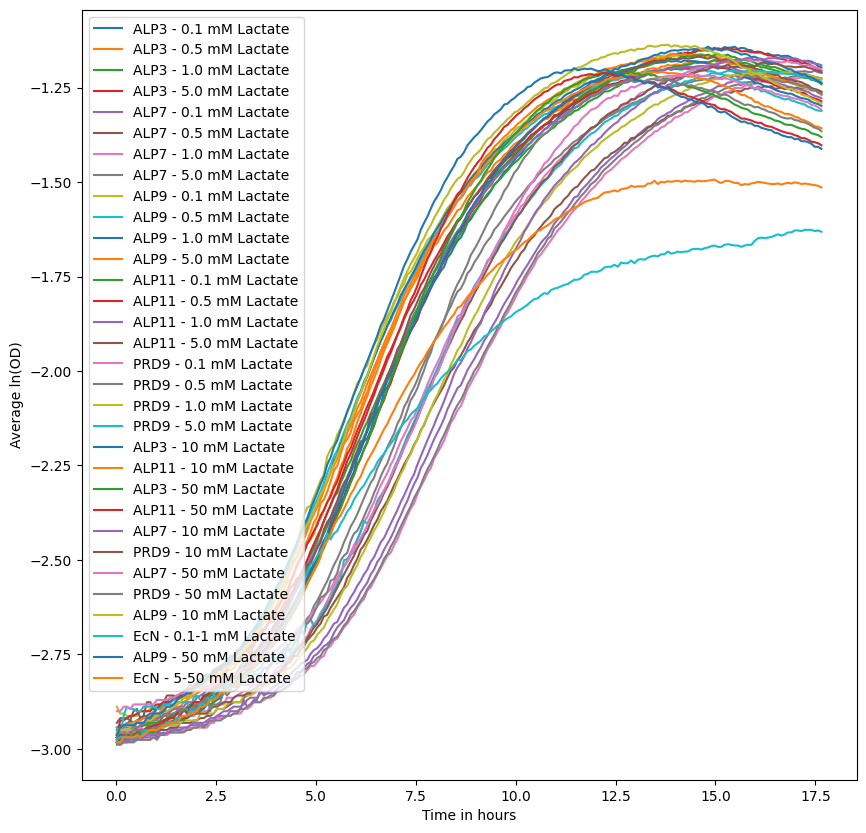

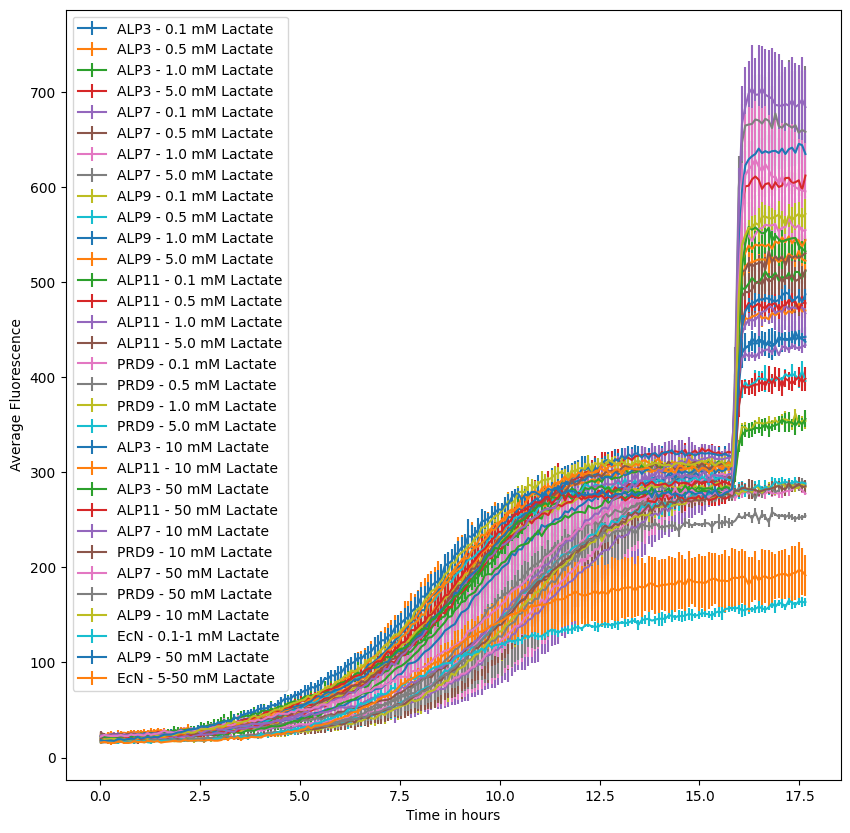

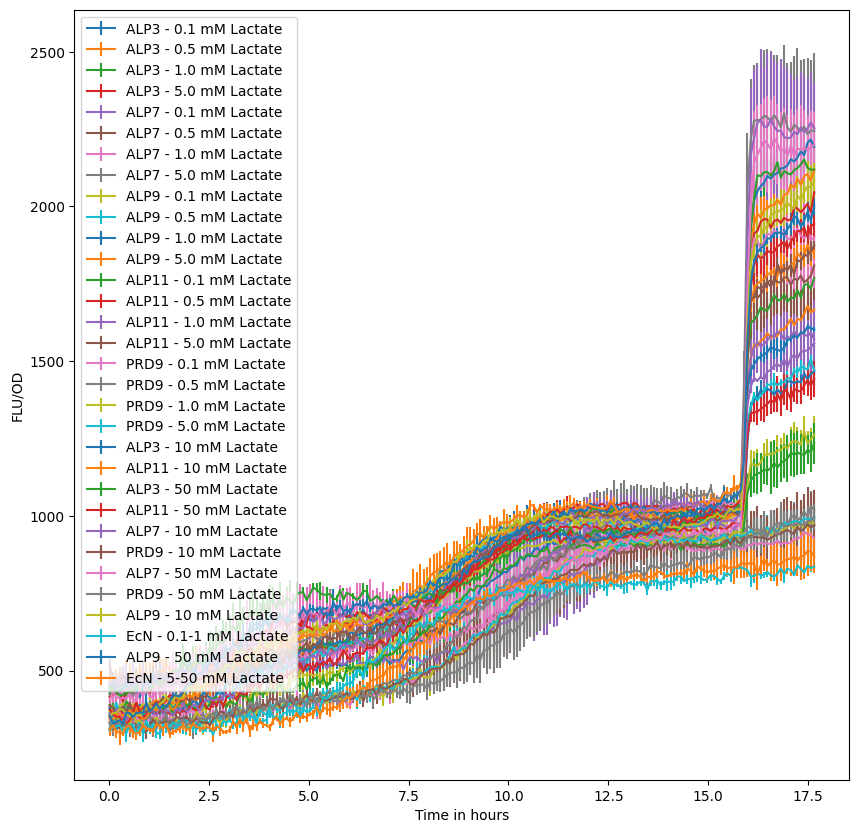

In [42]:
#Specify number of replicates
replicates = 3

OD_avg9= np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
OD_std9 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLU_avg9 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLU_std9 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLUOD_avg9 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLUOD_std9 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))

for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        #Calculate average and stdev
        #Some standard deviations are zero
        OD_avg9[:,index] = np.average(data_OD[:,i:i+replicates], axis=1)
        OD_std9[:,index] = np.std(data_OD[:,i:i+replicates], axis=1)
        
        FLU_avg9[:,index] = np.average(data_FLU[:,i:i+replicates], axis=1)
        FLU_std9[:,index] = np.std(data_FLU[:,i:i+replicates], axis=1)
        
        FLUOD_avg9[:,index] = np.average(data_FLUOD[:,i:i+replicates], axis=1)
        FLUOD_std9[:,index] = np.std(data_FLUOD[:,i:i+replicates], axis=1)

#Plot average OD levels
labels9 = ['ALP3 - 0.1 mM Lactate',
          'ALP3 - 0.5 mM Lactate',
          'ALP3 - 1.0 mM Lactate',
          'ALP3 - 5.0 mM Lactate',
          'ALP7 - 0.1 mM Lactate',
          'ALP7 - 0.5 mM Lactate',
          'ALP7 - 1.0 mM Lactate',
          'ALP7 - 5.0 mM Lactate',
          'ALP9 - 0.1 mM Lactate',
          'ALP9 - 0.5 mM Lactate',
          'ALP9 - 1.0 mM Lactate',
          'ALP9 - 5.0 mM Lactate',
          'ALP11 - 0.1 mM Lactate',
          'ALP11 - 0.5 mM Lactate',
          'ALP11 - 1.0 mM Lactate',
          'ALP11 - 5.0 mM Lactate',
          'PRD9 - 0.1 mM Lactate',
          'PRD9 - 0.5 mM Lactate',
          'PRD9 - 1.0 mM Lactate',
          'PRD9 - 5.0 mM Lactate',
          'ALP3 - 10 mM Lactate',
          'ALP11 - 10 mM Lactate',
          'ALP3 - 20 mM Lactate',
          'ALP11 - 20 mM Lactate',
          'ALP7 - 10 mM Lactate',
          'PRD9 - 10 mM Lactate',
          'ALP7 - 20 mM Lactate',
          'PRD9 - 20 mM Lactate',
          'ALP9 - 10 mM Lactate',
          'EcN - 0.1-1 mM Lactate',
          'ALP9 - 20 mM Lactate',
          'EcN - 5-20 mM Lactate']
plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        plt.errorbar(time, OD_avg9[:,index], yerr=OD_std9[:,index], label=labels9[index])
plt.legend(loc="upper left")
plt.ylabel('Average OD')
plt.xlabel('Time in hours')
plt.show()

plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        log = np.log(OD_avg9[:,index])
        plt.plot(time, log, label=labels9[index])
plt.legend(loc="upper left")
plt.ylabel('Average ln(OD)')
plt.xlabel('Time in hours')
plt.show()


plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        plt.errorbar(time, FLU_avg9[:,index], yerr=FLU_std9[:,index], label=labels9[index])
plt.legend(loc="upper left")
plt.ylabel('Average Fluorescence')
plt.xlabel('Time in hours')
plt.show()

plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        plt.errorbar(time, FLUOD_avg9[:,index], yerr=FLUOD_std9[:,index], label=labels9[index])
plt.legend(loc="upper left")
plt.ylabel('FLU/OD')
plt.xlabel('Time in hours')
plt.show()

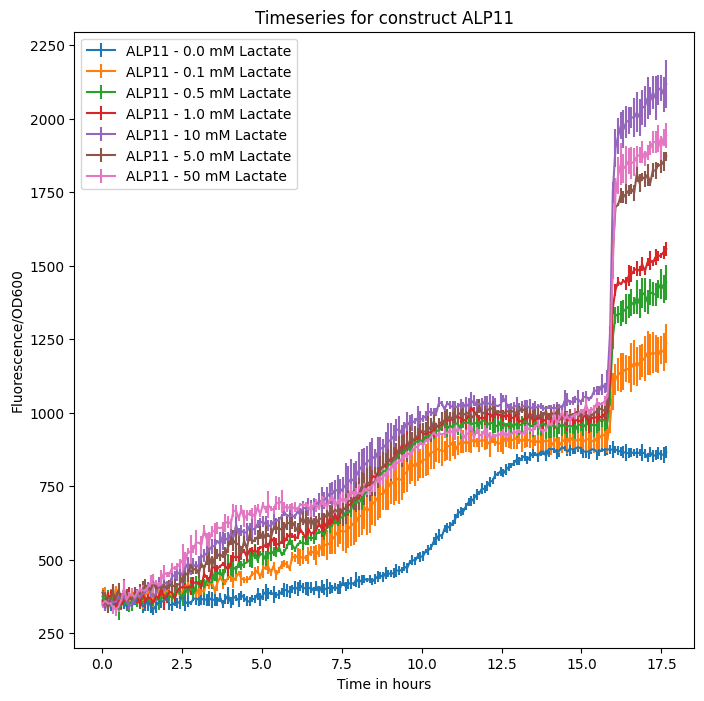

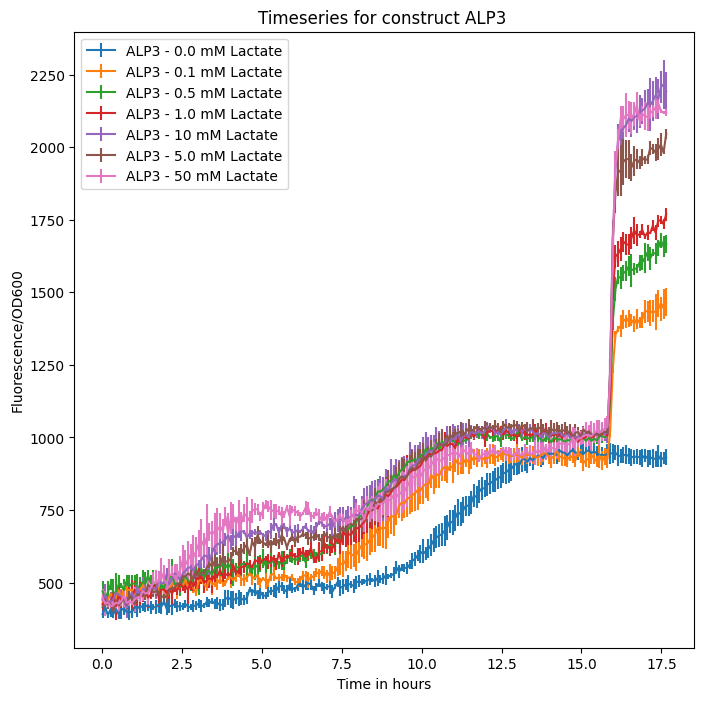

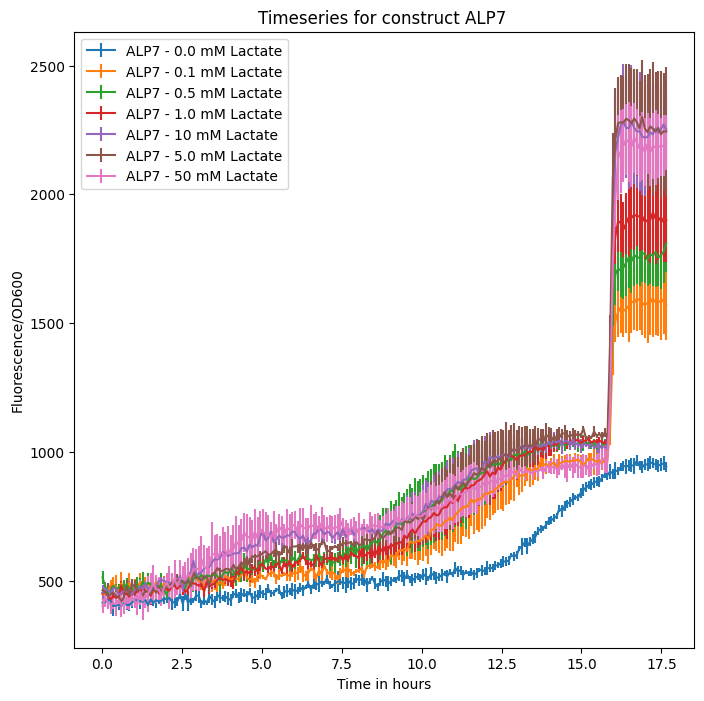

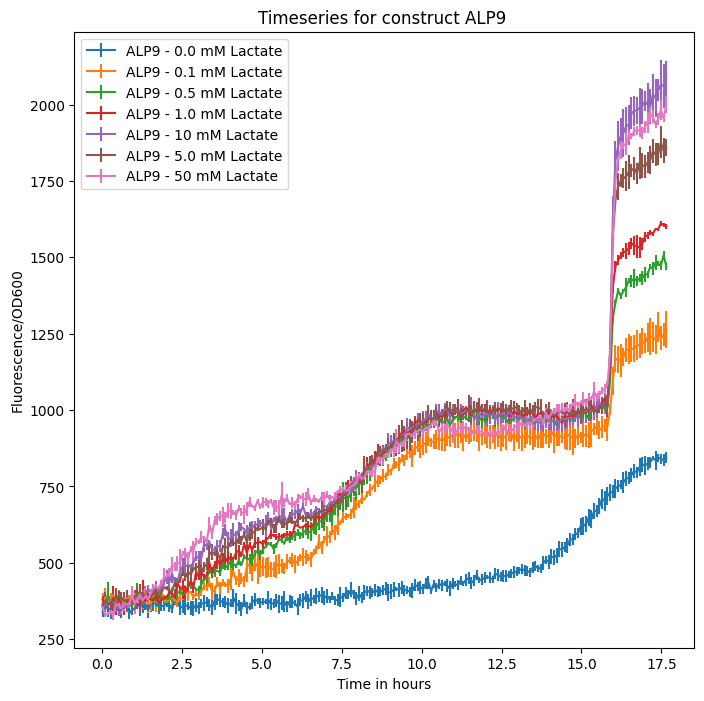

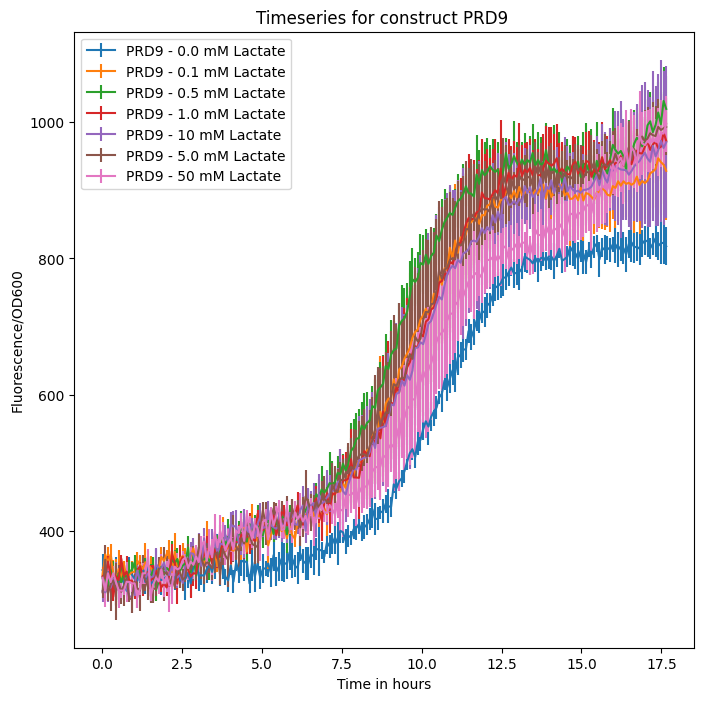

...

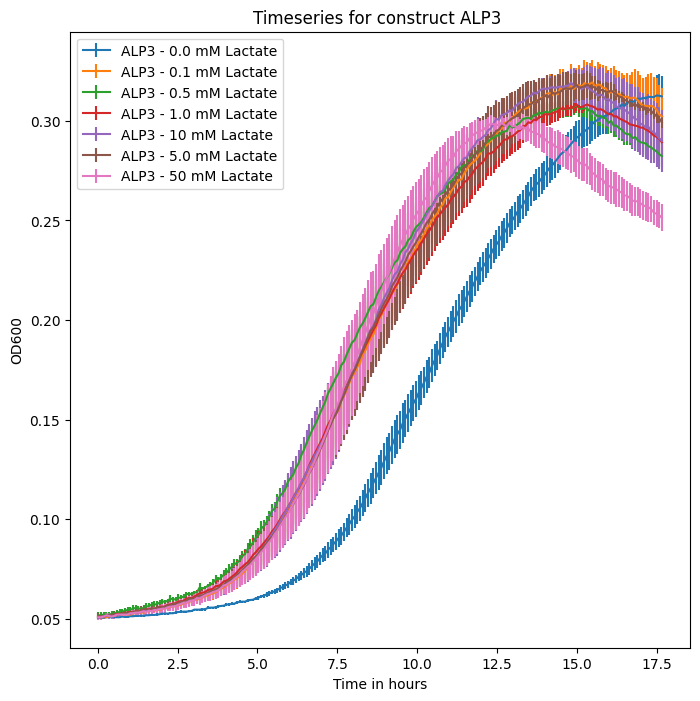

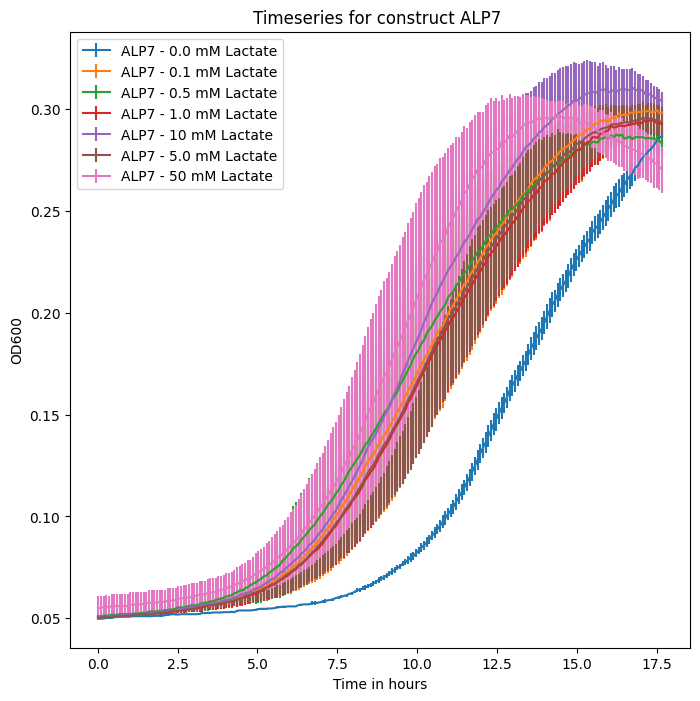

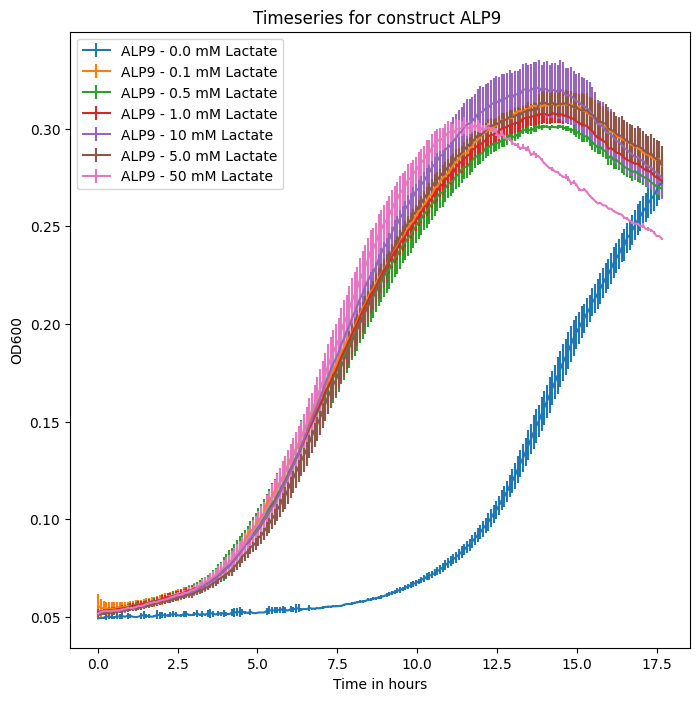

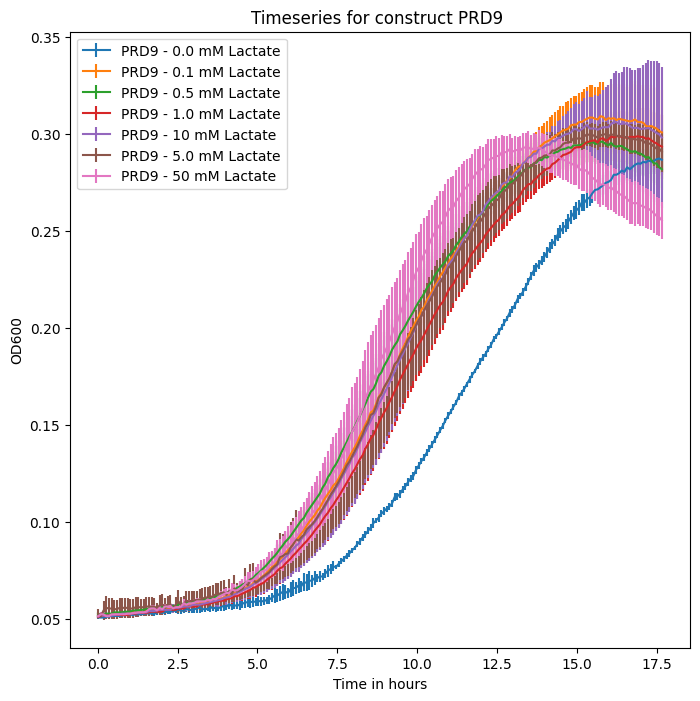

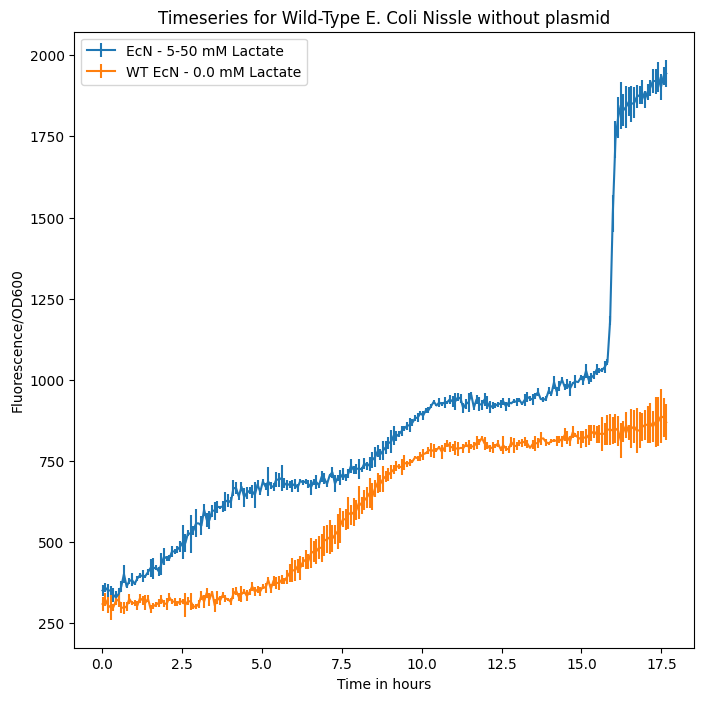

In [43]:
#Add labels together
labels = np.array(labels6 + labels9)

sort_index = labels.argsort()
#Sort everything on label
labels = labels[sort_index]
wt_index = np.flatnonzero(np.core.defchararray.find(labels,"EcN")!=-1)
wt_labels = labels[wt_index]

#Remove WT from labels, data to not interfere with dose-response curves
labels = np.delete(labels, wt_index)
sort_index = np.delete(sort_index, wt_index)
#Concentrations are not in order because argsort doesnt sort the numbers in a string correctly
#concentrations = np.array([0,0.1,0.5,1,10,5,50])
concentrations = np.array([0,0.05,0.2,0.5,5,2,20])
FLUOD_avg = np.column_stack((FLUOD_avg6[:-74],FLUOD_avg9))
FLUOD_std = np.column_stack((FLUOD_std6[:-74],FLUOD_std9))

FLU_avg = np.column_stack((FLU_avg6[:-74],FLU_avg9))
FLU_std = np.column_stack((FLU_std6[:-74],FLU_std9))

OD_avg = np.column_stack((OD_avg6[:-74],OD_avg9))
OD_std = np.column_stack((OD_std6[:-74],OD_std9))

WT_avg = FLUOD_avg[:,wt_index]
WT_std = FLUOD_std[:,wt_index]

FLUOD_avg = FLUOD_avg[:,sort_index]
FLUOD_std = FLUOD_std[:,sort_index]
FLU_avg = FLU_avg[:,sort_index]
FLU_std = FLU_std[:,sort_index]
OD_avg = OD_avg[:,sort_index]
OD_std = OD_std[:,sort_index]

for i in range(int(len(FLUOD_avg[0])/7)):
    plt.figure(figsize=(8,8))
    for j in range(7):
        plt.errorbar(time, FLUOD_avg[:,i*7+j], yerr=FLUOD_std[:,i*7+j], label=labels[i*7+j])
    plt.title(f"Timeseries for construct {labels[i*7][:5]}")
    plt.legend(loc="upper left")
    plt.xlabel('Time in hours')
    plt.ylabel('Fluorescence/OD600')
    plt.show()

for i in range(int(len(FLUOD_avg[0])/7)):
    plt.figure(figsize=(8,8))
    for j in range(7):
        plt.errorbar(time, OD_avg[:,i*7+j], yerr=OD_std[:,i*7+j], label=labels[i*7+j])
    plt.title(f"Timeseries for construct {labels[i*7][:5]}")
    plt.legend(loc="upper left")
    plt.xlabel('Time in hours')
    plt.ylabel('OD600')
    plt.show()
    
#Plot the wild-type time-series
plt.figure(figsize=(8,8))
for j in range(1,len(wt_labels)):
    plt.errorbar(time, WT_avg[:,j], yerr=WT_std[:,j], label=wt_labels[j])
plt.title(f"Timeseries for Wild-Type E. Coli Nissle without plasmid")
plt.legend(loc="upper left")
plt.xlabel('Time in hours')
plt.ylabel('Fluorescence/OD600')
plt.show()

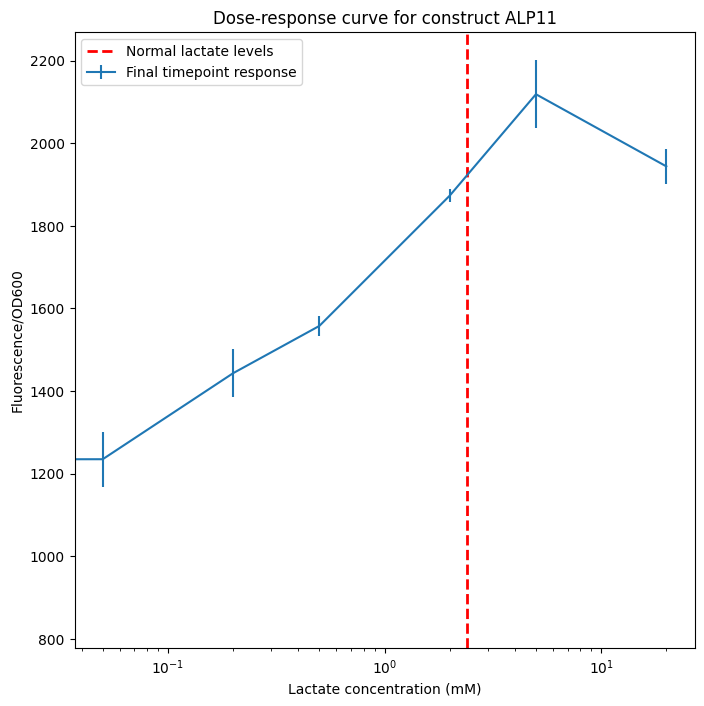

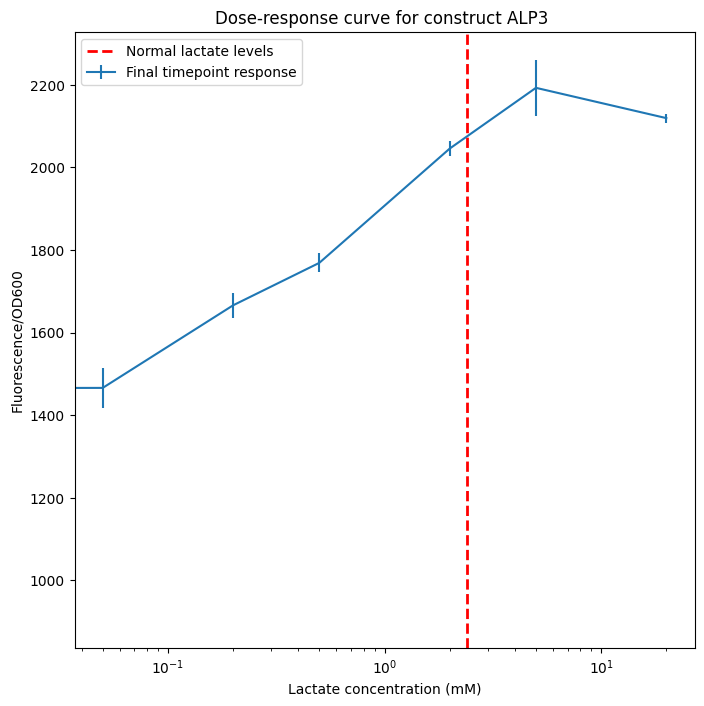

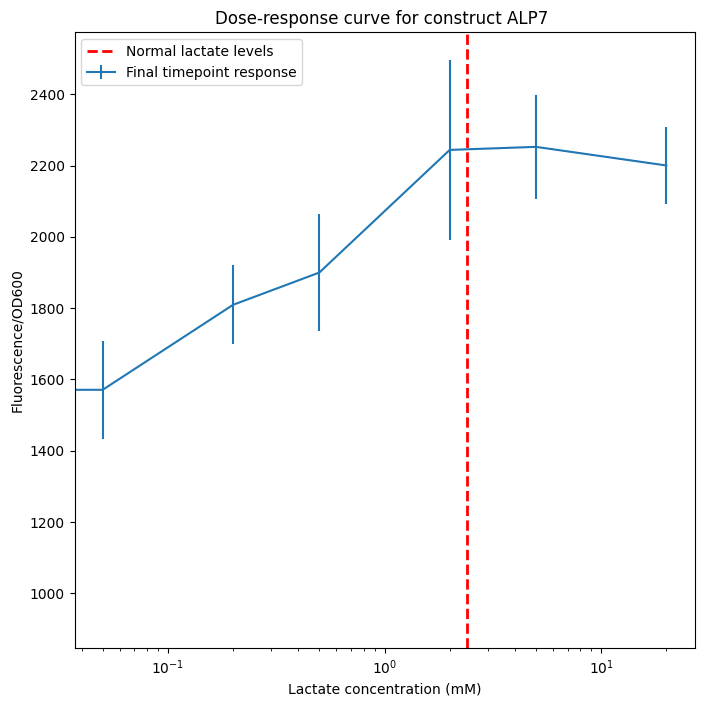

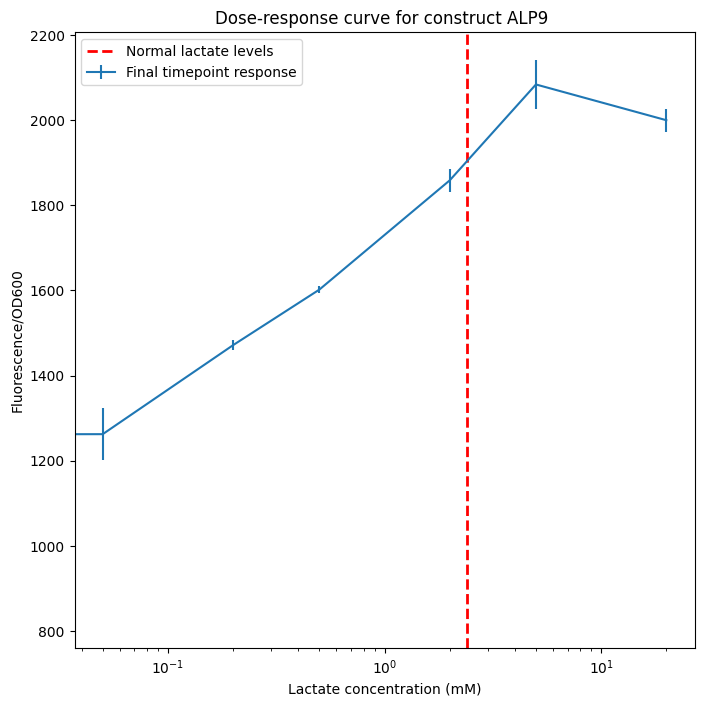

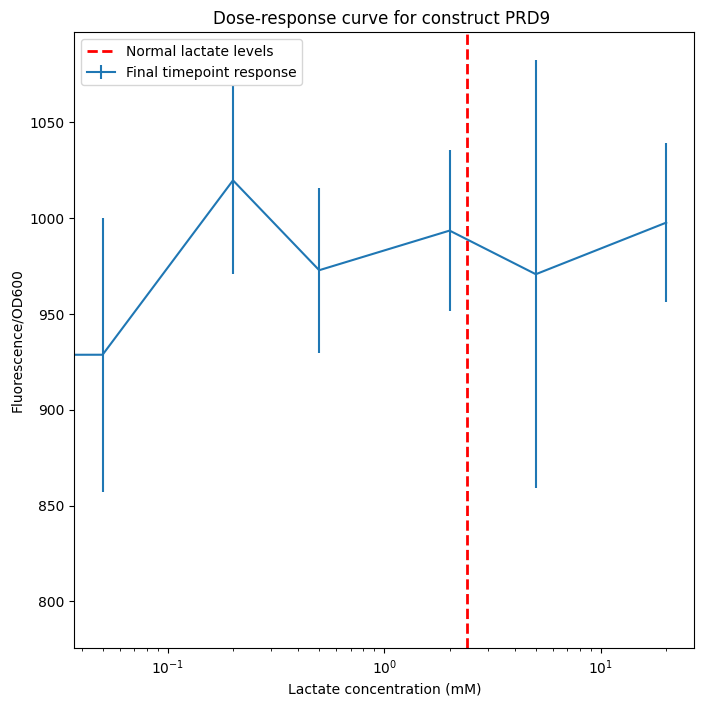

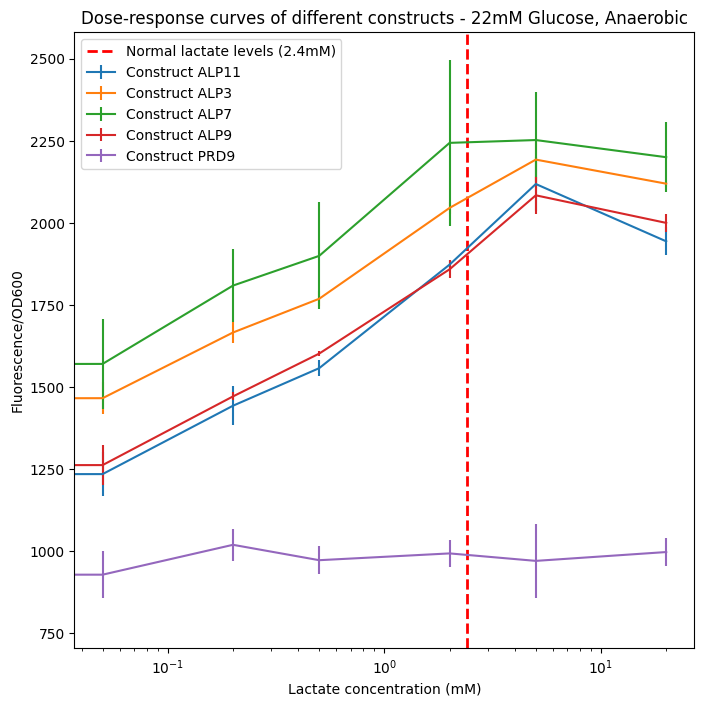

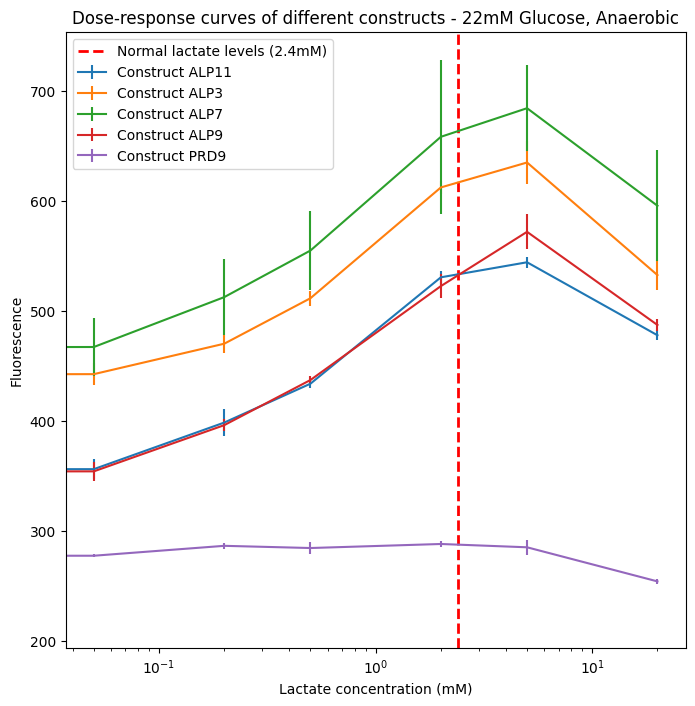

In [44]:
#Plot dose_response curves
for i in range(int(len(FLUOD_avg[0])/7)):
    plt.figure(figsize=(8,8))
    response = FLUOD_avg[-1,i*7:i*7+7]
    response_error = FLUOD_std[-1,i*7:i*7+7]

    #Sort response again since labels are weirdly sorted
    response = response[concentrations.argsort()]
    response_error = response_error[concentrations.argsort()]
    
    plt.errorbar(concentrations[concentrations.argsort()], response, yerr=response_error, label="Final timepoint response")
    plt.title(f"Dose-response curve for construct {labels[i*7][:5]}")
    plt.axvline(2.4,ymin =0, ymax=1, label=f"Normal lactate levels", color="red", linestyle="--", linewidth=2)
    plt.xlabel('Lactate concentration (mM)')
    plt.ylabel('Fluorescence/OD600')
    plt.legend(loc="upper left")
    plt.xscale('log')
    plt.show()
    
#Plot all dose_response curves in one figure
plt.figure(figsize=(8,8))
for i in range(int(len(FLUOD_avg[0])/7)):
    response = FLUOD_avg[-1,i*7:i*7+7]
    response_error = FLUOD_std[-1,i*7:i*7+7]

    #Sort response again since labels are weirdly sorted
    response = response[concentrations.argsort()]
    response_error = response_error[concentrations.argsort()]
    
    plt.errorbar(concentrations[concentrations.argsort()], response, yerr=response_error, label=f"Construct {labels[i*7][:5]}")
plt.title(f"Dose-response curves of different constructs - 22mM Glucose, Anaerobic")
plt.axvline(2.4,ymin =0, ymax=1, label=f"Normal lactate levels (2.4mM)", color="red", linestyle="--", linewidth=2)
plt.legend(loc="upper left")
plt.xlabel('Lactate concentration (mM)')
plt.ylabel('Fluorescence/OD600')
plt.xscale('log')
plt.show()

#Plot all dose_response curves in one figure
plt.figure(figsize=(8,8))
for i in range(int(len(FLUOD_avg[0])/7)):
    response = FLU_avg[-1,i*7:i*7+7]
    response_error = FLU_std[-1,i*7:i*7+7]

    #Sort response again since labels are weirdly sorted
    response = response[concentrations.argsort()]
    response_error = response_error[concentrations.argsort()]
    
    plt.errorbar(concentrations[concentrations.argsort()], response, yerr=response_error, label=f"Construct {labels[i*7][:5]}")
plt.title(f"Dose-response curves of different constructs - 22mM Glucose, Anaerobic")
plt.axvline(2.4,ymin =0, ymax=1, label=f"Normal lactate levels (2.4mM)", color="red", linestyle="--", linewidth=2)
plt.legend(loc="upper left")
plt.xlabel('Lactate concentration (mM)')
plt.ylabel('Fluorescence')
plt.xscale('log')
plt.show()

#Save data
header_list = [x for x in labels]
header_list.insert(0,'Time(h)')

#Create dataframes.
Glucose_anaerobic_OD_processed = pd.DataFrame(np.column_stack((time,OD_avg)), columns=header_list)
Glucose_anaerobic_FLU_processed = pd.DataFrame(np.column_stack((time,FLU_avg)), columns=header_list)
Glucose_anaerobic_FLUOD_processed = pd.DataFrame(np.column_stack((time,FLUOD_avg)), columns=header_list)
Glucose_anaerobic_OD_std_processed = pd.DataFrame(np.column_stack((time,OD_std)), columns=header_list)
Glucose_anaerobic_FLU_std_processed = pd.DataFrame(np.column_stack((time,FLU_std)), columns=header_list)
Glucose_anaerobic_FLUOD_std_processed = pd.DataFrame(np.column_stack((time,FLUOD_std)), columns=header_list)

#Sort labels and restructure data accordingly.
header = sorted_nicely(labels)
header.insert(0,'Time(h)')
# print(f"Sorted header list:{header}\n\n")
# print(Glucose_anaerobic_OD_processed.head())
Glucose_anaerobic_OD_processed = Glucose_anaerobic_OD_processed[header]
# print(Glucose_anaerobic_OD_processed.head())
Glucose_anaerobic_FLU_processed = Glucose_anaerobic_FLU_processed[header]
Glucose_anaerobic_FLUOD_processed = Glucose_anaerobic_FLUOD_processed[header]
Glucose_anaerobic_OD_std_processed = Glucose_anaerobic_OD_std_processed[header]
Glucose_anaerobic_FLU_std_processed = Glucose_anaerobic_FLU_std_processed[header]
Glucose_anaerobic_FLUOD_std_processed = Glucose_anaerobic_FLUOD_std_processed[header]

Glucose_anaerobic_OD_processed.to_csv('Data/22mMGlucose_anaerobic_OD_biorep.csv',index=False)
Glucose_anaerobic_FLU_processed.to_csv('Data/22mMGlucose_anaerobic_FLU_biorep.csv', index=False)
Glucose_anaerobic_FLUOD_processed.to_csv('Data/22mMGlucose_anaerobic_FLUOD_biorep.csv', index=False)
Glucose_anaerobic_OD_std_processed.to_csv('Data/22mMGlucose_anaerobic_OD_std_biorep.csv', index=False)
Glucose_anaerobic_FLU_std_processed.to_csv('Data/22mMGlucose_anaerobic_FLU_std_biorep.csv', index=False)
Glucose_anaerobic_FLUOD_std_processed.to_csv('Data/22mMGlucose_anaerobic_FLUOD_std_biorep.csv', index=False)

# Experiment 10 - P7 construct and wild type in more lactate concentrations

In [45]:
#Load the data
OD_data = pd.read_excel("Data/09-09-2022_EcN_Gluc22mM_Anaerobic_Lactate_OD.xlsx", engine='openpyxl', header=0)
FLU_data = pd.read_excel("Data/09-09-2022_EcN_Gluc22mM_Anaerobic_Lactate_GFP.xlsx", engine='openpyxl', header=0)

#Remove temperature column
OD_data.pop('T° OD600:600')
OD_data['Time'] = OD_data['Time']/3600
FLU_data.pop('T° GFP:479,510')
FLU_data['Time'] = FLU_data['Time']/3600

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


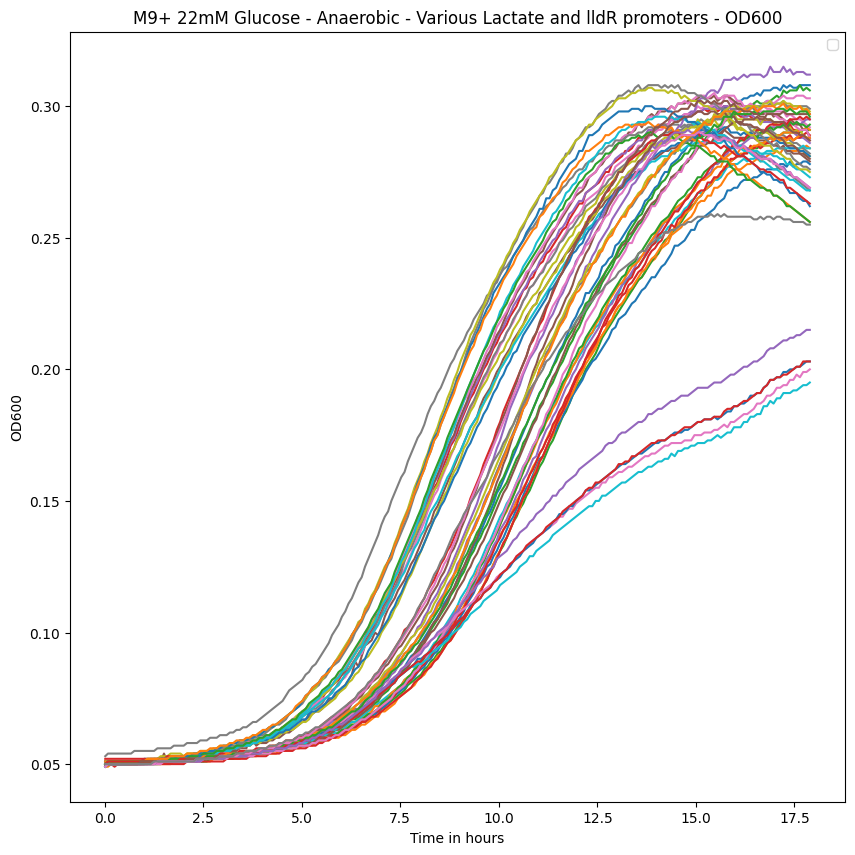

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


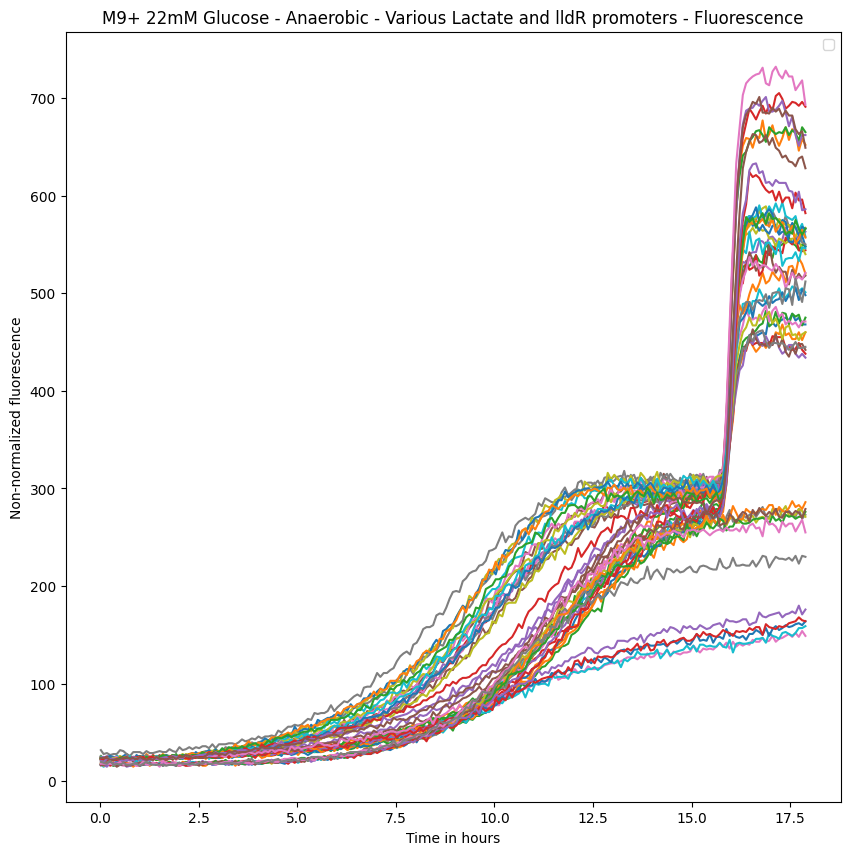

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


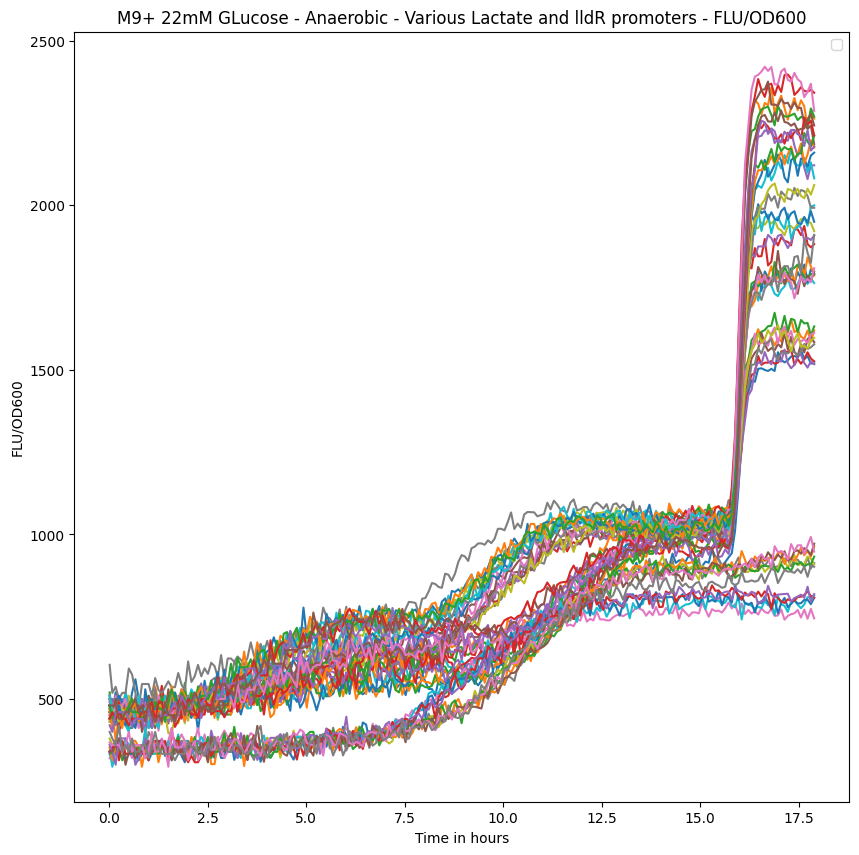

In [46]:
data_OD = OD_data.iloc[:,1:].to_numpy()
data_FLU = FLU_data.iloc[:,1:].to_numpy()

#Correction Vittorio uses
#data_OD = data_OD-np.min(data_OD)
#data_OD = data_OD/0.23+0.02

data_FLUOD = data_FLU/data_OD

time = OD_data.iloc[:,0]

plt.figure(figsize=(10,10))
plt.plot(time, data_OD)#, label=OD_data.columns[1:])
plt.ylabel('OD600')
plt.xlabel('Time in hours')
plt.title('M9+ 22mM Glucose - Anaerobic - Various Lactate and lldR promoters - OD600')
plt.legend()
plt.show()

plt.figure(figsize=(10,10))
plt.plot(time, data_FLU)#, label=OD_data.columns[1:])
plt.ylabel('Non-normalized fluorescence')
plt.xlabel('Time in hours')
plt.title('M9+ 22mM Glucose - Anaerobic - Various Lactate and lldR promoters - Fluorescence')
plt.legend()
plt.show()

plt.figure(figsize=(10,10))
plt.plot(time, data_FLUOD)#, label=OD_data.columns[1:])
plt.ylabel('FLU/OD600')
plt.xlabel('Time in hours')
plt.title('M9+ 22mM GLucose - Anaerobic - Various Lactate and lldR promoters - FLU/OD600')
plt.legend()
plt.show()

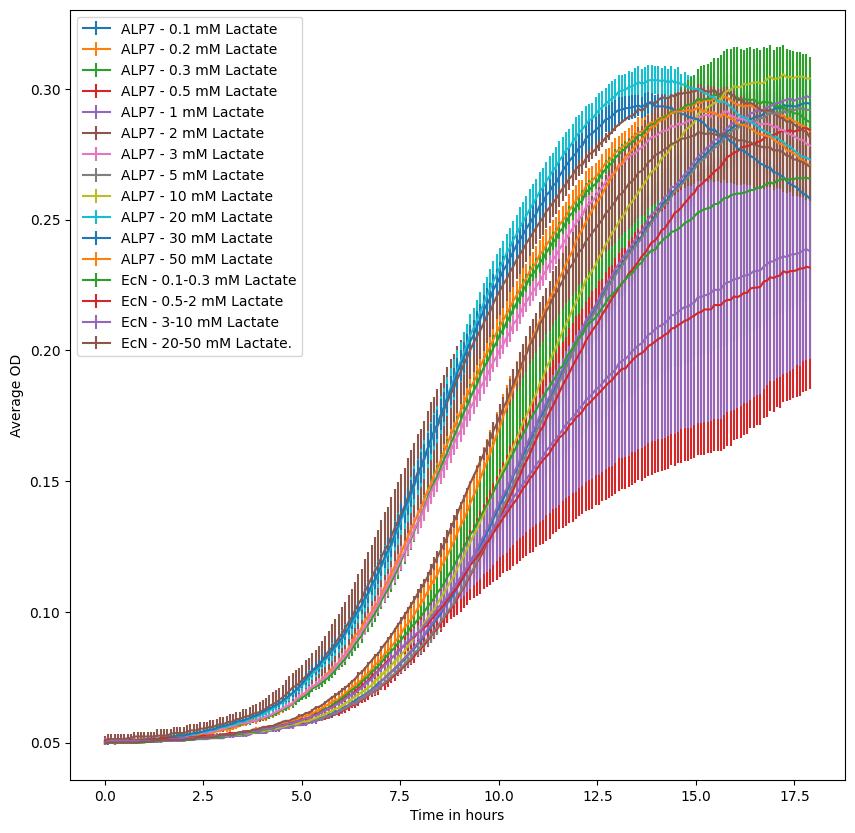

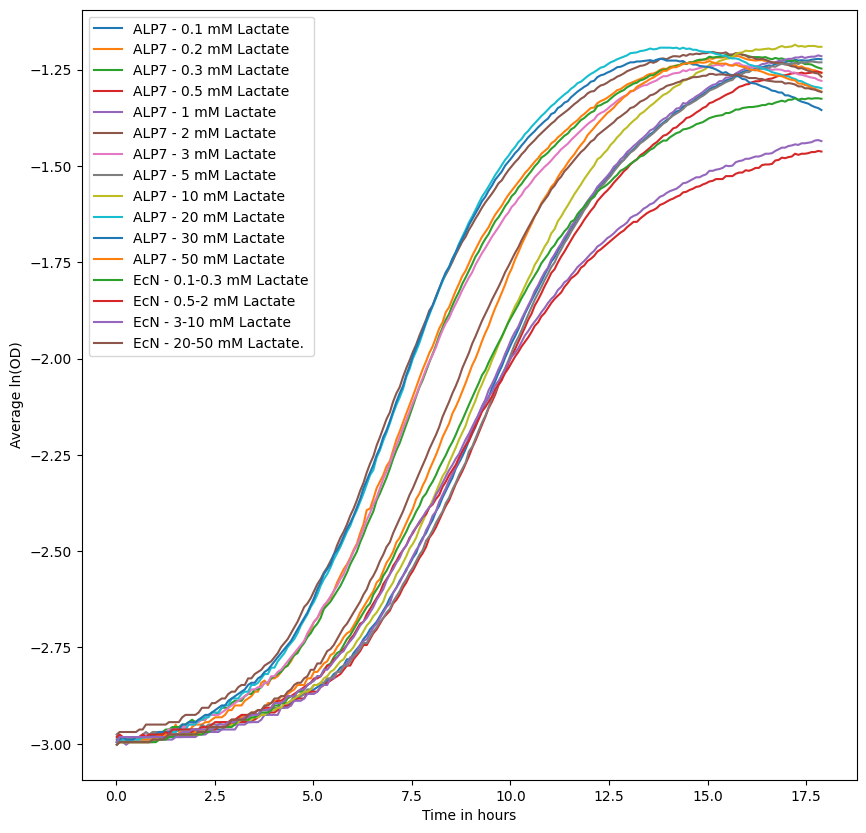

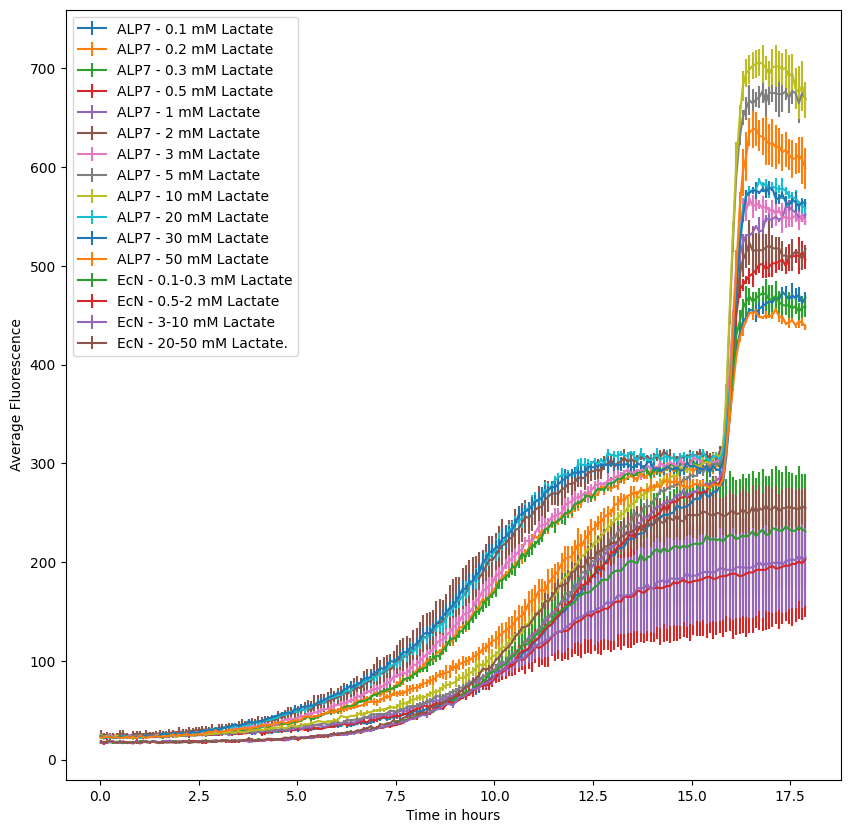

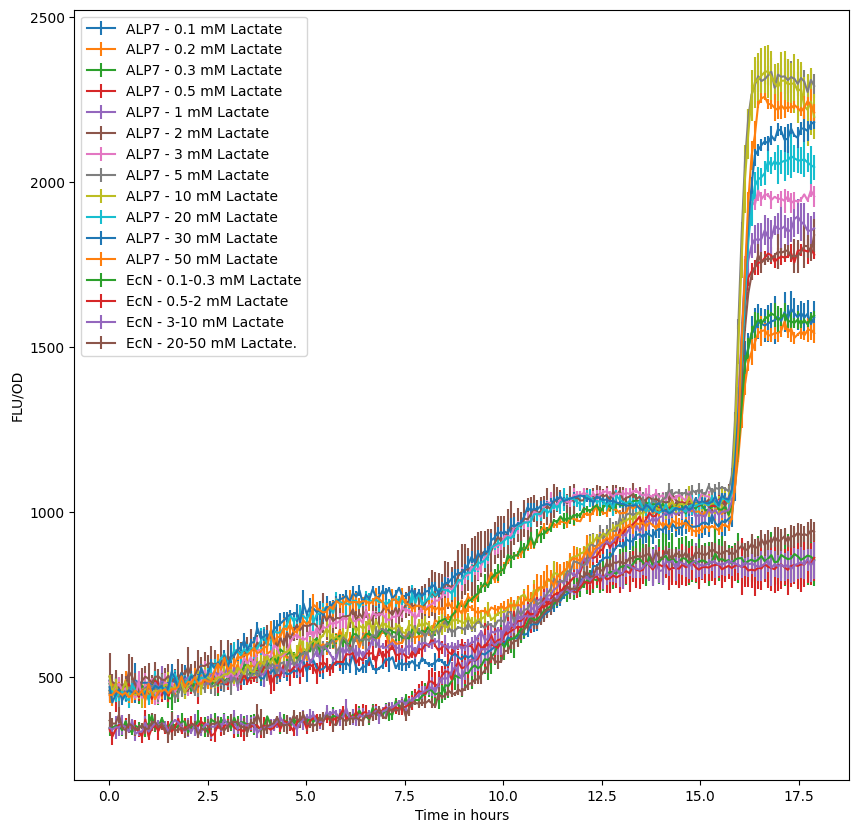

In [47]:
#Specify number of replicates
replicates = 3

OD_avg10 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
OD_std10 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLU_avg10 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLU_std10 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLUOD_avg10 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))
FLUOD_std10 = np.zeros((len(OD_data),int(len(OD_data.columns[1:])/replicates)))

for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        #Calculate average and stdev
        #Some standard deviations are zero
        OD_avg10[:,index] = np.average(data_OD[:,i:i+replicates], axis=1)
        OD_std10[:,index] = np.std(data_OD[:,i:i+replicates], axis=1)
        
        FLU_avg10[:,index] = np.average(data_FLU[:,i:i+replicates], axis=1)
        FLU_std10[:,index] = np.std(data_FLU[:,i:i+replicates], axis=1)
        
        FLUOD_avg10[:,index] = np.average(data_FLUOD[:,i:i+replicates], axis=1)
        FLUOD_std10[:,index] = np.std(data_FLUOD[:,i:i+replicates], axis=1)
#Plot average OD levels
labels10 = ['ALP7 - 0.1 mM Lactate',
           'ALP7 - 0.2 mM Lactate',
           'ALP7 - 0.3 mM Lactate',
           'ALP7 - 0.5 mM Lactate',
           'ALP7 - 1 mM Lactate',
           'ALP7 - 2 mM Lactate',
           'ALP7 - 3 mM Lactate',
           'ALP7 - 5 mM Lactate',
           'ALP7 - 10 mM Lactate',
           'ALP7 - 20 mM Lactate',
           'ALP7 - 30 mM Lactate',
           'ALP7 - 50 mM Lactate',
           'EcN - 0.1-0.3 mM Lactate',
           'EcN - 0.5-2 mM Lactate',
           'EcN - 3-10 mM Lactate',
           'EcN - 20-50 mM Lactate.']

plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        plt.errorbar(time, OD_avg10[:,index], yerr=OD_std10[:,index], label=labels10[index])
plt.legend(loc="upper left")
plt.ylabel('Average OD')
plt.xlabel('Time in hours')
plt.show()

plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        log = np.log(OD_avg10[:,index])
        plt.plot(time, log, label=labels10[index])
plt.legend(loc="upper left")
plt.ylabel('Average ln(OD)')
plt.xlabel('Time in hours')
plt.show()

plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        plt.errorbar(time, FLU_avg10[:,index], yerr=FLU_std10[:,index], label=labels10[index])
plt.legend(loc="upper left")
plt.ylabel('Average Fluorescence')
plt.xlabel('Time in hours')
plt.show()

plt.figure(figsize=(10,10))
for i, column in enumerate(OD_data.columns[1:]):
    if i%replicates == 0:
        index = int(i/replicates)
        plt.errorbar(time, FLUOD_avg10[:,index], yerr=FLUOD_std10[:,index], label=labels10[index])
plt.legend(loc="upper left")
plt.ylabel('FLU/OD')
plt.xlabel('Time in hours')
plt.show()

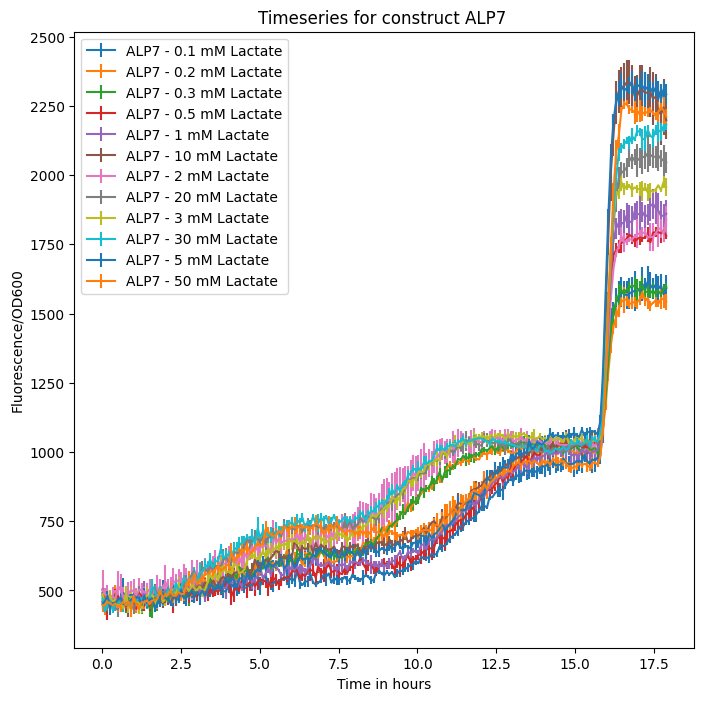

Max OD gotten from concentration 0.05mM Lactate = 0.29466666666666663
Max OD gotten from concentration 0.2mM Lactate = 0.297
Max OD gotten from concentration 0.3mM Lactate = 0.299
Max OD gotten from concentration 0.2mM Lactate = 0.285
Max OD gotten from concentration 0.5mM Lactate = 0.2973333333333333
Max OD gotten from concentration 5.0mM Lactate = 0.3056666666666667
Max OD gotten from concentration 2.0mM Lactate = 0.3
Max OD gotten from concentration 20.0mM Lactate = 0.3033333333333333
Max OD gotten from concentration 3.0mM Lactate = 0.2913333333333333
Max OD gotten from concentration 30.0mM Lactate = 0.29466666666666663
Max OD gotten from concentration 2.0mM Lactate = 0.29266666666666663
Max OD gotten from concentration 20.0mM Lactate = 0.293


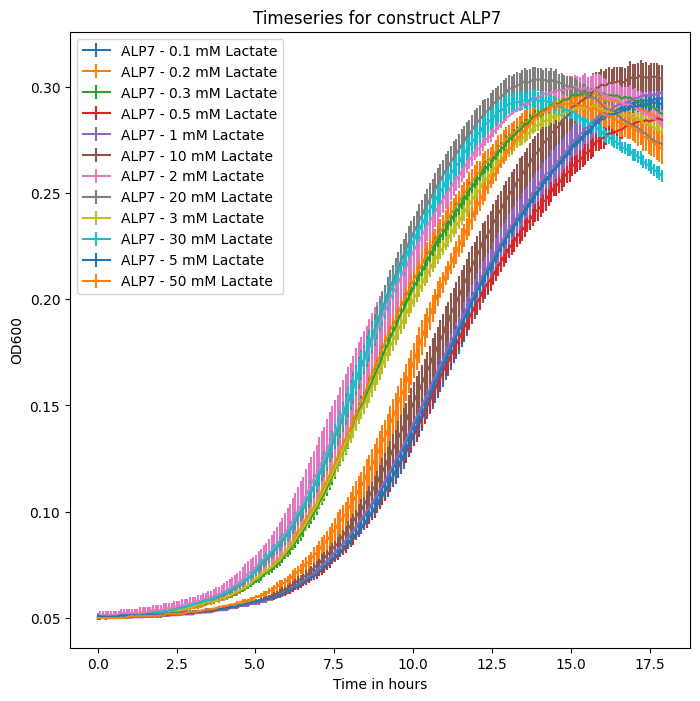

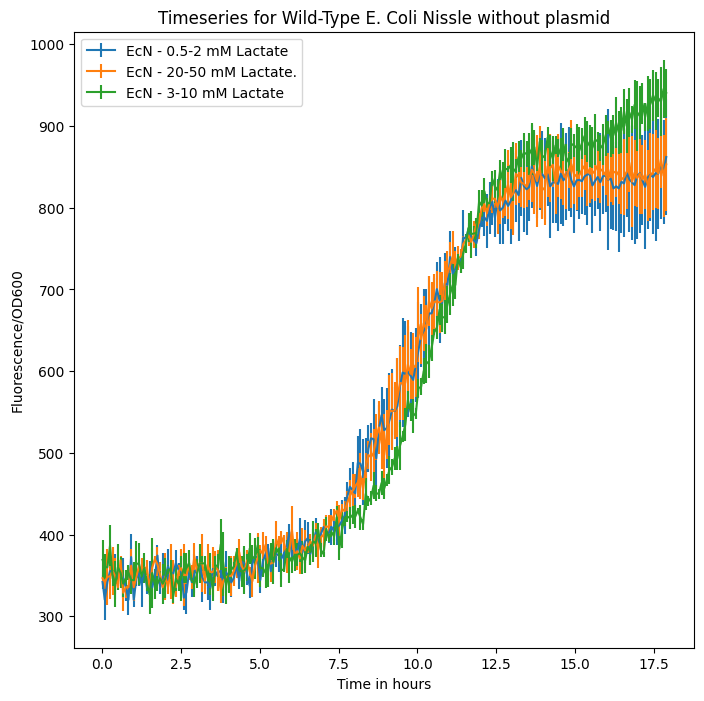

In [48]:
sort_index = np.array(labels10).argsort()
#Sort everything on label
labels = np.array(labels10)[sort_index]
wt_index = np.flatnonzero(np.core.defchararray.find(labels,"EcN")!=-1)

wt_labels = labels[wt_index]
WT_avg = FLUOD_avg10[:,wt_index]
WT_std = FLUOD_std10[:,wt_index]
    
#Remove WT from labels, data to not interfere with dose-response curves
labels = np.delete(labels, wt_index)
sort_index = np.delete(sort_index, wt_index)
#Concentrations are not in order because argsort doesnt sort the numbers in a string correctly
#concentrations = np.array([0.1,0.2,0.3,0.5,1,10,2,20,3,30,5,50])
concentrations = np.array([0.05,0.2,0.3,0.2,0.5,5,2,20,3,30,2,20])

conc_nr = len(concentrations)
FLUOD_avg = FLUOD_avg10[:,sort_index]
FLUOD_std = FLUOD_std10[:,sort_index]
FLU_avg = FLU_avg10[:,sort_index]
FLU_std = FLU_std10[:,sort_index]
OD_avg = OD_avg10[:,sort_index]
OD_std = OD_std10[:,sort_index]

for i in range(int(len(FLUOD_avg[0])/conc_nr)):
    plt.figure(figsize=(8,8))
    for j in range(conc_nr):
        plt.errorbar(time, FLUOD_avg[:,i*conc_nr+j], yerr=FLUOD_std[:,i*conc_nr+j], label=labels[i*conc_nr+j])
    plt.title(f"Timeseries for construct {labels[i*conc_nr][:5]}")
    plt.legend(loc="upper left")
    plt.xlabel('Time in hours')
    plt.ylabel('Fluorescence/OD600')
    plt.show()

for i in range(int(len(FLUOD_avg[0])/conc_nr)):
    plt.figure(figsize=(8,8))
    for j in range(conc_nr):
        print(f"Max OD gotten from concentration {concentrations[j]}mM Lactate = {max(OD_avg[:,i*7+j])}")
        plt.errorbar(time, OD_avg[:,i*conc_nr+j], yerr=OD_std[:,i*len(concentrations)+j], label=labels[i*conc_nr+j])
    plt.title(f"Timeseries for construct {labels[i*conc_nr][:5]}")
    plt.legend(loc="upper left")
    plt.xlabel('Time in hours')
    plt.ylabel('OD600')
    plt.show()
    
#Plot the wild-type time-series
plt.figure(figsize=(8,8))
for j in range(1,len(wt_labels)):
    plt.errorbar(time, WT_avg[:,j], yerr=WT_std[:,j], label=wt_labels[j])
plt.title(f"Timeseries for Wild-Type E. Coli Nissle without plasmid")
plt.legend(loc="upper left")
plt.xlabel('Time in hours')
plt.ylabel('Fluorescence/OD600')
plt.show()

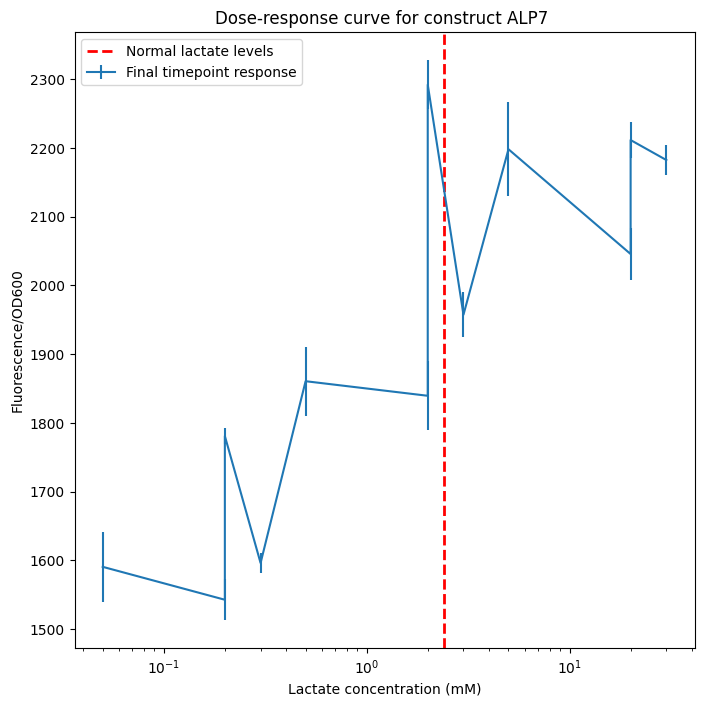

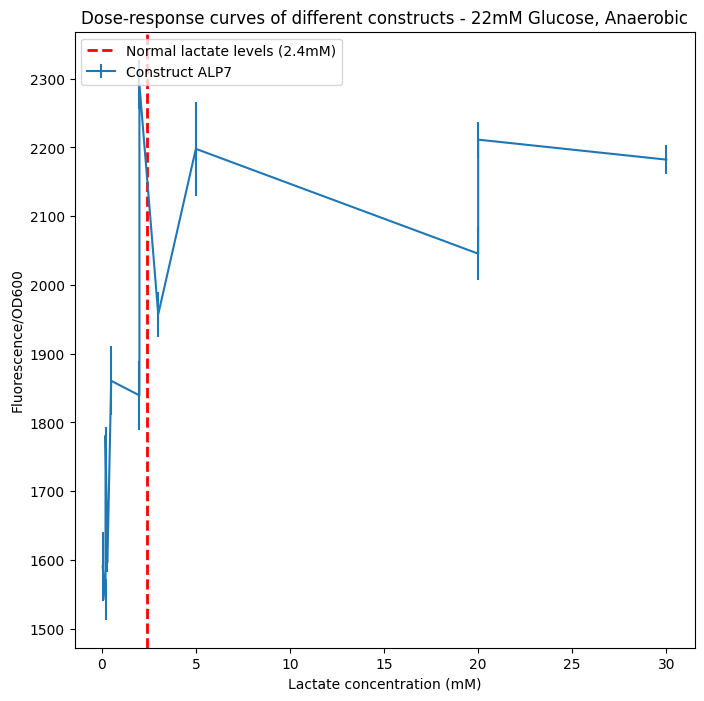

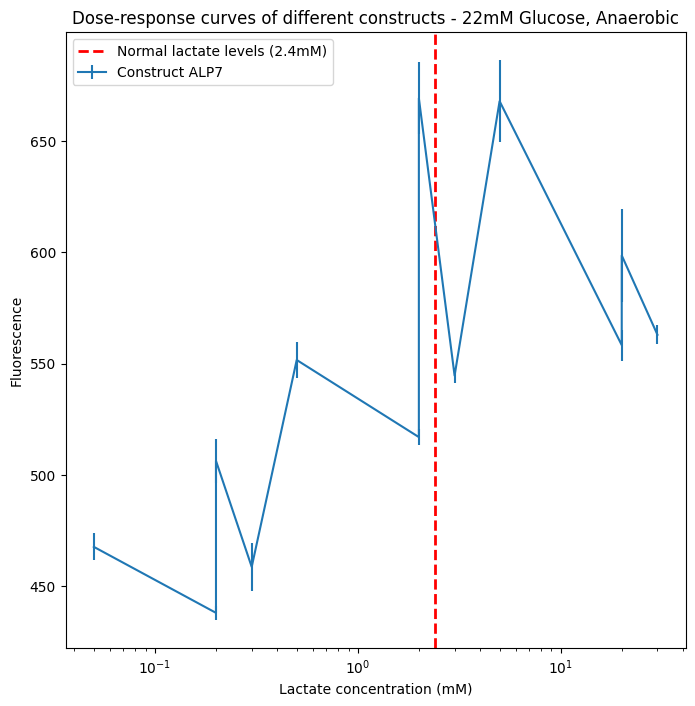

In [49]:
#Plot dose_response curves
for i in range(int(len(FLUOD_avg[0])/conc_nr)):
    plt.figure(figsize=(8,8))
    response = FLUOD_avg[-1,i*conc_nr:i*conc_nr+conc_nr]
    response_error = FLUOD_std[-1,i*conc_nr:i*conc_nr+conc_nr]

    #Sort response again since labels are weirdly sorted
    response = response[concentrations.argsort()]
    response_error = response_error[concentrations.argsort()]
    
    plt.errorbar(concentrations[concentrations.argsort()], response, yerr=response_error, label="Final timepoint response")
    plt.title(f"Dose-response curve for construct {labels[i*conc_nr][:5]}")
    plt.axvline(2.4,ymin =0, ymax=1, label=f"Normal lactate levels", color="red", linestyle="--", linewidth=2)
    plt.xlabel('Lactate concentration (mM)')
    plt.ylabel('Fluorescence/OD600')
    plt.legend(loc="upper left")
    plt.xscale('log')
    plt.show()
    
#Plot all dose_response curves in one figure
plt.figure(figsize=(8,8))
for i in range(int(len(FLUOD_avg[0])/conc_nr)):
    response = FLUOD_avg[-1,i*conc_nr:i*conc_nr+conc_nr]
    response_error = FLUOD_std[-1,i*7:i*conc_nr+conc_nr]

    #Sort response again since labels are weirdly sorted
    response = response[concentrations.argsort()]
    response_error = response_error[concentrations.argsort()]
    
    plt.errorbar(concentrations[concentrations.argsort()], response, yerr=response_error, label=f"Construct {labels[i*conc_nr][:5]}")
plt.title(f"Dose-response curves of different constructs - 22mM Glucose, Anaerobic")
plt.axvline(2.4,ymin =0, ymax=1, label=f"Normal lactate levels (2.4mM)", color="red", linestyle="--", linewidth=2)
plt.legend(loc="upper left")
plt.xlabel('Lactate concentration (mM)')
plt.ylabel('Fluorescence/OD600')
#plt.xscale('log')
plt.show()

#Plot all dose_response curves in one figure
plt.figure(figsize=(8,8))
for i in range(int(len(FLUOD_avg[0])/conc_nr)):
    response = FLU_avg[-1,i*conc_nr:i*conc_nr+conc_nr]
    response_error = FLU_std[-1,i*conc_nr:i*conc_nr+conc_nr]

    #Sort response again since labels are weirdly sorted
    response = response[concentrations.argsort()]
    response_error = response_error[concentrations.argsort()]
    
    plt.errorbar(concentrations[concentrations.argsort()], response, yerr=response_error, label=f"Construct {labels[i*conc_nr][:5]}")
plt.title(f"Dose-response curves of different constructs - 22mM Glucose, Anaerobic")
plt.axvline(2.4,ymin =0, ymax=1, label=f"Normal lactate levels (2.4mM)", color="red", linestyle="--", linewidth=2)
plt.legend(loc="upper left")
plt.xlabel('Lactate concentration (mM)')
plt.ylabel('Fluorescence')
plt.xscale('log')
plt.show()

#Save data
header_list = [x for x in labels]
header_list.insert(0,'Time(h)')

#Create dataframes.
Glucose_anaerobic_OD_processed = pd.DataFrame(np.column_stack((time,OD_avg)), columns=header_list)
Glucose_anaerobic_FLU_processed = pd.DataFrame(np.column_stack((time,FLU_avg)), columns=header_list)
Glucose_anaerobic_FLUOD_processed = pd.DataFrame(np.column_stack((time,FLUOD_avg)), columns=header_list)
Glucose_anaerobic_OD_std_processed = pd.DataFrame(np.column_stack((time,OD_std)), columns=header_list)
Glucose_anaerobic_FLU_std_processed = pd.DataFrame(np.column_stack((time,FLU_std)), columns=header_list)
Glucose_anaerobic_FLUOD_std_processed = pd.DataFrame(np.column_stack((time,FLUOD_std)), columns=header_list)

#Sort labels and restructure data accordingly.
header = sorted_nicely(labels)
header.insert(0,'Time(h)')
# print(f"Sorted header list:{header}\n\n")
# print(Glucose_anaerobic_OD_processed.head())
Glucose_anaerobic_OD_processed = Glucose_anaerobic_OD_processed[header]
# print(Glucose_anaerobic_OD_processed.head())
Glucose_anaerobic_FLU_processed = Glucose_anaerobic_FLU_processed[header]
Glucose_anaerobic_FLUOD_processed = Glucose_anaerobic_FLUOD_processed[header]
Glucose_anaerobic_OD_std_processed = Glucose_anaerobic_OD_std_processed[header]
Glucose_anaerobic_FLU_std_processed = Glucose_anaerobic_FLU_std_processed[header]
Glucose_anaerobic_FLUOD_std_processed = Glucose_anaerobic_FLUOD_std_processed[header]

Glucose_anaerobic_OD_processed.to_csv('Data/22mMGlucose_anaerobic_OD_moreconc.csv',index=False)
Glucose_anaerobic_FLU_processed.to_csv('Data/22mMGlucose_anaerobic_FLU_moreconc.csv', index=False)
Glucose_anaerobic_FLUOD_processed.to_csv('Data/22mMGlucose_anaerobic_FLUOD_moreconc.csv', index=False)
Glucose_anaerobic_OD_std_processed.to_csv('Data/22mMGlucose_anaerobic_OD_std_moreconc.csv', index=False)
Glucose_anaerobic_FLU_std_processed.to_csv('Data/22mMGlucose_anaerobic_FLU_std_moreconc.csv', index=False)
Glucose_anaerobic_FLUOD_std_processed.to_csv('Data/22mMGlucose_anaerobic_FLUOD_std_moreconc.csv', index=False)